In [1]:
import matplotlib
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import sys, cv2, glob, os, time
import pandas as pd 
import io
import numpy as np
from keras.datasets import mnist
from keras.layers import Input, Dense, Reshape, Flatten,Activation

from keras.models import Sequential, Model
import numpy as np # linear algebra

import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list the files in the input directory

from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

import os
import glob
import cv2
import tensorflow as tf
from keras import layers
from keras.layers import Dropout , Input, Add, Dense, Activation, ZeroPadding2D, BatchNormalization, Flatten, Conv2D, AveragePooling2D, MaxPooling2D, GlobalMaxPooling2D
from keras.models import Model, load_model
from keras.initializers import glorot_uniform
from sklearn.model_selection import train_test_split
import keras.backend as K
from sklearn.utils import shuffle
# importing all necessary libraries to run the code
import re,string
import numpy as np
import pandas as pd
import keras_metrics
import tensorflow.keras
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
from keras.models import Sequential
from sklearn.model_selection import train_test_split
from keras.layers import Dense, Flatten, LSTM, Conv1D, MaxPooling1D, Dropout, Activation,Embedding
# using the variable sw to hold all stopwords that are in English
sw = stopwords.words('english')
import matplotlib.pyplot as plt

import numpy as np # linear algebra

import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list the files in the input directory

import os
import glob
import cv2
import tensorflow as tf
from keras import layers
from keras.layers import Dropout , Input, Add, Dense, Activation, ZeroPadding2D, BatchNormalization, Flatten, Conv2D, AveragePooling2D, MaxPooling2D, GlobalMaxPooling2D
from keras.models import Model, load_model
from keras.initializers import glorot_uniform
from sklearn.model_selection import train_test_split
import keras.backend as K
from sklearn.utils import shuffle
# importing all necessary libraries to run the code
import re,string
import numpy as np
import pandas as pd
import keras_metrics
import tensorflow.keras
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
from keras.models import Sequential
from sklearn.model_selection import train_test_split
from keras.layers import Dense, Flatten, LSTM, Conv1D, MaxPooling1D, Dropout, Activation,Embedding


In [2]:
from mealpy.swarm_based.PSO import BasePSO
from mealpy.evolutionary_based.GA import BaseGA
from mealpy.evolutionary_based.DE import BaseDE
from mealpy.swarm_based.MFO import BaseMFO
import numpy as np

In [3]:
dataUN=pd.read_csv('UNSW_NB15_testing-set.csv')
dataUN1=pd.read_csv('UNSW_NB15_training-set.csv')

dataI=pd.read_csv('IoT Network Intrusion Dataset.csv')

In [4]:
dataUN1[:2]

,id,dur,proto,service,state,spkts,dpkts,sbytes,dbytes,rate,...,ct_dst_sport_ltm,ct_dst_src_ltm,is_ftp_login,ct_ftp_cmd,ct_flw_http_mthd,ct_src_ltm,ct_srv_dst,is_sm_ips_ports,attack_cat,label
0,1,0.000011,udp,-,INT,2,0,496,0,90909.0902,...,1,2,0,0,0,1,2,0,Normal,0
1,2,0.000008,udp,-,INT,2,0,1762,0,125000.0003,...,1,2,0,0,0,1,2,0,Normal,0


In [5]:
dataI[:2]

,Flow_ID,Src_IP,Src_Port,Dst_IP,Dst_Port,Protocol,Timestamp,Flow_Duration,Tot_Fwd_Pkts,Tot_Bwd_Pkts,...,Active_Std,Active_Max,Active_Min,Idle_Mean,Idle_Std,Idle_Max,Idle_Min,Label,Cat,Sub_Cat
0,192.168.0.13-192.168.0.16-10000-10101-17,192.168.0.13,10000,192.168.0.16,10101,17,25/07/2019 03:25:53 AM,75,1,1,...,0.0,0.0,0.0,75.0,0.000000,75.0,75.0,Anomaly,Mirai,Mirai-Ackflooding
1,192.168.0.13-222.160.179.132-554-2179-6,222.160.179.132,2179,192.168.0.13,554,6,26/05/2019 10:11:06 PM,5310,1,2,...,0.0,0.0,0.0,2655.0,2261.327486,4254.0,1056.0,Anomaly,DoS,DoS-Synflooding


In [6]:
dataF=dataUN.append(dataUN1,ignore_index = True) 

C:\Users\knowl\AppData\Local\Temp\ipykernel_36452\1098381135.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataF=dataUN.append(dataUN1,ignore_index = True)


In [7]:
dataF[:2]

,id,dur,proto,service,state,spkts,dpkts,sbytes,dbytes,rate,...,ct_dst_sport_ltm,ct_dst_src_ltm,is_ftp_login,ct_ftp_cmd,ct_flw_http_mthd,ct_src_ltm,ct_srv_dst,is_sm_ips_ports,attack_cat,label
0,1,0.121478,tcp,-,FIN,6,4,258,172,74.087490,...,1,1,0,0,0,1,1,0,Normal,0
1,2,0.649902,tcp,-,FIN,14,38,734,42014,78.473372,...,1,2,0,0,0,1,6,0,Normal,0


In [8]:
from collections import Counter
Counter(dataI["Sub_Cat"])

Counter({'Mirai-Ackflooding': 55124,
         'DoS-Synflooding': 59391,
         'Scan Port OS': 53073,
         'Mirai-Hostbruteforceg': 121181,
         'Mirai-UDP Flooding': 183554,
         'Mirai-HTTP Flooding': 55818,
         'Normal': 40073,
         'Scan Hostport': 22192,
         'MITM ARP Spoofing': 35377})

In [9]:
from collections import Counter
Counter(dataF["attack_cat"])

Counter({'Normal': 93000,
         'Backdoor': 2329,
         'Analysis': 2677,
         'Fuzzers': 24246,
         'Shellcode': 1511,
         'Reconnaissance': 13987,
         'Exploits': 44525,
         'DoS': 16353,
         'Worms': 174,
         'Generic': 58871})

In [10]:
from collections import Counter
Counter(dataI["Label"])

Counter({'Anomaly': 585710, 'Normal': 40073})

In [11]:
dataF1=dataF.loc[dataF['attack_cat'] == "Normal"]
print(len(dataF1))
dataF2=dataF.loc[dataF['attack_cat'] == "Backdoor"]
print(len(dataF2))
dataF3=dataF.loc[dataF['attack_cat'] == "Analysis"]
print(len(dataF3))
dataF4=dataF.loc[dataF['attack_cat'] == "Fuzzers"]
print(len(dataF4))
dataF5=dataF.loc[dataF['attack_cat'] == "Shellcode"]
print(len(dataF5))
dataF6=dataF.loc[dataF['attack_cat'] == "Reconnaissance"]
print(len(dataF6))
dataF7=dataF.loc[dataF['attack_cat'] == "Exploits"]
print(len(dataF7))
dataF8=dataF.loc[dataF['attack_cat'] == "DoS"]
print(len(dataF8))
dataF9=dataF.loc[dataF['attack_cat'] == "Worms"]
print(len(dataF9))
dataF10=dataF.loc[dataF['attack_cat'] == "Generic"]
print(len(dataF10))



dataI1=dataI.loc[dataI['Sub_Cat'] == 'Mirai-Ackflooding']
print(len(dataI1))
dataI2=dataI.loc[dataI['Sub_Cat'] == 'DoS-Synflooding']
print(len(dataI2))
dataI3=dataI.loc[dataI['Sub_Cat'] == 'Scan Port OS']
print(len(dataI3))
dataI4=dataI.loc[dataI['Sub_Cat'] == 'Mirai-Hostbruteforceg']
print(len(dataI4))

dataI5=dataI.loc[dataI['Sub_Cat'] == 'Mirai-UDP Flooding']
print(len(dataI5))
dataI6=dataI.loc[dataI['Sub_Cat'] == 'Mirai-HTTP Flooding']
print(len(dataI6))

dataI7=dataI.loc[dataI['Sub_Cat'] == 'Scan Hostport']
print(len(dataI7))
dataI8=dataI.loc[dataI['Sub_Cat'] == 'MITM ARP Spoofing']
print(len(dataI8))

dataI9=dataI.loc[dataI['Sub_Cat'] == 'Normal']
print(len(dataI9))



93000
2329
2677
24246
1511
13987
44525
16353
174
58871
55124
59391
53073
121181
183554
55818
22192
35377
40073


In [14]:
dataF1=dataF1[0:170]
dataF2=dataF2[0:170]
dataF3=dataF3[0:170]
dataF4=dataF4[0:170]
dataF5=dataF5[0:170]
dataF6=dataF6[0:170]
dataF7=dataF7[0:170]
dataF8=dataF8[0:170]
dataF9=dataF9[0:170]
dataF10=dataF10[0:170]


dataI1=dataI1[0:170]
dataI2=dataI2[0:170]
dataI3=dataI3[0:170]
dataI4=dataI4[0:170]
dataI5=dataI5[0:170]
dataI6=dataI6[0:170]
dataI7=dataI7[0:170]
dataI8=dataI8[0:170]
dataI9=dataI9[0:170]


In [15]:
dataF=dataF1.append(dataF2,ignore_index = True)
dataF=dataF.append(dataF3,ignore_index = True) 
dataF=dataF.append(dataF4,ignore_index = True) 
dataF=dataF.append(dataF5,ignore_index = True) 
dataF=dataF.append(dataF6,ignore_index = True) 
dataF=dataF.append(dataF7,ignore_index = True) 
dataF=dataF.append(dataF8,ignore_index = True) 
dataF=dataF.append(dataF9,ignore_index = True) 
dataF=dataF.append(dataF10,ignore_index = True) 

dataI=dataI1.append(dataI2,ignore_index = True)
dataI=dataI.append(dataI3,ignore_index = True)
dataI=dataI.append(dataI4,ignore_index = True)
dataI=dataI.append(dataI5,ignore_index = True)
dataI=dataI.append(dataI6,ignore_index = True)
dataI=dataI.append(dataI7,ignore_index = True)
dataI=dataI.append(dataI8,ignore_index = True)
dataI=dataI.append(dataI9,ignore_index = True)

C:\Users\knowl\AppData\Local\Temp\ipykernel_30348\3839054246.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataF=dataF1.append(dataF2,ignore_index = True)
C:\Users\knowl\AppData\Local\Temp\ipykernel_30348\3839054246.py:2: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataF=dataF.append(dataF3,ignore_index = True)
C:\Users\knowl\AppData\Local\Temp\ipykernel_30348\3839054246.py:3: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataF=dataF.append(dataF4,ignore_index = True)
C:\Users\knowl\AppData\Local\Temp\ipykernel_30348\3839054246.py:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  dataF=dataF.append(dataF5,ignore_index = True)
C:\

In [12]:
from collections import Counter
Counter(dataI["Label"])

Counter({'Anomaly': 585710, 'Normal': 40073})

In [13]:
from collections import Counter
Counter(dataF["label"])

Counter({0: 93000, 1: 164673})

In [14]:
dataF.rename(columns = {'label':'Label'}, inplace = True)
dataF.rename(columns = {'attack_cat':'Sub_Cat'}, inplace = True)

In [15]:
DataITarget=dataI[["Label","Cat","Sub_Cat"]]

dataIFeatures=dataI.drop(["Label","Cat","Sub_Cat"], axis=1)

DataFTarget=dataF[["Sub_Cat","Label"]]

dataFFeatures=dataF.drop(["Sub_Cat","Label"], axis=1)

In [16]:
DataITarget["Sub_Cat"]=DataITarget["Sub_Cat"].replace('Normal','Normal_I')

C:\Users\knowl\AppData\Local\Temp\ipykernel_36452\4285179342.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  DataITarget["Sub_Cat"]=DataITarget["Sub_Cat"].replace('Normal','Normal_I')


In [21]:
from collections import Counter
Counter(DataITarget["Sub_Cat"])

Counter({'Mirai-Ackflooding': 170,
         'DoS-Synflooding': 170,
         'Scan Port OS': 170,
         'Mirai-Hostbruteforceg': 170,
         'Mirai-UDP Flooding': 170,
         'Mirai-HTTP Flooding': 170,
         'Scan Hostport': 170,
         'MITM ARP Spoofing': 170,
         'Normal_I': 170})

In [22]:
from sklearn import preprocessing 
from sklearn.preprocessing import LabelEncoder
le = preprocessing.LabelEncoder()

dataIFeatures=dataIFeatures.apply(LabelEncoder().fit_transform)

In [23]:
dataFFeatures=dataFFeatures.apply(LabelEncoder().fit_transform)

In [24]:
len(dataIFeatures)

1530

ETC


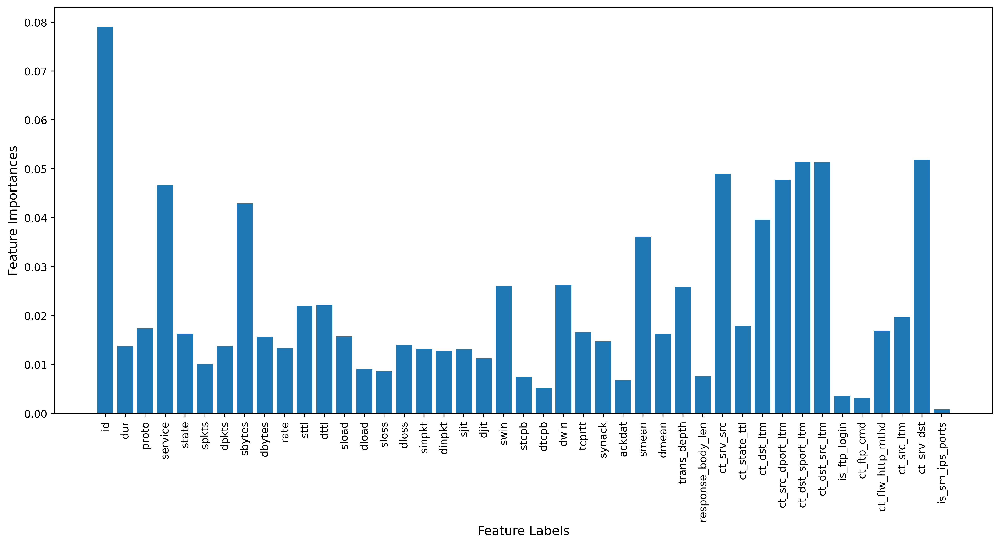

In [25]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)

X =dataFFeatures

y =  DataFTarget["Sub_Cat"]
# Training the model
dt.fit(X, y)

# Computing the importance of each feature
feature_importance = dt.feature_importances_

# Normalizing the individual importances
feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
plt.figure(figsize=(13,7),dpi=400)
plt.xticks(rotation=90)
# Plotting a Bar Graph to compare the models
plt.bar(X.columns, feature_importance_normalized)
plt.xlabel('Feature Labels',fontsize=12)
plt.ylabel('Feature Importances',fontsize=12)


plt.tight_layout(pad=0)
plt.savefig('FeatureImp.pdf')
plt.show()

In [26]:
featuresimpF=[]
for i in range (len(X.columns)):
    if feature_importance_normalized[i]>0.02:
        featuresimpF.append(X.columns[i])
len(featuresimpF)        

15

ETC


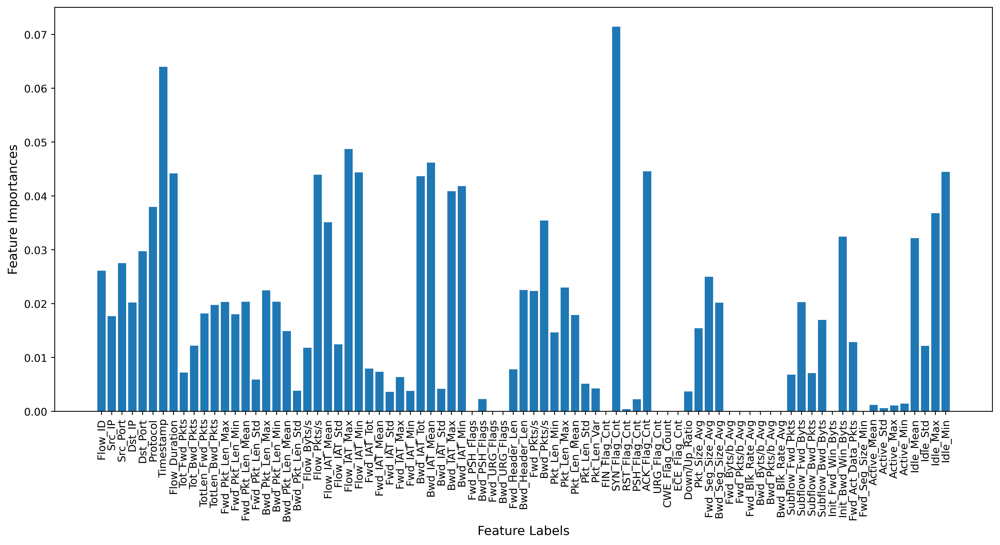

In [27]:
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)

X =dataIFeatures

y =  DataITarget["Sub_Cat"]
# Training the model
dt.fit(X, y)

# Computing the importance of each feature
feature_importance = dt.feature_importances_

# Normalizing the individual importances
feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
plt.figure(figsize=(13,7),dpi=400)
plt.xticks(rotation=90)
# Plotting a Bar Graph to compare the models
plt.bar(X.columns, feature_importance_normalized)
plt.xlabel('Feature Labels',fontsize=12)
plt.ylabel('Feature Importances',fontsize=12)


plt.tight_layout(pad=0)
plt.savefig('FeatureImp.pdf')
plt.show()

In [28]:
featuresimp=[]
for i in range (len(X.columns)):
    if feature_importance_normalized[i]>0.02:
        featuresimp.append(X.columns[i])
len(featuresimp)       

32

In [29]:
dataIFeatures= dataIFeatures[featuresimp]

In [30]:
dataFFeatures= dataFFeatures[featuresimpF]

In [32]:
t_model = Sequential()
t_model.add(Dense(256, input_shape=(32,)))
t_model.add(Dense(1024))
t_model.add(Dense(512, activation=tf.nn.sigmoid))
t_model.compile(optimizer='adam',loss='categorical_crossentropy')
GI1=t_model.predict(dataIFeatures)


48/48 [==============================] - 0s 5ms/step


In [369]:
t_model = Sequential()
t_model.add(Dense(256, input_shape=(17,)))
t_model.add(Dense(1024))
t_model.add(Dense(512, activation=tf.nn.sigmoid))
t_model.compile(optimizer='adam',loss='categorical_crossentropy')
GF1=t_model.predict(dataFFeatures)


In [370]:
dI=pd.DataFrame(GI1)
dF=pd.DataFrame(GF1)


In [371]:
ComFeat=dF.append(dI,ignore_index = True) 
ComT=DataFTarget["Sub_Cat"].append(DataITarget["Sub_Cat"],ignore_index = True)

In [372]:
len(ComFeat)

3230

In [373]:
feat=np.array(ComFeat)

In [29]:
dataFFeatures

,id,dur,proto,service,state,spkts,dpkts,sbytes,dbytes,rate,...,ct_dst_ltm,ct_src_dport_ltm,ct_dst_sport_ltm,ct_dst_src_ltm,is_ftp_login,ct_ftp_cmd,ct_flw_http_mthd,ct_src_ltm,ct_srv_dst,is_sm_ips_ports
0,0,38,101,0,2,3,2,50,5,636,...,0,0,0,0,0,0,0,0,0,0
1,1,349,101,0,2,7,17,148,166,656,...,0,0,0,1,0,0,0,0,5,0
2,2,595,101,0,2,4,8,66,154,124,...,1,0,0,2,0,0,0,1,5,0
3,3,602,101,2,2,6,6,124,26,118,...,1,0,0,2,1,1,0,1,0,0
4,4,231,101,0,2,5,3,97,7,430,...,1,1,0,34,0,0,0,1,36,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1695,1664,3,106,1,3,1,0,8,0,743,...,16,15,15,30,0,0,0,15,32,0
1696,1665,9,106,1,3,1,0,8,0,737,...,11,11,11,29,0,0,0,11,31,0
1697,1666,6,106,1,3,1,0,8,0,740,...,17,17,17,15,0,0,0,17,17,0
1698,1667,9,106,1,3,1,0,8,0,737,...,17,17,17,24,0,0,0,18,26,0


In [23]:
sol0R=[]
sol1R=[]
accR=[]
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)
def fitness_function(solution):
    print(solution)
    sol0R.append(solution[0])
    sol1R.append(solution[1])
    global dataFFeatures
    X =dataFFeatures
    y =  DataFTarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpF=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpF.append(X.columns[i])
    print(len(featuresimpF))

    global dataIFeatures
    X =dataIFeatures
    y =  DataITarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpI=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpI.append(X.columns[i])
    print(len(featuresimpI))
    dataIFeatures= dataIFeatures[featuresimpI]
    dataFFeatures= dataFFeatures[featuresimpF]

    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpI),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GI1=t_model.predict(dataIFeatures)


    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GF1=t_model.predict(dataFFeatures)
    
    dI=pd.DataFrame(GI1)
    dF=pd.DataFrame(GF1)
    
    ComFeat=dF.append(dI,ignore_index = True) 
    ComT=DataFTarget["Sub_Cat"].append(DataITarget["Sub_Cat"],ignore_index = True)


    X_train, X_test, y_train, y_test = train_test_split(ComFeat, ComT, test_size=0.15, random_state=1, stratify=ComT, shuffle=True)
    
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    a =  RandomForestClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    a_pred = a.fit(X_train, y_train)
    pred=a_pred.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accR.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [90, 0.01, 10, 5],
    "ub": [2000, 0.03,300,20],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


#model = BasePSO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")

ETC
[7.38019767e+02 1.27728453e-02 1.88958419e+02 1.98228205e+01]
31
42
0.7938144329896907
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.71      0.77      0.74        26
                  DoS       0.70      0.84      0.76        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.76      0.78        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.86      0.73      0.79        26
               Normal       0.96      0.92      0.94        26
             Normal_I     

12
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.96      0.86        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       0.92      0.96      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

12
21
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.89      0.31      0.46        26
             Backdoor       0.76      1.00      0.87        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.70      0.76      0.73        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.42      0.62      0.50        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.63      0.46      0.53        26
             Backdoor       0.77      0.77      0.77        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.60      0.46      0.52        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.76      0.76      0.76        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.37      0.27      0.31        26
  Mirai-HTTP Flooding       0.35      0.54      0.42        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.81      0.50      0.62        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.96      0.86        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8041237113402062
                       precision    recall  f1-score   support

             Analysis       0.65      0.42      0.51        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.34      0.50      0.41        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.76      0.76      0.76        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.33      0.46      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.6948453608247422
                       precision    recall  f1-score   support

             Analysis       1.00      0.15      0.27        26
             Backdoor       0.72      1.00      0.84        26
                  DoS       0.47      0.92      0.62        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.16      0.24        25
              Fuzzers       0.79      1.00      0.88        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.94      0.60      0.73        25
    Mirai-Ackflooding       0.38      0.62      0.47        26
  Mirai-HTTP Flooding       0.47      0.54      0.50        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       1.00      0.23      0.38        26
             Backdoor       0.76      1.00      0.87        26
                  DoS       0.88      0.88      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.68      0.76      0.72        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.36      0.38      0.37        26
  Mirai-HTTP Flooding       0.47      0.62      0.53        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.7298969072164948
                       precision    recall  f1-score   support

             Analysis       1.00      0.15      0.27        26
             Backdoor       0.72      1.00      0.84        26
                  DoS       0.43      0.92      0.59        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.67      0.32      0.43        25
              Fuzzers       0.81      1.00      0.90        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.95      0.80      0.87        25
    Mirai-Ackflooding       0.53      0.35      0.42        26
  Mirai-HTTP Flooding       0.50      0.96      0.66        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.92      0.92      0.92        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.73      0.76      0.75        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.88      0.90        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       0.85      0.88      0.86        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


11
21
0.8371134020618557
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.74      0.80      0.77        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.50      0.38      0.43        26
  Mirai-HTTP Flooding       0.47      0.73      0.58        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.90      0.35      0.50        26
             Backdoor       0.78      0.96      0.86        26
                  DoS       0.88      0.92      0.90        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.70      0.76      0.73        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.45      0.73      0.56        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       0.58      0.54      0.56        26
             Backdoor       0.80      0.77      0.78        26
                  DoS       0.78      0.84      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.81      0.88      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.35      0.31      0.33        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      1.00      1.00        26
             Normal_I       1.00      0.96      0.98        26
       Reconnaissance       0

11
21
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.57      0.46      0.51        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.76      0.76      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.34      0.46      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.7958762886597938
                       precision    recall  f1-score   support

             Analysis       0.63      0.46      0.53        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.75      0.72      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.33      0.27      0.30        26
  Mirai-HTTP Flooding       0.31      0.46      0.37        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       1.00      1.00      1.00        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.89      0.96      0.92        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.57      0.46      0.51        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.78      0.84      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.34      0.50      0.41        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.60      0.46      0.52        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.72      0.72      0.72        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.81      0.88      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.42      0.31      0.36        26
  Mirai-HTTP Flooding       0.35      0.50      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       0.61      0.42      0.50        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.77      0.80      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.35      0.31      0.33        26
  Mirai-HTTP Flooding       0.29      0.38      0.33        26
Mirai-Hostbruteforceg       0.89      0.96      0.92        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8391752577319588
                       precision    recall  f1-score   support

             Analysis       0.74      0.54      0.62        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       1.00      1.00      1.00        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.39      0.58      0.47        26
Mirai-Hostbruteforceg       0.92      0.96      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.61      0.42      0.50        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.75      0.72      0.73        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.35      0.31      0.33        26
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.59      0.50      0.54        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.77      0.80      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.35      0.23      0.28        26
  Mirai-HTTP Flooding       0.36      0.54      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       1.00      0.35      0.51        26
             Backdoor       0.81      1.00      0.90        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.69      0.80      0.74        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.35      0.27      0.30        26
  Mirai-HTTP Flooding       0.38      0.62      0.47        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.33      0.31      0.32        26
  Mirai-HTTP Flooding       0.44      0.62      0.52        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       0.65      0.42      0.51        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.77      0.80      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.35      0.50      0.41        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.91      0.38      0.54        26
             Backdoor       0.78      0.96      0.86        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.68      0.76      0.72        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.52      0.42      0.47        26
  Mirai-HTTP Flooding       0.47      0.69      0.56        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.33      0.27      0.30        26
  Mirai-HTTP Flooding       0.37      0.54      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.33      0.31      0.32        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.42      0.62      0.50        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.37      0.54      0.44        26
Mirai-Hostbruteforceg       0.89      0.96      0.92        25
   Mirai-UDP Flooding       0.86      0.73      0.79        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.83      0.96      0.89        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.27      0.33        26
  Mirai-HTTP Flooding       0.38      0.62      0.47        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

11
21
0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.39      0.27      0.32        26
  Mirai-HTTP Flooding       0.41      0.65      0.51        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.37      0.54      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

11
21
0.8020618556701031
                       precision    recall  f1-score   support

             Analysis       0.58      0.42      0.49        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.75      0.84      0.79        25
      DoS-Synflooding       0.96      0.96      0.96        25
             Exploits       0.73      0.76      0.75        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0

11
21
0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.83      0.96      0.89        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.60      0.46      0.52        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.73      0.76      0.75        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.81      0.84      0.82        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.42      0.31      0.36        26
  Mirai-HTTP Flooding       0.34      0.50      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.74      0.54      0.62        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.34      0.38      0.36        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.94      0.65      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.54      0.50      0.52        26
             Backdoor       0.77      0.77      0.77        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       0.96      1.00      0.98        25
             Exploits       0.72      0.72      0.72        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.85      0.88      0.86        25
    Mirai-Ackflooding       0.32      0.27      0.29        26
  Mirai-HTTP Flooding       0.38      0.58      0.46        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.94      0.65      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0

11
21
0.7195876288659794
                       precision    recall  f1-score   support

             Analysis       1.00      0.15      0.27        26
             Backdoor       0.72      1.00      0.84        26
                  DoS       0.45      0.92      0.61        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.53      0.32      0.40        25
              Fuzzers       0.90      1.00      0.95        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.48      0.63        25
    Mirai-Ackflooding       0.35      0.46      0.40        26
  Mirai-HTTP Flooding       0.46      0.62      0.52        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.84      0.81      0.82        26
       Reconnaissance       0

11
21
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.96      0.86        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.42      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.6350515463917525
                       precision    recall  f1-score   support

             Analysis       1.00      0.12      0.21        26
             Backdoor       0.72      1.00      0.84        26
                  DoS       0.25      0.96      0.40        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.75      0.12      0.21        25
              Fuzzers       0.68      1.00      0.81        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      0.56      0.70        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.39      0.69      0.50        26
Mirai-Hostbruteforceg       0.74      0.80      0.77        25
   Mirai-UDP Flooding       0.80      0.62      0.70        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.90      0.69      0.78        26
       Reconnaissance       0

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.81      0.85      0.83        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.39      0.42      0.41        26
  Mirai-HTTP Flooding       0.41      0.54      0.47        26
Mirai-Hostbruteforceg       0.85      0.88      0.86        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

11
21
0.8371134020618557
                       precision    recall  f1-score   support

             Analysis       0.86      0.46      0.60        26
             Backdoor       0.81      0.96      0.88        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.73      0.88      0.80        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.42      0.42        26
  Mirai-HTTP Flooding       0.44      0.62      0.52        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.42      0.62      0.50        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.75      0.84      0.79        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.33      0.27      0.30        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.78      0.27      0.40        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.70      0.76      0.73        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.43      0.62      0.51        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.75      0.84      0.79        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.58      0.42      0.49        26
             Backdoor       0.75      0.81      0.78        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.80      0.78        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.43      0.62      0.51        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.68      0.58      0.62        26
             Backdoor       0.80      0.77      0.78        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8391752577319588
                       precision    recall  f1-score   support

             Analysis       0.81      0.50      0.62        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.72      0.84      0.78        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.46      0.62      0.52        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.33      0.27      0.30        26
  Mirai-HTTP Flooding       0.39      0.58      0.47        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.83      0.96      0.89        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.42      0.62      0.50        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.63      0.46      0.53        26
             Backdoor       0.80      0.77      0.78        26
                  DoS       0.83      0.96      0.89        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      1.00      0.88        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       0.92      0.96      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.81      0.81      0.81        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.33      0.31      0.32        26
  Mirai-HTTP Flooding       0.43      0.58      0.49        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.74      0.54      0.62        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.83      0.96      0.89        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.41      0.27      0.33        26
  Mirai-HTTP Flooding       0.37      0.54      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

11
21
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.75      0.84      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.32      0.46      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.64      0.54      0.58        26
             Backdoor       0.81      0.81      0.81        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       0.96      0.96      0.96        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0

11
21
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.83      0.38      0.53        26
             Backdoor       0.81      0.96      0.88        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.70      0.76      0.73        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.46      0.73      0.57        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.80      0.46      0.59        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.32      0.27      0.29        26
  Mirai-HTTP Flooding       0.38      0.58      0.46        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.47      0.35      0.40        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.33      0.27      0.30        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.42      0.54      0.47        26
Mirai-Hostbruteforceg       0.89      0.96      0.92        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      1.00      0.88        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.38      0.58      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.33      0.31      0.32        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.96      0.86        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.89      1.00      0.94        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.81      1.00      0.89        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.42      0.62      0.50        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.83      0.96      0.89        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.39      0.58      0.47        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.96      0.86        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.42      0.62      0.50        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.77      0.80      0.78        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.81      0.84      0.82        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.33      0.27      0.30        26
  Mirai-HTTP Flooding       0.33      0.42      0.37        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.37      0.58      0.45        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.55      0.46      0.50        26
             Backdoor       0.77      0.77      0.77        26
                  DoS       0.76      0.76      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.78      0.96      0.86        26
                  DoS       0.88      0.92      0.90        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.68      0.68      0.68        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.43      0.62      0.51        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.42      0.58      0.48        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.843298969072165
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.43      0.58      0.49        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.

11
21
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.83      0.96      0.89        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.58      0.54      0.56        26
             Backdoor       0.83      0.77      0.80        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.31      0.31      0.31        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.96      0.86        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.35      0.27      0.30        26
  Mirai-HTTP Flooding       0.45      0.65      0.53        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.35      0.35      0.35        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.96      0.86        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.43      0.62      0.51        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8371134020618557
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.39      0.27      0.32        26
  Mirai-HTTP Flooding       0.40      0.65      0.50        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.73      0.83        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8371134020618557
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.83      1.00      0.91        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.42      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.88      0.88      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.69      0.80      0.74        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.35      0.27      0.30        26
  Mirai-HTTP Flooding       0.40      0.65      0.49        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.35      0.27      0.30        26
  Mirai-HTTP Flooding       0.39      0.58      0.47        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.83      0.96      0.89        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.83      1.00      0.91        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.32      0.27      0.29        26
  Mirai-HTTP Flooding       0.37      0.54      0.44        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8391752577319588
                       precision    recall  f1-score   support

             Analysis       0.74      0.54      0.62        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.83      0.96      0.89        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.43      0.62      0.51        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.83      0.96      0.89        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.43      0.58      0.49        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.73      0.83        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.43      0.58      0.49        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.75      0.96      0.84        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.41      0.62      0.49        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.80      0.46      0.59        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.42      0.62      0.50        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.65      0.42      0.51        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.38      0.58      0.45        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.67      0.54      0.60        26
             Backdoor       0.81      0.81      0.81        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.81      0.84      0.82        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       1.00      1.00      1.00        25
    Mirai-Ackflooding       0.33      0.38      0.36        26
  Mirai-HTTP Flooding       0.31      0.31      0.31        26
Mirai-Hostbruteforceg       0.92      0.96      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       0.96      1.00      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

11
21
0.8412371134020619
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.96      0.86        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.46      0.65      0.54        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.35      0.31      0.33        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.83      0.96      0.89        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.77      0.77      0.77        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.83      0.96      0.89        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.35      0.31      0.33        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8412371134020619
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.83      1.00      0.91        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.35      0.31      0.33        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.72      0.84      0.78        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.33      0.31      0.32        26
  Mirai-HTTP Flooding       0.46      0.65      0.54        26
Mirai-Hostbruteforceg       0.92      0.96      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.96      0.86        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8371134020618557
                       precision    recall  f1-score   support

             Analysis       0.74      0.54      0.62        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.42      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.83      0.96      0.89        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.35      0.31      0.33        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.32      0.27      0.29        26
  Mirai-HTTP Flooding       0.38      0.58      0.46        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

11
21
0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.74      0.54      0.62        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.83      1.00      0.91        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.45      0.65      0.53        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.60      0.46      0.52        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.77      0.80      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.33      0.27      0.30        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.74      0.92      0.82        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.35      0.27      0.30        26
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.83      0.96      0.89        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.45      0.35      0.39        26
  Mirai-HTTP Flooding       0.41      0.62      0.49        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.32      0.27      0.29        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.43      0.58      0.49        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.83      0.96      0.89        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.32      0.27      0.29        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.81      1.00      0.89        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.35      0.31      0.33        26
  Mirai-HTTP Flooding       0.42      0.62      0.50        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.32      0.31      0.31        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.73      0.83        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.

11
21
0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.35      0.31      0.33        26
  Mirai-HTTP Flooding       0.39      0.58      0.47        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.74      0.54      0.62        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.33      0.31      0.32        26
  Mirai-HTTP Flooding       0.32      0.42      0.37        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.37      0.54      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.30      0.27      0.29        26
  Mirai-HTTP Flooding       0.33      0.50      0.40        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.30      0.23      0.26        26
  Mirai-HTTP Flooding       0.36      0.54      0.43        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.843298969072165
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.83      0.96      0.89        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       1.00      1.00      1.00        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.80      0.96      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.32      0.31      0.31        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

In [38]:
max(accR)

0.845360824742268

In [46]:
len(accR)

551

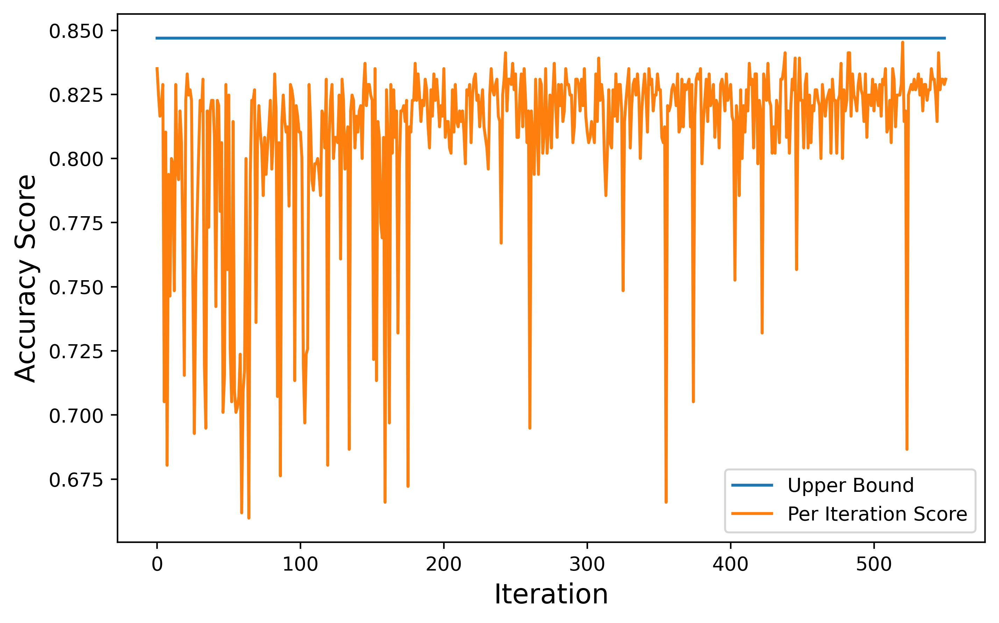

In [93]:
accR1=[]
for i in range(0,550):
    accR1.append(0.847)

plt.figure(figsize=(8,5),dpi=400)
plt.plot(accR1)
plt.plot(accR)
plt.xlabel('Iteration', fontsize=14)
plt.ylabel('Accuracy Score', fontsize=14)
plt.legend(['Upper Bound', 'Per Iteration Score'], loc='lower right')
plt.savefig("rfit.pdf")

In [32]:
sol0E=[]
sol1E=[]
accE=[]
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)
def fitness_function(solution):
    print(solution)
    sol0E.append(solution[0])
    sol1E.append(solution[1])
    global dataFFeatures
    X =dataFFeatures
    y =  DataFTarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpF=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpF.append(X.columns[i])
    print(len(featuresimpF))

    global dataIFeatures
    X =dataIFeatures
    y =  DataITarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpI=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpI.append(X.columns[i])
    print(len(featuresimpI))
    dataIFeatures= dataIFeatures[featuresimpI]
    dataFFeatures= dataFFeatures[featuresimpF]

    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpI),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GI1=t_model.predict(dataIFeatures)


    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GF1=t_model.predict(dataFFeatures)
    
    dI=pd.DataFrame(GI1)
    dF=pd.DataFrame(GF1)
    
    ComFeat=dF.append(dI,ignore_index = True) 
    ComT=DataFTarget["Sub_Cat"].append(DataITarget["Sub_Cat"],ignore_index = True)


    X_train, X_test, y_train, y_test = train_test_split(ComFeat, ComT, test_size=0.15, random_state=1, stratify=ComT, shuffle=True)
    
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    a =  ExtraTreesClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a =  RandomForestClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    a_pred = a.fit(X_train, y_train)
    pred=a_pred.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accE.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [90, 0.01, 10, 5],
    "ub": [2000, 0.03,300,20],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


#model = BasePSO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")

ETC
[1.07542246e+03 1.10185289e-02 2.16080436e+02 9.60181920e+00]
10
20
0.8
                       precision    recall  f1-score   support

             Analysis       0.69      0.35      0.46        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.67      0.80      0.73        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.41      0.65      0.51        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.0

10
20
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.72      0.84      0.78        25
              Fuzzers       0.93      1.00      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.60      0.35      0.44        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.47      0.31      0.37        26
  Mirai-HTTP Flooding       0.40      0.62      0.48        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.71      0.38      0.50        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.71      0.88      0.79        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.43      0.62      0.51        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8041237113402062
                       precision    recall  f1-score   support

             Analysis       0.78      0.27      0.40        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.42      0.62      0.50        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.71      0.80      0.75        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.39      0.58      0.47        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.78      0.84      0.81        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.35      0.31      0.33        26
  Mirai-HTTP Flooding       0.33      0.46      0.39        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7175257731958763
                       precision    recall  f1-score   support

             Analysis       1.00      0.15      0.27        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.55      0.92      0.69        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.53      0.36      0.43        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.89      1.00      0.94        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.43      0.69      0.53        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       1.00      0.58      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      0.85      0.90        26
       Reconnaissance       0

10
20
0.6969072164948453
                       precision    recall  f1-score   support

             Analysis       1.00      0.15      0.27        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.45      0.92      0.61        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.45      0.20      0.28        25
              Fuzzers       0.79      1.00      0.88        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.45      0.73      0.56        26
Mirai-Hostbruteforceg       0.90      0.76      0.83        25
   Mirai-UDP Flooding       0.79      0.58      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.87      0.77      0.82        26
       Reconnaissance       0

10
20
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.69      0.35      0.46        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.39      0.27      0.32        26
  Mirai-HTTP Flooding       0.43      0.73      0.54        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.94      0.62      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.6391752577319587
                       precision    recall  f1-score   support

             Analysis       0.67      0.08      0.14        26
             Backdoor       0.65      1.00      0.79        26
                  DoS       0.44      0.92      0.60        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.50      0.08      0.14        25
              Fuzzers       0.68      1.00      0.81        26
              Generic       0.86      1.00      0.93        25
    MITM ARP Spoofing       0.89      0.64      0.74        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.36      0.62      0.45        26
Mirai-Hostbruteforceg       0.94      0.60      0.73        25
   Mirai-UDP Flooding       0.63      0.65      0.64        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.90      0.73      0.81        26
       Reconnaissance       0

10
20
0.7195876288659794
                       precision    recall  f1-score   support

             Analysis       1.00      0.15      0.27        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.47      0.92      0.62        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.57      0.32      0.41        25
              Fuzzers       0.87      1.00      0.93        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.35      0.35      0.35        26
  Mirai-HTTP Flooding       0.43      0.62      0.51        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.94      0.58      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.92      0.88      0.90        26
       Reconnaissance       0

10
20
0.7793814432989691
                       precision    recall  f1-score   support

             Analysis       0.86      0.23      0.36        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.64      0.72      0.68        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.47      0.77      0.58        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.58      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       1

10
20
0.6618556701030928
                       precision    recall  f1-score   support

             Analysis       1.00      0.15      0.27        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.43      0.92      0.59        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.43      0.24      0.31        25
              Fuzzers       0.92      0.85      0.88        26
              Generic       0.83      1.00      0.91        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.32      0.27      0.29        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.94      0.64      0.76        25
   Mirai-UDP Flooding       0.62      0.58      0.60        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.76      0.85      0.80        26
       Reconnaissance       0

10
20
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.71      0.80      0.75        25
              Fuzzers       0.93      1.00      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7051546391752578
                       precision    recall  f1-score   support

             Analysis       1.00      0.15      0.27        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.62      0.84      0.71        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.46      0.44      0.45        25
              Fuzzers       0.85      0.88      0.87        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.79      0.88      0.83        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.41      0.62      0.49        26
Mirai-Hostbruteforceg       0.78      0.72      0.75        25
   Mirai-UDP Flooding       0.79      0.58      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      0.73      0.81        26
       Reconnaissance       0

10
20
0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       1.00      0.15      0.27        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.64      0.64      0.64        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.33      0.35      0.34        26
  Mirai-HTTP Flooding       0.47      0.69      0.56        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.58      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.56      0.35      0.43        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.81      0.84      0.82        25
    Mirai-Ackflooding       0.42      0.42      0.42        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.86      0.76      0.81        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.89      0.96      0.93        26
       Reconnaissance       0

10
20
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.65      0.58      0.61        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.42      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.94      0.62      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       0.71      0.38      0.50        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.66      0.84      0.74        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.64      0.54      0.58        26
             Backdoor       0.81      0.81      0.81        26
                  DoS       0.78      0.84      0.81        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.80      0.78        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.75      0.35      0.47        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.72      0.92      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.38      0.38      0.38        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.89      0.62      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.74      0.92      0.82        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.35      0.27      0.30        26
  Mirai-HTTP Flooding       0.36      0.54      0.43        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.67      0.54      0.60        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.74      0.80      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.76      0.76      0.76        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8041237113402062
                       precision    recall  f1-score   support

             Analysis       0.82      0.35      0.49        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.92      0.77        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.38      0.58      0.45        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

10
20
0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       1.00      0.23      0.38        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.39      0.27      0.32        26
  Mirai-HTTP Flooding       0.44      0.77      0.56        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.58      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.75      0.35      0.47        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.71      0.88      0.79        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.46      0.69      0.55        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.94      0.62      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.90      0.35      0.50        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.72      0.92      0.81        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.56      0.38      0.45        26
  Mirai-HTTP Flooding       0.43      0.69      0.53        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.89      0.62      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.74      0.80      0.77        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.50      0.46        26
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.83      0.92      0.87        26
       Reconnaissance       0

10
20
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.71      0.80      0.75        25
              Fuzzers       0.93      1.00      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.42      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.60      0.46      0.52        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.77      0.80      0.78        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.87      1.00      0.93        26
       Reconnaissance       0

10
20
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       1.00      0.27      0.42        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.62      0.64      0.63        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.42      0.69      0.52        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       1.00      0.58      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.62      0.38      0.48        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.69      0.80      0.74        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.42      0.42      0.42        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.69      0.35      0.46        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.71      0.88      0.79        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.

10
20
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.39      0.58      0.47        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7381443298969073
                       precision    recall  f1-score   support

             Analysis       1.00      0.15      0.27        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.56      0.92      0.70        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.50      0.36      0.42        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.44      0.69      0.54        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.94      0.62      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      0.92      0.94        26
       Reconnaissance       0

10
20
0.8041237113402062
                       precision    recall  f1-score   support

             Analysis       0.62      0.50      0.55        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.79      0.76      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.36      0.38      0.37        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.71      0.38      0.50        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.41      0.65      0.51        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       1.00      0.58      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       1

10
20
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.73      0.31      0.43        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.71      0.96      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.42      0.41        26
  Mirai-HTTP Flooding       0.42      0.54      0.47        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.62      0.50      0.55        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.75      0.84      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.76      0.78        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.37      0.54      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.75      0.72      0.73        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.33      0.31      0.32        26
  Mirai-HTTP Flooding       0.33      0.46      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.80      0.31      0.44        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.70      0.92      0.79        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.30      0.27      0.29        26
  Mirai-HTTP Flooding       0.35      0.50      0.41        26
Mirai-Hostbruteforceg       0.92      0.96      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.62      0.50      0.55        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.87      1.00      0.93        26
       Reconnaissance       0

10
20
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.59      0.50      0.54        26
             Backdoor       0.77      0.77      0.77        26
                  DoS       0.78      0.84      0.81        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.81      0.84      0.82        25
              Fuzzers       0.93      1.00      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.42      0.31      0.36        26
  Mirai-HTTP Flooding       0.33      0.46      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.38      0.38      0.38        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.

10
20
0.797938144329897
                       precision    recall  f1-score   support

             Analysis       0.53      0.35      0.42        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.88      0.88      0.88        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.68      0.84      0.75        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.86      1.00      0.93        25
    Mirai-Ackflooding       0.39      0.46      0.42        26
  Mirai-HTTP Flooding       0.43      0.50      0.46        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.

10
20
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.57      0.50      0.53        26
             Backdoor       0.77      0.77      0.77        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.81      0.84      0.82        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.32      0.31      0.31        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.76      0.76      0.76        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.35      0.35      0.35        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.64      0.54      0.58        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.

10
20
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.83      0.96      0.89        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.62      0.50      0.55        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.77      0.80      0.78        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.60      0.46      0.52        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.

10
20
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.67      0.54      0.60        26
             Backdoor       0.81      0.85      0.83        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.34      0.50      0.41        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8371134020618557
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.50      0.35      0.41        26
  Mirai-HTTP Flooding       0.39      0.58      0.47        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.63      0.46      0.53        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       1.00      0.23      0.38        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.62      0.60      0.61        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.47      0.65      0.55        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.89      0.92      0.91        26
       Reconnaissance       0

10
20
0.7546391752577319
                       precision    recall  f1-score   support

             Analysis       1.00      0.23      0.38        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.55      0.88      0.68        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.68      0.68      0.68        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.89      1.00      0.94        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.44      0.73      0.55        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      0.88      0.92        26
       Reconnaissance       1

10
20
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.62      0.50      0.55        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.80      0.80      0.80        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.75      0.35      0.47        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.72      0.92      0.81        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.39      0.58      0.47        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.

10
20
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.62      0.50      0.55        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.80      0.78        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.42      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.90      0.73      0.81        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.41      0.46      0.44        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.62      0.50      0.55        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.81      0.88      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.43      0.58      0.49        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.62      0.50      0.55        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.34      0.50      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.74      0.54      0.62        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.75      0.96      0.84        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.80      0.80        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       1.00      0.27      0.42        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.67      0.88      0.76        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.35      0.54      0.42        26
Mirai-Hostbruteforceg       0.91      0.80      0.85        25
   Mirai-UDP Flooding       0.84      0.62      0.71        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       1

10
20
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.38      0.38      0.38        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.78      0.84      0.81        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.80      0.78        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.62      0.50      0.55        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.78      0.84      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.71      0.88      0.79        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.45      0.35      0.39        26
  Mirai-HTTP Flooding       0.40      0.62      0.48        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.62      0.50      0.55        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.80      0.80      0.80        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.32      0.46      0.37        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.77      0.80      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.32      0.46      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.77      0.80      0.78        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.80      0.78        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.62      0.50      0.55        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.73      0.76      0.75        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.80      0.78        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.34      0.46      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.62      0.50      0.55        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.77      0.80      0.78        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.69      0.35      0.46        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.69      0.80      0.74        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.42      0.42        26
  Mirai-HTTP Flooding       0.43      0.62      0.51        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.57      0.46      0.51        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.81      0.84      0.82        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7793814432989691
                       precision    recall  f1-score   support

             Analysis       1.00      0.23      0.38        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.64      0.64      0.64        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.45      0.73      0.56        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.58      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      0.92      0.94        26
       Reconnaissance       0

10
20
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.59      0.50      0.54        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.74      0.80      0.77        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.42      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.93      1.00      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.87      1.00      0.93        26
       Reconnaissance       0

10
20
0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.45      0.35      0.39        26
  Mirai-HTTP Flooding       0.37      0.54      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.65      0.42      0.51        26
             Backdoor       0.73      0.85      0.79        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.78      0.84      0.81        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.80      0.78        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.67      0.54      0.60        26
             Backdoor       0.81      0.85      0.83        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.37      0.54      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

10
20
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.82      0.35      0.49        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.72      0.92      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.39      0.62      0.48        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.94      0.62      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.62      0.50      0.55        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.78      0.84      0.81        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.74      0.80      0.77        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.89      1.00      0.94        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.86      0.73      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.84      1.00      0.91        26
       Reconnaissance       0

10
20
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.77      0.80      0.78        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

10
20
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.42      0.58      0.48        26
Mirai-Hostbruteforceg       0.92      0.96      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.33      0.46      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

10
20
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       1.00      0.96      0.98        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.33      0.27      0.30        26
  Mirai-HTTP Flooding       0.31      0.42      0.35        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.

10
20
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.80      0.78        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.87      1.00      0.93        26
       Reconnaissance       0

10
20
0.7525773195876289
                       precision    recall  f1-score   support

             Analysis       1.00      0.15      0.27        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.64      0.92      0.75        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.50      0.36      0.42        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.33      0.31      0.32        26
  Mirai-HTTP Flooding       0.42      0.65      0.52        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       1.00      0.58      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.67      0.54      0.60        26
             Backdoor       0.81      0.85      0.83        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.80      0.78        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.41      0.54      0.47        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

10
20
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.57      0.46      0.51        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.77      0.80      0.78        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.80      0.80        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8391752577319588
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.50      0.38      0.43        26
  Mirai-HTTP Flooding       0.41      0.62      0.49        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.34      0.46      0.39        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.67      0.54      0.60        26
             Backdoor       0.81      0.85      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.62      0.50      0.55        26
             Backdoor       0.78      0.81      0.79        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.87      1.00      0.93        26
       Reconnaissance       0

10
20
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.

10
20
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.42      0.62      0.50        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.34      0.46      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.83      0.96      0.89        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.80      0.80      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      1.00      1.00        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

10
20
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.81      0.84      0.82        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.41      0.54      0.47        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.81      0.85      0.83        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.93      1.00      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.35      0.31      0.33        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      1.00      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

In [39]:
max(accE)

0.8412371134020619

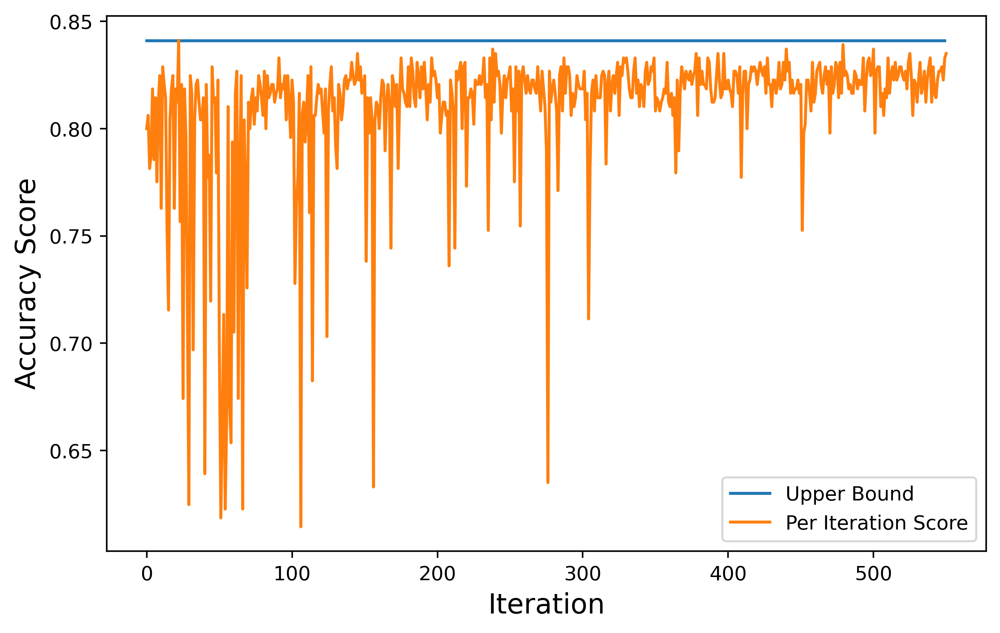

In [92]:
accE1=[]
for i in range(0,550):
    accE1.append(0.841)

plt.figure(figsize=(8,5),dpi=400)
plt.plot(accE1)
plt.plot(accE)
plt.xlabel('Iteration', fontsize=14)
plt.ylabel('Accuracy Score', fontsize=14)
plt.legend(['Upper Bound', 'Per Iteration Score'], loc='lower right')
plt.savefig("ETCit.pdf")

In [34]:
sol0L=[]
sol1L=[]
accL=[]
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)
def fitness_function(solution):
    print(solution)
    sol0L.append(solution[0])
    sol1L.append(solution[1])
    global dataFFeatures
    X =dataFFeatures
    y =  DataFTarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpF=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpF.append(X.columns[i])
    print(len(featuresimpF))

    global dataIFeatures
    X =dataIFeatures
    y =  DataITarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpI=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpI.append(X.columns[i])
    print(len(featuresimpI))
    dataIFeatures= dataIFeatures[featuresimpI]
    dataFFeatures= dataFFeatures[featuresimpF]

    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpI),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GI1=t_model.predict(dataIFeatures)


    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GF1=t_model.predict(dataFFeatures)
    
    dI=pd.DataFrame(GI1)
    dF=pd.DataFrame(GF1)
    
    ComFeat=dF.append(dI,ignore_index = True) 
    ComT=DataFTarget["Sub_Cat"].append(DataITarget["Sub_Cat"],ignore_index = True)


    X_train, X_test, y_train, y_test = train_test_split(ComFeat, ComT, test_size=0.15, random_state=1, stratify=ComT, shuffle=True)
    
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.linear_model import LogisticRegression
    solvr=['saga','sag','newton-cg', 'lbfgs']
    a=LogisticRegression(random_state=int(solution[2]), solver=solvr[int(solution[3])],multi_class='multinomial',C=int(solution[4]))
    #a =  ExtraTreesClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a =  RandomForestClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    a_pred = a.fit(X_train, y_train)
    pred=a_pred.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accL.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [90, 0.01, 10, 0,1],
    "ub": [2000, 0.03,300,3,10],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


#model = BasePSO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")

ETC
[1.28033414e+03 1.23957864e-02 1.40967001e+01 2.96653498e+00
 1.94946513e+00]
10
20


C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.71   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7628865979381443
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.63      0.48      0.55        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.43      0.46      0.44        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.72   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7793814432989691
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.58      0.56      0.57        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.75   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.81      0.65      0.72        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.74      0.80      0.77        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.28      0.35      0.31        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.78   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7938144329896907
                       precision    recall  f1-score   support

             Analysis       0.87      0.50      0.63        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.63      0.65      0.64        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.87   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.73      0.62      0.67        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.70      0.92      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.77      0.77      0.77        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.70      0.92      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.61      0.56      0.58        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.31      0.36        26
  Mirai-HTTP Flooding       0.39      0.62      0.48        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.80      0.92      0.86        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.83      0.77      0.80        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.78   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6783505154639176
                       precision    recall  f1-score   support

             Analysis       0.55      0.23      0.32        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.57      0.80      0.67        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.45      0.36      0.40        25
              Fuzzers       0.75      0.92      0.83        26
              Generic       0.62      0.92      0.74        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.35      0.27      0.30        26
  Mirai-HTTP Flooding       0.34      0.46      0.39        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0.69   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.81      0.84      0.82        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.39      0.42      0.41        26
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7896907216494845
                       precision    recall  f1-score   support

             Analysis       0.74      0.65      0.69        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.63      0.48      0.55        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      1.00      0.94        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7628865979381443
                       precision    recall  f1-score   support

             Analysis       0.77      0.38      0.51        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.48      0.40      0.43        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.47      0.54      0.50        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.80      0.77      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.37      0.42      0.39        26
  Mirai-HTTP Flooding       0.33      0.35      0.34        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7216494845360825
                       precision    recall  f1-score   support

             Analysis       0.70      0.27      0.39        26
             Backdoor       0.69      0.92      0.79        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.39      0.28      0.33        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       0.83      1.00      0.91        25
    MITM ARP Spoofing       0.79      0.92      0.85        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.94      0.65      0.77        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.83   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.756701030927835
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.58      0.56      0.57        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.44      0.46      0.45        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.78    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7876288659793814
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.72      0.92      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.61      0.56      0.58        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.78   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7484536082474227
                       precision    recall  f1-score   support

             Analysis       0.83      0.38      0.53        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.52      0.48      0.50        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.39      0.42      0.41        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7443298969072165
                       precision    recall  f1-score   support

             Analysis       0.77      0.38      0.51        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.40      0.44        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.63   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7855670103092783
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.44      0.58      0.50        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.86      0.73      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7546391752577319
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.50      0.44      0.47        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.44      0.46      0.45        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.75   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7855670103092783
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.57      0.52      0.54        25
              Fuzzers       0.88      0.88      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.38      0.46      0.41        26
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.92      0.96      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.46      0.50      0.48        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.71   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7505154639175258
                       precision    recall  f1-score   support

             Analysis       0.58      0.27      0.37        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.82      0.88      0.85        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.77      0.77      0.77        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.78   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7484536082474227
                       precision    recall  f1-score   support

             Analysis       0.80      0.31      0.44        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.40      0.44        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.46      0.44        26
  Mirai-HTTP Flooding       0.42      0.50      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7628865979381443
                       precision    recall  f1-score   support

             Analysis       0.81      0.50      0.62        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.44      0.46      0.45        26
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       1.00      0.80      0.89        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.79   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7876288659793814
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.58      0.56      0.57        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.42      0.42      0.42        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.79   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7422680412371134
                       precision    recall  f1-score   support

             Analysis       0.77      0.38      0.51        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.45      0.40      0.43        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.34      0.38      0.36        26
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.73      0.79        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.65   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.8
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.48      0.58      0.53        26
  Mirai-HTTP Flooding       0.48      0.50      0.49        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.73      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.73      0.64      0.

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7195876288659794
                       precision    recall  f1-score   support

             Analysis       0.78      0.27      0.40        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.46      0.48      0.47        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.82      0.92      0.87        25
    Mirai-Ackflooding       0.38      0.42      0.40        26
  Mirai-HTTP Flooding       0.31      0.31      0.31        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0.86   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7793814432989691
                       precision    recall  f1-score   support

             Analysis       0.81      0.65      0.72        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.41      0.50      0.45        26
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8020618556701031
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.35      0.27      0.30        26
  Mirai-HTTP Flooding       0.31      0.42      0.36        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.86   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.70      0.27      0.39        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.83      0.92      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.50      0.50      0.50        26
  Mirai-HTTP Flooding       0.44      0.58      0.50        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7835051546391752
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.52      0.48      0.50        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.50      0.50      0.50        26
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6371134020618556
                       precision    recall  f1-score   support

             Analysis       0.50      0.19      0.28        26
             Backdoor       0.70      0.88      0.78        26
                  DoS       0.44      0.96      0.60        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.43      0.24      0.31        25
              Fuzzers       0.74      0.77      0.75        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.88      0.86        25
    Mirai-Ackflooding       0.43      0.58      0.49        26
  Mirai-HTTP Flooding       0.27      0.27      0.27        26
Mirai-Hostbruteforceg       0.77      0.80      0.78        25
   Mirai-UDP Flooding       0.83      0.58      0.68        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.92      0.88      0.90        26
       Reconnaissance       0.33   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7793814432989691
                       precision    recall  f1-score   support

             Analysis       0.81      0.65      0.72        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.64      0.56      0.60        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.50      0.50      0.50        26
  Mirai-HTTP Flooding       0.43      0.50      0.46        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7855670103092783
                       precision    recall  f1-score   support

             Analysis       0.75      0.58      0.65        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.62      0.72      0.67        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.42      0.41        26
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.80   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.777319587628866
                       precision    recall  f1-score   support

             Analysis       0.81      0.50      0.62        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.66      0.76      0.70        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.74      0.77      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.74    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.83      0.38      0.53        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.68      0.92      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.44      0.49        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.50      0.46      0.48        26
  Mirai-HTTP Flooding       0.42      0.54      0.47        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7443298969072165
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.52      0.44      0.48        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0.72   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.96   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7793814432989691
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.64      0.56      0.60        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.27      0.33        26
  Mirai-HTTP Flooding       0.41      0.62      0.49        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.71   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7628865979381443
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.42      0.40        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7546391752577319
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.56      0.40      0.47        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.45      0.50      0.47        26
  Mirai-HTTP Flooding       0.48      0.54      0.51        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.81      0.88      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6701030927835051
                       precision    recall  f1-score   support

             Analysis       0.53      0.31      0.39        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.51      0.88      0.65        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.45      0.36      0.40        25
              Fuzzers       0.80      0.77      0.78        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.88      0.88      0.88        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0.39   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.87      0.50      0.63        26
             Backdoor       0.81      0.96      0.88        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.52      0.44      0.48        25
              Fuzzers       0.80      0.92      0.86        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.40      0.46      0.43        26
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7422680412371134
                       precision    recall  f1-score   support

             Analysis       0.73      0.31      0.43        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.48      0.49        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.45      0.54      0.49        26
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.68   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6948453608247422
                       precision    recall  f1-score   support

             Analysis       0.70      0.27      0.39        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.58      0.88      0.70        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.59      0.40      0.48        25
              Fuzzers       0.75      0.92      0.83        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.42      0.50      0.46        26
  Mirai-HTTP Flooding       0.35      0.27      0.30        26
Mirai-Hostbruteforceg       0.72      0.84      0.78        25
   Mirai-UDP Flooding       0.65      0.65      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.92      0.85      0.88        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.75   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6082474226804123
                       precision    recall  f1-score   support

             Analysis       0.67      0.15      0.25        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.43      0.92      0.59        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.33      0.24      0.28        25
              Fuzzers       0.88      0.58      0.70        26
              Generic       0.45      1.00      0.62        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.30      0.31      0.30        26
  Mirai-HTTP Flooding       0.34      0.46      0.39        26
Mirai-Hostbruteforceg       0.79      0.76      0.78        25
   Mirai-UDP Flooding       0.89      0.62      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.92      0.88      0.90        26
       Reconnaissance       0.30   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.80      0.46      0.59        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.48      0.58      0.53        26
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.78   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6329896907216495
                       precision    recall  f1-score   support

             Analysis       0.50      0.27      0.35        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.31      0.92      0.46        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.55      0.24      0.33        25
              Fuzzers       0.68      0.73      0.70        26
              Generic       0.96      0.92      0.94        25
    MITM ARP Spoofing       0.80      0.96      0.87        25
    Mirai-Ackflooding       0.45      0.50      0.47        26
  Mirai-HTTP Flooding       0.47      0.54      0.50        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.94      0.58      0.71        26
               Normal       0.89      0.96      0.93        26
             Normal_I       0.86      0.92      0.89        26
       Reconnaissance       0.15   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6721649484536083
                       precision    recall  f1-score   support

             Analysis       0.67      0.31      0.42        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.60      0.84      0.70        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.32      0.32      0.32        25
              Fuzzers       0.73      0.85      0.79        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.88      0.90        25
    Mirai-Ackflooding       0.34      0.50      0.41        26
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.83      0.80      0.82        25
   Mirai-UDP Flooding       0.68      0.58      0.62        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.95      0.77      0.85        26
       Reconnaissance       0.59   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7835051546391752
                       precision    recall  f1-score   support

             Analysis       0.81      0.50      0.62        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       0.96      0.96      0.96        25
             Exploits       0.62      0.40      0.49        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.36      0.38      0.37        26
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0.72   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7793814432989691
                       precision    recall  f1-score   support

             Analysis       0.85      0.65      0.74        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.77   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.756701030927835
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.48      0.44      0.46        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.62      0.38      0.48        26
  Mirai-HTTP Flooding       0.40      0.65      0.50        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.67    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6762886597938145
                       precision    recall  f1-score   support

             Analysis       0.58      0.27      0.37        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.49      0.88      0.63        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.48      0.40      0.43        25
              Fuzzers       0.96      0.85      0.90        26
              Generic       0.71      1.00      0.83        25
    MITM ARP Spoofing       0.92      0.88      0.90        25
    Mirai-Ackflooding       0.39      0.54      0.45        26
  Mirai-HTTP Flooding       0.37      0.27      0.31        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.70      0.62      0.65        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.86      0.92      0.89        26
       Reconnaissance       0.43   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.77      0.92      0.84        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7484536082474227
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.61      0.92      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.38      0.38        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.79   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7628865979381443
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.68      0.92      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.52      0.48      0.50        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.42      0.50      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.734020618556701
                       precision    recall  f1-score   support

             Analysis       0.75      0.35      0.47        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.48      0.40      0.43        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.90      0.73      0.81        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.87      1.00      0.93        26
       Reconnaissance       0.60    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608247422680412
                       precision    recall  f1-score   support

             Analysis       0.77      0.38      0.51        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.56      0.40      0.47        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.756701030927835
                       precision    recall  f1-score   support

             Analysis       0.77      0.38      0.51        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.40      0.44        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.41      0.54      0.47        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.95      0.73      0.83        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.71    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.80      0.46      0.59        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.64      0.92      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.65      0.60      0.63        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.54      0.47        26
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.95      0.73      0.83        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.77      0.38      0.51        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.45      0.40      0.43        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.83      0.77      0.80        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.756701030927835
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.70      0.92      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.46      0.48      0.47        25
              Fuzzers       0.82      0.88      0.85        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.44      0.58      0.50        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.84      0.62      0.71        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.688659793814433
                       precision    recall  f1-score   support

             Analysis       0.71      0.38      0.50        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.44      0.88      0.59        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.36      0.42        25
              Fuzzers       0.85      0.88      0.87        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.38      0.42      0.40        26
  Mirai-HTTP Flooding       0.36      0.38      0.37        26
Mirai-Hostbruteforceg       0.75      0.84      0.79        25
   Mirai-UDP Flooding       0.94      0.65      0.77        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.88      0.85      0.86        26
       Reconnaissance       0.64    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.83      0.38      0.53        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.52      0.54        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608247422680412
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.62      0.92      0.74        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.44      0.47        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.79   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7958762886597938
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.54      0.52      0.53        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.50      0.46      0.48        26
  Mirai-HTTP Flooding       0.45      0.58      0.51        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.80   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7855670103092783
                       precision    recall  f1-score   support

             Analysis       0.74      0.65      0.69        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.62      0.60      0.61        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.77      0.38      0.51        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.50      0.46        26
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.64   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7402061855670103
                       precision    recall  f1-score   support

             Analysis       0.77      0.38      0.51        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.72      0.84      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.54      0.52      0.53        25
              Fuzzers       0.92      0.85      0.88        26
              Generic       0.89      1.00      0.94        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.34      0.38      0.36        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.53      0.40      0.45        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.42      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6804123711340206
                       precision    recall  f1-score   support

             Analysis       0.77      0.38      0.51        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.49      0.80      0.61        25
      DoS-Synflooding       0.96      0.96      0.96        25
             Exploits       0.42      0.32      0.36        25
              Fuzzers       0.82      0.88      0.85        26
              Generic       0.83      1.00      0.91        25
    MITM ARP Spoofing       0.91      0.84      0.87        25
    Mirai-Ackflooding       0.31      0.31      0.31        26
  Mirai-HTTP Flooding       0.42      0.54      0.47        26
Mirai-Hostbruteforceg       0.74      0.80      0.77        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.88      0.94        26
             Normal_I       1.00      0.81      0.89        26
       Reconnaissance       0.61   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7793814432989691
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7505154639175258
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.45      0.40      0.43        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.38      0.38      0.38        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.71   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6556701030927835
                       precision    recall  f1-score   support

             Analysis       0.71      0.19      0.30        26
             Backdoor       0.71      0.96      0.82        26
                  DoS       0.48      0.88      0.62        25
      DoS-Synflooding       0.96      0.96      0.96        25
             Exploits       0.37      0.28      0.32        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.87      0.80      0.83        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.88      0.94        26
             Normal_I       0.83      0.77      0.80        26
       Reconnaissance       0.30   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7381443298969073
                       precision    recall  f1-score   support

             Analysis       0.82      0.35      0.49        26
             Backdoor       0.76      0.96      0.85        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.43      0.40      0.42        25
              Fuzzers       0.85      0.85      0.85        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.50      0.46        26
  Mirai-HTTP Flooding       0.48      0.54      0.51        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.75   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.88      0.86        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.85      0.65      0.74        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.76      0.76      0.76        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.40      0.46      0.43        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.76      0.62      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       1.00      1.00      1.00        26
       Reconnaissance       0.78   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7855670103092783
                       precision    recall  f1-score   support

             Analysis       0.74      0.65      0.69        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7525773195876289
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.44      0.49        25
              Fuzzers       0.83      0.92      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.37      0.42      0.39        26
  Mirai-HTTP Flooding       0.29      0.31      0.30        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.65      0.42      0.51        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.52      0.48      0.50        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6845360824742268
                       precision    recall  f1-score   support

             Analysis       0.47      0.31      0.37        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.54      0.88      0.67        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.44      0.44      0.44        25
              Fuzzers       0.76      0.85      0.80        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       1.00      0.96      0.98        25
    Mirai-Ackflooding       0.32      0.35      0.33        26
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.85      0.92      0.88        25
   Mirai-UDP Flooding       0.61      0.65      0.63        26
               Normal       1.00      0.88      0.94        26
             Normal_I       0.91      0.81      0.86        26
       Reconnaissance       0.64   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.76      0.62      0.68        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.33      0.31      0.32        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.68   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7793814432989691
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.58      0.56      0.57        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.71   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7360824742268042
                       precision    recall  f1-score   support

             Analysis       0.62      0.58      0.60        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.64      0.92      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.37      0.40      0.38        25
              Fuzzers       0.78      0.81      0.79        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.37      0.42      0.39        26
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.71   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7793814432989691
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.77   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7876288659793814
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.46      0.44        26
  Mirai-HTTP Flooding       0.35      0.35      0.35        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.78   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7360824742268042
                       precision    recall  f1-score   support

             Analysis       0.64      0.62      0.63        26
             Backdoor       0.88      0.85      0.86        26
                  DoS       0.74      0.92      0.82        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.48      0.60      0.54        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.92      0.92      0.92        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7298969072164948
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.84      0.81      0.82        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.43      0.48      0.45        25
              Fuzzers       0.79      0.88      0.84        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       0.80      0.62      0.70        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0.71   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.69      0.88      0.77        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7319587628865979
                       precision    recall  f1-score   support

             Analysis       0.78      0.27      0.40        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.68      0.92      0.78        25
      DoS-Synflooding       0.96      0.92      0.94        25
             Exploits       0.62      0.32      0.42        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.34      0.38      0.36        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       0.96      0.96      0.96        26
             Normal_I       0.92      0.88      0.90        26
       Reconnaissance       0.68   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7237113402061855
                       precision    recall  f1-score   support

             Analysis       0.68      0.58      0.62        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.43      0.48      0.45        25
              Fuzzers       0.85      0.88      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       0.92      0.96      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.89      0.92      0.91        26
       Reconnaissance       0.58   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.75      0.58      0.65        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.69      0.80      0.74        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.87   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.42      0.31      0.36        26
  Mirai-HTTP Flooding       0.33      0.42      0.37        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7793814432989691
                       precision    recall  f1-score   support

             Analysis       0.75      0.58      0.65        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.58      0.60      0.59        25
              Fuzzers       0.82      0.88      0.85        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.79   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6989690721649484
                       precision    recall  f1-score   support

             Analysis       0.69      0.35      0.46        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.49      0.88      0.63        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.53      0.32      0.40        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       0.89      1.00      0.94        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0.43   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.62      0.60      0.61        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.72   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7505154639175258
                       precision    recall  f1-score   support

             Analysis       0.80      0.31      0.44        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.40      0.44        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.41      0.54      0.47        26
Mirai-Hostbruteforceg       0.92      0.96      0.94        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7463917525773196
                       precision    recall  f1-score   support

             Analysis       0.75      0.35      0.47        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.52      0.48      0.50        25
              Fuzzers       0.80      0.92      0.86        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.43      0.58      0.49        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.89      0.62      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.71   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6536082474226804
                       precision    recall  f1-score   support

             Analysis       0.80      0.31      0.44        26
             Backdoor       0.71      0.92      0.80        26
                  DoS       0.43      0.88      0.58        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.27      0.16      0.20        25
              Fuzzers       0.70      0.62      0.65        26
              Generic       0.81      1.00      0.89        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.46      0.62      0.52        26
Mirai-Hostbruteforceg       0.81      0.88      0.85        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.88      0.94        26
             Normal_I       0.85      0.88      0.87        26
       Reconnaissance       0.52   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6762886597938145
                       precision    recall  f1-score   support

             Analysis       0.60      0.23      0.33        26
             Backdoor       0.72      1.00      0.84        26
                  DoS       0.59      0.88      0.71        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.38      0.24      0.29        25
              Fuzzers       0.54      0.77      0.63        26
              Generic       0.86      1.00      0.93        25
    MITM ARP Spoofing       0.92      0.88      0.90        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0.57   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.77      0.65      0.71        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7278350515463917
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       0.96      0.96      0.96        25
             Exploits       0.47      0.56      0.51        25
              Fuzzers       0.86      0.73      0.79        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.88      0.90        25
    Mirai-Ackflooding       0.48      0.50      0.49        26
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.92      0.96      0.94        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.85      0.92        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0.65   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.777319587628866
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.61      0.56      0.58        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.42      0.50      0.46        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.76      0.73      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.71    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.777319587628866
                       precision    recall  f1-score   support

             Analysis       0.74      0.54      0.62        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.58      0.60      0.59        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.71    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7628865979381443
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.64      0.92      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.50      0.54      0.52        26
  Mirai-HTTP Flooding       0.48      0.58      0.53        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.68   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.52      0.42      0.47        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608247422680412
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.52      0.48      0.50        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.42      0.50      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7443298969072165
                       precision    recall  f1-score   support

             Analysis       0.63      0.46      0.53        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.44      0.47        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.42      0.31      0.36        26
  Mirai-HTTP Flooding       0.35      0.50      0.41        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.65   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.75      0.58      0.65        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.36      0.50      0.42        26
  Mirai-HTTP Flooding       0.39      0.27      0.32        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.52      0.48      0.50        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.43      0.46      0.44        26
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.68   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7628865979381443
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.41      0.46      0.44        26
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6804123711340206
                       precision    recall  f1-score   support

             Analysis       0.78      0.27      0.40        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.51      0.88      0.65        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.26      0.24      0.25        25
              Fuzzers       0.68      0.73      0.70        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.79      0.92      0.85        25
    Mirai-Ackflooding       0.37      0.27      0.31        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.59   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.77      0.38      0.51        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.59      0.88      0.71        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.50      0.35      0.41        26
  Mirai-HTTP Flooding       0.44      0.58      0.50        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7484536082474227
                       precision    recall  f1-score   support

             Analysis       0.71      0.38      0.50        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.53      0.40      0.45        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.46      0.44        26
  Mirai-HTTP Flooding       0.46      0.50      0.48        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.72   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7628865979381443
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.61      0.56      0.58        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7154639175257732
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.54      0.88      0.67        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.46      0.48      0.47        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       0.83      1.00      0.91        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.86      0.96      0.91        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.89      0.96      0.93        26
       Reconnaissance       0.50   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7876288659793814
                       precision    recall  f1-score   support

             Analysis       0.81      0.50      0.62        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.74      0.92      0.82        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.52      0.54        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.86   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.6804123711340206
                       precision    recall  f1-score   support

             Analysis       0.78      0.27      0.40        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.43      0.88      0.58        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.36      0.32      0.34        25
              Fuzzers       0.77      0.77      0.77        26
              Generic       0.83      1.00      0.91        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.35      0.42      0.39        26
  Mirai-HTTP Flooding       0.50      0.58      0.54        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       0.79      0.58      0.67        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.96      0.85      0.90        26
       Reconnaissance       0.64   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7793814432989691
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.68      0.92      0.78        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7876288659793814
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.63      0.48      0.55        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.79   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.777319587628866
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.62      0.60      0.61        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.44      0.54      0.48        26
  Mirai-HTTP Flooding       0.52      0.46      0.49        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.80    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.73      0.62      0.67        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.42      0.42        26
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.777319587628866
                       precision    recall  f1-score   support

             Analysis       0.75      0.58      0.65        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.38      0.42      0.40        26
  Mirai-HTTP Flooding       0.32      0.35      0.33        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.67    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.77      0.65      0.71        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.42      0.42        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.68   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.70      0.92      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.58      0.56      0.57        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.38      0.37        26
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7855670103092783
                       precision    recall  f1-score   support

             Analysis       0.75      0.58      0.65        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.48      0.50      0.49        26
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7835051546391752
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.64      0.56      0.60        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.44      0.46      0.45        26
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.77   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6391752577319587
                       precision    recall  f1-score   support

             Analysis       0.78      0.27      0.40        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.23      0.12      0.16        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.31      0.16      0.21        25
              Fuzzers       0.68      0.73      0.70        26
              Generic       0.41      1.00      0.58        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.43      0.58      0.49        26
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.95      0.80      0.87        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0.45   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.50      0.40      0.44        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.777319587628866
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.37      0.42      0.39        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.76    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7525773195876289
                       precision    recall  f1-score   support

             Analysis       0.67      0.31      0.42        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.64      0.92      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.53      0.40      0.45        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.80   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.59      0.92      0.72        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.52      0.48      0.50        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.50      0.46      0.48        26
  Mirai-HTTP Flooding       0.43      0.50      0.46        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.71      0.58      0.64        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.756701030927835
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      1.00      0.94        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.74    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7463917525773196
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.52      0.51        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.45      0.58      0.51        26
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.89      0.96      0.92        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.52      0.42      0.47        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7298969072164948
                       precision    recall  f1-score   support

             Analysis       0.61      0.42      0.50        26
             Backdoor       0.81      0.85      0.83        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.38      0.40      0.39        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.42      0.50      0.46        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.68   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7319587628865979
                       precision    recall  f1-score   support

             Analysis       0.63      0.46      0.53        26
             Backdoor       0.81      0.85      0.83        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.44      0.48      0.46        25
              Fuzzers       0.85      0.88      0.87        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.34      0.38      0.36        26
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.87      0.77      0.82        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.71   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.76      0.62      0.68        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.87   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.76      0.73      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.87   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7298969072164948
                       precision    recall  f1-score   support

             Analysis       0.69      0.35      0.46        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.42      0.40      0.41        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.34      0.46      0.39        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7505154639175258
                       precision    recall  f1-score   support

             Analysis       0.82      0.35      0.49        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.46      0.44      0.45        25
              Fuzzers       0.80      0.92      0.86        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.52      0.50      0.51        26
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.86      0.46      0.60        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.68      0.92      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.43      0.46      0.44        26
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       0.81      0.65      0.72        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.76      0.76      0.76        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.80   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7525773195876289
                       precision    recall  f1-score   support

             Analysis       0.71      0.38      0.50        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.40      0.44        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7546391752577319
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.52      0.48      0.50        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.96      0.98        25
    Mirai-Ackflooding       0.35      0.35      0.35        26
  Mirai-HTTP Flooding       0.33      0.42      0.37        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.44      0.46      0.45        26
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.777319587628866
                       precision    recall  f1-score   support

             Analysis       0.73      0.62      0.67        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.46      0.44        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.73      0.79        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.76    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7525773195876289
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.75   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7298969072164948
                       precision    recall  f1-score   support

             Analysis       0.81      0.50      0.62        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.31      0.35      0.33        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.65   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7278350515463917
                       precision    recall  f1-score   support

             Analysis       0.78      0.27      0.40        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.45      0.40      0.43        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7072164948453609
                       precision    recall  f1-score   support

             Analysis       0.60      0.35      0.44        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       0.96      0.92      0.94        25
             Exploits       0.44      0.44      0.44        25
              Fuzzers       0.78      0.81      0.79        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.84      0.81      0.82        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7505154639175258
                       precision    recall  f1-score   support

             Analysis       0.81      0.50      0.62        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.62      0.92      0.74        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.76      0.73      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.63   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.44      0.46      0.45        26
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7793814432989691
                       precision    recall  f1-score   support

             Analysis       0.75      0.58      0.65        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.41      0.54      0.47        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.71   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7298969072164948
                       precision    recall  f1-score   support

             Analysis       0.83      0.38      0.53        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       0.96      0.96      0.96        25
             Exploits       0.46      0.48      0.47        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.96      0.98        25
    Mirai-Ackflooding       0.43      0.46      0.44        26
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.89      0.96      0.93        26
       Reconnaissance       0.71   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7381443298969073
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       0.96      0.96      0.96        25
             Exploits       0.43      0.48      0.45        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.44      0.46      0.45        26
  Mirai-HTTP Flooding       0.46      0.50      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.88      0.81      0.84        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.89      0.96      0.93        26
       Reconnaissance       0.63   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.71      0.38      0.50        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.83      0.92      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7628865979381443
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.64      0.92      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.40      0.44        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.42      0.54      0.47        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.68   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7237113402061855
                       precision    recall  f1-score   support

             Analysis       0.70      0.27      0.39        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.48      0.40      0.43        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.46      0.42        26
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.89      0.96      0.93        26
       Reconnaissance       0.50   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.83      0.96      0.89        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.41      0.46      0.44        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.80      0.89        25
   Mirai-UDP Flooding       0.75      0.58      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.58      0.49        26
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7298969072164948
                       precision    recall  f1-score   support

             Analysis       0.82      0.35      0.49        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.48      0.40      0.43        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.38      0.38      0.38        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.75   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7958762886597938
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.62      0.60      0.61        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.44      0.54      0.48        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.75      0.72      0.73        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.34      0.46      0.39        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7525773195876289
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.64      0.92      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.44      0.47        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.42      0.54      0.47        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.88      0.84      0.86        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.50      0.35      0.41        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.95      0.80      0.87        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.75   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.64      0.72      0.68        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.32      0.42      0.37        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.83   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7051546391752578
                       precision    recall  f1-score   support

             Analysis       0.60      0.46      0.52        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.55      0.88      0.68        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.46      0.48      0.47        25
              Fuzzers       0.79      0.73      0.76        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.36      0.38      0.37        26
  Mirai-HTTP Flooding       0.33      0.35      0.34        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.50   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7855670103092783
                       precision    recall  f1-score   support

             Analysis       0.76      0.62      0.68        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6989690721649484
                       precision    recall  f1-score   support

             Analysis       0.67      0.31      0.42        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.48      0.48      0.48        25
              Fuzzers       0.91      0.81      0.86        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.88      0.88      0.88        25
    Mirai-Ackflooding       0.36      0.38      0.37        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.70      0.76      0.73        25
   Mirai-UDP Flooding       0.73      0.62      0.67        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.92      0.92      0.92        26
       Reconnaissance       0.75   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.76      0.62      0.68        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.87   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7360824742268042
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.85      0.85      0.85        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.43      0.48      0.45        25
              Fuzzers       0.85      0.88      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.48      0.58      0.53        26
  Mirai-HTTP Flooding       0.48      0.46      0.47        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.68   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.33      0.42      0.37        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.81      0.88      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       0.95      0.80      0.87        25
   Mirai-UDP Flooding       0.65      0.65      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.89      0.96      0.93        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.74      0.80      0.77        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.32      0.35      0.33        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.92   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7505154639175258
                       precision    recall  f1-score   support

             Analysis       0.65      0.58      0.61        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.70      0.92      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.45      0.40      0.43        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.85      0.85      0.85        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7298969072164948
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.88      0.88      0.88        26
                  DoS       0.57      0.92      0.71        25
      DoS-Synflooding       0.96      0.96      0.96        25
             Exploits       0.39      0.44      0.42        25
              Fuzzers       0.80      0.77      0.78        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.45      0.54      0.49        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.80      0.77      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0.60   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.80      0.78        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.50      0.42      0.46        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.32      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6412371134020619
                       precision    recall  f1-score   support

             Analysis       0.70      0.27      0.39        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.46      0.88      0.60        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.47      0.36      0.41        25
              Fuzzers       0.74      0.77      0.75        26
              Generic       0.81      1.00      0.89        25
    MITM ARP Spoofing       0.83      0.80      0.82        25
    Mirai-Ackflooding       0.31      0.35      0.33        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.87      0.80      0.83        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.87      1.00      0.93        26
       Reconnaissance       0.36   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.29      0.35      0.32        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.50      0.46      0.48        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.80      0.78        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.81    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7298969072164948
                       precision    recall  f1-score   support

             Analysis       0.88      0.27      0.41        26
             Backdoor       0.76      0.96      0.85        26
                  DoS       0.56      0.96      0.71        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.32      0.39        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.39      0.42      0.41        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.75   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6639175257731958
                       precision    recall  f1-score   support

             Analysis       0.58      0.27      0.37        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.52      0.88      0.66        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.40      0.24      0.30        25
              Fuzzers       0.74      0.77      0.75        26
              Generic       0.81      1.00      0.89        25
    MITM ARP Spoofing       0.88      0.88      0.88        25
    Mirai-Ackflooding       0.38      0.46      0.41        26
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       0.84      0.62      0.71        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.82      0.88      0.85        26
       Reconnaissance       0.60   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7525773195876289
                       precision    recall  f1-score   support

             Analysis       0.67      0.38      0.49        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.52      0.44      0.48        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.33      0.35      0.34        26
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7505154639175258
                       precision    recall  f1-score   support

             Analysis       0.73      0.31      0.43        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.40      0.44        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.44      0.58      0.50        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.86      0.73      0.79        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.59   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7525773195876289
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.64      0.92      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.79   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.47      0.54      0.50        26
  Mirai-HTTP Flooding       0.52      0.54      0.53        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7793814432989691
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7546391752577319
                       precision    recall  f1-score   support

             Analysis       0.80      0.46      0.59        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.68      0.92      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.56      0.40      0.47        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.54      0.58      0.56        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.84      0.62      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.86      0.96      0.91        26
       Reconnaissance       0.65   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7505154639175258
                       precision    recall  f1-score   support

             Analysis       0.69      0.35      0.46        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.59      0.88      0.71        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.52      0.48      0.50        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.34      0.46      0.39        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7237113402061855
                       precision    recall  f1-score   support

             Analysis       0.62      0.38      0.48        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.50      0.36      0.42        25
              Fuzzers       0.77      0.88      0.82        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.32      0.31      0.31        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       0.85      0.92      0.88        25
   Mirai-UDP Flooding       0.94      0.62      0.74        26
               Normal       1.00      0.88      0.94        26
             Normal_I       0.86      0.96      0.91        26
       Reconnaissance       0.62   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7628865979381443
                       precision    recall  f1-score   support

             Analysis       0.71      0.38      0.50        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.64      0.92      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.44      0.49        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.45      0.54      0.49        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.86      0.73      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.62   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7546391752577319
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.58      0.56      0.57        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.50      0.42      0.46        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.75   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7876288659793814
                       precision    recall  f1-score   support

             Analysis       0.77      0.65      0.71        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.50      0.42      0.46        26
  Mirai-HTTP Flooding       0.42      0.54      0.47        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.71   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7546391752577319
                       precision    recall  f1-score   support

             Analysis       0.82      0.35      0.49        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.48      0.40      0.43        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.42      0.42        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.79   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.756701030927835
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.25      0.12      0.16        26
  Mirai-HTTP Flooding       0.32      0.46      0.37        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.63      0.73      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.30      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.44      0.46      0.45        26
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.75      0.58      0.65        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.33      0.31      0.32        26
  Mirai-HTTP Flooding       0.44      0.58      0.50        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.61   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7835051546391752
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.62      0.52      0.57        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.79   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.63      0.46      0.53        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.59      0.52      0.55        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7422680412371134
                       precision    recall  f1-score   support

             Analysis       0.83      0.38      0.53        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0.65   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.75      0.58      0.65        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.63      0.48      0.55        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.87      1.00      0.93        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.68      0.92      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.78   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6824742268041237
                       precision    recall  f1-score   support

             Analysis       0.36      0.31      0.33        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.25      0.12      0.16        25
              Fuzzers       0.70      0.88      0.78        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       1.00      0.88      0.94        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.81      0.96      0.88        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.75      0.58      0.65        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.38      0.37        26
  Mirai-HTTP Flooding       0.43      0.50      0.46        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608247422680412
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.39      0.46      0.42        26
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.52      0.48      0.50        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.42      0.50      0.46        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.92      0.96      0.94        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.75   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7855670103092783
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.72      0.72      0.72        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.38      0.38      0.38        26
  Mirai-HTTP Flooding       0.28      0.31      0.29        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.75   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       0.89      0.65      0.76        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.69      0.72      0.71        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.74      0.80      0.77        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.92      0.96      0.94        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.86   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.68      0.73      0.70        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.80      0.78        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.30      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.85      0.65      0.74        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.80      0.78        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.32      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8371134020618557
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7958762886597938
                       precision    recall  f1-score   support

             Analysis       0.81      0.65      0.72        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.65      0.52      0.58        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.81      0.88      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.38      0.38      0.38        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.80   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.60      0.69      0.64        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      1.00      1.00        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.33      0.42      0.37        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.42      0.42      0.42        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7525773195876289
                       precision    recall  f1-score   support

             Analysis       0.64      0.62      0.63        26
             Backdoor       0.88      0.85      0.86        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.56      0.53        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.43      0.50      0.46        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0.65   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.92   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7381443298969073
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.88      0.85      0.86        26
                  DoS       0.61      0.92      0.73        25
      DoS-Synflooding       0.96      0.96      0.96        25
             Exploits       0.48      0.44      0.46        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.45      0.54      0.49        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.88      0.81      0.84        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.87    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.89      0.65      0.76        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.72      0.84      0.78        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.81      0.88      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.44      0.31      0.36        26
  Mirai-HTTP Flooding       0.33      0.46      0.39        26
Mirai-Hostbruteforceg       0.95      0.80      0.87        25
   Mirai-UDP Flooding       0.62      0.62      0.62        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7402061855670103
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.64      0.92      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.46      0.44      0.45        25
              Fuzzers       0.88      0.88      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.48      0.54      0.51        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.55   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.83      0.92      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7835051546391752
                       precision    recall  f1-score   support

             Analysis       0.81      0.65      0.72        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.46      0.62      0.52        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.89      0.65      0.76        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.74      0.80      0.77        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.709278350515464
                       precision    recall  f1-score   support

             Analysis       0.88      0.27      0.41        26
             Backdoor       0.76      0.96      0.85        26
                  DoS       0.51      0.92      0.66        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.44      0.32      0.37        25
              Fuzzers       0.88      0.88      0.88        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.79      0.92      0.85        25
    Mirai-Ackflooding       0.43      0.50      0.46        26
  Mirai-HTTP Flooding       0.44      0.54      0.48        26
Mirai-Hostbruteforceg       0.86      0.76      0.81        25
   Mirai-UDP Flooding       0.94      0.62      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0.56    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.67      0.38      0.49        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.46      0.44        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.75   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7484536082474227
                       precision    recall  f1-score   support

             Analysis       0.77      0.38      0.51        26
             Backdoor       0.76      0.96      0.85        26
                  DoS       0.62      0.92      0.74        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.56      0.40      0.47        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.37      0.42      0.39        26
  Mirai-HTTP Flooding       0.44      0.54      0.48        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       1.00      1.00      1.00        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.68      0.92      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.41      0.27      0.33        26
  Mirai-HTTP Flooding       0.35      0.54      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.68      0.92      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.41      0.46      0.44        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8
                       precision    recall  f1-score   support

             Analysis       0.76      0.62      0.68        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.65      0.68      0.67        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.86      0.72      0.

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.76      0.62      0.68        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.36      0.38      0.37        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.756701030927835
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.53      0.40      0.45        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.42      0.42        26
  Mirai-HTTP Flooding       0.42      0.50      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.72    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.73      0.31      0.43        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.53      0.40      0.45        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.56      0.40      0.47        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.46      0.62      0.52        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.777319587628866
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.68      0.92      0.78        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.38      0.23      0.29        26
  Mirai-HTTP Flooding       0.38      0.58      0.45        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.71    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7484536082474227
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.40      0.44        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.36      0.38      0.37        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.74      0.54      0.62        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.47      0.54      0.50        26
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.75   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7381443298969073
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.81      0.85      0.83        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.44      0.48      0.46        25
              Fuzzers       0.83      0.92      0.87        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.39      0.46      0.42        26
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.80      0.46      0.59        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.86   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.81      0.50      0.62        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.52      0.48      0.50        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.41      0.54      0.47        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.80   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.6494845360824743
                       precision    recall  f1-score   support

             Analysis       1.00      0.27      0.42        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.40      0.92      0.56        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.35      0.28      0.31        25
              Fuzzers       0.83      0.73      0.78        26
              Generic       0.66      0.84      0.74        25
    MITM ARP Spoofing       0.83      0.80      0.82        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.89      0.62      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.87      1.00      0.93        26
       Reconnaissance       0.50   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.81      0.50      0.62        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.63      0.48      0.55        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.50      0.50      0.50        26
  Mirai-HTTP Flooding       0.33      0.35      0.34        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.64      0.69      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.64      0.69      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.29      0.31      0.30        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7319587628865979
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.88      0.85      0.86        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.46      0.48      0.47        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.43      0.50      0.46        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.68   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.27      0.31      0.29        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.29      0.35      0.32        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.63      0.65      0.64        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.85      0.65      0.74        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.41      0.54      0.47        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.87   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.33      0.35      0.34        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.756701030927835
                       precision    recall  f1-score   support

             Analysis       0.62      0.58      0.60        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.52      0.52      0.52        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.67    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.88      0.92      0.90        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.86      0.96      0.91        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.87   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.31      0.31      0.31        26
  Mirai-HTTP Flooding       0.26      0.31      0.28        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.75      0.58      0.65        26
             Backdoor       0.79      0.85      0.81        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.46      0.44        26
  Mirai-HTTP Flooding       0.29      0.31      0.30        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.92    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.28      0.35      0.31        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.68      0.73      0.70        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.81      0.50      0.62        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.50      0.42      0.46        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.45      0.50      0.47        26
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.80   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.734020618556701
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.70      0.92      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.39      0.48      0.43        25
              Fuzzers       0.84      0.81      0.82        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.41      0.46      0.44        26
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.92      0.96      0.94        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0.69    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.756701030927835
                       precision    recall  f1-score   support

             Analysis       0.80      0.46      0.59        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.62      0.92      0.74        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.40      0.44        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.47      0.54      0.50        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.68    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       0.71      0.58      0.64        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.50      0.46        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7938144329896907
                       precision    recall  f1-score   support

             Analysis       0.81      0.65      0.72        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.50      0.46      0.48        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.75   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.797938144329897
                       precision    recall  f1-score   support

             Analysis       0.76      0.62      0.68        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.96      0.98        25
    Mirai-Ackflooding       0.52      0.58      0.55        26
  Mirai-HTTP Flooding       0.46      0.50      0.48        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.86      0.73      0.79        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.68    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.58      0.44      0.50        25
              Fuzzers       0.80      0.92      0.86        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7958762886597938
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.67      0.56      0.61        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.69   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.777319587628866
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.50      0.58      0.54        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.62    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7917525773195876
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.62      0.52      0.57        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.71   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.71      0.88      0.79        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.50      0.38      0.43        26
  Mirai-HTTP Flooding       0.41      0.54      0.47        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.91    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7195876288659794
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.88      0.85      0.86        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.40      0.40      0.40        25
              Fuzzers       0.88      0.88      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.39      0.42      0.41        26
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.65   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.50      0.44      0.47        25
              Fuzzers       0.82      0.88      0.85        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.76      0.62      0.68        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7484536082474227
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.48      0.48      0.48        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.43      0.50      0.46        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.59   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.62   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.777319587628866
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.50      0.46      0.48        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.75    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.83   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.92   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.73      0.62      0.67        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.47      0.35      0.40        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.92   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.81      0.65      0.72        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.71      0.68      0.69        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.45      0.35      0.39        26
  Mirai-HTTP Flooding       0.35      0.50      0.41        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.79   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.34      0.46      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.88      0.86        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.38      0.42      0.40        26
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       1.00      1.00      1.00        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.35      0.50      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.91    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.83      0.96      0.89        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.34      0.46      0.39        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.92   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.797938144329897
                       precision    recall  f1-score   support

             Analysis       0.86      0.46      0.60        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.39      0.27      0.32        26
  Mirai-HTTP Flooding       0.27      0.35      0.31        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.62      0.69      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.74      0.54      0.62        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      1.00      0.94        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.83   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.42      0.31      0.36        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.80   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.76      0.73      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.35      0.35      0.35        26
  Mirai-HTTP Flooding       0.28      0.31      0.29        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.28      0.31      0.29        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.83      0.96      0.89        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      1.00      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.81      0.50      0.62        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.28      0.35      0.31        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.70      0.62      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.33      0.35      0.34        26
  Mirai-HTTP Flooding       0.26      0.27      0.26        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.33      0.42      0.37        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8391752577319588
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.32      0.31      0.31        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.48      0.40      0.43        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.38      0.42      0.40        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.65   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7463917525773196
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.61      0.88      0.72        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.48      0.40      0.43        25
              Fuzzers       0.80      0.92      0.86        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       0.75      0.58      0.65        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.41      0.46      0.44        26
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6969072164948453
                       precision    recall  f1-score   support

             Analysis       0.61      0.54      0.57        26
             Backdoor       0.85      0.85      0.85        26
                  DoS       0.50      0.88      0.64        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.53      0.40      0.45        25
              Fuzzers       0.82      0.88      0.85        26
              Generic       0.86      1.00      0.93        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.50      0.46        26
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.91      0.80      0.85        25
   Mirai-UDP Flooding       0.63      0.65      0.64        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.89      0.96      0.93        26
       Reconnaissance       0.59   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.75      0.58      0.65        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.71   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8041237113402062
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.73      0.76      0.75        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.83   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.777319587628866
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.50      0.42      0.46        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.73    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6865979381443299
                       precision    recall  f1-score   support

             Analysis       0.64      0.27      0.38        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.46      0.88      0.60        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.33      0.12      0.18        25
              Fuzzers       0.77      0.88      0.82        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.81      0.88      0.85        25
    Mirai-Ackflooding       0.52      0.50      0.51        26
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.81      0.88      0.85        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.89      0.96      0.93        26
       Reconnaissance       0.50   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.777319587628866
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.52      0.46      0.49        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.62    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.77   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.91      0.38      0.54        26
             Backdoor       0.76      0.96      0.85        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.44      0.46      0.45        26
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.75      0.46      0.57        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.68      0.92      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7835051546391752
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.58      0.56      0.57        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7360824742268042
                       precision    recall  f1-score   support

             Analysis       0.59      0.38      0.47        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.53      0.40      0.45        25
              Fuzzers       0.81      0.85      0.83        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.54      0.27      0.36        26
  Mirai-HTTP Flooding       0.38      0.62      0.47        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.80   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.39      0.42      0.41        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.92      0.96      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.87    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8371134020618557
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.96      0.98        25
    Mirai-Ackflooding       0.50      0.42      0.46        26
  Mirai-HTTP Flooding       0.33      0.46      0.39        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.734020618556701
                       precision    recall  f1-score   support

             Analysis       0.67      0.38      0.49        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.41      0.44      0.42        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.78      0.81      0.79        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.67    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.87   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.81      0.84      0.82        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7360824742268042
                       precision    recall  f1-score   support

             Analysis       0.71      0.46      0.56        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.42      0.44      0.43        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.40      0.46      0.43        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.87      0.77      0.82        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.84      0.84      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7917525773195876
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.72      0.92      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.62      0.64      0.63        25
              Fuzzers       0.83      0.92      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.86   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.29      0.35      0.32        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.85      0.65      0.74        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.80      0.78        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.50      0.42      0.46        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.86   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7463917525773196
                       precision    recall  f1-score   support

             Analysis       0.73      0.62      0.67        26
             Backdoor       0.88      0.88      0.88        26
                  DoS       0.68      0.92      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.46      0.48      0.47        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.70      0.81      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.30      0.31      0.30        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.64      0.69      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.91    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7546391752577319
                       precision    recall  f1-score   support

             Analysis       0.73      0.62      0.67        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.47      0.60      0.53        25
              Fuzzers       0.88      0.81      0.84        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.48      0.50      0.49        26
  Mirai-HTTP Flooding       0.45      0.54      0.49        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.90      0.73      0.81        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.55   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.33      0.42      0.37        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.32      0.42      0.37        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.27      0.31      0.29        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.734020618556701
                       precision    recall  f1-score   support

             Analysis       0.65      0.50      0.57        26
             Backdoor       0.85      0.85      0.85        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.38      0.40      0.39        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.48      0.50      0.49        26
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.89      0.96      0.93        26
       Reconnaissance       0.68    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8371134020618557
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.52      0.46      0.49        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.38      0.38      0.38        26
  Mirai-HTTP Flooding       0.30      0.31      0.30        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.85      0.65      0.74        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.29      0.31      0.30        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7938144329896907
                       precision    recall  f1-score   support

             Analysis       0.76      0.62      0.68        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.74      0.92      0.82        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.45      0.50      0.47        26
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7381443298969073
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.88      0.85      0.86        26
                  DoS       0.61      0.92      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.42      0.40      0.41        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.46      0.50      0.48        26
  Mirai-HTTP Flooding       0.50      0.50      0.50        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.77      0.77      0.77        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.89      0.96      0.93        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.85      0.65      0.74        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.29      0.35      0.32        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.87    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.29      0.31      0.30        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.32      0.42      0.37        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.64      0.69      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8371134020618557
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.74      0.92      0.82        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.65      0.60      0.63        25
              Fuzzers       0.81      0.96      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.42      0.40        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.75   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7855670103092783
                       precision    recall  f1-score   support

             Analysis       0.74      0.65      0.69        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.96      0.98        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.71      0.58      0.64        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.83      0.92      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.41      0.54      0.47        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7938144329896907
                       precision    recall  f1-score   support

             Analysis       0.74      0.65      0.69        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.58      0.44      0.50        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.61   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.72      0.50      0.59        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.50      0.38      0.43        26
  Mirai-HTTP Flooding       0.43      0.50      0.46        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.64      0.69      0.67        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7525773195876289
                       precision    recall  f1-score   support

             Analysis       0.86      0.46      0.60        26
             Backdoor       0.76      0.96      0.85        26
                  DoS       0.72      0.92      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.44      0.48      0.46        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.86      0.96      0.91        25
    Mirai-Ackflooding       0.45      0.50      0.47        26
  Mirai-HTTP Flooding       0.44      0.54      0.48        26
Mirai-Hostbruteforceg       0.95      0.76      0.84        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.64   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.48      0.49        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.42      0.50      0.46        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.71   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.44      0.31      0.36        26
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.74   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.45      0.50      0.47        26
  Mirai-HTTP Flooding       0.47      0.54      0.50        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.77   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.92      0.96        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.88      0.86        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.92   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.73      0.88      0.80        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.89      0.65      0.76        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.42      0.31      0.36        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.64      0.69      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.83   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.81      0.88      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.55      0.42      0.48        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.74      0.77      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.85      0.65      0.74        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.75      0.72      0.73        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      0.96      0.98        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.83   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.88      0.86        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7237113402061855
                       precision    recall  f1-score   support

             Analysis       0.62      0.50      0.55        26
             Backdoor       0.88      0.85      0.86        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.45      0.52      0.48        25
              Fuzzers       0.78      0.81      0.79        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.63   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.88      0.86        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.83      0.96      0.89        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.92   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:210: ConvergenceWarning: newton-cg failed to converge. Increase the number of iterations.
  warnings.warn(


0.7938144329896907
                       precision    recall  f1-score   support

             Analysis       0.81      0.65      0.72        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.62      0.52      0.57        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.33      0.42      0.37        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.72   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.85      0.65      0.74        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.33      0.42      0.37        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.63      0.65      0.64        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.87   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.89      0.65      0.76        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.84      0.84      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.76      0.73      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.84      0.84      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.76      0.73      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.52      0.46      0.49        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.81    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.83      0.96      0.89        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.50      0.38      0.43        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.64      0.69      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.89      0.65      0.76        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.29      0.35      0.32        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      1.00      0.94        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.30      0.38      0.34        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.71      0.58      0.64        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.54      0.46        26
  Mirai-HTTP Flooding       0.40      0.31      0.35        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.76      0.73      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.31      0.36        26
  Mirai-HTTP Flooding       0.32      0.46      0.37        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.30      0.38      0.34        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.67      0.62      0.64        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7525773195876289
                       precision    recall  f1-score   support

             Analysis       0.58      0.58      0.58        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.72      0.92      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.45      0.52      0.48        25
              Fuzzers       0.81      0.81      0.81        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      1.00      1.00        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.44      0.54      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.73      0.83        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.66      0.73      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7525773195876289
                       precision    recall  f1-score   support

             Analysis       0.70      0.54      0.61        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.46      0.48      0.47        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.72   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.81      0.88      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.76      0.73      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7628865979381443
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.42      0.42        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.70   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.71      0.58      0.64        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.59      0.52      0.55        25
              Fuzzers       0.83      0.92      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.35      0.35      0.35        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.75      0.35      0.47        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.68      0.92      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.44      0.49        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.57      0.50      0.53        26
  Mirai-HTTP Flooding       0.45      0.58      0.51        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.63   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.8
                       precision    recall  f1-score   support

             Analysis       0.77      0.65      0.71        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.44      0.54      0.48        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.86      0.73      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.67      0.64      0.

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7917525773195876
                       precision    recall  f1-score   support

             Analysis       0.76      0.62      0.68        26
             Backdoor       0.85      0.88      0.87        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.55      0.46      0.50        26
  Mirai-HTTP Flooding       0.45      0.54      0.49        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.76   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7443298969072165
                       precision    recall  f1-score   support

             Analysis       0.75      0.35      0.47        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.64      0.92      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.32      0.35      0.33        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.28      0.31      0.29        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.30      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.74      0.92      0.82        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.96   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.29      0.38      0.33        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7216494845360825
                       precision    recall  f1-score   support

             Analysis       0.68      0.50      0.58        26
             Backdoor       0.89      0.92      0.91        26
                  DoS       0.68      0.92      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.44      0.48      0.46        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.34      0.38      0.36        26
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.77      0.77      0.77        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.58   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.734020618556701
                       precision    recall  f1-score   support

             Analysis       0.63      0.46      0.53        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.43      0.52      0.47        25
              Fuzzers       0.91      0.81      0.86        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.74      0.77      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.67    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.85      0.65      0.74        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.76      0.76      0.76        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.30      0.42      0.35        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.75      0.58      0.65        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.31      0.42      0.35        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.76      0.62      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.87   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7195876288659794
                       precision    recall  f1-score   support

             Analysis       0.62      0.38      0.48        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.63      0.88      0.73        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.40      0.40      0.40        25
              Fuzzers       0.82      0.88      0.85        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.36      0.38      0.37        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.61   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.76      0.73      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.44      0.54      0.48        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.76      0.50      0.60        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.74      0.80      0.77        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.30      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.87   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.42      0.42        26
  Mirai-HTTP Flooding       0.26      0.31      0.28        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.92    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.87      0.50      0.63        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.35      0.35      0.35        26
  Mirai-HTTP Flooding       0.31      0.31      0.31        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.64      0.69      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.39      0.46      0.42        26
  Mirai-HTTP Flooding       0.33      0.35      0.34        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.81      0.84      0.82        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.32      0.35      0.33        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       0.68      0.73      0.70        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7298969072164948
                       precision    recall  f1-score   support

             Analysis       0.58      0.42      0.49        26
             Backdoor       0.85      0.85      0.85        26
                  DoS       0.72      0.92      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.44      0.48      0.46        25
              Fuzzers       0.85      0.85      0.85        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.76      0.73      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.63   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.85      0.88      0.86        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.28      0.35      0.31        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8412371134020619
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.86      0.96      0.91        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.50      0.42      0.46        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      1.00      0.94        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.42      0.31      0.36        26
  Mirai-HTTP Flooding       0.31      0.42      0.36        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.87   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.79      0.58      0.67        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.95      0.80      0.87        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.28      0.35      0.31        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.74      0.92      0.82        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.96   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.33      0.31      0.32        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.87   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.30      0.38      0.34        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.76      0.73      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.50      0.42      0.46        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.38      0.38      0.38        26
  Mirai-HTTP Flooding       0.26      0.31      0.28        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.74      0.92      0.82        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.30      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.65      0.65      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.64      0.92      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.57      0.48      0.52        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.39      0.58      0.47        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.67   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.42      0.41        26
  Mirai-HTTP Flooding       0.24      0.27      0.25        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.44      0.54      0.48        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.73   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.85    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7402061855670103
                       precision    recall  f1-score   support

             Analysis       0.65      0.58      0.61        26
             Backdoor       0.88      0.88      0.88        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.41      0.44      0.42        25
              Fuzzers       0.85      0.85      0.85        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.74      0.77      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.63   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.77      0.92      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.92   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.33      0.42      0.37        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.83      0.96      0.89        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.81      0.88      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.32      0.27      0.29        26
  Mirai-HTTP Flooding       0.23      0.27      0.25        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.65      0.65      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.92   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.29      0.38      0.33        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.797938144329897
                       precision    recall  f1-score   support

             Analysis       0.75      0.58      0.65        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.78    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7422680412371134
                       precision    recall  f1-score   support

             Analysis       0.71      0.58      0.64        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.44      0.48      0.46        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.81      0.81      0.81        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.65   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.32      0.42      0.37        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.47      0.35      0.40        26
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.32      0.46      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.81      0.88      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.42      0.42      0.42        26
  Mirai-HTTP Flooding       0.32      0.35      0.33        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.79    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.42      0.42        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      1.00      0.94        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.95      0.80      0.87        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.92   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.84      0.62      0.71        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.33      0.42      0.37        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.92    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.78      0.54      0.64        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.27      0.35      0.31        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.83   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.75      0.58      0.65        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.83    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.47      0.35      0.40        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.63      0.73      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.52      0.42      0.47        26
  Mirai-HTTP Flooding       0.32      0.42      0.37        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.30      0.31      0.30        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7938144329896907
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.69      0.72      0.71        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.33      0.46      0.39        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.78   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.50      0.38      0.43        26
  Mirai-HTTP Flooding       0.31      0.42      0.36        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.35      0.27      0.30        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.61      0.73      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.777319587628866
                       precision    recall  f1-score   support

             Analysis       0.80      0.62      0.70        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.48      0.53        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.67    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.81      0.88      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.29      0.35      0.32        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.83   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.81      0.88      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.28      0.35      0.31        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.78   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.88      0.54      0.67        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.33      0.42      0.37        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.88    

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.82      0.54      0.65        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.83      0.96      0.89        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.29      0.35      0.32        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.92   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.45      0.35      0.39        26
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.82      0.88      0.85        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.88      0.83        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.68      0.73      0.70        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.84   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.85      0.65      0.74        26
             Backdoor       0.86      0.92      0.89        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.81   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.68      0.73      0.70        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.83      0.58      0.68        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.41      0.35      0.38        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.85   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.89      0.62      0.73        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.33      0.42      0.37        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.92   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.80      0.92      0.86        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.28      0.35      0.31        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.88      0.58      0.70        26
             Backdoor       0.83      0.92      0.87        26
                  DoS       0.85      0.88      0.86        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.32      0.42      0.37        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.91   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


In [37]:
max(accL)

0.8412371134020619

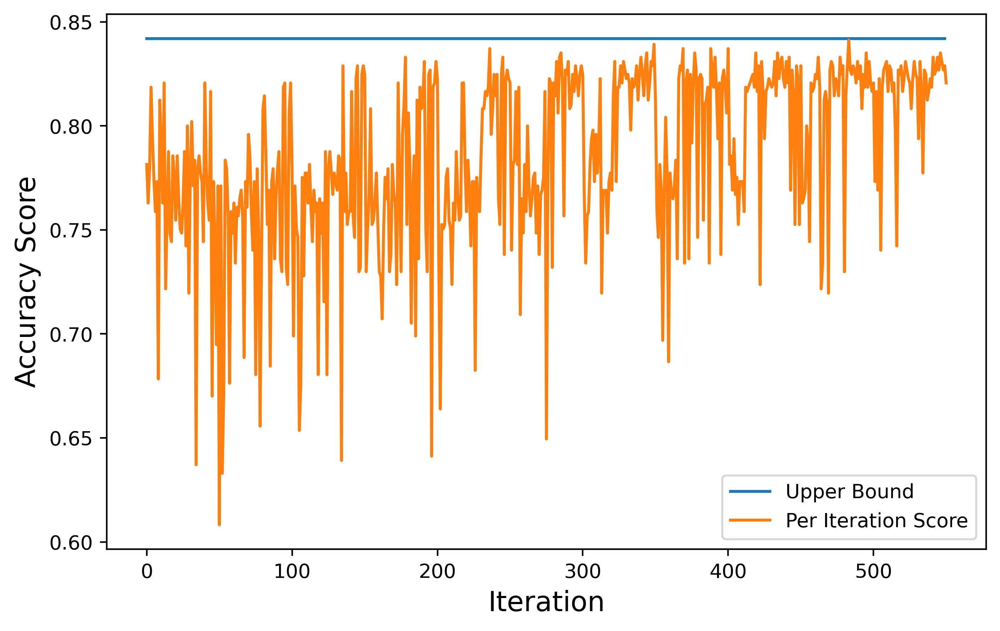

In [91]:
accL1=[]
for i in range(0,550):
    accL1.append(0.842)

plt.figure(figsize=(8,5),dpi=400)
plt.plot(accL1)
plt.plot(accL)
plt.xlabel('Iteration', fontsize=14)
plt.ylabel('Accuracy Score', fontsize=14)
plt.legend(['Upper Bound', 'Per Iteration Score'], loc='lower right')
plt.savefig("LRit.pdf")

In [85]:
sol0K=[]
sol1K=[]
accK=[]
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)
def fitness_function(solution):
    print(solution)
    sol0K.append(solution[0])
    sol1K.append(solution[1])
    global dataFFeatures
    X =dataFFeatures
    y =  DataFTarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpF=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpF.append(X.columns[i])
    print(len(featuresimpF))

    global dataIFeatures
    X =dataIFeatures
    y =  DataITarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpI=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpI.append(X.columns[i])
    print(len(featuresimpI))
    dataIFeatures= dataIFeatures[featuresimpI]
    dataFFeatures= dataFFeatures[featuresimpF]

    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpI),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GI1=t_model.predict(dataIFeatures)


    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GF1=t_model.predict(dataFFeatures)
    
    dI=pd.DataFrame(GI1)
    dF=pd.DataFrame(GF1)
    
    ComFeat=dF.append(dI,ignore_index = True) 
    ComT=DataFTarget["Sub_Cat"].append(DataITarget["Sub_Cat"],ignore_index = True)


    X_train, X_test, y_train, y_test = train_test_split(ComFeat, ComT, test_size=0.15, random_state=1, stratify=ComT, shuffle=True)
    
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.linear_model import LogisticRegression
    #solvr=['saga','sag','newton-cg', 'lbfgs']
    algo=['auto', 'ball_tree', 'kd_tree', 'brute']
    #a=LogisticRegression(random_state=int(solution[2]), solver=solvr[int(solution[3])],multi_class='multinomial',C=int(solution[4]))
    #a =  ExtraTreesClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a =  RandomForestClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    from sklearn.neighbors import KNeighborsClassifier
    a = KNeighborsClassifier(n_neighbors=int(solution[2]),algorithm=algo[int(solution[3])])
    a_pred = a.fit(X_train, y_train)
    pred=a_pred.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accK.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [90, 0.01, 2,0],
    "ub": [2000, 0.03,10,3],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


#model = BasePSO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")

ETC
[1.47480310e+03 1.58438520e-02 7.43003423e+00 1.10868918e+00]
10
20
0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.67      0.31      0.42        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.78      0.84      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.76      0.70        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.42      0.50      0.46        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       0.81      0.84      0.82        25
   Mirai-UDP Flooding       0.94      0.65      0.77        26
               Normal       0.96      0.88      0.92        26
             Normal_I     

10
20
0.7835051546391752
                       precision    recall  f1-score   support

             Analysis       0.56      0.35      0.43        26
             Backdoor       0.70      0.81      0.75        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.66      0.84      0.74        25
              Fuzzers       0.88      0.85      0.86        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.46      0.43        26
  Mirai-HTTP Flooding       0.42      0.50      0.46        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.88      0.94        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.57      0.31      0.40        26
             Backdoor       0.71      0.85      0.77        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.65      0.80      0.71        25
              Fuzzers       0.88      0.88      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.82      0.92      0.87        25
    Mirai-Ackflooding       0.33      0.38      0.36        26
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.7896907216494845
                       precision    recall  f1-score   support

             Analysis       0.64      0.35      0.45        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.64      0.84      0.72        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.39      0.42      0.41        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.58      0.27      0.37        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.76      0.70        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.34      0.38      0.36        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       0.80      0.80      0.80        25
   Mirai-UDP Flooding       0.94      0.65      0.77        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       0.43      0.38      0.41        26
             Backdoor       0.71      0.77      0.74        26
                  DoS       0.75      0.84      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.61      0.76      0.68        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.41      0.46      0.44        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       0.89      0.62      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7608247422680412
                       precision    recall  f1-score   support

             Analysis       0.69      0.35      0.46        26
             Backdoor       0.76      0.96      0.85        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.76      0.70        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.79      0.88      0.83        25
    Mirai-Ackflooding       0.42      0.58      0.48        26
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.79      0.76      0.78        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.96      0.88      0.92        26
             Normal_I       1.00      0.96      0.98        26
       Reconnaissance       0

10
20
0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.50      0.42      0.46        26
             Backdoor       0.71      0.65      0.68        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.71      0.80      0.75        25
              Fuzzers       0.88      0.88      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      1.00      0.94        25
    Mirai-Ackflooding       0.34      0.42      0.38        26
  Mirai-HTTP Flooding       0.27      0.27      0.27        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.80      0.62      0.70        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.60      0.35      0.44        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.78      0.84      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.59      0.76      0.67        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.83      0.96      0.89        25
    Mirai-Ackflooding       0.41      0.50      0.45        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       0.80      0.80      0.80        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.96      0.92      0.94        26
             Normal_I       1.00      0.96      0.98        26
       Reconnaissance       0

10
20
0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.38      0.58      0.46        26
             Backdoor       0.81      0.65      0.72        26
                  DoS       0.59      0.64      0.62        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.67      0.72      0.69        25
              Fuzzers       0.95      0.77      0.85        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.38      0.58      0.46        26
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7835051546391752
                       precision    recall  f1-score   support

             Analysis       0.75      0.35      0.47        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.76      0.70        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.83      0.96      0.89        25
    Mirai-Ackflooding       0.43      0.50      0.46        26
  Mirai-HTTP Flooding       0.42      0.50      0.46        26
Mirai-Hostbruteforceg       0.83      0.80      0.82        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       0.96      0.88      0.92        26
             Normal_I       1.00      1.00      1.00        26
       Reconnaissance       0

10
20
0.7546391752577319
                       precision    recall  f1-score   support

             Analysis       0.38      0.58      0.46        26
             Backdoor       0.78      0.54      0.64        26
                  DoS       0.55      0.64      0.59        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.64      0.72      0.68        25
              Fuzzers       0.95      0.81      0.88        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.39      0.62      0.48        26
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.67      0.38      0.49        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.68      0.76      0.72        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.80      0.96      0.87        25
    Mirai-Ackflooding       0.33      0.42      0.37        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.83      0.76      0.79        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.7608247422680412
                       precision    recall  f1-score   support

             Analysis       0.41      0.58      0.48        26
             Backdoor       0.81      0.65      0.72        26
                  DoS       0.55      0.64      0.59        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.72      0.72      0.72        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.39      0.62      0.48        26
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       0.67      0.31      0.42        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.68      0.76      0.72        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.86      0.96      0.91        25
    Mirai-Ackflooding       0.39      0.46      0.42        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.80      0.80      0.80        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.67      0.31      0.42        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.63      0.76      0.69        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.83      0.96      0.89        25
    Mirai-Ackflooding       0.39      0.42      0.41        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       0.94      0.65      0.77        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.75      0.35      0.47        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.75      0.84      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.61      0.68      0.64        25
              Fuzzers       0.85      0.85      0.85        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.39      0.58      0.47        26
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.81      0.84      0.82        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       0.96      0.92      0.94        26
             Normal_I       1.00      0.92      0.96        26
       Reconnaissance       0

10
20
0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.62      0.38      0.48        26
             Backdoor       0.73      0.85      0.79        26
                  DoS       0.75      0.84      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.70      0.76      0.73        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.86      0.96      0.91        25
    Mirai-Ackflooding       0.38      0.50      0.43        26
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       0.81      0.88      0.85        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7484536082474227
                       precision    recall  f1-score   support

             Analysis       0.69      0.35      0.46        26
             Backdoor       0.72      1.00      0.84        26
                  DoS       0.75      0.84      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.76      0.70        25
              Fuzzers       0.82      0.88      0.85        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.88      0.86        25
    Mirai-Ackflooding       0.37      0.54      0.44        26
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.81      0.84      0.82        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.67      0.31      0.42        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.72      0.84      0.78        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.63      0.76      0.69        25
              Fuzzers       0.83      0.92      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.38      0.42      0.40        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.85      0.88      0.86        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.48      0.42      0.45        26
             Backdoor       0.70      0.73      0.72        26
                  DoS       0.75      0.84      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.61      0.76      0.68        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.50      0.46        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.85      0.88      0.86        25
   Mirai-UDP Flooding       0.89      0.62      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7505154639175258
                       precision    recall  f1-score   support

             Analysis       0.38      0.58      0.46        26
             Backdoor       0.79      0.58      0.67        26
                  DoS       0.57      0.64      0.60        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.62      0.72      0.67        25
              Fuzzers       0.95      0.81      0.88        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.36      0.54      0.43        26
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.64      0.35      0.45        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.71      0.80      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.57      0.68      0.62        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.35      0.46      0.40        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7237113402061855
                       precision    recall  f1-score   support

             Analysis       0.39      0.62      0.48        26
             Backdoor       0.79      0.58      0.67        26
                  DoS       0.57      0.68      0.62        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.62      0.72      0.67        25
              Fuzzers       0.80      0.77      0.78        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.40      0.62      0.48        26
  Mirai-HTTP Flooding       0.32      0.23      0.27        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.39      0.35      0.37        26
             Backdoor       0.69      0.69      0.69        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.61      0.76      0.68        25
              Fuzzers       0.92      0.85      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.47      0.58      0.52        26
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.88      0.94        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.40      0.62      0.48        26
             Backdoor       0.82      0.54      0.65        26
                  DoS       0.55      0.68      0.61        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.72      0.72      0.72        25
              Fuzzers       0.95      0.81      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.37      0.62      0.46        26
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       0.96      0.96      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7505154639175258
                       precision    recall  f1-score   support

             Analysis       0.67      0.31      0.42        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.60      0.72      0.65        25
              Fuzzers       0.88      0.88      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.82      0.92      0.87        25
    Mirai-Ackflooding       0.38      0.58      0.46        26
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.81      0.84      0.82        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       0.96      0.92      0.94        26
             Normal_I       1.00      0.92      0.96        26
       Reconnaissance       0

10
20
0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.37      0.62      0.46        26
             Backdoor       0.82      0.54      0.65        26
                  DoS       0.57      0.64      0.60        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.67      0.72      0.69        25
              Fuzzers       1.00      0.77      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.36      0.58      0.44        26
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7835051546391752
                       precision    recall  f1-score   support

             Analysis       0.69      0.35      0.46        26
             Backdoor       0.76      0.96      0.85        26
                  DoS       0.75      0.84      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.65      0.80      0.71        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.86      0.96      0.91        25
    Mirai-Ackflooding       0.41      0.46      0.44        26
  Mirai-HTTP Flooding       0.44      0.54      0.48        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.7608247422680412
                       precision    recall  f1-score   support

             Analysis       0.60      0.35      0.44        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.57      0.64      0.60        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.79      0.92      0.85        25
    Mirai-Ackflooding       0.40      0.54      0.46        26
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.83      0.76      0.79        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.7608247422680412
                       precision    recall  f1-score   support

             Analysis       0.69      0.35      0.46        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.75      0.84      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.53      0.68      0.60        25
              Fuzzers       0.95      0.81      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.81      1.00      0.89        25
    Mirai-Ackflooding       0.41      0.54      0.47        26
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.83      0.80      0.82        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.40      0.38      0.39        26
             Backdoor       0.68      0.58      0.62        26
                  DoS       0.72      0.84      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.63      0.76      0.69        25
              Fuzzers       0.81      0.81      0.81        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.44      0.58      0.50        26
  Mirai-HTTP Flooding       0.35      0.35      0.35        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.88      0.94        26
             Normal_I       1.00      1.00      1.00        26
       Reconnaissance       0

10
20
0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.38      0.58      0.46        26
             Backdoor       0.78      0.54      0.64        26
                  DoS       0.60      0.72      0.65        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.64      0.72      0.68        25
              Fuzzers       0.95      0.81      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.38      0.62      0.47        26
  Mirai-HTTP Flooding       0.32      0.27      0.29        26
Mirai-Hostbruteforceg       0.91      0.80      0.85        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.64      0.35      0.45        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.71      0.80      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.59      0.68      0.63        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.33      0.42      0.37        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.87      0.80      0.83        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0

10
20
0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.56      0.35      0.43        26
             Backdoor       0.71      0.85      0.77        26
                  DoS       0.78      0.84      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.70      0.76      0.73        25
              Fuzzers       0.83      0.92      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.83      0.96      0.89        25
    Mirai-Ackflooding       0.33      0.42      0.37        26
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.81      0.84      0.82        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       0.96      0.88      0.92        26
             Normal_I       1.00      1.00      1.00        26
       Reconnaissance       0

10
20
0.7216494845360825
                       precision    recall  f1-score   support

             Analysis       0.33      0.54      0.41        26
             Backdoor       0.76      0.62      0.68        26
                  DoS       0.55      0.72      0.62        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.58      0.72      0.64        25
              Fuzzers       0.94      0.58      0.71        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.82      0.92      0.87        25
    Mirai-Ackflooding       0.35      0.58      0.43        26
  Mirai-HTTP Flooding       0.40      0.31      0.35        26
Mirai-Hostbruteforceg       0.79      0.88      0.83        25
   Mirai-UDP Flooding       0.88      0.54      0.67        26
               Normal       0.96      0.88      0.92        26
             Normal_I       1.00      1.00      1.00        26
       Reconnaissance       0

10
20
0.7608247422680412
                       precision    recall  f1-score   support

             Analysis       0.53      0.31      0.39        26
             Backdoor       0.69      0.85      0.76        26
                  DoS       0.79      0.88      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.67      0.80      0.73        25
              Fuzzers       0.83      0.92      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.83      0.96      0.89        25
    Mirai-Ackflooding       0.34      0.38      0.36        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.83      0.80      0.82        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7938144329896907
                       precision    recall  f1-score   support

             Analysis       0.62      0.38      0.48        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.70      0.84      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.41      0.54      0.47        26
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.67      0.31      0.42        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.69      0.80      0.74        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.76      0.70        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.41      0.50      0.45        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.83      0.80      0.82        25
   Mirai-UDP Flooding       0.94      0.65      0.77        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.73      0.31      0.43        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.61      0.76      0.68        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.79      0.92      0.85        25
    Mirai-Ackflooding       0.35      0.42      0.39        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       0.82      0.72      0.77        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0

10
20
0.7505154639175258
                       precision    recall  f1-score   support

             Analysis       0.75      0.35      0.47        26
             Backdoor       0.72      1.00      0.84        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.76      0.70        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.82      0.92      0.87        25
    Mirai-Ackflooding       0.36      0.50      0.42        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.83      0.76      0.79        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       0.96      0.88      0.92        26
             Normal_I       1.00      0.92      0.96        26
       Reconnaissance       0

10
20
0.7608247422680412
                       precision    recall  f1-score   support

             Analysis       0.75      0.35      0.47        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.76      0.70        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.79      0.92      0.85        25
    Mirai-Ackflooding       0.38      0.54      0.44        26
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       0.82      0.72      0.77        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       0.67      0.31      0.42        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.63      0.76      0.69        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.41      0.50      0.45        26
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.80      0.80      0.80        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0

10
20
0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.67      0.31      0.42        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.76      0.70        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.40      0.46      0.43        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       0.81      0.84      0.82        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.756701030927835
                       precision    recall  f1-score   support

             Analysis       0.43      0.35      0.38        26
             Backdoor       0.71      0.65      0.68        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.58      0.76      0.66        25
              Fuzzers       0.81      0.81      0.81        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.45      0.58      0.51        26
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

10
20
0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.57      0.31      0.40        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.68      0.76      0.72        25
              Fuzzers       0.81      0.85      0.83        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.37      0.42      0.39        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.83      0.80      0.82        25
   Mirai-UDP Flooding       0.89      0.62      0.73        26
               Normal       1.00      0.88      0.94        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.48      0.42      0.45        26
             Backdoor       0.72      0.69      0.71        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.69      0.80      0.74        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.41      0.54      0.47        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.83      0.80      0.82        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.43      0.38      0.41        26
             Backdoor       0.69      0.69      0.69        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.61      0.80      0.69        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.38      0.50      0.43        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.87      0.80      0.83        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7443298969072165
                       precision    recall  f1-score   support

             Analysis       0.59      0.38      0.47        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.59      0.76      0.67        25
              Fuzzers       0.88      0.85      0.86        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.32      0.42      0.37        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       0.89      0.62      0.73        26
               Normal       1.00      0.88      0.94        26
             Normal_I       1.00      0.88      0.94        26
       Reconnaissance       0

10
20
0.734020618556701
                       precision    recall  f1-score   support

             Analysis       0.39      0.62      0.48        26
             Backdoor       0.79      0.58      0.67        26
                  DoS       0.52      0.68      0.59        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.61      0.68      0.64        25
              Fuzzers       0.94      0.65      0.77        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.86      0.96      0.91        25
    Mirai-Ackflooding       0.40      0.65      0.50        26
  Mirai-HTTP Flooding       0.32      0.27      0.29        26
Mirai-Hostbruteforceg       0.81      0.84      0.82        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0.

10
20
0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.48      0.50      0.49        26
             Backdoor       0.75      0.69      0.72        26
                  DoS       0.72      0.92      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.63      0.76      0.69        25
              Fuzzers       0.91      0.81      0.86        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.79      0.92      0.85        25
    Mirai-Ackflooding       0.33      0.38      0.36        26
  Mirai-HTTP Flooding       0.30      0.31      0.30        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.88      0.94        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.34      0.54      0.42        26
             Backdoor       0.78      0.54      0.64        26
                  DoS       0.55      0.64      0.59        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.67      0.72      0.69        25
              Fuzzers       1.00      0.77      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.37      0.58      0.45        26
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.67      0.31      0.42        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.76      0.70        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.79      0.88      0.83        25
    Mirai-Ackflooding       0.34      0.42      0.38        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       0.78      0.72      0.75        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0

10
20
0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.38      0.58      0.45        26
             Backdoor       0.80      0.62      0.70        26
                  DoS       0.63      0.68      0.65        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.69      0.72      0.71        25
              Fuzzers       0.95      0.77      0.85        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.40      0.65      0.49        26
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7402061855670103
                       precision    recall  f1-score   support

             Analysis       0.64      0.35      0.45        26
             Backdoor       0.71      0.92      0.80        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.61      0.68      0.64        25
              Fuzzers       0.85      0.85      0.85        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.79      0.92      0.85        25
    Mirai-Ackflooding       0.33      0.50      0.40        26
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.79      0.76      0.78        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       0.96      0.92      0.94        26
             Normal_I       1.00      0.96      0.98        26
       Reconnaissance       0

10
20
0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.42      0.42      0.42        26
             Backdoor       0.68      0.65      0.67        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.59      0.76      0.67        25
              Fuzzers       1.00      0.88      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.82      0.92      0.87        25
    Mirai-Ackflooding       0.38      0.46      0.41        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       0.84      0.62      0.71        26
               Normal       0.96      0.92      0.94        26
             Normal_I       1.00      1.00      1.00        26
       Reconnaissance       0

10
20
0.777319587628866
                       precision    recall  f1-score   support

             Analysis       0.43      0.46      0.44        26
             Backdoor       0.73      0.62      0.67        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.59      0.76      0.67        25
              Fuzzers       1.00      0.85      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.86      0.96      0.91        25
    Mirai-Ackflooding       0.42      0.50      0.46        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

10
20
0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.67      0.38      0.49        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.68      0.76      0.72        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.79      0.92      0.85        25
    Mirai-Ackflooding       0.36      0.46      0.41        26
  Mirai-HTTP Flooding       0.36      0.38      0.37        26
Mirai-Hostbruteforceg       0.78      0.72      0.75        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0

10
20
0.7938144329896907
                       precision    recall  f1-score   support

             Analysis       0.56      0.35      0.43        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.66      0.84      0.74        25
              Fuzzers       0.96      0.85      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.41      0.50      0.45        26
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7484536082474227
                       precision    recall  f1-score   support

             Analysis       0.36      0.58      0.44        26
             Backdoor       0.79      0.58      0.67        26
                  DoS       0.54      0.56      0.55        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.60      0.72      0.65        25
              Fuzzers       1.00      0.81      0.89        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.58      0.44        26
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7876288659793814
                       precision    recall  f1-score   support

             Analysis       0.62      0.38      0.48        26
             Backdoor       0.71      0.85      0.77        26
                  DoS       0.68      0.84      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.85      0.85      0.85        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.46      0.41        26
  Mirai-HTTP Flooding       0.42      0.50      0.46        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.88      0.94        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7896907216494845
                       precision    recall  f1-score   support

             Analysis       0.61      0.42      0.50        26
             Backdoor       0.71      0.85      0.77        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.38      0.46      0.41        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.39      0.58      0.47        26
             Backdoor       0.80      0.62      0.70        26
                  DoS       0.57      0.64      0.60        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.60      0.72      0.65        25
              Fuzzers       1.00      0.81      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.42      0.62      0.50        26
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7525773195876289
                       precision    recall  f1-score   support

             Analysis       0.38      0.58      0.45        26
             Backdoor       0.79      0.58      0.67        26
                  DoS       0.54      0.60      0.57        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.64      0.72      0.68        25
              Fuzzers       0.95      0.81      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.38      0.62      0.47        26
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       1.00      0.58      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.67      0.38      0.49        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.76      0.70        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.38      0.54      0.44        26
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0

10
20
0.7546391752577319
                       precision    recall  f1-score   support

             Analysis       0.69      0.35      0.46        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.72      0.84      0.78        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.63      0.76      0.69        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.82      0.92      0.87        25
    Mirai-Ackflooding       0.39      0.58      0.47        26
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.94      0.62      0.74        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.71      0.38      0.50        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.68      0.84      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.61      0.68      0.64        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.34      0.42      0.38        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       0.87      0.80      0.83        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.88      0.94        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7505154639175258
                       precision    recall  f1-score   support

             Analysis       0.69      0.35      0.46        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.75      0.84      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.63      0.76      0.69        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.79      0.92      0.85        25
    Mirai-Ackflooding       0.39      0.54      0.45        26
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.86      0.76      0.81        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0

10
20
0.7835051546391752
                       precision    recall  f1-score   support

             Analysis       0.47      0.31      0.37        26
             Backdoor       0.70      0.81      0.75        26
                  DoS       0.72      0.84      0.78        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       0.88      0.88      0.88        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.39      0.50      0.44        26
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.91      0.80      0.85        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7835051546391752
                       precision    recall  f1-score   support

             Analysis       0.75      0.35      0.47        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.68      0.76      0.72        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.65      0.68      0.67        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.36      0.50      0.42        26
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7896907216494845
                       precision    recall  f1-score   support

             Analysis       0.64      0.35      0.45        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.64      0.84      0.72        25
              Fuzzers       0.96      0.85      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.41      0.54      0.47        26
  Mirai-HTTP Flooding       0.43      0.50      0.46        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       0.96      0.92      0.94        26
             Normal_I       1.00      1.00      1.00        26
       Reconnaissance       0

10
20
0.7917525773195876
                       precision    recall  f1-score   support

             Analysis       0.62      0.38      0.48        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.35      0.46      0.40        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.88      0.94        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7628865979381443
                       precision    recall  f1-score   support

             Analysis       0.38      0.58      0.46        26
             Backdoor       0.79      0.58      0.67        26
                  DoS       0.61      0.68      0.64        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.67      0.72      0.69        25
              Fuzzers       0.95      0.81      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.38      0.58      0.46        26
  Mirai-HTTP Flooding       0.32      0.31      0.31        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.39      0.54      0.45        26
             Backdoor       0.77      0.65      0.71        26
                  DoS       0.63      0.68      0.65        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.64      0.72      0.68        25
              Fuzzers       1.00      0.81      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.40      0.69      0.51        26
  Mirai-HTTP Flooding       0.38      0.31      0.34        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.96      0.96      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.777319587628866
                       precision    recall  f1-score   support

             Analysis       0.43      0.46      0.44        26
             Backdoor       0.71      0.65      0.68        26
                  DoS       0.74      0.80      0.77        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.76      0.70        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.42      0.50      0.46        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       0.89      0.62      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.

10
20
0.756701030927835
                       precision    recall  f1-score   support

             Analysis       0.37      0.58      0.45        26
             Backdoor       0.78      0.54      0.64        26
                  DoS       0.57      0.64      0.60        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.75      0.72      0.73        25
              Fuzzers       0.92      0.85      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.36      0.58      0.44        26
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.

10
20
0.7546391752577319
                       precision    recall  f1-score   support

             Analysis       0.56      0.35      0.43        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.78      0.84      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.59      0.76      0.67        25
              Fuzzers       0.84      0.81      0.82        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.82      0.92      0.87        25
    Mirai-Ackflooding       0.41      0.54      0.47        26
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.80      0.80      0.80        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.89      0.96      0.93        26
       Reconnaissance       0

10
20
0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.53      0.35      0.42        26
             Backdoor       0.70      0.81      0.75        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.67      0.80      0.73        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.34      0.38      0.36        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.85      0.88      0.86        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.67      0.38      0.49        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.72      0.84      0.78        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.63      0.68      0.65        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.35      0.42      0.39        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7896907216494845
                       precision    recall  f1-score   support

             Analysis       0.59      0.38      0.47        26
             Backdoor       0.71      0.85      0.77        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.72      0.84      0.78        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.39      0.50      0.44        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.46      0.42      0.44        26
             Backdoor       0.73      0.73      0.73        26
                  DoS       0.74      0.80      0.77        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.59      0.80      0.68        25
              Fuzzers       0.92      0.85      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.41      0.50      0.45        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7938144329896907
                       precision    recall  f1-score   support

             Analysis       0.56      0.38      0.45        26
             Backdoor       0.71      0.85      0.77        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.68      0.84      0.75        25
              Fuzzers       0.91      0.81      0.86        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.38      0.42      0.40        26
  Mirai-HTTP Flooding       0.45      0.58      0.51        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.88      0.94        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.8041237113402062
                       precision    recall  f1-score   support

             Analysis       0.67      0.38      0.49        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.66      0.84      0.74        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.43      0.58      0.49        26
  Mirai-HTTP Flooding       0.46      0.50      0.48        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.89      0.62      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.44      0.46      0.45        26
             Backdoor       0.74      0.65      0.69        26
                  DoS       0.77      0.80      0.78        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.56      0.76      0.64        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.39      0.46      0.42        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       0.81      0.88      0.85        25
   Mirai-UDP Flooding       0.80      0.62      0.70        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.39      0.58      0.47        26
             Backdoor       0.79      0.58      0.67        26
                  DoS       0.55      0.68      0.61        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.69      0.72      0.71        25
              Fuzzers       0.96      0.85      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.41      0.65      0.51        26
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.43      0.58      0.49        26
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7855670103092783
                       precision    recall  f1-score   support

             Analysis       0.67      0.38      0.49        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.72      0.84      0.78        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.38      0.46      0.41        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.86      0.76      0.81        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.756701030927835
                       precision    recall  f1-score   support

             Analysis       0.41      0.58      0.48        26
             Backdoor       0.79      0.58      0.67        26
                  DoS       0.57      0.68      0.62        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.62      0.72      0.67        25
              Fuzzers       0.95      0.81      0.88        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.38      0.58      0.45        26
  Mirai-HTTP Flooding       0.35      0.35      0.35        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.94      0.62      0.74        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.

10
20
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.62      0.38      0.48        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.70      0.84      0.76        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.72      0.84      0.78        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.45      0.58      0.51        26
  Mirai-HTTP Flooding       0.46      0.50      0.48        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.734020618556701
                       precision    recall  f1-score   support

             Analysis       0.60      0.35      0.44        26
             Backdoor       0.71      0.96      0.82        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.64      0.64      0.64        25
              Fuzzers       0.74      0.88      0.81        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.79      0.92      0.85        25
    Mirai-Ackflooding       0.33      0.42      0.37        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       0.77      0.80      0.78        25
   Mirai-UDP Flooding       1.00      0.58      0.73        26
               Normal       0.96      0.88      0.92        26
             Normal_I       1.00      0.88      0.94        26
       Reconnaissance       0.

10
20
0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.63      0.46      0.53        26
             Backdoor       0.76      0.85      0.80        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.67      0.80      0.73        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.33      0.42      0.37        26
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.8
                       precision    recall  f1-score   support

             Analysis       0.56      0.38      0.45        26
             Backdoor       0.71      0.85      0.77        26
                  DoS       0.68      0.84      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.50      0.46        26
  Mirai-HTTP Flooding       0.45      0.54      0.49        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.84      0.84  

10
20
0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.45      0.38      0.42        26
             Backdoor       0.69      0.69      0.69        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.62      0.80      0.70        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.45      0.54      0.49        26
  Mirai-HTTP Flooding       0.43      0.50      0.46        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.84      0.62      0.71        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0

10
20
0.756701030927835
                       precision    recall  f1-score   support

             Analysis       0.36      0.54      0.43        26
             Backdoor       0.78      0.54      0.64        26
                  DoS       0.55      0.64      0.59        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.67      0.72      0.69        25
              Fuzzers       1.00      0.81      0.89        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.42      0.65      0.52        26
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.81      0.84      0.82        25
   Mirai-UDP Flooding       0.94      0.65      0.77        26
               Normal       1.00      0.96      0.98        26
             Normal_I       1.00      0.96      0.98        26
       Reconnaissance       0.

10
20
0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.38      0.58      0.45        26
             Backdoor       0.79      0.58      0.67        26
                  DoS       0.53      0.64      0.58        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.72      0.65        25
              Fuzzers       0.95      0.73      0.83        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.41      0.65      0.51        26
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.85      0.88      0.86        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.92      0.96        26
             Normal_I       1.00      1.00      1.00        26
       Reconnaissance       0

10
20
0.7463917525773196
                       precision    recall  f1-score   support

             Analysis       0.37      0.58      0.45        26
             Backdoor       0.80      0.62      0.70        26
                  DoS       0.56      0.60      0.58        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.64      0.72      0.68        25
              Fuzzers       0.95      0.77      0.85        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.82      0.92      0.87        25
    Mirai-Ackflooding       0.38      0.58      0.45        26
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.86      0.76      0.81        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7958762886597938
                       precision    recall  f1-score   support

             Analysis       0.60      0.35      0.44        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.68      0.84      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.68      0.84      0.75        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.50      0.45        26
  Mirai-HTTP Flooding       0.47      0.54      0.50        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.56      0.35      0.43        26
             Backdoor       0.71      0.85      0.77        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.68      0.84      0.75        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.44      0.58      0.50        26
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7876288659793814
                       precision    recall  f1-score   support

             Analysis       0.64      0.35      0.45        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       0.96      0.85      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.31      0.35      0.33        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8020618556701031
                       precision    recall  f1-score   support

             Analysis       0.60      0.35      0.44        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.64      0.84      0.72        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.44      0.58      0.50        26
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.8
                       precision    recall  f1-score   support

             Analysis       0.69      0.42      0.52        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.64      0.84      0.72        25
              Fuzzers       1.00      0.85      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.42      0.54      0.47        26
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.91      0.80      0.85        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88      0.84  

10
20
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.62      0.38      0.48        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.50      0.44        26
  Mirai-HTTP Flooding       0.43      0.50      0.46        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7505154639175258
                       precision    recall  f1-score   support

             Analysis       0.36      0.54      0.43        26
             Backdoor       0.72      0.50      0.59        26
                  DoS       0.60      0.72      0.65        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.69      0.72      0.71        25
              Fuzzers       0.91      0.81      0.86        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.86      0.96      0.91        25
    Mirai-Ackflooding       0.40      0.65      0.50        26
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.87      0.80      0.83        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7793814432989691
                       precision    recall  f1-score   support

             Analysis       0.42      0.42      0.42        26
             Backdoor       0.71      0.65      0.68        26
                  DoS       0.75      0.84      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.61      0.76      0.68        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.45      0.58      0.51        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.50      0.50      0.50        26
             Backdoor       0.75      0.69      0.72        26
                  DoS       0.78      0.84      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.58      0.76      0.66        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.46      0.44        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.85      0.88      0.86        25
   Mirai-UDP Flooding       0.83      0.58      0.68        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.93      0.96      0.94        26
       Reconnaissance       0

10
20
0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.38      0.58      0.46        26
             Backdoor       0.78      0.54      0.64        26
                  DoS       0.58      0.72      0.64        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.72      0.65        25
              Fuzzers       0.91      0.77      0.83        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.41      0.62      0.49        26
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.91      0.80      0.85        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7876288659793814
                       precision    recall  f1-score   support

             Analysis       0.56      0.35      0.43        26
             Backdoor       0.71      0.85      0.77        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.60      0.84      0.70        25
              Fuzzers       0.95      0.81      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.40      0.54      0.46        26
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.85      0.88      0.86        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7896907216494845
                       precision    recall  f1-score   support

             Analysis       0.45      0.35      0.39        26
             Backdoor       0.71      0.85      0.77        26
                  DoS       0.71      0.80      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.68      0.84      0.75        25
              Fuzzers       1.00      0.88      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.82      0.92      0.87        25
    Mirai-Ackflooding       0.41      0.54      0.47        26
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.89      0.62      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7938144329896907
                       precision    recall  f1-score   support

             Analysis       0.60      0.35      0.44        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.84      0.74        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.39      0.50      0.44        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7958762886597938
                       precision    recall  f1-score   support

             Analysis       0.62      0.38      0.48        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.68      0.84      0.75        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.41      0.58      0.48        26
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.86      0.76      0.81        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7938144329896907
                       precision    recall  f1-score   support

             Analysis       0.65      0.42      0.51        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.38      0.46      0.41        26
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7917525773195876
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.68      0.84      0.75        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.39      0.54      0.45        26
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.91      0.80      0.85        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7608247422680412
                       precision    recall  f1-score   support

             Analysis       0.37      0.58      0.45        26
             Backdoor       0.72      0.50      0.59        26
                  DoS       0.58      0.72      0.64        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.69      0.72      0.71        25
              Fuzzers       0.95      0.81      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.41      0.65      0.51        26
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.94      0.65      0.77        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7896907216494845
                       precision    recall  f1-score   support

             Analysis       0.56      0.38      0.45        26
             Backdoor       0.71      0.85      0.77        26
                  DoS       0.68      0.84      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.75      0.84      0.79        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.33      0.38      0.36        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.64      0.35      0.45        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.70      0.76      0.73        25
              Fuzzers       0.83      0.92      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.79      0.92      0.85        25
    Mirai-Ackflooding       0.32      0.42      0.37        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.83      0.76      0.79        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7917525773195876
                       precision    recall  f1-score   support

             Analysis       0.59      0.38      0.47        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.68      0.84      0.75        25
              Fuzzers       0.96      0.85      0.90        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.62      0.50        26
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7958762886597938
                       precision    recall  f1-score   support

             Analysis       0.60      0.35      0.44        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.69      0.80      0.74        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.84      0.74        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.44      0.58      0.50        26
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.87      0.80      0.83        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.8041237113402062
                       precision    recall  f1-score   support

             Analysis       0.62      0.38      0.48        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.68      0.84      0.75        25
              Fuzzers       0.96      0.85      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.46      0.62      0.52        26
  Mirai-HTTP Flooding       0.46      0.50      0.48        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.756701030927835
                       precision    recall  f1-score   support

             Analysis       0.38      0.58      0.46        26
             Backdoor       0.79      0.58      0.67        26
                  DoS       0.58      0.72      0.64        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.64      0.72      0.68        25
              Fuzzers       0.91      0.77      0.83        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.36      0.62      0.46        26
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.

10
20
0.8
                       precision    recall  f1-score   support

             Analysis       0.56      0.38      0.45        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.70      0.84      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.41      0.58      0.48        26
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.88      0.84  

10
20
0.7793814432989691
                       precision    recall  f1-score   support

             Analysis       0.62      0.38      0.48        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.68      0.84      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.68      0.84      0.75        25
              Fuzzers       0.96      0.85      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.33      0.38      0.36        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.87      0.80      0.83        25
   Mirai-UDP Flooding       0.89      0.62      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7608247422680412
                       precision    recall  f1-score   support

             Analysis       0.42      0.38      0.40        26
             Backdoor       0.67      0.62      0.64        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.61      0.80      0.69        25
              Fuzzers       0.88      0.85      0.86        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.86      0.96      0.91        25
    Mirai-Ackflooding       0.41      0.50      0.45        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       0.91      0.84      0.87        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.88      0.94        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.38      0.58      0.46        26
             Backdoor       0.80      0.62      0.70        26
                  DoS       0.61      0.68      0.64        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.69      0.72      0.71        25
              Fuzzers       0.95      0.77      0.85        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.40      0.65      0.49        26
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.85      0.88      0.86        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       1.00      1.00      1.00        26
       Reconnaissance       0

10
20
0.7917525773195876
                       precision    recall  f1-score   support

             Analysis       0.60      0.35      0.44        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.66      0.84      0.74        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.42      0.50      0.46        26
  Mirai-HTTP Flooding       0.42      0.50      0.46        26
Mirai-Hostbruteforceg       0.87      0.80      0.83        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7938144329896907
                       precision    recall  f1-score   support

             Analysis       0.60      0.35      0.44        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.38      0.46      0.41        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       1.00      1.00      1.00        26
       Reconnaissance       0

10
20
0.797938144329897
                       precision    recall  f1-score   support

             Analysis       0.67      0.38      0.49        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.84      0.74        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.41      0.50      0.45        26
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

10
20
0.7896907216494845
                       precision    recall  f1-score   support

             Analysis       0.59      0.38      0.47        26
             Backdoor       0.71      0.85      0.77        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.58      0.48        26
  Mirai-HTTP Flooding       0.46      0.50      0.48        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.62      0.31      0.41        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.57      0.64      0.60        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.33      0.42      0.37        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.57      0.31      0.40        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.81      0.84      0.82        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.69      0.80      0.74        25
              Fuzzers       0.83      0.92      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.36      0.50      0.42        26
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.81      0.88      0.85        25
   Mirai-UDP Flooding       0.94      0.62      0.74        26
               Normal       0.96      0.88      0.92        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0

10
20
0.8
                       precision    recall  f1-score   support

             Analysis       0.59      0.38      0.47        26
             Backdoor       0.71      0.85      0.77        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       1.00      0.88      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.36      0.46      0.41        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.89      0.62      0.73        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.88      0.84  

10
20
0.7855670103092783
                       precision    recall  f1-score   support

             Analysis       0.47      0.35      0.40        26
             Backdoor       0.71      0.85      0.77        26
                  DoS       0.70      0.84      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       0.92      0.88      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.46      0.41        26
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.36      0.54      0.43        26
             Backdoor       0.75      0.58      0.65        26
                  DoS       0.62      0.72      0.67        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.64      0.72      0.68        25
              Fuzzers       1.00      0.77      0.87        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.38      0.58      0.46        26
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.87      0.80      0.83        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.8020618556701031
                       precision    recall  f1-score   support

             Analysis       0.56      0.35      0.43        26
             Backdoor       0.71      0.85      0.77        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.68      0.84      0.75        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.45      0.54      0.49        26
  Mirai-HTTP Flooding       0.48      0.54      0.51        26
Mirai-Hostbruteforceg       0.87      0.80      0.83        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.38      0.58      0.46        26
             Backdoor       0.79      0.58      0.67        26
                  DoS       0.55      0.64      0.59        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.64      0.72      0.68        25
              Fuzzers       0.95      0.81      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.38      0.58      0.45        26
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.83      0.80      0.82        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       1.00      1.00      1.00        26
       Reconnaissance       0

10
20
0.7917525773195876
                       precision    recall  f1-score   support

             Analysis       0.60      0.35      0.44        26
             Backdoor       0.71      0.85      0.77        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.36      0.46      0.41        26
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.7917525773195876
                       precision    recall  f1-score   support

             Analysis       0.60      0.35      0.44        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.68      0.84      0.75        25
              Fuzzers       0.96      0.85      0.90        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.34      0.42      0.38        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       0.96      0.92      0.94        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7546391752577319
                       precision    recall  f1-score   support

             Analysis       0.39      0.58      0.47        26
             Backdoor       0.80      0.62      0.70        26
                  DoS       0.57      0.64      0.60        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.64      0.72      0.68        25
              Fuzzers       0.95      0.81      0.88        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.86      0.96      0.91        25
    Mirai-Ackflooding       0.36      0.62      0.46        26
  Mirai-HTTP Flooding       0.29      0.23      0.26        26
Mirai-Hostbruteforceg       0.90      0.76      0.83        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

10
20
0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       0.60      0.35      0.44        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.66      0.84      0.74        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.37      0.42      0.39        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.86      0.76      0.81        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

10
20
0.797938144329897
                       precision    recall  f1-score   support

             Analysis       0.56      0.38      0.45        26
             Backdoor       0.70      0.81      0.75        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.70      0.84      0.76        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.85      0.92      0.88        25
    Mirai-Ackflooding       0.38      0.42      0.40        26
  Mirai-HTTP Flooding       0.42      0.50      0.46        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

10
20
0.7855670103092783
                       precision    recall  f1-score   support

             Analysis       0.64      0.35      0.45        26
             Backdoor       0.72      0.88      0.79        26
                  DoS       0.66      0.84      0.74        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.64      0.84      0.72        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.82      0.92      0.87        25
    Mirai-Ackflooding       0.40      0.54      0.46        26
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.83      0.76      0.79        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

In [86]:
max(accK)

0.8123711340206186

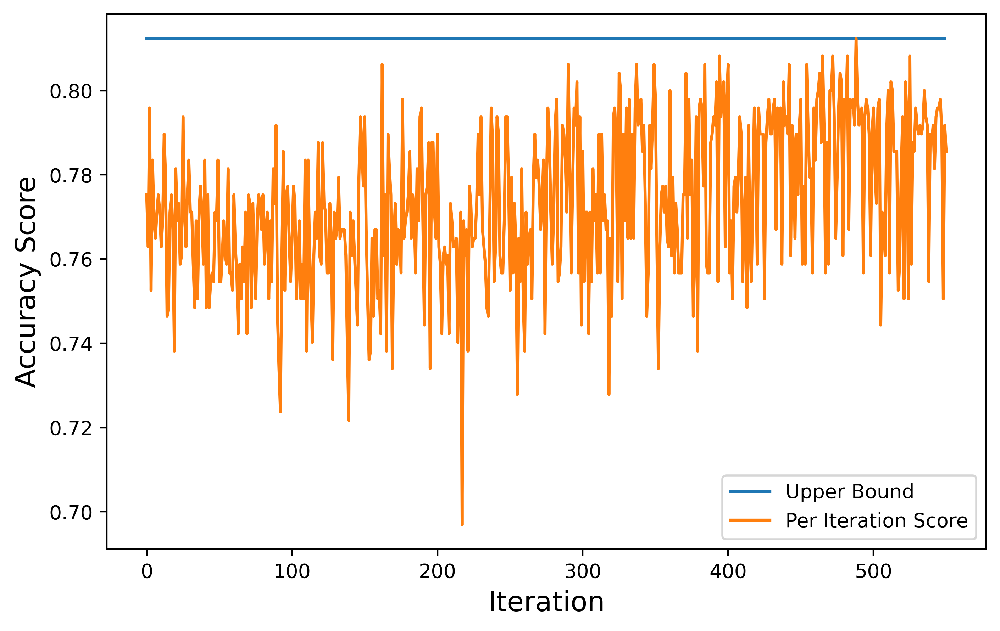

In [90]:
accK1=[]
for i in range(0,550):
    accK1.append(0.8123)

plt.figure(figsize=(8,5),dpi=400)
plt.plot(accK1)
plt.plot(accK)
plt.xlabel('Iteration', fontsize=14)
plt.ylabel('Accuracy Score', fontsize=14)
plt.legend(['Upper Bound', 'Per Iteration Score'], loc='lower right')
plt.savefig("KNNit.pdf")

In [ ]:
sol0S=[]
sol1S=[]
accS=[]
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)
def fitness_function(solution):
    print(solution)
    sol0S.append(solution[0])
    sol1S.append(solution[1])
    global dataFFeatures
    X =dataFFeatures
    y =  DataFTarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpF=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpF.append(X.columns[i])
    print(len(featuresimpF))

    global dataIFeatures
    X =dataIFeatures
    y =  DataITarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpI=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpI.append(X.columns[i])
    print(len(featuresimpI))
    dataIFeatures= dataIFeatures[featuresimpI]
    dataFFeatures= dataFFeatures[featuresimpF]

    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpI),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GI1=t_model.predict(dataIFeatures)


    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GF1=t_model.predict(dataFFeatures)
    
    dI=pd.DataFrame(GI1)
    dF=pd.DataFrame(GF1)
    
    ComFeat=dF.append(dI,ignore_index = True) 
    ComT=DataFTarget["Sub_Cat"].append(DataITarget["Sub_Cat"],ignore_index = True)


    X_train, X_test, y_train, y_test = train_test_split(ComFeat, ComT, test_size=0.15, random_state=1, stratify=ComT, shuffle=True)
    
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.svm import SVC
    from sklearn.linear_model import LogisticRegression
    ker=['linear', 'poly', 'rbf', 'sigmoid']
    #algo=['auto', 'ball_tree', 'kd_tree', 'brute']
    #a=LogisticRegression(random_state=int(solution[2]), solver=solvr[int(solution[3])],multi_class='multinomial',C=int(solution[4]))
    #a =  ExtraTreesClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a =  RandomForestClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a = KNeighborsClassifier(n_neighbors=int(solution[2]),algorithm=algo[int(solution[3])])
    a=SVC(kernel=ker[int(solution[3])], C=int(solution[2]))
    a_pred = a.fit(X_train, y_train)
    pred=a_pred.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accS.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [90, 0.01, 2,0],
    "ub": [2000, 0.03,10,3],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


#model = BasePSO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")

ETC
[9.66186900e+02 1.14566844e-02 3.59956589e+00 4.48115380e-01]
11
21
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       1.00      0.31      0.47        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.73      0.88      0.80        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.50      0.50      0.50        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I     

11
21
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.90      0.35      0.50        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.39      0.42      0.41        26
  Mirai-HTTP Flooding       0.30      0.31      0.30        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.7010309278350515
                       precision    recall  f1-score   support

             Analysis       0.83      0.19      0.31        26
             Backdoor       0.71      0.96      0.82        26
                  DoS       0.43      0.92      0.59        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.41      0.28      0.33        25
              Fuzzers       0.85      0.85      0.85        26
              Generic       0.89      1.00      0.94        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.39      0.42      0.41        26
  Mirai-HTTP Flooding       0.41      0.54      0.47        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.6742268041237114
                       precision    recall  f1-score   support

             Analysis       0.83      0.19      0.31        26
             Backdoor       0.71      0.96      0.82        26
                  DoS       0.42      0.92      0.57        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.25      0.12      0.16        25
              Fuzzers       0.68      0.81      0.74        26
              Generic       0.83      1.00      0.91        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.44      0.62      0.52        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.7587628865979381
                       precision    recall  f1-score   support

             Analysis       0.56      0.19      0.29        26
             Backdoor       0.71      0.92      0.80        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.50      0.48      0.49        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.43      0.46      0.44        26
  Mirai-HTTP Flooding       0.45      0.54      0.49        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.74      0.92      0.82        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.43      0.46      0.44        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.82      0.35      0.49        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.32      0.31      0.31        26
  Mirai-HTTP Flooding       0.29      0.35      0.32        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.91      0.38      0.54        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.73      0.88      0.80        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.78      0.84      0.81        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.41      0.54      0.47        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.

11
21
0.7855670103092783
                       precision    recall  f1-score   support

             Analysis       0.77      0.38      0.51        26
             Backdoor       0.71      0.92      0.80        26
                  DoS       0.72      0.92      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.58      0.56      0.57        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.38      0.38      0.38        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.6742268041237114
                       precision    recall  f1-score   support

             Analysis       0.67      0.15      0.25        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.41      0.92      0.57        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.30      0.12      0.17        25
              Fuzzers       0.67      0.77      0.71        26
              Generic       0.83      1.00      0.91        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.35      0.35      0.35        26
  Mirai-HTTP Flooding       0.45      0.65      0.53        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.7443298969072165
                       precision    recall  f1-score   support

             Analysis       0.62      0.19      0.29        26
             Backdoor       0.69      0.92      0.79        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.52      0.52      0.52        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.34      0.46      0.39        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.7360824742268042
                       precision    recall  f1-score   support

             Analysis       0.57      0.15      0.24        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.55      0.48      0.51        25
              Fuzzers       0.85      0.88      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.45      0.50      0.47        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.7876288659793814
                       precision    recall  f1-score   support

             Analysis       0.71      0.38      0.50        26
             Backdoor       0.69      0.92      0.79        26
                  DoS       0.68      0.92      0.78        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.64      0.64      0.64        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.36      0.50      0.42        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.86      0.73      0.79        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.6948453608247422
                       precision    recall  f1-score   support

             Analysis       0.80      0.15      0.26        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.43      0.92      0.58        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.27      0.12      0.17        25
              Fuzzers       0.71      0.92      0.80        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.48      0.50      0.49        26
  Mirai-HTTP Flooding       0.49      0.65      0.56        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


11
21
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       1.00      0.35      0.51        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.31      0.42      0.36        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


11
21
0.6041237113402061
                       precision    recall  f1-score   support

             Analysis       0.50      0.12      0.19        26
             Backdoor       0.68      1.00      0.81        26
                  DoS       0.40      0.92      0.56        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.38      0.12      0.18        25
              Fuzzers       0.61      0.54      0.57        26
              Generic       0.78      1.00      0.88        25
    MITM ARP Spoofing       0.82      0.56      0.67        25
    Mirai-Ackflooding       0.34      0.42      0.38        26
  Mirai-HTTP Flooding       0.43      0.58      0.49        26
Mirai-Hostbruteforceg       0.62      0.80      0.70        25
   Mirai-UDP Flooding       1.00      0.62      0.76        26
               Normal       0.89      0.96      0.93        26
             Normal_I       0.96      0.85      0.90        26
       Reconnaissance       0

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


11
21
0.534020618556701
                       precision    recall  f1-score   support

             Analysis       0.33      0.08      0.12        26
             Backdoor       0.68      1.00      0.81        26
                  DoS       0.32      0.92      0.47        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.05      0.04      0.04        25
              Fuzzers       0.56      0.38      0.45        26
              Generic       0.74      1.00      0.85        25
    MITM ARP Spoofing       1.00      0.08      0.15        25
    Mirai-Ackflooding       0.23      0.42      0.30        26
  Mirai-HTTP Flooding       0.44      0.58      0.50        26
Mirai-Hostbruteforceg       0.58      0.44      0.50        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       0.89      0.96      0.93        26
             Normal_I       0.95      0.77      0.85        26
       Reconnaissance       0.

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


11
21
0.7154639175257732
                       precision    recall  f1-score   support

             Analysis       1.00      0.15      0.27        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.43      0.88      0.58        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.33      0.16      0.22        25
              Fuzzers       0.72      0.88      0.79        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.44      0.46      0.45        26
  Mirai-HTTP Flooding       0.50      0.69      0.58        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.90      0.35      0.50        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.7010309278350515
                       precision    recall  f1-score   support

             Analysis       0.67      0.15      0.25        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.46      0.88      0.60        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.42      0.40      0.41        25
              Fuzzers       0.70      0.81      0.75        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.39      0.46      0.42        26
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.7360824742268042
                       precision    recall  f1-score   support

             Analysis       0.78      0.27      0.40        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.62      0.92      0.74        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.48      0.48      0.48        25
              Fuzzers       0.83      0.96      0.89        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.44      0.58      0.50        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8041237113402062
                       precision    recall  f1-score   support

             Analysis       0.82      0.35      0.49        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.71      0.96      0.81        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.74      0.80      0.77        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.50      0.44        26
  Mirai-HTTP Flooding       0.32      0.31      0.31        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.82      0.35      0.49        26
             Backdoor       0.71      0.92      0.80        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.58      0.56      0.57        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.7319587628865979
                       precision    recall  f1-score   support

             Analysis       0.80      0.15      0.26        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.52      0.88      0.66        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.48      0.40      0.43        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       0.89      1.00      0.94        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.46      0.65      0.54        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      1.00      0.94        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.7546391752577319
                       precision    recall  f1-score   support

             Analysis       0.80      0.31      0.44        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.56      0.56      0.56        25
              Fuzzers       0.86      0.96      0.91        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.40      0.46      0.43        26
  Mirai-HTTP Flooding       0.33      0.35      0.34        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.7835051546391752
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.71      0.92      0.80        26
                  DoS       0.67      0.88      0.76        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.68      0.76      0.72        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.32      0.46      0.38        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.86      0.73      0.79        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.709278350515464
                       precision    recall  f1-score   support

             Analysis       0.78      0.27      0.40        26
             Backdoor       0.75      0.92      0.83        26
                  DoS       0.55      0.88      0.68        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.35      0.24      0.29        25
              Fuzzers       0.69      0.96      0.81        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.32      0.31      0.31        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


11
21
0.6020618556701031
                       precision    recall  f1-score   support

             Analysis       0.40      0.08      0.13        26
             Backdoor       0.63      1.00      0.78        26
                  DoS       0.42      0.92      0.57        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.50      0.08      0.14        25
              Fuzzers       0.60      0.58      0.59        26
              Generic       0.78      1.00      0.88        25
    MITM ARP Spoofing       0.67      0.16      0.26        25
    Mirai-Ackflooding       0.30      0.42      0.35        26
  Mirai-HTTP Flooding       0.46      0.69      0.55        26
Mirai-Hostbruteforceg       0.68      0.92      0.78        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.89      0.96      0.93        26
             Normal_I       0.96      0.85      0.90        26
       Reconnaissance       0

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


11
21
0.6288659793814433
                       precision    recall  f1-score   support

             Analysis       0.50      0.19      0.28        26
             Backdoor       0.71      0.92      0.80        26
                  DoS       0.43      0.92      0.58        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.20      0.04      0.07        25
              Fuzzers       0.62      0.69      0.65        26
              Generic       0.78      1.00      0.88        25
    MITM ARP Spoofing       0.76      0.76      0.76        25
    Mirai-Ackflooding       0.32      0.31      0.31        26
  Mirai-HTTP Flooding       0.43      0.62      0.51        26
Mirai-Hostbruteforceg       0.70      0.84      0.76        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       0.89      0.96      0.93        26
             Normal_I       0.96      0.88      0.92        26
       Reconnaissance       0

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


11
21
0.688659793814433
                       precision    recall  f1-score   support

             Analysis       0.40      0.31      0.35        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.52      0.88      0.66        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.35      0.24      0.29        25
              Fuzzers       0.74      0.65      0.69        26
              Generic       0.89      1.00      0.94        25
    MITM ARP Spoofing       0.89      1.00      0.94        25
    Mirai-Ackflooding       0.36      0.38      0.37        26
  Mirai-HTTP Flooding       0.43      0.50      0.46        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       1.00      0.65      0.79        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      0.96      0.96        26
       Reconnaissance       0.

11
21
0.6865979381443299
                       precision    recall  f1-score   support

             Analysis       0.62      0.19      0.29        26
             Backdoor       0.71      0.92      0.80        26
                  DoS       0.43      0.92      0.58        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.30      0.12      0.17        25
              Fuzzers       0.65      0.85      0.73        26
              Generic       0.81      1.00      0.89        25
    MITM ARP Spoofing       1.00      0.96      0.98        25
    Mirai-Ackflooding       0.44      0.46      0.45        26
  Mirai-HTTP Flooding       0.44      0.58      0.50        26
Mirai-Hostbruteforceg       0.88      0.92      0.90        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.73      0.31      0.43        26
             Backdoor       0.71      0.92      0.80        26
                  DoS       0.72      0.92      0.81        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.58      0.56      0.57        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.88      0.92      0.90        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.7319587628865979
                       precision    recall  f1-score   support

             Analysis       0.80      0.31      0.44        26
             Backdoor       0.77      0.88      0.82        26
                  DoS       0.58      0.88      0.70        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.42      0.40      0.41        25
              Fuzzers       0.79      0.85      0.81        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.88      0.90        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.43      0.62      0.51        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.89      0.65      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       1.00      1.00      1.00        26
       Reconnaissance       0

11
21
0.7546391752577319
                       precision    recall  f1-score   support

             Analysis       0.62      0.31      0.41        26
             Backdoor       0.69      0.92      0.79        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.47      0.56      0.51        25
              Fuzzers       0.86      0.92      0.89        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.43      0.58      0.49        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.86      0.69      0.77        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.688659793814433
                       precision    recall  f1-score   support

             Analysis       0.71      0.19      0.30        26
             Backdoor       0.71      0.92      0.80        26
                  DoS       0.44      0.92      0.60        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.36      0.16      0.22        25
              Fuzzers       0.74      0.88      0.81        26
              Generic       0.89      1.00      0.94        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.34      0.38      0.36        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

11
21
0.7072164948453609
                       precision    recall  f1-score   support

             Analysis       0.80      0.15      0.26        26
             Backdoor       0.68      0.96      0.79        26
                  DoS       0.50      0.88      0.64        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.40      0.32      0.36        25
              Fuzzers       0.74      0.96      0.83        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.50      0.46        26
  Mirai-HTTP Flooding       0.50      0.62      0.55        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.70      0.62      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       1.00      0.38      0.56        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.73      0.96      0.83        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.31      0.42      0.35        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.67      0.62      0.64        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.7814432989690722
                       precision    recall  f1-score   support

             Analysis       0.89      0.31      0.46        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.59      0.64      0.62        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.39      0.42      0.41        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.73      0.81        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.777319587628866
                       precision    recall  f1-score   support

             Analysis       0.75      0.35      0.47        26
             Backdoor       0.71      0.92      0.80        26
                  DoS       0.68      0.92      0.78        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.54      0.56      0.55        25
              Fuzzers       0.83      0.92      0.87        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


11
21
0.7154639175257732
                       precision    recall  f1-score   support

             Analysis       0.88      0.27      0.41        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.48      0.92      0.63        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.33      0.12      0.18        25
              Fuzzers       0.66      0.88      0.75        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.50      0.46      0.48        26
  Mirai-HTTP Flooding       0.51      0.73      0.60        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.80      0.31      0.44        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.62      0.64      0.63        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.41      0.58      0.48        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.85      0.65      0.74        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.7731958762886598
                       precision    recall  f1-score   support

             Analysis       0.83      0.19      0.31        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.70      0.92      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.64      0.64      0.64        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.7051546391752578
                       precision    recall  f1-score   support

             Analysis       1.00      0.15      0.27        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.45      0.88      0.59        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.47      0.36      0.41        25
              Fuzzers       0.82      0.88      0.85        26
              Generic       0.89      1.00      0.94        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.41      0.46      0.44        26
  Mirai-HTTP Flooding       0.44      0.54      0.48        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       1.00      0.69      0.82        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.67      0.31      0.42        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.70      0.92      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.52      0.48      0.50        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.45      0.35      0.39        26
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.86      0.73      0.79        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       1.00      0.35      0.51        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.37      0.27      0.31        26
  Mirai-HTTP Flooding       0.34      0.46      0.39        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.83      0.96      0.89        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.92      0.92      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.35      0.35      0.35        26
  Mirai-HTTP Flooding       0.36      0.38      0.37        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.

11
21
0.7690721649484537
                       precision    recall  f1-score   support

             Analysis       0.90      0.35      0.50        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.70      0.92      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.58      0.56      0.57        25
              Fuzzers       0.89      0.92      0.91        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.86      0.46      0.60        26
             Backdoor       0.76      0.96      0.85        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.60      0.69      0.64        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       1.00      0.42      0.59        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.74      0.92      0.82        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.32      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.68      0.73      0.70        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.32      0.35      0.33        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.77      0.38      0.51        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.65      0.88      0.75        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.65      0.60      0.63        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      0.96      0.92        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.90      0.69      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.74      0.92      0.82        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.32      0.42      0.37        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.73      0.62      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.74      0.92      0.82        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.35      0.42      0.39        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       1.00      0.38      0.56        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.42      0.31      0.36        26
  Mirai-HTTP Flooding       0.33      0.46      0.39        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.53      0.38      0.44        26
  Mirai-HTTP Flooding       0.37      0.50      0.43        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.797938144329897
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.84      0.84      0.84        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.74      0.92      0.82        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.26      0.31      0.28        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.61      0.65      0.63        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

11
21
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       1.00      0.35      0.51        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.29      0.31      0.30        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       1.00      0.31      0.47        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.35      0.35      0.35        26
  Mirai-HTTP Flooding       0.29      0.35      0.32        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.73      0.62      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.28      0.35      0.31        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.33      0.27      0.30        26
  Mirai-HTTP Flooding       0.27      0.31      0.29        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.68      0.73      0.70        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       1.00      0.35      0.51        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.33      0.31      0.32        26
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8041237113402062
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.83      0.96      0.89        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.74      0.92      0.82        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.33      0.31      0.32        26
  Mirai-HTTP Flooding       0.27      0.31      0.29        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.65      0.65      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.6556701030927835
                       precision    recall  f1-score   support

             Analysis       0.75      0.12      0.20        26
             Backdoor       0.68      0.96      0.79        26
                  DoS       0.43      0.92      0.59        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.57      0.16      0.25        25
              Fuzzers       0.59      0.92      0.72        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.31      0.38      0.34        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       0.84      0.84      0.84        25
   Mirai-UDP Flooding       0.94      0.65      0.77        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8350515463917526
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.83      0.96      0.89        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.83      0.38      0.53        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.32      0.27      0.29        26
  Mirai-HTTP Flooding       0.27      0.38      0.32        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.73      0.62      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.91      0.38      0.54        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.27      0.35      0.31        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.67      0.62      0.64        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.35      0.31      0.33        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.44      0.42      0.43        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.73      0.62      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.43      0.38      0.41        26
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.68      0.73      0.70        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.28      0.31      0.29        26
  Mirai-HTTP Flooding       0.25      0.27      0.26        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.77      0.96      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.42      0.42      0.42        26
  Mirai-HTTP Flooding       0.28      0.31      0.29        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.67      0.62      0.64        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.30      0.23      0.26        26
  Mirai-HTTP Flooding       0.30      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.68      0.73      0.70        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.29      0.27      0.28        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       0.82      0.35      0.49        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.77      0.96      0.86        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.78      0.69      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       0.90      0.35      0.50        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.74      0.92      0.82        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.76      0.88      0.81        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.37      0.27      0.31        26
  Mirai-HTTP Flooding       0.30      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.64      0.69      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.7670103092783506
                       precision    recall  f1-score   support

             Analysis       0.64      0.35      0.45        26
             Backdoor       0.71      0.92      0.80        26
                  DoS       0.70      0.92      0.79        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.52      0.48      0.50        25
              Fuzzers       0.89      0.96      0.93        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.39      0.27      0.32        26
  Mirai-HTTP Flooding       0.35      0.50      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.67      0.62      0.64        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.32      0.23      0.27        26
  Mirai-HTTP Flooding       0.31      0.42      0.35        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.74      0.92      0.82        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.38      0.38      0.38        26
  Mirai-HTTP Flooding       0.29      0.35      0.32        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.70      0.62      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       1.00      0.42      0.59        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.29      0.31      0.30        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.36      0.31      0.33        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.32      0.31      0.31        26
  Mirai-HTTP Flooding       0.27      0.31      0.29        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.67      0.62      0.64        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.32      0.27      0.29        26
  Mirai-HTTP Flooding       0.28      0.31      0.29        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.68      0.73      0.70        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.45      0.35      0.39        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.67      0.77      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

11
21
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.70      0.73      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.91      0.38      0.54        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.33      0.42      0.37        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.90      0.35      0.50        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.76      0.88      0.81        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.38      0.31      0.34        26
  Mirai-HTTP Flooding       0.29      0.35      0.32        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.7649484536082474
                       precision    recall  f1-score   support

             Analysis       0.67      0.31      0.42        26
             Backdoor       0.71      0.92      0.80        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.56      0.56      0.56        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.50      0.38      0.43        26
  Mirai-HTTP Flooding       0.43      0.58      0.49        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       1.00      0.46      0.63        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.77      0.96      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.42      0.50      0.46        26
  Mirai-HTTP Flooding       0.36      0.38      0.37        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.34      0.50      0.41        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.80      0.62      0.70        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       1.00      0.42      0.59        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.45      0.38      0.42        26
  Mirai-HTTP Flooding       0.36      0.38      0.37        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.66      0.73      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8329896907216495
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       1.00      0.92      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.36      0.38      0.37        26
  Mirai-HTTP Flooding       0.32      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.79      0.73      0.76        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8309278350515464
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.68      0.65      0.67        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.

11
21
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.39      0.27      0.32        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.66      0.73      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.32      0.31      0.31        26
  Mirai-HTTP Flooding       0.28      0.31      0.29        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.88      0.88  

11
21
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.83      0.96      0.89        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.38      0.38      0.38        26
  Mirai-HTTP Flooding       0.33      0.42      0.37        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.76      0.62      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       1.00      1.00      1.00        25
    Mirai-Ackflooding       0.41      0.46      0.44        26
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.77      0.96      0.86        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.39      0.42      0.41        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.71      0.58      0.64        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.90      0.35      0.50        26
             Backdoor       0.69      0.96      0.81        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.81      0.88      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.38      0.35      0.36        26
  Mirai-HTTP Flooding       0.30      0.38      0.34        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       1.00      0.38      0.56        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.71      0.88      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.74      0.80      0.77        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.38      0.23      0.29        26
  Mirai-HTTP Flooding       0.35      0.46      0.40        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.66      0.73      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.76      0.73      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8268041237113402
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.89      1.00      0.94        25
    Mirai-Ackflooding       0.44      0.46      0.45        26
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       0.79      0.42      0.55        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.31      0.31      0.31        26
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.65      0.65      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.35      0.35      0.35        26
  Mirai-HTTP Flooding       0.27      0.35      0.31        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.68      0.58      0.62        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       1.00      0.42      0.59        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.43      0.35      0.38        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.47      0.31      0.37        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.59      0.65      0.62        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.86      0.46      0.60        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.75      0.84      0.79        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.72      0.84      0.78        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.86      1.00      0.93        25
    Mirai-Ackflooding       0.48      0.42      0.45        26
  Mirai-HTTP Flooding       0.38      0.50      0.43        26
Mirai-Hostbruteforceg       0.88      0.84      0.86        25
   Mirai-UDP Flooding       0.81      0.65      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       1.00      0.42      0.59        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.92      0.46      0.62        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.41      0.27      0.33        26
  Mirai-HTTP Flooding       0.31      0.42      0.36        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8164948453608247
                       precision    recall  f1-score   support

             Analysis       1.00      0.42      0.59        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.39      0.46      0.42        26
  Mirai-HTTP Flooding       0.29      0.31      0.30        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.82      0.69      0.75        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.45      0.35      0.39        26
  Mirai-HTTP Flooding       0.29      0.35      0.32        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.62      0.69      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8144329896907216
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.46      0.46      0.46        26
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.96      0.94        25
    Mirai-Ackflooding       0.48      0.38      0.43        26
  Mirai-HTTP Flooding       0.32      0.42      0.37        26
Mirai-Hostbruteforceg       0.95      0.84      0.89        25
   Mirai-UDP Flooding       0.65      0.65      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8288659793814434
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.31      0.36        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.66      0.73      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.31      0.31      0.31        26
  Mirai-HTTP Flooding       0.29      0.31      0.30        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.73      0.73      0.73        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.83      0.38      0.53        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.34      0.50      0.41        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.74      0.65      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8185567010309278
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.33      0.35      0.34        26
  Mirai-HTTP Flooding       0.36      0.38      0.37        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8247422680412371
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.32      0.35      0.33        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.40      0.31      0.35        26
  Mirai-HTTP Flooding       0.26      0.35      0.30        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       1.00      0.42      0.59        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.77      0.92      0.84        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.85      0.92      0.88        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.30      0.27      0.29        26
  Mirai-HTTP Flooding       0.31      0.38      0.34        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.70      0.62      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8103092783505155
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.77      0.96      0.86        25
      DoS-Synflooding       1.00      0.92      0.96        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.71      0.65      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.92      0.46      0.62        26
             Backdoor       0.76      0.96      0.85        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.77      0.92      0.84        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.31      0.31      0.31        26
  Mirai-HTTP Flooding       0.26      0.27      0.26        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.67      0.69      0.68        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.92      0.42      0.58        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.35      0.23      0.28        26
  Mirai-HTTP Flooding       0.28      0.38      0.32        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.65      0.65      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8082474226804124
                       precision    recall  f1-score   support

             Analysis       1.00      0.42      0.59        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.92      0.92      0.92        25
    Mirai-Ackflooding       0.46      0.42      0.44        26
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.70      0.62      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0

11
21
0.8041237113402062
                       precision    recall  f1-score   support

             Analysis       0.77      0.38      0.51        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.74      0.92      0.82        25
              Fuzzers       0.96      0.88      0.92        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.89      1.00      0.94        25
    Mirai-Ackflooding       0.37      0.38      0.38        26
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.71      0.58      0.64        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       1.00      0.35      0.51        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.83      0.96      0.89        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.72      0.92      0.81        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.39      0.35      0.37        26
  Mirai-HTTP Flooding       0.32      0.35      0.33        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.72      0.69      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8061855670103093
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.93      1.00      0.96        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.29      0.35      0.32        26
Mirai-Hostbruteforceg       1.00      0.84      0.91        25
   Mirai-UDP Flooding       0.70      0.62      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.73      0.92      0.81        26
                  DoS       0.77      0.96      0.86        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.77      0.65      0.71        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.

11
21
0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.80      0.96      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.79      0.92      0.85        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.96      0.96        25
    Mirai-Ackflooding       0.36      0.35      0.35        26
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        25
   Mirai-UDP Flooding       0.65      0.65      0.65        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.8206185567010309
                       precision    recall  f1-score   support

             Analysis       1.00      0.35      0.51        26
             Backdoor       0.70      1.00      0.83        26
                  DoS       0.82      0.92      0.87        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.74      0.92      0.82        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      0.92      0.94        25
    Mirai-Ackflooding       0.42      0.38      0.40        26
  Mirai-HTTP Flooding       0.36      0.38      0.37        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.66      0.73      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0

11
21
0.822680412371134
                       precision    recall  f1-score   support

             Analysis       0.85      0.42      0.56        26
             Backdoor       0.74      0.96      0.83        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.82      0.92      0.87        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.96      1.00      0.98        25
    Mirai-Ackflooding       0.45      0.35      0.39        26
  Mirai-HTTP Flooding       0.39      0.50      0.44        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        25
   Mirai-UDP Flooding       0.69      0.69      0.69        26
               Normal       1.00      0.96      0.98        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.

In [ ]:
max(accS)

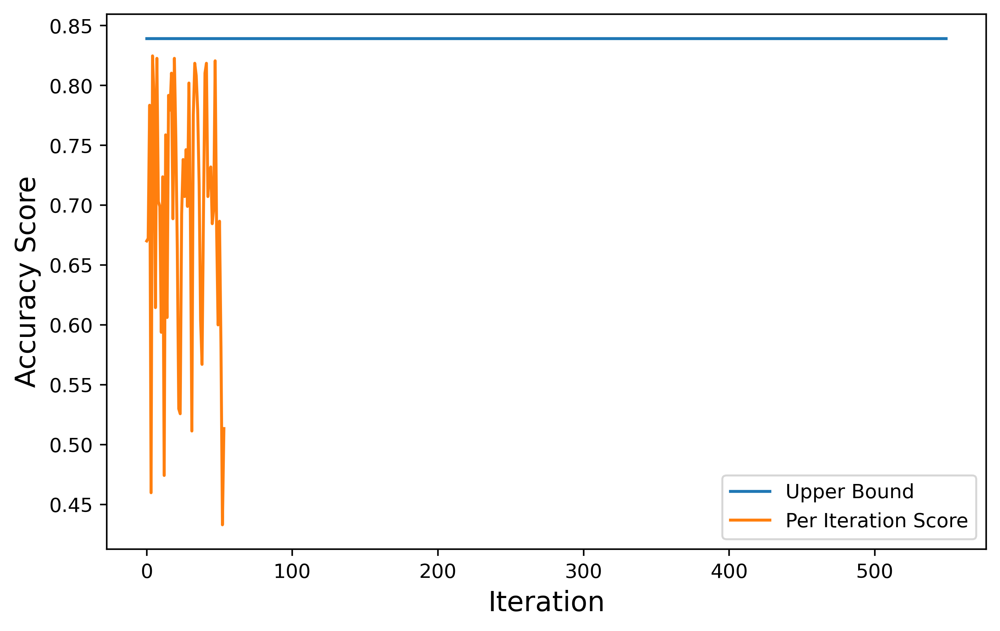

In [102]:
accS1=[]
for i in range(0,550):
    accS1.append(0.8393)

plt.figure(figsize=(8,5),dpi=400)
plt.plot(accS1)
plt.plot(accS)
plt.xlabel('Iteration', fontsize=14)
plt.ylabel('Accuracy Score', fontsize=14)
plt.legend(['Upper Bound', 'Per Iteration Score'], loc='lower right')
plt.savefig("SVMit.pdf")

In [375]:
X_train, X_test, y_train, y_test = train_test_split(feat, ComT, test_size=0.15, random_state=1, stratify=ComT, shuffle=True)

In [376]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  RandomForestClassifier(n_estimators=300, random_state=2,max_depth=10) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))


0.8123711340206186
                       precision    recall  f1-score   support

             Analysis       0.73      0.42      0.54        26
             Backdoor       0.78      0.96      0.86        26
                  DoS       0.85      0.92      0.88        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.74      0.80      0.77        25
              Fuzzers       1.00      0.96      0.98        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.40      0.38      0.39        26
  Mirai-HTTP Flooding       0.44      0.58      0.50        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      1.00      1.00        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.74   

In [377]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  ExtraTreesClassifier(n_estimators=300, random_state=2,max_depth=10) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))

0.7752577319587629
                       precision    recall  f1-score   support

             Analysis       0.88      0.27      0.41        26
             Backdoor       0.74      1.00      0.85        26
                  DoS       0.69      0.88      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.70      0.64      0.67        25
              Fuzzers       0.96      0.92      0.94        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.38      0.38      0.38        26
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        25
   Mirai-UDP Flooding       0.95      0.69      0.80        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.90      1.00      0.95        26
       Reconnaissance       0.79   

In [378]:
from sklearn.linear_model import LogisticRegression
a=LogisticRegression(random_state=1000, solver='sag',multi_class='multinomial',C=2.0)
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))

0.7608247422680412
                       precision    recall  f1-score   support

             Analysis       0.71      0.38      0.50        26
             Backdoor       0.79      0.88      0.84        26
                  DoS       0.66      0.92      0.77        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.61      0.44      0.51        25
              Fuzzers       0.81      0.85      0.83        26
              Generic       1.00      1.00      1.00        25
    MITM ARP Spoofing       0.93      1.00      0.96        25
    Mirai-Ackflooding       0.48      0.46      0.47        26
  Mirai-HTTP Flooding       0.48      0.58      0.53        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        25
   Mirai-UDP Flooding       0.83      0.73      0.78        26
               Normal       1.00      0.92      0.96        26
             Normal_I       0.96      1.00      0.98        26
       Reconnaissance       0.57   

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


In [323]:
from sklearn.neighbors import KNeighborsClassifier
a = KNeighborsClassifier(n_neighbors=5)
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))

0.7711340206185567
                       precision    recall  f1-score   support

             Analysis       0.67      0.46      0.55        26
             Backdoor       0.74      0.88      0.81        26
                  DoS       0.73      0.96      0.83        25
      DoS-Synflooding       1.00      0.96      0.98        25
             Exploits       0.80      0.64      0.71        25
              Fuzzers       0.96      0.96      0.96        26
              Generic       0.96      1.00      0.98        25
    MITM ARP Spoofing       0.83      0.96      0.89        25
    Mirai-Ackflooding       0.47      0.54      0.50        26
  Mirai-HTTP Flooding       0.46      0.50      0.48        26
Mirai-Hostbruteforceg       0.85      0.68      0.76        25
   Mirai-UDP Flooding       0.73      0.62      0.67        26
               Normal       0.92      0.92      0.92        26
             Normal_I       1.00      1.00      1.00        26
       Reconnaissance       0.80   

In [324]:
from sklearn.svm import SVC
a=SVC(kernel='linear', C=2.0)
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))

0.8
                       precision    recall  f1-score   support

             Analysis       0.57      0.46      0.51        26
             Backdoor       0.73      0.85      0.79        26
                  DoS       0.79      0.92      0.85        25
      DoS-Synflooding       1.00      1.00      1.00        25
             Exploits       0.80      0.80      0.80        25
              Fuzzers       0.93      0.96      0.94        26
              Generic       0.89      1.00      0.94        25
    MITM ARP Spoofing       1.00      0.96      0.98        25
    Mirai-Ackflooding       0.41      0.42      0.42        26
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        25
   Mirai-UDP Flooding       0.75      0.69      0.72        26
               Normal       0.96      0.96      0.96        26
             Normal_I       0.93      1.00      0.96        26
       Reconnaissance       0.91      0.84      0.

In [327]:
X_train, X_test, y_train, y_test = train_test_split(GI1, DataITarget["Sub_Cat"], test_size=0.15, random_state=1, stratify=DataITarget["Sub_Cat"], shuffle=True)

In [328]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  RandomForestClassifier(n_estimators=200, random_state=2,max_depth=150) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.92      0.92      0.92        26
    Mirai-Ackflooding       0.36      0.36      0.36        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.86      0.92      0.89        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.88      0.88      0.88        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  2 10 11  0  3  0  0  0]
 [ 0  0  0  0 24  0  2  0  0]
 [ 0  0  6

In [329]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  ExtraTreesClassifier(n_estimators=200, random_state=2,max_depth=150) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))

0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.92      0.94        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.85      0.88      0.87        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  1  9 11  1  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 23  0  2  0  1]
 [ 0  0  5

In [330]:
from sklearn.linear_model import LogisticRegression
a=LogisticRegression(random_state=1000, solver='sag',multi_class='multinomial',C=2.0)
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))

0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.41      0.48      0.44        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.88      0.85      0.86        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.74      0.80      0.77        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  9  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 22  0  2  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


In [331]:
from sklearn.neighbors import KNeighborsClassifier
a = KNeighborsClassifier(n_neighbors=5)
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))

0.7
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.77      0.92      0.84        26
    Mirai-Ackflooding       0.29      0.32      0.30        25
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.87      0.77      0.82        26
   Mirai-UDP Flooding       0.89      0.62      0.73        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.58      0.72      0.64        25
         Scan Port OS       0.67      0.56      0.61        25

             accuracy                           0.70       230
            macro avg       0.72      0.70      0.70       230
         weighted avg       0.72      0.70      0.70       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  2  8 13  1  1  0  0  0]
 [ 0  3 11 11  0  1  0  0  0]
 [ 0  2  1  1 20  0  0  2  0]
 [ 0  0  7  3  0 16  0  

In [332]:
from sklearn.svm import SVC
a=SVC(kernel='linear', C=2.0)
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))

0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.40      0.40      0.40        25
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.85      0.88      0.87        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.78      0.72      0.75        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  1 10 10  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 23  0  2  0  1]
 [ 0  0  

In [333]:
X_train, X_test, y_train, y_test = train_test_split(GF1, DataFTarget["Sub_Cat"], test_size=0.15, random_state=1, stratify=DataFTarget["Sub_Cat"], shuffle=True)

In [22]:
sol0R1=[]
sol1R1=[]
accR1=[]
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)
def fitness_function(solution):
    print(solution)
    sol0R1.append(solution[0])
    sol1R1.append(solution[1])
    global dataFFeatures
    X =dataFFeatures
    y =  DataFTarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpF=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpF.append(X.columns[i])
    print(len(featuresimpF))

    global dataIFeatures
    X =dataIFeatures
    y =  DataITarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpI=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpI.append(X.columns[i])
    print(len(featuresimpI))
    dataIFeatures= dataIFeatures[featuresimpI]
    dataFFeatures= dataFFeatures[featuresimpF]

    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GF1=t_model.predict(dataFFeatures)


    #t_model = Sequential()
    #t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    #t_model.add(Dense(1024))
    #t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    #t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    #GF1=t_model.predict(dataFFeatures)
    
    #dI=pd.DataFrame(GI1)
    #dF=pd.DataFrame(GF1)
    
    #ComFeat=dF.append(dI,ignore_index = True) 
    #ComT=DataFTarget["Sub_Cat"].append(DataITarget["Sub_Cat"],ignore_index = True)


    X_train, X_test, y_train, y_test = train_test_split(GF1, DataFTarget["Sub_Cat"], test_size=0.15, random_state=1, stratify=DataFTarget["Sub_Cat"], shuffle=True)
    
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.svm import SVC
    from sklearn.linear_model import LogisticRegression
    ker=['linear', 'poly', 'rbf', 'sigmoid']
    #algo=['auto', 'ball_tree', 'kd_tree', 'brute']
    #a=LogisticRegression(random_state=int(solution[2]), solver=solvr[int(solution[3])],multi_class='multinomial',C=int(solution[4]))
    #a =  ExtraTreesClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    a =  RandomForestClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a = KNeighborsClassifier(n_neighbors=int(solution[2]),algorithm=algo[int(solution[3])])
    #a=SVC(kernel=ker[int(solution[3])], C=int(solution[2]))
    a_pred = a.fit(X_train, y_train)
    pred=a_pred.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accR1.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [90, 0.01, 10, 5],
    "ub": [2000, 0.03,300,20],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


#model = BasePSO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")

ETC
[1.66957460e+03 2.65587172e-02 2.23266865e+02 1.13718473e+01]
10
20
0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.66      0.81      0.72        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.95      0.69      0.80        26
         Worms       0.80      0.96      0.87        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.82       255
  weighted avg       0.84      0.83      0.82       255

[[12  7  3  2  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  4 21  0  0  0 

10
20
0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.79      0.44      0.56        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.68      0.73      0.70        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[11  7  3  2  1  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7725490196078432
                precision    recall  f1-score   support

      Analysis       1.00      0.24      0.39        25
      Backdoor       0.74      1.00      0.85        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.58      0.42      0.49        26
       Fuzzers       0.83      1.00      0.91        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.53      0.62      0.57        26
     Shellcode       0.89      0.65      0.76        26
         Worms       0.79      0.92      0.85        25

      accuracy                           0.77       255
     macro avg       0.80      0.77      0.75       255
  weighted avg       0.80      0.77      0.75       255

[[ 6  9  3  3  1  0  0  3  0  0]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  2  0  0]
 [ 0  0  8 11  0  0  0  7  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7725490196078432
                precision    recall  f1-score   support

      Analysis       1.00      0.24      0.39        25
      Backdoor       0.74      1.00      0.85        26
           DoS       0.57      0.92      0.71        25
      Exploits       0.50      0.38      0.43        26
       Fuzzers       0.89      0.96      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.63      0.65      0.64        26
     Shellcode       0.89      0.65      0.76        26
         Worms       0.77      0.92      0.84        25

      accuracy                           0.77       255
     macro avg       0.80      0.77      0.75       255
  weighted avg       0.80      0.77      0.75       255

[[ 6  9  2  3  1  0  0  4  0  0]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 23  0  0  0  0  1  0  1]
 [ 0  0 13 10  0  0  0  3  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.75      0.92      0.83        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.70      0.73      0.72        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[11  8  3  2  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.72      0.81      0.76        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.95      0.69      0.80        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[12  7  4  1  0  0  0  1  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  4 21  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7529411764705882
                precision    recall  f1-score   support

      Analysis       1.00      0.16      0.28        25
      Backdoor       0.70      1.00      0.83        26
           DoS       0.58      0.88      0.70        25
      Exploits       0.53      0.38      0.44        26
       Fuzzers       0.86      1.00      0.93        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.57      0.65      0.61        26
     Shellcode       0.88      0.54      0.67        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.75       255
     macro avg       0.79      0.75      0.73       255
  weighted avg       0.78      0.75      0.73       255

[[ 4 11  2  2  1  0  0  4  0  1]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  2  0  0]
 [ 0  0 11 10  0  0  0  5  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.67      0.56      0.61        25
      Backdoor       0.78      0.81      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.73      0.73      0.73        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.95      0.69      0.80        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 1  0 22  1  0  0  0  0  0  1]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 1  0  0  0 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7607843137254902
                precision    recall  f1-score   support

      Analysis       1.00      0.16      0.28        25
      Backdoor       0.70      1.00      0.83        26
           DoS       0.71      0.88      0.79        25
      Exploits       0.59      0.38      0.47        26
       Fuzzers       0.89      1.00      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.45      0.65      0.53        26
     Shellcode       0.89      0.62      0.73        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.76       255
     macro avg       0.80      0.76      0.74       255
  weighted avg       0.80      0.76      0.74       255

[[ 4 11  3  1  1  0  0  4  0  1]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 22  0  0  0  0  2  0  1]
 [ 0  0  3 10  0  0  0 13  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.63      0.48      0.55        25
      Backdoor       0.78      0.81      0.79        26
           DoS       0.74      0.92      0.82        25
      Exploits       0.67      0.85      0.75        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[12  6  3  4  0  0  0  0  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 1  0 23  1  0  0  0  0  0  0]
 [ 0  0  3 22  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7372549019607844
                precision    recall  f1-score   support

      Analysis       1.00      0.16      0.28        25
      Backdoor       0.70      1.00      0.83        26
           DoS       0.71      0.88      0.79        25
      Exploits       0.43      0.38      0.41        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.41      0.62      0.49        26
     Shellcode       0.88      0.54      0.67        26
         Worms       0.73      0.88      0.80        25

      accuracy                           0.74       255
     macro avg       0.78      0.74      0.72       255
  weighted avg       0.78      0.74      0.72       255

[[ 4 11  3  3  1  0  0  3  0  0]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  2  0  0]
 [ 0  0  0 10  0  0  0 16  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.75      0.81      0.78        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.72      0.69      0.71        26
       Fuzzers       0.93      1.00      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.80      0.96      0.87        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.82       255
  weighted avg       0.84      0.83      0.82       255

[[12  7  3  2  1  0  0  0  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 18  0  0  0  1  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.85      0.44      0.58        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.76      0.88      0.81        25
      Exploits       0.75      0.81      0.78        26
       Fuzzers       0.93      1.00      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.79      0.73      0.76        26
     Shellcode       0.81      0.65      0.72        26
         Worms       0.76      0.88      0.81        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.82       255
  weighted avg       0.84      0.83      0.82       255

[[11  9  2  0  1  0  0  1  1  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 1  0  3 21  0  0  0  1  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.65      0.52      0.58        25
      Backdoor       0.74      0.77      0.75        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.70      0.73      0.72        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  7  3  1  0  0  0  1  0  0]
 [ 6 20  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.73      0.88      0.80        25
      Exploits       0.70      0.81      0.75        26
       Fuzzers       0.93      1.00      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[12  7  3  2  1  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 1  0 22  1  0  0  0  0  0  1]
 [ 0  0  3 21  0  0  0  2  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.59      0.80      0.68        25
      Exploits       0.79      0.73      0.76        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  7  4  1  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 2  0 20  0  0  0  0  2  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.61      0.44      0.51        25
      Backdoor       0.75      0.81      0.78        26
           DoS       0.64      0.84      0.72        25
      Exploits       0.73      0.73      0.73        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.79      0.73      0.76        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[11  7  3  1  1  0  0  2  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 1  0 21  1  0  0  0  2  0  0]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.71      0.85      0.77        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.95      0.69      0.80        26
         Worms       0.80      0.96      0.87        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[12  7  4  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  3 22  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.75      0.81      0.78        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.70      0.73      0.72        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  7  3  1  0  0  0  1  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  6 19  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8549019607843137
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.71      0.96      0.81        25
      Exploits       0.72      0.81      0.76        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.85       255
     macro avg       0.86      0.86      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  4 21  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.70      0.73      0.72        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[12  7  3  1  0  0  0  2  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.74      0.77      0.75        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.67      0.69      0.68        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.83       255
     macro avg       0.83      0.83      0.83       255
  weighted avg       0.83      0.83      0.83       255

[[12  7  3  2  1  0  0  0  0  0]
 [ 6 20  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  7 18  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.59      0.80      0.68        25
      Exploits       0.76      0.73      0.75        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[12  7  4  1  1  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 1  0 20  1  0  0  0  2  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.65      0.44      0.52        25
      Backdoor       0.75      0.81      0.78        26
           DoS       0.60      0.84      0.70        25
      Exploits       0.76      0.73      0.75        26
       Fuzzers       0.93      1.00      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[11  7  3  1  1  0  0  2  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 1  0 21  1  0  0  0  1  0  1]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.63      0.48      0.55        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.58      0.76      0.66        25
      Exploits       0.76      0.73      0.75        26
       Fuzzers       0.93      1.00      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.95      0.69      0.80        26
         Worms       0.80      0.96      0.87        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[12  7  4  1  1  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 2  0 19  1  0  0  0  2  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8549019607843137
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.69      0.96      0.80        25
      Exploits       0.69      0.77      0.73        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.85       255
     macro avg       0.87      0.86      0.85       255
  weighted avg       0.87      0.85      0.85       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  5 20  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.79      0.44      0.56        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.68      0.73      0.70        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[11  7  3  2  1  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 1  0 22  1  0  0  0  0  0  1]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8549019607843137
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.72      0.92      0.81        25
      Exploits       0.71      0.85      0.77        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.85       255
     macro avg       0.86      0.86      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 1  0 23  1  0  0  0  0  0  0]
 [ 0  0  3 22  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.69      0.88      0.77        25
      Exploits       0.70      0.81      0.75        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 1  0 22  1  0  0  0  0  0  1]
 [ 0  0  4 21  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.73      0.44      0.55        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.69      0.69      0.69        26
       Fuzzers       1.00      1.00      1.00        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[11  8  3  2  0  0  0  1  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 18  0  0  0  1  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8549019607843137
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.73      0.96      0.83        25
      Exploits       0.71      0.85      0.77        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.85       255
     macro avg       0.86      0.86      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[12  7  3  2  1  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  3 22  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.67      0.56      0.61        25
      Backdoor       0.78      0.81      0.79        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.71      0.85      0.77        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.94      0.65      0.77        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  3 22  0  0  0  1  0  0]
 [ 1  0  0  0 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.72      0.69      0.71        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[12  7  3  1  1  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 18  0  0  0  1  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.67      0.69      0.68        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[12  7  3  2  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 18  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.77      0.77      0.77        26
       Fuzzers       0.93      1.00      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[12  7  3  1  1  0  0  1  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 1  0 22  1  0  0  0  0  0  1]
 [ 0  0  5 20  0  0  0  1  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.69      0.69      0.69        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  7  3  1  0  0  0  1  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 18  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.75      0.81      0.78        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.73      0.73      0.73        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[12  7  3  1  1  0  0  1  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.63      0.48      0.55        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.76      0.88      0.81        25
      Exploits       0.62      0.81      0.70        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.82       255

[[12  7  3  3  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 1  0 22  1  0  0  0  0  0  1]
 [ 0  0  3 21  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.73      0.73      0.73        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  7  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  0  0  0  0  0  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.76      0.88      0.81        25
      Exploits       0.68      0.81      0.74        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.77      0.65      0.71        26
     Shellcode       0.86      0.69      0.77        26
         Worms       0.79      0.88      0.83        25

      accuracy                           0.83       255
     macro avg       0.83      0.83      0.83       255
  weighted avg       0.83      0.83      0.83       255

[[12  7  3  2  1  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  3 21  0  0  0  2  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8588235294117647
                precision    recall  f1-score   support

      Analysis       0.86      0.48      0.62        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.73      0.96      0.83        25
      Exploits       0.71      0.85      0.77        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.86       255
     macro avg       0.87      0.86      0.85       255
  weighted avg       0.87      0.86      0.85       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  3 22  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.76      0.88      0.81        25
      Exploits       0.68      0.81      0.74        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.77      0.65      0.71        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[12  7  3  2  1  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  3 21  0  0  0  2  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8588235294117647
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.72      0.92      0.81        25
      Exploits       0.73      0.85      0.79        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.86       255
     macro avg       0.87      0.86      0.85       255
  weighted avg       0.87      0.86      0.85       255

[[12  7  3  2  1  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  3 22  0  0  0  1  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.73      0.73      0.73        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[12  7  3  1  1  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 1  0 22  1  0  0  0  1  0  0]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8117647058823529
                precision    recall  f1-score   support

      Analysis       0.80      0.32      0.46        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.71      0.88      0.79        25
      Exploits       0.67      0.77      0.71        26
       Fuzzers       0.89      1.00      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.65      0.65      0.65        26
     Shellcode       0.89      0.65      0.76        26
         Worms       0.79      0.92      0.85        25

      accuracy                           0.81       255
     macro avg       0.82      0.81      0.80       255
  weighted avg       0.82      0.81      0.80       255

[[ 8  7  3  3  1  0  0  3  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  3 20  0  0  0  3  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.76      0.88      0.81        25
      Exploits       0.69      0.77      0.73        26
       Fuzzers       0.89      0.96      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.74      0.65      0.69        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.79      0.92      0.85        25

      accuracy                           0.83       255
     macro avg       0.83      0.83      0.82       255
  weighted avg       0.83      0.83      0.82       255

[[12  7  3  2  1  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  3 20  0  0  0  3  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.65      0.44      0.52        25
      Backdoor       0.75      0.92      0.83        26
           DoS       0.79      0.88      0.83        25
      Exploits       0.76      0.85      0.80        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.86      0.73      0.79        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.85       255
     macro avg       0.85      0.85      0.84       255
  weighted avg       0.85      0.85      0.84       255

[[11  8  2  2  1  0  0  0  1  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  1  1]
 [ 0  0  3 22  0  0  0  1  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8156862745098039
                precision    recall  f1-score   support

      Analysis       0.73      0.44      0.55        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.67      0.77      0.71        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.69      0.73        26
     Shellcode       0.86      0.69      0.77        26
         Worms       0.79      0.88      0.83        25

      accuracy                           0.82       255
     macro avg       0.82      0.82      0.81       255
  weighted avg       0.82      0.82      0.81       255

[[11  7  3  3  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  3 20  0  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.65      0.44      0.52        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.73      0.96      0.83        25
      Exploits       0.72      0.81      0.76        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.84       255

[[11  8  3  2  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  4 21  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.70      0.73      0.72        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.95      0.69      0.80        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[12  7  3  2  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  6 19  0  0  0  1  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.75      0.81      0.78        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.64      0.69      0.67        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 18  0  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.77      0.77      0.77        26
       Fuzzers       0.93      1.00      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.95      0.69      0.80        26
         Worms       0.80      0.96      0.87        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[12  7  4  1  1  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 20  0  0  0  1  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.67      0.56      0.61        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.61      0.76      0.68        25
      Exploits       0.74      0.77      0.75        26
       Fuzzers       1.00      1.00      1.00        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.95      0.69      0.80        26
         Worms       0.80      0.96      0.87        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 2  0 19  1  0  0  0  2  0  1]
 [ 1  0  5 20  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.69      0.77      0.73        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.85       255
     macro avg       0.87      0.85      0.85       255
  weighted avg       0.87      0.85      0.85       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 1  0 23  1  0  0  0  0  0  0]
 [ 0  0  6 20  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.65      0.52      0.58        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.77      0.77      0.77        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      0.96      0.96        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.79      0.88      0.83        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  7  3  0  1  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 1  0  4 20  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.60      0.60      0.60        25
      Backdoor       0.76      0.73      0.75        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.73      0.85      0.79        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[15  6  4  0  0  0  0  0  0  0]
 [ 7 19  0  0  0  0  0  0  0  0]
 [ 1  0 22  1  0  0  0  0  0  1]
 [ 0  0  4 22  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.68      0.52      0.59        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.74      0.77      0.75        26
       Fuzzers       0.93      1.00      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.84       255
  weighted avg       0.84      0.84      0.84       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  4 20  0  0  0  2  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.61      0.44      0.51        25
      Backdoor       0.75      0.81      0.78        26
           DoS       0.69      0.88      0.77        25
      Exploits       0.70      0.81      0.75        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.86      0.73      0.79        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.82       255
     macro avg       0.82      0.82      0.82       255
  weighted avg       0.82      0.82      0.82       255

[[11  7  3  2  1  0  0  1  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 1  0 22  1  0  0  0  0  0  1]
 [ 0  0  4 21  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.72      0.81      0.76        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.95      0.69      0.80        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.80      0.96      0.87        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[13  6  4  1  1  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  4 21  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7490196078431373
                precision    recall  f1-score   support

      Analysis       1.00      0.24      0.39        25
      Backdoor       0.74      1.00      0.85        26
           DoS       0.56      0.92      0.70        25
      Exploits       0.47      0.35      0.40        26
       Fuzzers       0.93      1.00      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.71      0.46      0.56        26
     Shellcode       0.56      0.69      0.62        26
         Worms       0.78      0.84      0.81        25

      accuracy                           0.75       255
     macro avg       0.77      0.75      0.73       255
  weighted avg       0.77      0.75      0.73       255

[[ 6  9  2  3  1  0  0  0  4  0]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0 12  9  0  0  0  4  1  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.58      0.44      0.50        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.71      0.96      0.81        25
      Exploits       0.78      0.81      0.79        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.90      0.69      0.78        26
         Worms       0.79      0.92      0.85        25

      accuracy                           0.83       255
     macro avg       0.83      0.83      0.82       255
  weighted avg       0.83      0.83      0.82       255

[[11  7  3  2  1  0  0  1  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 24  0  0  0  0  0  1  0]
 [ 0  0  5 21  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.55      0.48      0.51        25
      Backdoor       0.75      0.81      0.78        26
           DoS       0.71      0.88      0.79        25
      Exploits       0.69      0.85      0.76        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.65      0.79        26
     Shellcode       0.83      0.77      0.80        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[12  7  3  3  0  0  0  0  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  1  1]
 [ 0  0  4 22  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.68      0.52      0.59        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.68      0.73      0.70        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  0  0  0  0  0  1  1]
 [ 0  0  6 19  0  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.63      0.48      0.55        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.73      0.88      0.80        25
      Exploits       0.70      0.81      0.75        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.90      0.69      0.78        26
         Worms       0.79      0.92      0.85        25

      accuracy                           0.83       255
     macro avg       0.83      0.83      0.82       255
  weighted avg       0.83      0.83      0.82       255

[[12  9  3  1  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 1  0 22  1  0  0  0  0  0  1]
 [ 0  0  3 21  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.60      0.48      0.53        25
      Backdoor       0.75      0.69      0.72        26
           DoS       0.62      1.00      0.77        25
      Exploits       0.77      0.77      0.77        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[12  6  4  1  1  0  0  1  0  0]
 [ 8 18  0  0  0  0  0  0  0  0]
 [ 0  0 25  0  0  0  0  0  0  0]
 [ 0  0  6 20  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.69      0.77      0.73        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.80      0.96      0.87        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 20  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.65      0.52      0.58        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.73      0.96      0.83        25
      Exploits       0.73      0.85      0.79        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.94      0.65      0.77        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.85       255
     macro avg       0.85      0.85      0.84       255
  weighted avg       0.85      0.85      0.84       255

[[13  7  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  3 22  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.65      0.44      0.52        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.70      0.73      0.72        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.80      0.96      0.87        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[11  7  3  2  0  0  0  2  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8156862745098039
                precision    recall  f1-score   support

      Analysis       0.52      0.48      0.50        25
      Backdoor       0.75      0.81      0.78        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.68      0.73      0.70        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.95      0.69      0.80        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.82       255
     macro avg       0.82      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[12  7  3  3  0  0  0  0  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 1  0 23  1  0  0  0  0  0  0]
 [ 0  0  6 19  0  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.57      0.48      0.52        25
      Backdoor       0.77      0.77      0.77        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.72      0.81      0.76        26
       Fuzzers       0.93      1.00      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.62      0.76        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.79      0.92      0.85        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[12  6  3  2  1  0  0  0  0  1]
 [ 6 20  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  1  1]
 [ 0  0  5 21  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.79      0.44      0.56        25
      Backdoor       0.75      0.92      0.83        26
           DoS       0.72      0.92      0.81        25
      Exploits       0.66      0.81      0.72        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[11  8  3  2  1  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  3 21  0  0  0  2  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.67      0.77      0.71        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.69      0.80        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.79      0.92      0.85        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[10  8  3  2  1  0  0  1  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  6 20  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.69      0.69      0.69        26
       Fuzzers       1.00      1.00      1.00        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  7 18  0  0  0  1  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.92      0.44      0.59        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.73      0.73      0.73        26
       Fuzzers       0.89      0.96      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.80      0.96      0.87        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.84       255
  weighted avg       0.86      0.85      0.84       255

[[11  7  3  2  1  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 19  0  0  0  2  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.59      0.52      0.55        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.73      0.96      0.83        25
      Exploits       0.68      0.81      0.74        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.94      0.65      0.77        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[13  6  3  2  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  4 21  0  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8117647058823529
                precision    recall  f1-score   support

      Analysis       0.57      0.48      0.52        25
      Backdoor       0.77      0.77      0.77        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.66      0.73      0.69        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       0.96      1.00      0.98        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.81       255
     macro avg       0.82      0.81      0.81       255
  weighted avg       0.82      0.81      0.81       255

[[12  6  3  3  0  0  0  1  0  0]
 [ 6 20  0  0  0  0  0  0  0  0]
 [ 0  0 23  0  0  0  0  0  1  1]
 [ 1  0  5 19  0  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.65      0.52      0.58        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.74      1.00      0.85        25
      Exploits       0.87      0.77      0.82        26
       Fuzzers       0.93      1.00      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.84      0.84      0.84        25

      accuracy                           0.85       255
     macro avg       0.85      0.85      0.85       255
  weighted avg       0.85      0.85      0.85       255

[[13  7  3  0  1  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 25  0  0  0  0  0  0  0]
 [ 0  0  5 20  0  0  0  1  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8117647058823529
                precision    recall  f1-score   support

      Analysis       0.50      0.40      0.44        25
      Backdoor       0.68      0.73      0.70        26
           DoS       0.73      0.96      0.83        25
      Exploits       0.69      0.85      0.76        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.62      0.73        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.81       255
     macro avg       0.82      0.81      0.81       255
  weighted avg       0.82      0.81      0.81       255

[[10  9  3  2  1  0  0  0  0  0]
 [ 7 19  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  3 22  0  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.62      0.52      0.57        25
      Backdoor       0.77      0.77      0.77        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.66      0.73      0.69        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[13  6  3  3  0  0  0  0  0  0]
 [ 6 20  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  6 19  0  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

In [23]:
max(accR1)

0.8627450980392157

In [24]:
b=max(accR1)

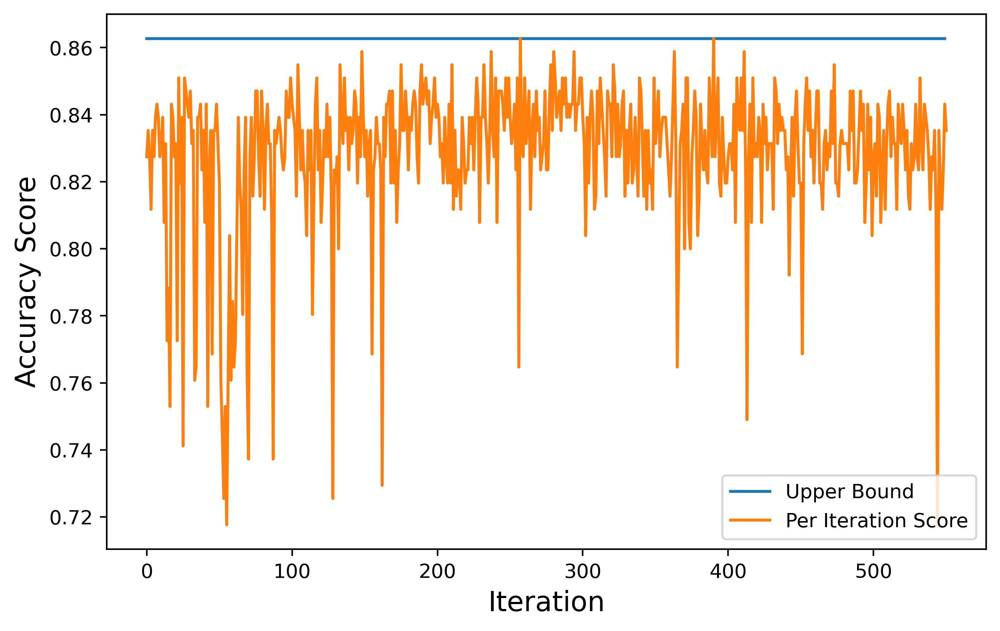

In [25]:
accR2=[]
for i in range(0,550):
    accR2.append(b)

plt.figure(figsize=(8,5),dpi=400)
plt.plot(accR2)
plt.plot(accR1)
plt.xlabel('Iteration', fontsize=14)
plt.ylabel('Accuracy Score', fontsize=14)
plt.legend(['Upper Bound', 'Per Iteration Score'], loc='lower right')
plt.savefig("RFUN-Bond.pdf")

In [26]:
sol0R1=[]
sol1R1=[]
accR1=[]
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)
def fitness_function(solution):
    print(solution)
    sol0R1.append(solution[0])
    sol1R1.append(solution[1])
    global dataFFeatures
    X =dataFFeatures
    y =  DataFTarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpF=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpF.append(X.columns[i])
    print(len(featuresimpF))

    global dataIFeatures
    X =dataIFeatures
    y =  DataITarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpI=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpI.append(X.columns[i])
    print(len(featuresimpI))
    dataIFeatures= dataIFeatures[featuresimpI]
    dataFFeatures= dataFFeatures[featuresimpF]

    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GF1=t_model.predict(dataFFeatures)


    #t_model = Sequential()
    #t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    #t_model.add(Dense(1024))
    #t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    #t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    #GF1=t_model.predict(dataFFeatures)
    
    #dI=pd.DataFrame(GI1)
    #dF=pd.DataFrame(GF1)
    
    #ComFeat=dF.append(dI,ignore_index = True) 
    #ComT=DataFTarget["Sub_Cat"].append(DataITarget["Sub_Cat"],ignore_index = True)


    X_train, X_test, y_train, y_test = train_test_split(GF1, DataFTarget["Sub_Cat"], test_size=0.15, random_state=1, stratify=DataFTarget["Sub_Cat"], shuffle=True)
    
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.svm import SVC
    from sklearn.linear_model import LogisticRegression
    ker=['linear', 'poly', 'rbf', 'sigmoid']
    #algo=['auto', 'ball_tree', 'kd_tree', 'brute']
    #a=LogisticRegression(random_state=int(solution[2]), solver=solvr[int(solution[3])],multi_class='multinomial',C=int(solution[4]))
    a =  ExtraTreesClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a =  RandomForestClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a = KNeighborsClassifier(n_neighbors=int(solution[2]),algorithm=algo[int(solution[3])])
    #a=SVC(kernel=ker[int(solution[3])], C=int(solution[2]))
    a_pred = a.fit(X_train, y_train)
    pred=a_pred.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accR1.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [90, 0.01, 10, 5],
    "ub": [2000, 0.03,300,20],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


#model = BasePSO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")

ETC
[1.52751000e+03 2.61796529e-02 2.51793248e+02 1.79329946e+01]
10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.68      0.52      0.59        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.66      0.73      0.69        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  6  3  2  0  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 1  0  6 19  0  0  0 

10
20
0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.66      0.73      0.69        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.95      0.69      0.80        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.83       255
     macro avg       0.85      0.83      0.83       255
  weighted avg       0.85      0.83      0.83       255

[[12  7  3  2  0  0  0  0  0  1]
 [ 1 24  0  0  1  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7176470588235294
                precision    recall  f1-score   support

      Analysis       1.00      0.16      0.28        25
      Backdoor       0.70      1.00      0.83        26
           DoS       0.51      0.92      0.66        25
      Exploits       0.39      0.35      0.37        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.46      0.57        26
     Shellcode       0.74      0.54      0.62        26
         Worms       0.58      0.88      0.70        25

      accuracy                           0.72       255
     macro avg       0.77      0.72      0.70       255
  weighted avg       0.77      0.72      0.70       255

[[ 4 11  2  3  0  0  0  0  1  4]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0 13  9  0  0  0  2  0  2]
 [ 0  0  0  3 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.68      0.73      0.70        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8588235294117647
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.71      0.77      0.74        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       1.00      0.77      0.87        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.86       255
     macro avg       0.87      0.86      0.86       255
  weighted avg       0.87      0.86      0.86       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  6 20  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.68      0.73      0.70        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[13  6  3  2  0  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7019607843137254
                precision    recall  f1-score   support

      Analysis       0.80      0.16      0.27        25
      Backdoor       0.70      1.00      0.83        26
           DoS       0.53      0.92      0.68        25
      Exploits       0.42      0.31      0.36        26
       Fuzzers       0.88      0.88      0.88        25
       Generic       0.90      1.00      0.95        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.87      0.50      0.63        26
     Shellcode       0.62      0.38      0.48        26
         Worms       0.54      0.88      0.67        25

      accuracy                           0.70       255
     macro avg       0.73      0.70      0.67       255
  weighted avg       0.73      0.70      0.67       255

[[ 4 11  2  1  2  0  0  0  1  4]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0 13  8  1  0  0  1  1  2]
 [ 0  0  0  3 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8588235294117647
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.70      0.81      0.75        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.69      0.82        26
     Shellcode       1.00      0.77      0.87        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.86       255
     macro avg       0.88      0.86      0.86       255
  weighted avg       0.88      0.86      0.86       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 21  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7215686274509804
                precision    recall  f1-score   support

      Analysis       1.00      0.20      0.33        25
      Backdoor       0.71      0.96      0.82        26
           DoS       0.52      0.92      0.67        25
      Exploits       0.45      0.35      0.39        26
       Fuzzers       0.85      0.92      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.68      0.50      0.58        26
     Shellcode       0.81      0.50      0.62        26
         Worms       0.58      0.88      0.70        25

      accuracy                           0.72       255
     macro avg       0.76      0.72      0.70       255
  weighted avg       0.76      0.72      0.70       255

[[ 5 10  3  1  2  0  0  0  0  4]
 [ 0 25  0  0  1  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0 14  9  1  0  0  1  0  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.82      0.36      0.50        25
      Backdoor       0.76      1.00      0.87        26
           DoS       0.55      0.92      0.69        25
      Exploits       0.45      0.38      0.42        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.66      0.84      0.74        25

      accuracy                           0.76       255
     macro avg       0.77      0.76      0.75       255
  weighted avg       0.77      0.76      0.75       255

[[ 9  8  3  2  1  0  0  0  0  2]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0 13 10  0  0  0  1  0  2]
 [ 0  0  0  3 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.65      0.52      0.58        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.84      0.74        25
      Exploits       0.68      0.73      0.70        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.90      0.69      0.78        26
         Worms       0.77      0.92      0.84        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  6  3  2  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 21  1  0  0  0  1  1  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.54      0.56      0.55        25
      Backdoor       0.76      0.73      0.75        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.70      0.73      0.72        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.69      0.80        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.83       255
  weighted avg       0.84      0.82      0.82       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 7 19  0  0  0  0  0  0  0  0]
 [ 1  0 22  0  0  0  0  1  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.64      0.56      0.60        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.66      0.76      0.70        25
      Exploits       0.75      0.81      0.78        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 1  0 19  1  0  0  0  3  0  1]
 [ 1  0  4 21  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.70      0.56      0.62        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.68      0.73      0.70        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       1.00      0.77      0.87        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.64      1.00      0.78        25
      Exploits       0.70      0.73      0.72        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.69      0.80        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.84       255
  weighted avg       0.86      0.85      0.84       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 25  0  0  0  0  0  0  0]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.87      0.52      0.65        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.68      0.81      0.74        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.79      0.92      0.85        25

      accuracy                           0.85       255
     macro avg       0.87      0.85      0.85       255
  weighted avg       0.87      0.85      0.85       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 21  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.66      0.73      0.69        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.69      0.80        26
     Shellcode       0.81      0.65      0.72        26
         Worms       0.79      0.88      0.83        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[12  7  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  1  0]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.54      0.53        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.94      0.62      0.74        26
     Shellcode       0.81      0.65      0.72        26
         Worms       0.67      0.88      0.76        25

      accuracy                           0.78       255
     macro avg       0.80      0.78      0.78       255
  weighted avg       0.80      0.78      0.78       255

[[10  7  3  3  0  0  0  0  0  2]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  1  0]
 [ 0  0 10 14  0  0  0  1  0  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.59      0.52      0.55        25
      Backdoor       0.77      0.77      0.77        26
           DoS       0.62      0.80      0.70        25
      Exploits       0.73      0.73      0.73        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.82       255
     macro avg       0.82      0.82      0.82       255
  weighted avg       0.82      0.82      0.82       255

[[13  6  3  1  0  0  0  2  0  0]
 [ 5 20  0  0  1  0  0  0  0  0]
 [ 1  0 20  1  0  0  0  2  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.70      0.73      0.72        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.77      0.85        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 24  0  0  0  0  0  0  1]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.73      0.44      0.55        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.72      0.92      0.81        25
      Exploits       0.69      0.85      0.76        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.69      0.82        26
     Shellcode       1.00      0.73      0.84        26
         Worms       0.80      0.96      0.87        25

      accuracy                           0.85       255
     macro avg       0.87      0.85      0.85       255
  weighted avg       0.87      0.85      0.85       255

[[11  9  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  4 22  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8627450980392157
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.72      0.92      0.81        25
      Exploits       0.67      0.85      0.75        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       1.00      0.77      0.87        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.86       255
     macro avg       0.88      0.86      0.86       255
  weighted avg       0.88      0.86      0.86       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  4 22  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8549019607843137
                precision    recall  f1-score   support

      Analysis       0.86      0.48      0.62        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.67      0.77      0.71        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       1.00      0.77      0.87        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.85       255
     macro avg       0.87      0.86      0.85       255
  weighted avg       0.87      0.85      0.85       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  6 20  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.65      0.52      0.58        25
      Backdoor       0.75      0.81      0.78        26
           DoS       0.61      0.80      0.69        25
      Exploits       0.73      0.73      0.73        26
       Fuzzers       1.00      1.00      1.00        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.83       255
     macro avg       0.83      0.83      0.83       255
  weighted avg       0.83      0.83      0.83       255

[[13  7  3  1  0  0  0  1  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 20  1  0  0  0  3  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.76      0.73      0.75        26
       Fuzzers       0.93      1.00      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.91      0.77      0.83        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.84       255
  weighted avg       0.84      0.84      0.84       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 3 22  0  0  1  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.70      0.73      0.72        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[12  7  3  1  0  0  0  2  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8156862745098039
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.74      1.00      0.85        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.59      0.73      0.66        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.88      0.58      0.70        26
     Shellcode       0.94      0.65      0.77        26
         Worms       0.80      0.96      0.87        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.81       255
  weighted avg       0.83      0.82      0.81       255

[[11  9  3  2  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 1  0 22  2  0  0  0  0  0  0]
 [ 0  0  6 19  0  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.71      0.88      0.79        25
      Exploits       0.69      0.85      0.76        26
       Fuzzers       1.00      1.00      1.00        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.84       255
  weighted avg       0.86      0.85      0.85       255

[[10  9  3  3  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  1  0]
 [ 0  0  4 22  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.91      0.40      0.56        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.55      0.62      0.58        26
       Fuzzers       0.92      0.88      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.88      0.58      0.70        26
     Shellcode       0.89      0.65      0.76        26
         Worms       0.61      0.92      0.73        25

      accuracy                           0.78       255
     macro avg       0.82      0.78      0.78       255
  weighted avg       0.82      0.78      0.78       255

[[10  7  3  2  1  0  0  0  0  2]
 [ 1 24  0  0  1  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  0  2]
 [ 0  0  9 16  0  0  0  0  0  1]
 [ 0  0  0  3 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.66      0.73      0.69        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.65      0.52      0.58        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.67      0.80      0.73        25
      Exploits       0.77      0.77      0.77        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.77      0.78        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.84       255
  weighted avg       0.84      0.84      0.84       255

[[13  6  3  1  0  0  0  2  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 1  0 20  1  0  0  0  2  0  1]
 [ 1  0  5 20  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.70      0.73      0.72        26
       Fuzzers       1.00      1.00      1.00        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[13  6  3  2  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.75      0.36      0.49        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.64      1.00      0.78        25
      Exploits       0.66      0.73      0.69        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       1.00      0.77      0.87        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.86      0.84      0.83       255
  weighted avg       0.86      0.84      0.83       255

[[ 9  9  3  3  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 25  0  0  0  0  0  0  0]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.76      0.96      0.85        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.68      0.81      0.74        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.85       255
     macro avg       0.87      0.85      0.85       255
  weighted avg       0.87      0.85      0.85       255

[[12  8  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  5 21  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.63      0.73      0.68        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       1.00      0.69      0.82        26
         Worms       0.77      0.96      0.86        25

      accuracy                           0.83       255
     macro avg       0.85      0.83      0.83       255
  weighted avg       0.85      0.83      0.83       255

[[11  7  3  3  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.70      0.73      0.72        26
       Fuzzers       1.00      1.00      1.00        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.66      0.73      0.69        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       1.00      0.69      0.82        26
         Worms       0.77      0.96      0.86        25

      accuracy                           0.84       255
     macro avg       0.87      0.84      0.84       255
  weighted avg       0.87      0.84      0.84       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.66      0.73      0.69        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.77      0.77      0.77        26
       Fuzzers       0.93      1.00      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[12  8  3  2  0  0  0  0  0  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 24  0  0  0  0  0  0  1]
 [ 0  0  6 20  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.81      0.96      0.88        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.70      0.73      0.72        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       1.00      0.73      0.84        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.85       255
     macro avg       0.87      0.85      0.85       255
  weighted avg       0.87      0.85      0.85       255

[[13  6  3  2  0  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.73      0.73      0.73        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.84       255
  weighted avg       0.86      0.85      0.84       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.68      0.52      0.59        25
      Backdoor       0.75      0.81      0.78        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.70      0.73      0.72        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.86      0.73      0.79        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  1  1]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.74      0.77      0.75        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  6 20  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8588235294117647
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.76      0.85      0.80        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.69      0.82        26
     Shellcode       1.00      0.73      0.84        26
         Worms       0.80      0.96      0.87        25

      accuracy                           0.86       255
     macro avg       0.87      0.86      0.86       255
  weighted avg       0.87      0.86      0.86       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  4 22  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.68      0.73      0.70        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.84       255
  weighted avg       0.86      0.85      0.84       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8156862745098039
                precision    recall  f1-score   support

      Analysis       0.55      0.48      0.51        25
      Backdoor       0.77      0.77      0.77        26
           DoS       0.65      0.80      0.71        25
      Exploits       0.66      0.73      0.69        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.83      0.77      0.80        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.82       255
     macro avg       0.82      0.82      0.82       255
  weighted avg       0.82      0.82      0.82       255

[[12  6  3  1  1  0  0  2  0  0]
 [ 6 20  0  0  0  0  0  0  0  0]
 [ 1  0 20  2  0  0  0  2  0  0]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.63      0.48      0.55        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.63      0.76      0.69        25
      Exploits       0.71      0.77      0.74        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.77      0.78        26
     Shellcode       1.00      0.77      0.87        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.83       255
     macro avg       0.83      0.83      0.83       255
  weighted avg       0.83      0.83      0.83       255

[[12  7  3  1  0  0  0  2  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 1  0 19  1  0  0  0  3  0  1]
 [ 1  0  5 20  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8549019607843137
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.68      0.81      0.74        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.85       255
     macro avg       0.87      0.86      0.85       255
  weighted avg       0.87      0.85      0.85       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  5 21  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.86      0.48      0.62        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.70      0.73      0.72        26
       Fuzzers       1.00      1.00      1.00        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.84       255
  weighted avg       0.86      0.85      0.84       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.70      0.81      0.75        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 1  0  4 21  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.70      0.56      0.62        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.75      0.81      0.78        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  0  0  0  0  0  1  1]
 [ 1  0  4 21  0  0  0  0  0  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.71      0.77      0.74        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.86      0.73      0.79        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[10  8  3  2  0  0  0  2  0  0]
 [ 3 22  0  0  1  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  1  0]
 [ 0  0  6 20  0  0  0  0  0  0]
 [ 1  0  0  0 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.68      0.73      0.70        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  0  0  0  0  1  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.67      0.56      0.61        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.76      0.70        25
      Exploits       0.78      0.81      0.79        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 1  0 19  1  0  0  0  3  0  1]
 [ 1  0  4 21  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8627450980392157
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.71      0.96      0.81        25
      Exploits       0.72      0.81      0.76        26
       Fuzzers       1.00      1.00      1.00        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.86       255
     macro avg       0.87      0.86      0.86       255
  weighted avg       0.87      0.86      0.86       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 1  0  4 21  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8549019607843137
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.73      0.73      0.73        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.85       255
     macro avg       0.87      0.86      0.85       255
  weighted avg       0.87      0.85      0.85       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8627450980392157
                precision    recall  f1-score   support

      Analysis       0.87      0.52      0.65        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.72      0.81      0.76        26
       Fuzzers       1.00      1.00      1.00        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.86       255
     macro avg       0.88      0.86      0.86       255
  weighted avg       0.88      0.86      0.86       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 21  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8549019607843137
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.71      0.77      0.74        26
       Fuzzers       1.00      1.00      1.00        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.85       255
     macro avg       0.87      0.86      0.85       255
  weighted avg       0.87      0.85      0.85       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  6 20  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8156862745098039
                precision    recall  f1-score   support

      Analysis       0.52      0.48      0.50        25
      Backdoor       0.72      0.69      0.71        26
           DoS       0.62      0.84      0.71        25
      Exploits       0.79      0.73      0.76        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.73      0.76        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.82       255
     macro avg       0.82      0.82      0.82       255
  weighted avg       0.82      0.82      0.82       255

[[12  7  3  1  0  0  0  2  0  0]
 [ 8 18  0  0  0  0  0  0  0  0]
 [ 1  0 21  1  0  0  0  2  0  0]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.63      0.96      0.76        25
      Exploits       0.70      0.73      0.72        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.85       255
     macro avg       0.87      0.85      0.85       255
  weighted avg       0.87      0.85      0.85       255

[[13  6  3  2  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.73      0.73      0.73        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 1  0  6 19  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8549019607843137
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.66      0.81      0.72        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.85       255
     macro avg       0.87      0.85      0.85       255
  weighted avg       0.87      0.85      0.85       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  5 21  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8705882352941177
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.73      0.85      0.79        26
       Fuzzers       1.00      1.00      1.00        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       1.00      0.77      0.87        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.87       255
     macro avg       0.89      0.87      0.87       255
  weighted avg       0.89      0.87      0.87       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  4 22  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8666666666666667
                precision    recall  f1-score   support

      Analysis       0.93      0.52      0.67        25
      Backdoor       0.79      1.00      0.88        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.71      0.85      0.77        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.87       255
     macro avg       0.89      0.87      0.86       255
  weighted avg       0.89      0.87      0.86       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  4 22  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8549019607843137
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.72      0.81      0.76        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.85       255
     macro avg       0.87      0.86      0.85       255
  weighted avg       0.87      0.85      0.85       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 21  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.68      0.73      0.70        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.79      0.92      0.85        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  6  3  2  0  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 19  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8745098039215686
                precision    recall  f1-score   support

      Analysis       0.87      0.52      0.65        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.71      0.96      0.81        25
      Exploits       0.73      0.85      0.79        26
       Fuzzers       1.00      1.00      1.00        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       1.00      0.77      0.87        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.87       255
     macro avg       0.89      0.87      0.87       255
  weighted avg       0.89      0.87      0.87       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  4 22  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.74      1.00      0.85        26
           DoS       0.71      0.88      0.79        25
      Exploits       0.67      0.85      0.75        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.69      0.82        26
     Shellcode       1.00      0.73      0.84        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.84       255
  weighted avg       0.86      0.85      0.84       255

[[10  9  3  3  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 1  0 22  2  0  0  0  0  0  0]
 [ 0  0  4 22  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8549019607843137
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.70      0.81      0.75        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.85       255
     macro avg       0.87      0.85      0.85       255
  weighted avg       0.87      0.85      0.85       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 21  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8588235294117647
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.69      0.85      0.76        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       1.00      0.77      0.87        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.86       255
     macro avg       0.88      0.86      0.86       255
  weighted avg       0.88      0.86      0.86       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  4 22  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8588235294117647
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.69      0.88      0.77        25
      Exploits       0.73      0.85      0.79        26
       Fuzzers       1.00      1.00      1.00        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.86       255
     macro avg       0.87      0.86      0.86       255
  weighted avg       0.87      0.86      0.86       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 1  0 22  1  0  0  0  0  0  1]
 [ 0  0  4 22  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8627450980392157
                precision    recall  f1-score   support

      Analysis       0.87      0.52      0.65        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.69      0.85      0.76        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.86       255
     macro avg       0.88      0.86      0.86       255
  weighted avg       0.88      0.86      0.86       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  4 22  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8666666666666667
                precision    recall  f1-score   support

      Analysis       0.88      0.56      0.68        25
      Backdoor       0.81      0.96      0.88        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.69      0.85      0.76        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       1.00      0.77      0.87        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.87       255
     macro avg       0.89      0.87      0.87       255
  weighted avg       0.89      0.87      0.87       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  4 22  0  0  0  0  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8549019607843137
                precision    recall  f1-score   support

      Analysis       0.91      0.40      0.56        25
      Backdoor       0.74      1.00      0.85        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.71      0.85      0.77        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       1.00      0.73      0.84        26
         Worms       0.80      0.96      0.87        25

      accuracy                           0.85       255
     macro avg       0.88      0.85      0.85       255
  weighted avg       0.88      0.85      0.85       255

[[10  9  3  2  1  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  4 22  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8627450980392157
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.70      0.81      0.75        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       1.00      0.77      0.87        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.86       255
     macro avg       0.88      0.86      0.86       255
  weighted avg       0.88      0.86      0.86       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 21  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8666666666666667
                precision    recall  f1-score   support

      Analysis       0.87      0.52      0.65        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.75      0.81      0.78        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.73      0.84        26
     Shellcode       1.00      0.77      0.87        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.87       255
     macro avg       0.88      0.87      0.86       255
  weighted avg       0.88      0.87      0.86       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 21  0  0  0  0  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.69      0.77      0.73        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 1  0  5 20  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.79      0.44      0.56        25
      Backdoor       0.74      1.00      0.85        26
           DoS       0.69      0.88      0.77        25
      Exploits       0.67      0.85      0.75        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       1.00      0.69      0.82        26
     Shellcode       1.00      0.73      0.84        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.85       255
     macro avg       0.87      0.85      0.85       255
  weighted avg       0.87      0.85      0.85       255

[[11  9  3  2  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 1  0 22  2  0  0  0  0  0  0]
 [ 0  0  4 22  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8588235294117647
                precision    recall  f1-score   support

      Analysis       0.87      0.52      0.65        25
      Backdoor       0.78      0.96      0.86        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.70      0.81      0.75        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.95      0.73      0.83        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.86       255
     macro avg       0.87      0.86      0.86       255
  weighted avg       0.87      0.86      0.86       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 21  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

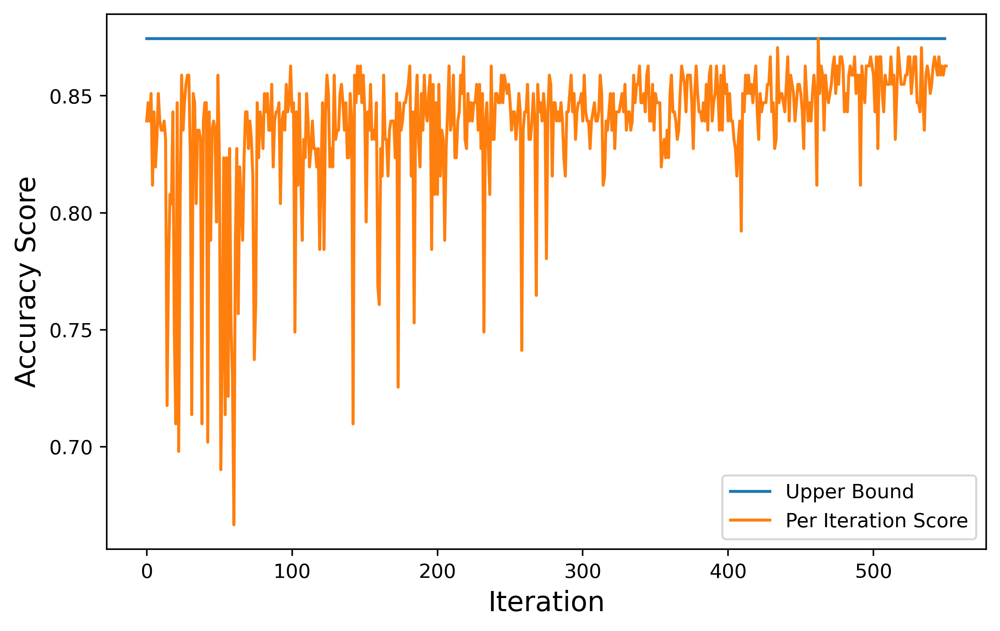

In [27]:
print(accR1)

b=max(accR1)

accR2=[]
for i in range(0,550):
    accR2.append(b)

plt.figure(figsize=(8,5),dpi=400)
plt.plot(accR2)
plt.plot(accR1)
plt.xlabel('Iteration', fontsize=14)
plt.ylabel('Accuracy Score', fontsize=14)
plt.legend(['Upper Bound', 'Per Iteration Score'], loc='lower right')
plt.savefig("ETCUN-Bond.pdf")

[0.8392156862745098, 0.8470588235294118, 0.8392156862745098, 0.8509803921568627, 0.8117647058823529, 0.8431372549019608, 0.8196078431372549, 0.8313725490196079, 0.8509803921568627, 0.8392156862745098, 0.8352941176470589, 0.8352941176470589, 0.8392156862745098, 0.8313725490196079, 0.7176470588235294, 0.7764705882352941, 0.807843137254902, 0.803921568627451, 0.8431372549019608, 0.7490196078431373, 0.7098039215686275, 0.8470588235294118, 0.6980392156862745, 0.803921568627451, 0.8588235294117647, 0.8352941176470589, 0.8470588235294118, 0.8549019607843137, 0.8588235294117647, 0.8588235294117647, 0.8235294117647058, 0.7137254901960784, 0.8509803921568627, 0.8470588235294118, 0.803921568627451, 0.8352941176470589, 0.8352941176470589, 0.8313725490196079, 0.7098039215686275, 0.8392156862745098, 0.8470588235294118, 0.8470588235294118, 0.7019607843137254, 0.8431372549019608, 0.788235294117647, 0.8352941176470589, 0.8392156862745098, 0.8352941176470589, 0.796078431372549, 0.8588235294117647, 0.823

In [29]:
sol0R1=[]
sol1R1=[]
accR1=[]
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)
def fitness_function(solution):
    print(solution)
    sol0R1.append(solution[0])
    sol1R1.append(solution[1])
    global dataFFeatures
    X =dataFFeatures
    y =  DataFTarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpF=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpF.append(X.columns[i])
    print(len(featuresimpF))

    global dataIFeatures
    X =dataIFeatures
    y =  DataITarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpI=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpI.append(X.columns[i])
    print(len(featuresimpI))
    dataIFeatures= dataIFeatures[featuresimpI]
    dataFFeatures= dataFFeatures[featuresimpF]

    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GF1=t_model.predict(dataFFeatures)


    #t_model = Sequential()
    #t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    #t_model.add(Dense(1024))
    #t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    #t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    #GF1=t_model.predict(dataFFeatures)
    
    #dI=pd.DataFrame(GI1)
    #dF=pd.DataFrame(GF1)
    
    #ComFeat=dF.append(dI,ignore_index = True) 
    #ComT=DataFTarget["Sub_Cat"].append(DataITarget["Sub_Cat"],ignore_index = True)


    X_train, X_test, y_train, y_test = train_test_split(GF1, DataFTarget["Sub_Cat"], test_size=0.15, random_state=1, stratify=DataFTarget["Sub_Cat"], shuffle=True)
    
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.svm import SVC
    from sklearn.linear_model import LogisticRegression
    #ker=['linear', 'poly', 'rbf', 'sigmoid']
    
    solvr=['saga','sag','newton-cg', 'lbfgs']
    #algo=['auto', 'ball_tree', 'kd_tree', 'brute']
    a=LogisticRegression(random_state=int(solution[2]), solver=solvr[int(solution[3])],multi_class='multinomial',C=int(solution[4]))
    #a =  ExtraTreesClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a =  RandomForestClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a = KNeighborsClassifier(n_neighbors=int(solution[2]),algorithm=algo[int(solution[3])])
    #a=SVC(kernel=ker[int(solution[3])], C=int(solution[2]))
    a_pred = a.fit(X_train, y_train)
    pred=a_pred.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accR1.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [90, 0.01, 10, 0,1],
    "ub": [2000, 0.03,300,3,10],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


#model = BasePSO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")

ETC
[1.40686630e+03 2.35039788e-02 1.65273309e+02 6.74500096e-01
 8.23471598e+00]
10
20


C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.83      0.58      0.68        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.62      0.92      0.74        25

      accuracy                           0.78       255
     macro avg       0.80      0.79      0.78       255
  weighted avg       0.80      0.78      0.78       255

[[13  5  2  1  2  0  0  0  1  1]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  0  2]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.62      0.50      0.55        26
     Shellcode       0.71      0.46      0.56        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.73       255
  weighted avg       0.75      0.75      0.73       255

[[10  8  2  1  2  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7176470588235294
                precision    recall  f1-score   support

      Analysis       0.64      0.28      0.39        25
      Backdoor       0.75      0.92      0.83        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.95      0.84      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.48      0.42      0.45        26
     Shellcode       0.80      0.46      0.59        26
         Worms       0.55      0.88      0.68        25

      accuracy                           0.72       255
     macro avg       0.73      0.72      0.71       255
  weighted avg       0.73      0.72      0.70       255

[[ 7  8  3  2  1  0  0  0  0  4]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  2  0  0]
 [ 0  0  7 13  0  0  0  2  1  3]
 [ 0  0  0  4 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.85      0.92      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.72      0.50      0.59        26
     Shellcode       0.67      0.54      0.60        26
         Worms       0.67      0.88      0.76        25

      accuracy                           0.77       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[14  5  2  1  2  0  0  0  1  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 13  2  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.803921568627451
                precision    recall  f1-score   support

      Analysis       0.79      0.60      0.68        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.58      0.55        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.77      0.65      0.71        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.80       255
     macro avg       0.82      0.80      0.81       255
  weighted avg       0.82      0.80      0.81       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  1  1]
 [ 0  0  8 15  0  0  0  2  1  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7098039215686275
                precision    recall  f1-score   support

      Analysis       0.57      0.32      0.41        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.44      0.42      0.43        26
       Fuzzers       0.79      0.76      0.78        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.62      0.50      0.55        26
     Shellcode       0.76      0.50      0.60        26
         Worms       0.59      0.88      0.71        25

      accuracy                           0.71       255
     macro avg       0.71      0.71      0.70       255
  weighted avg       0.71      0.71      0.70       255

[[ 8  8  2  2  1  0  0  0  1  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 11  3  0  0  1  1  1]
 [ 1  0  0  5 19  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7529411764705882
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.46      0.57        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.75       255
     macro avg       0.76      0.75      0.74       255
  weighted avg       0.76      0.75      0.74       255

[[10  8  2  1  2  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.48      0.46      0.47        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.67      0.46      0.55        26
     Shellcode       0.78      0.54      0.64        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.75       255
     macro avg       0.76      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[12  8  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 12  1  0  0  1  1  2]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.69      0.88      0.77        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.77      0.92      0.84        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  6 16  1  0  0  2  0  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.63      0.48      0.55        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.48      0.38      0.43        26
       Fuzzers       0.81      0.88      0.85        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.73      0.62      0.67        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.73      0.88      0.80        25

      accuracy                           0.76       255
     macro avg       0.75      0.76      0.75       255
  weighted avg       0.75      0.76      0.75       255

[[12  7  2  1  2  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 10  3  0  0  1  1  2]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.55      0.62      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.83       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.50      0.46      0.48        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.65      0.42      0.51        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.75       255
     macro avg       0.74      0.75      0.73       255
  weighted avg       0.74      0.75      0.73       255

[[10  8  2  2  1  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  2  0  0  1  1  1]
 [ 0  0  0  1 23  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.76       255
  weighted avg       0.78      0.77      0.76       255

[[10  8  2  1  2  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.807843137254902
                precision    recall  f1-score   support

      Analysis       0.79      0.60      0.68        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.57      0.65      0.61        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.58      0.65        26
     Shellcode       0.81      0.65      0.72        26
         Worms       0.79      0.88      0.83        25

      accuracy                           0.81       255
     macro avg       0.82      0.81      0.81       255
  weighted avg       0.82      0.81      0.81       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  6 17  0  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7372549019607844
                precision    recall  f1-score   support

      Analysis       0.65      0.44      0.52        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.61      0.42      0.50        26
     Shellcode       0.65      0.42      0.51        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.74       255
     macro avg       0.74      0.74      0.73       255
  weighted avg       0.74      0.74      0.72       255

[[11  8  2  2  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[12  8  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.83       255
     macro avg       0.85      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  8 16  0  0  0  1  1  0]
 [ 0  0  0  1 23  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7176470588235294
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.72      0.81      0.76        26
           DoS       0.55      0.92      0.69        25
      Exploits       0.55      0.42      0.48        26
       Fuzzers       0.86      0.96      0.91        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.53      0.38      0.44        26
     Shellcode       0.61      0.42      0.50        26
         Worms       0.66      0.84      0.74        25

      accuracy                           0.72       255
     macro avg       0.72      0.72      0.71       255
  weighted avg       0.72      0.72      0.70       255

[[11  8  2  1  1  0  0  0  1  1]
 [ 4 21  0  0  1  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 11  2  0  0  1  2  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7529411764705882
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.59      0.92      0.72        25
      Exploits       0.50      0.42      0.46        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.62      0.68        26
     Shellcode       0.78      0.54      0.64        26
         Worms       0.65      0.88      0.75        25

      accuracy                           0.75       255
     macro avg       0.76      0.75      0.74       255
  weighted avg       0.76      0.75      0.74       255

[[10  8  3  1  2  0  0  0  0  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 11  0  0  0  2  1  3]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.70      0.56      0.62        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.95      0.84      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.65      0.88      0.75        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[14  5  2  2  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  7 16  0  0  0  2  1  0]
 [ 1  0  0  3 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.59      0.73      0.66        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.83      0.73      0.78        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  6  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 19  0  0  0  1  1  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.70      0.54      0.61        26
     Shellcode       0.70      0.54      0.61        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[13  6  2  2  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7215686274509804
                precision    recall  f1-score   support

      Analysis       0.59      0.40      0.48        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.66      0.84      0.74        25
      Exploits       0.59      0.50      0.54        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.50      0.42      0.46        26
     Shellcode       0.50      0.38      0.43        26
         Worms       0.59      0.88      0.71        25

      accuracy                           0.72       255
     macro avg       0.71      0.72      0.71       255
  weighted avg       0.71      0.72      0.71       255

[[10  6  1  1  2  0  0  1  1  3]
 [ 3 22  0  0  0  0  0  0  0  1]
 [ 0  0 21  0  0  0  0  2  1  1]
 [ 1  0  6 13  0  0  0  1  4  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7372549019607844
                precision    recall  f1-score   support

      Analysis       0.62      0.40      0.49        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.65      0.50      0.57        26
     Shellcode       0.67      0.46      0.55        26
         Worms       0.65      0.88      0.75        25

      accuracy                           0.74       255
     macro avg       0.74      0.74      0.73       255
  weighted avg       0.74      0.74      0.73       255

[[10  8  2  1  2  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7411764705882353
                precision    recall  f1-score   support

      Analysis       0.57      0.32      0.41        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.55      0.46      0.50        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.68      0.58      0.62        26
     Shellcode       0.74      0.54      0.62        26
         Worms       0.64      0.84      0.72        25

      accuracy                           0.74       255
     macro avg       0.74      0.74      0.73       255
  weighted avg       0.74      0.74      0.73       255

[[ 8  8  2  1  2  0  0  0  1  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 1  0  9 12  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7333333333333333
                precision    recall  f1-score   support

      Analysis       0.67      0.32      0.43        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.55      0.42      0.48        26
       Fuzzers       0.83      0.96      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.62      0.50      0.55        26
     Shellcode       0.75      0.46      0.57        26
         Worms       0.61      0.92      0.73        25

      accuracy                           0.73       255
     macro avg       0.74      0.74      0.72       255
  weighted avg       0.74      0.73      0.72       255

[[ 8  8  2  1  2  0  0  0  1  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 11  3  0  0  1  1  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8
                precision    recall  f1-score   support

      Analysis       0.73      0.64      0.68        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.66      0.84      0.74        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.73      0.75        26
     Shellcode       0.70      0.62      0.65        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.80       255
     macro avg       0.80      0.80      0.80       255
  weighted avg       0.80      0.80      0.80       255

[[16  5  2  1  0  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 21  1  0  0  0  1  1  1]
 [ 0  0  8 15  0  0  0  1  2  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  0]
 [ 0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.85      0.92      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.84      0.62      0.71        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.76       255
  weighted avg       0.78      0.77      0.76       255

[[10  8  3  1  2  0  0  0  0  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  8 13  2  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[14  6  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[14  7  2  1  0  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.75      0.60      0.67        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[15  5  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6980392156862745
                precision    recall  f1-score   support

      Analysis       0.60      0.36      0.45        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.55      0.92      0.69        25
      Exploits       0.45      0.38      0.42        26
       Fuzzers       0.91      0.84      0.87        25
       Generic       0.93      1.00      0.96        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.56      0.35      0.43        26
     Shellcode       0.65      0.42      0.51        26
         Worms       0.58      0.84      0.69        25

      accuracy                           0.70       255
     macro avg       0.70      0.70      0.68       255
  weighted avg       0.70      0.70      0.68       255

[[ 9  8  2  1  2  0  0  1  1  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 1  0  9 10  0  0  0  2  1  3]
 [ 0  0  0  2 21  2  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.60      0.69      0.64        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 18  0  0  0  1  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.56      0.54      0.55        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.50      0.60        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 14  0  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7254901960784313
                precision    recall  f1-score   support

      Analysis       0.62      0.40      0.49        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.50      0.46      0.48        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.57      0.46      0.51        26
     Shellcode       0.71      0.46      0.56        26
         Worms       0.64      0.84      0.72        25

      accuracy                           0.73       255
     macro avg       0.73      0.73      0.72       255
  weighted avg       0.72      0.73      0.71       255

[[10  8  2  2  1  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 12  2  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7294117647058823
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.46      0.42      0.44        26
       Fuzzers       0.80      0.80      0.80        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.67      0.54      0.60        26
     Shellcode       0.77      0.38      0.51        26
         Worms       0.57      0.92      0.71        25

      accuracy                           0.73       255
     macro avg       0.74      0.73      0.72       255
  weighted avg       0.74      0.73      0.72       255

[[13  5  3  1  2  0  0  0  0  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  0  2]
 [ 0  0  9 11  2  0  0  1  1  2]
 [ 1  0  0  4 20  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.65      0.44      0.52        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.60      0.58      0.59        26
     Shellcode       0.69      0.42      0.52        26
         Worms       0.69      0.88      0.77        25

      accuracy                           0.75       255
     macro avg       0.74      0.75      0.74       255
  weighted avg       0.74      0.75      0.74       255

[[11  7  2  1  2  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7137254901960784
                precision    recall  f1-score   support

      Analysis       0.62      0.32      0.42        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.50      0.42      0.46        26
       Fuzzers       0.77      0.96      0.86        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.57      0.46      0.51        26
     Shellcode       0.73      0.42      0.54        26
         Worms       0.61      0.88      0.72        25

      accuracy                           0.71       255
     macro avg       0.71      0.72      0.70       255
  weighted avg       0.71      0.71      0.70       255

[[ 8  8  3  1  2  0  0  0  0  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 11  3  0  0  1  1  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.86      0.96      0.91        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.67      0.54      0.60        26
     Shellcode       0.65      0.50      0.57        26
         Worms       0.71      0.88      0.79        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[10  8  2  1  2  0  0  0  1  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.803921568627451
                precision    recall  f1-score   support

      Analysis       0.73      0.64      0.68        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.54      0.58      0.56        26
       Fuzzers       1.00      0.84      0.91        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.78      0.69      0.73        26
         Worms       0.76      0.88      0.81        25

      accuracy                           0.80       255
     macro avg       0.82      0.80      0.81       255
  weighted avg       0.82      0.80      0.81       255

[[16  5  3  1  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  1  1]
 [ 0  0  8 15  0  0  0  1  1  1]
 [ 1  0  0  3 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7215686274509804
                precision    recall  f1-score   support

      Analysis       0.60      0.36      0.45        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.53      0.38      0.44        26
       Fuzzers       0.83      0.96      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.62      0.50      0.55        26
     Shellcode       0.65      0.42      0.51        26
         Worms       0.58      0.88      0.70        25

      accuracy                           0.72       255
     macro avg       0.72      0.72      0.71       255
  weighted avg       0.72      0.72      0.71       255

[[ 9  6  3  1  1  0  0  0  0  5]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 1  0  9 10  3  0  0  1  1  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8156862745098039
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.58      0.56        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.77      0.65      0.71        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[14  5  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  8 15  0  0  0  3  0  0]
 [ 0  0  0  1 23  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7176470588235294
                precision    recall  f1-score   support

      Analysis       0.73      0.32      0.44        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.60      0.84      0.70        25
      Exploits       0.56      0.38      0.45        26
       Fuzzers       0.86      0.96      0.91        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.59      0.50      0.54        26
     Shellcode       0.57      0.50      0.53        26
         Worms       0.57      0.84      0.68        25

      accuracy                           0.72       255
     macro avg       0.72      0.72      0.70       255
  weighted avg       0.72      0.72      0.70       255

[[ 8  8  3  1  2  0  0  0  0  3]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 21  0  0  0  0  2  1  1]
 [ 0  0  8 10  1  0  0  1  4  2]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6901960784313725
                precision    recall  f1-score   support

      Analysis       0.64      0.28      0.39        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.51      0.88      0.65        25
      Exploits       0.50      0.38      0.43        26
       Fuzzers       0.79      0.88      0.83        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.56      0.35      0.43        26
     Shellcode       0.73      0.42      0.54        26
         Worms       0.55      0.88      0.68        25

      accuracy                           0.69       255
     macro avg       0.70      0.69      0.67       255
  weighted avg       0.70      0.69      0.67       255

[[ 7  8  3  2  1  0  0  0  0  4]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  1  0  0  1  0  0]
 [ 0  0 10 10  1  1  0  0  1  3]
 [ 0  0  0  2 22  0  0  1  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.77      0.65      0.71        26
         Worms       0.76      0.88      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[12  8  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.803921568627451
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.59      0.92      0.72        25
      Exploits       0.54      0.58      0.56        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.88      0.58      0.70        26
     Shellcode       0.75      0.69      0.72        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.80       255
     macro avg       0.82      0.80      0.80       255
  weighted avg       0.82      0.80      0.80       255

[[14  5  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  8 15  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.41      0.42      0.42        26
       Fuzzers       0.88      0.88      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.71      0.58      0.64        26
     Shellcode       0.74      0.54      0.62        26
         Worms       0.73      0.88      0.80        25

      accuracy                           0.76       255
     macro avg       0.77      0.76      0.75       255
  weighted avg       0.77      0.76      0.75       255

[[13  6  3  3  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 11  3  0  0  1  1  1]
 [ 0  0  0  3 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7529411764705882
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.70      0.54      0.61        26
     Shellcode       0.70      0.54      0.61        26
         Worms       0.73      0.88      0.80        25

      accuracy                           0.75       255
     macro avg       0.76      0.75      0.75       255
  weighted avg       0.75      0.75      0.75       255

[[11  8  3  1  2  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.87      0.52      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.70      0.54      0.61        26
     Shellcode       0.64      0.54      0.58        26
         Worms       0.73      0.88      0.80        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[13  6  2  1  2  0  0  0  1  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.596078431372549
                precision    recall  f1-score   support

      Analysis       0.40      0.08      0.13        25
      Backdoor       0.65      1.00      0.79        26
           DoS       0.55      0.88      0.68        25
      Exploits       0.29      0.19      0.23        26
       Fuzzers       0.65      0.60      0.63        25
       Generic       0.87      1.00      0.93        26
        Normal       1.00      0.92      0.96        25
Reconnaissance       0.40      0.15      0.22        26
     Shellcode       0.37      0.42      0.39        26
         Worms       0.49      0.72      0.58        25

      accuracy                           0.60       255
     macro avg       0.57      0.60      0.55       255
  weighted avg       0.57      0.60      0.55       255

[[ 2 13  2  2  1  0  0  0  1  4]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  1  0]
 [ 1  0  7  5  3  1  0  0  8  1]
 [ 0  0  0  2 15  3  0  2  0  3]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.6705882352941176
                precision    recall  f1-score   support

      Analysis       1.00      0.28      0.44        25
      Backdoor       0.76      0.96      0.85        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.46      0.42      0.44        26
       Fuzzers       0.79      0.60      0.68        25
       Generic       0.84      1.00      0.91        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.46      0.42      0.44        26
     Shellcode       0.67      0.38      0.49        26
         Worms       0.48      0.80      0.60        25

      accuracy                           0.67       255
     macro avg       0.71      0.67      0.65       255
  weighted avg       0.70      0.67      0.65       255

[[ 7  8  2  2  1  0  0  0  1  4]
 [ 0 25  0  0  0  0  0  0  0  1]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 11  0  1  0  1  1  3]
 [ 0  0  0  3 15  4  0  1  0  2]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.50      0.54      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.71      0.65      0.68        26
         Worms       0.73      0.88      0.80        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[14  5  2  2  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  8 14  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.58      0.88      0.70        25
      Exploits       0.59      0.50      0.54        26
       Fuzzers       0.89      0.96      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.70      0.54      0.61        26
     Shellcode       0.78      0.54      0.64        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[10  8  3  1  2  0  0  0  0  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  0 24  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.88      0.81      0.84        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.84       255
     macro avg       0.86      0.84      0.84       255
  weighted avg       0.86      0.84      0.84       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 17  0  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.48      0.42      0.45        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.63      0.65      0.64        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.78      0.84      0.81        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[14  6  3  1  1  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 11  1  0  0  2  1  2]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7058823529411765
                precision    recall  f1-score   support

      Analysis       0.61      0.44      0.51        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.52      0.88      0.66        25
      Exploits       0.53      0.35      0.42        26
       Fuzzers       0.89      0.96      0.92        25
       Generic       1.00      0.96      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.50      0.42      0.46        26
     Shellcode       0.64      0.35      0.45        26
         Worms       0.63      0.88      0.73        25

      accuracy                           0.71       255
     macro avg       0.71      0.71      0.69       255
  weighted avg       0.71      0.71      0.69       255

[[11  7  3  2  1  0  0  0  0  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 1  0 22  1  0  0  0  1  0  0]
 [ 3  0  9  9  0  0  0  3  1  1]
 [ 0  0  0  0 24  0  0  1  0  0]
 [ 0  0  1  0  0 25  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6823529411764706
                precision    recall  f1-score   support

      Analysis       0.64      0.28      0.39        25
      Backdoor       0.71      0.85      0.77        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.48      0.38      0.43        26
       Fuzzers       0.85      0.88      0.86        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.48      0.42      0.45        26
     Shellcode       0.44      0.27      0.33        26
         Worms       0.55      0.88      0.68        25

      accuracy                           0.68       255
     macro avg       0.67      0.68      0.66       255
  weighted avg       0.67      0.68      0.66       255

[[ 7  8  2  1  1  0  0  0  1  5]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  1  0]
 [ 0  0  9 10  3  0  0  1  1  2]
 [ 0  1  0  1 22  0  0  0  1  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6352941176470588
                precision    recall  f1-score   support

      Analysis       0.58      0.28      0.38        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.50      0.96      0.66        25
      Exploits       0.35      0.23      0.28        26
       Fuzzers       0.80      0.48      0.60        25
       Generic       0.83      0.96      0.89        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.52      0.54      0.53        26
     Shellcode       0.58      0.27      0.37        26
         Worms       0.51      0.80      0.62        25

      accuracy                           0.64       255
     macro avg       0.64      0.64      0.61       255
  weighted avg       0.64      0.64      0.61       255

[[ 7  8  2  1  2  1  0  2  0  2]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 24  0  0  0  0  1  0  0]
 [ 0  0 14  6  0  0  0  1  2  3]
 [ 0  0  0  3 12  1  0  4  0  5]
 [ 0  0  1  0  0 25  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7529411764705882
                precision    recall  f1-score   support

      Analysis       0.87      0.52      0.65        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.48      0.42      0.45        26
       Fuzzers       0.85      0.92      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.65      0.50      0.57        26
     Shellcode       0.81      0.50      0.62        26
         Worms       0.59      0.92      0.72        25

      accuracy                           0.75       255
     macro avg       0.77      0.75      0.75       255
  weighted avg       0.77      0.75      0.75       255

[[13  5  2  1  2  0  0  0  1  1]
 [ 2 23  0  0  0  0  0  0  0  1]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  8 11  2  0  0  1  1  3]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6784313725490196
                precision    recall  f1-score   support

      Analysis       0.54      0.28      0.37        25
      Backdoor       0.71      0.92      0.80        26
           DoS       0.69      0.88      0.77        25
      Exploits       0.50      0.42      0.46        26
       Fuzzers       0.70      0.84      0.76        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.44      0.31      0.36        26
     Shellcode       0.62      0.38      0.48        26
         Worms       0.51      0.80      0.62        25

      accuracy                           0.68       255
     macro avg       0.67      0.68      0.66       255
  weighted avg       0.67      0.68      0.66       255

[[ 7  8  3  1  2  0  0  0  0  4]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 1  0 22  0  0  0  0  1  0  1]
 [ 2  0  4 11  3  0  0  1  2  3]
 [ 0  0  0  3 21  0  0  1  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.58      0.88      0.70        25
      Exploits       0.55      0.46      0.50        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.50      0.60        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.59      0.88      0.71        25

      accuracy                           0.75       255
     macro avg       0.76      0.75      0.74       255
  weighted avg       0.76      0.75      0.74       255

[[10  8  3  1  2  0  0  0  0  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 12  0  1  0  1  1  2]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7294117647058823
                precision    recall  f1-score   support

      Analysis       0.67      0.32      0.43        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.52      0.42      0.47        26
     Shellcode       0.67      0.46      0.55        26
         Worms       0.61      0.88      0.72        25

      accuracy                           0.73       255
     macro avg       0.73      0.73      0.72       255
  weighted avg       0.73      0.73      0.72       255

[[ 8  8  2  2  1  0  0  0  1  3]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  0  0  0  2  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7529411764705882
                precision    recall  f1-score   support

      Analysis       0.73      0.44      0.55        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.89      0.96      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.65      0.42      0.51        26
     Shellcode       0.67      0.54      0.60        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[11  8  2  1  2  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7411764705882353
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.50      0.46      0.48        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.65      0.42      0.51        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.62      0.92      0.74        25

      accuracy                           0.74       255
     macro avg       0.75      0.74      0.73       255
  weighted avg       0.74      0.74      0.73       255

[[10  8  2  2  1  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 12  0  0  0  2  1  2]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.79      0.44      0.56        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.70      0.54      0.61        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.67      0.88      0.76        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[11  8  2  1  1  0  0  0  1  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  0  0  0  2  1  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7411764705882353
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.85      0.92      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.68      0.50      0.58        26
     Shellcode       0.81      0.50      0.62        26
         Worms       0.62      0.92      0.74        25

      accuracy                           0.74       255
     macro avg       0.75      0.74      0.73       255
  weighted avg       0.75      0.74      0.73       255

[[10  8  3  1  2  0  0  0  0  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 12  2  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8156862745098039
                precision    recall  f1-score   support

      Analysis       0.73      0.64      0.68        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.82      0.69      0.75        26
         Worms       0.79      0.92      0.85        25

      accuracy                           0.82       255
     macro avg       0.82      0.82      0.82       255
  weighted avg       0.82      0.82      0.81       255

[[16  5  3  1  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  1  0]
 [ 0  0  6 16  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.79      0.44      0.56        25
      Backdoor       0.75      0.92      0.83        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.76       255
  weighted avg       0.78      0.77      0.76       255

[[11  8  2  1  2  0  0  0  1  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7019607843137254
                precision    recall  f1-score   support

      Analysis       0.67      0.32      0.43        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.48      0.42      0.45        26
       Fuzzers       0.81      0.84      0.82        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.48      0.42      0.45        26
     Shellcode       0.69      0.42      0.52        26
         Worms       0.56      0.88      0.69        25

      accuracy                           0.70       255
     macro avg       0.71      0.70      0.69       255
  weighted avg       0.70      0.70      0.69       255

[[ 8  7  2  1  2  0  0  0  1  4]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  2  0  0]
 [ 0  0  9 11  2  0  0  1  1  2]
 [ 0  0  0  3 21  0  0  1  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.46      0.57        26
     Shellcode       0.79      0.58      0.67        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.76       255
  weighted avg       0.78      0.77      0.76       255

[[14  6  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7098039215686275
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.42      0.38      0.40        26
       Fuzzers       0.84      0.84      0.84        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.55      0.42      0.48        26
     Shellcode       0.58      0.42      0.49        26
         Worms       0.59      0.88      0.71        25

      accuracy                           0.71       255
     macro avg       0.71      0.71      0.70       255
  weighted avg       0.71      0.71      0.70       255

[[10  6  2  2  1  0  0  0  1  3]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  1  0]
 [ 0  0  7 10  2  0  0  1  3  3]
 [ 0  1  0  3 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.56      0.54      0.55        26
       Fuzzers       0.85      0.92      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.70      0.54      0.61        26
     Shellcode       0.68      0.50      0.58        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[12  7  2  1  2  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  7 14  2  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6784313725490196
                precision    recall  f1-score   support

      Analysis       0.59      0.40      0.48        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.55      0.88      0.68        25
      Exploits       0.32      0.23      0.27        26
       Fuzzers       0.73      0.76      0.75        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.59      0.62      0.60        26
     Shellcode       0.70      0.27      0.39        26
         Worms       0.53      0.80      0.63        25

      accuracy                           0.68       255
     macro avg       0.68      0.68      0.66       255
  weighted avg       0.68      0.68      0.66       255

[[10  5  3  1  2  0  0  0  0  4]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  2  0  0]
 [ 0  0 13  6  2  0  0  1  1  3]
 [ 1  0  0  4 19  0  0  1  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.73      0.88      0.80        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.78       255
  weighted avg       0.78      0.78      0.78       255

[[14  5  3  1  2  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  1  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.68      0.52      0.59        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.85      0.92      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[13  6  2  1  2  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 12  2  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.58      0.54      0.56        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.81      0.65      0.72        26
         Worms       0.69      0.96      0.80        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.80       255
  weighted avg       0.81      0.80      0.79       255

[[14  6  2  1  0  0  0  0  1  1]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 14  1  0  0  1  2  0]
 [ 0  0  0  1 23  0  1  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  0]
 [ 0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.73      0.44      0.55        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.48      0.46      0.47        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.46      0.57        26
     Shellcode       0.74      0.65      0.69        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[11  8  2  1  1  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 12  2  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.85      0.92      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.46      0.57        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[12  7  3  1  2  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 12  2  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.58      0.54      0.56        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.64      0.54      0.58        26
         Worms       0.71      0.88      0.79        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[14  6  2  1  1  0  0  0  1  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 14  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.84      0.62      0.71        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.77       255
  weighted avg       0.79      0.78      0.77       255

[[12  8  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6745098039215687
                precision    recall  f1-score   support

      Analysis       0.56      0.40      0.47        25
      Backdoor       0.64      0.88      0.74        26
           DoS       0.51      0.88      0.65        25
      Exploits       0.43      0.23      0.30        26
       Fuzzers       0.80      0.96      0.87        25
       Generic       0.93      1.00      0.96        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.57      0.46      0.51        26
     Shellcode       0.58      0.27      0.37        26
         Worms       0.62      0.72      0.67        25

      accuracy                           0.67       255
     macro avg       0.66      0.68      0.65       255
  weighted avg       0.66      0.67      0.65       255

[[10  8  3  1  2  0  0  0  0  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 1  0 22  1  0  0  0  1  0  0]
 [ 2  0 11  6  1  1  0  2  0  3]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.70      0.62      0.65        26
         Worms       0.73      0.88      0.80        25

      accuracy                           0.78       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[15  5  2  2  0  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  0  0  0  2  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.46      0.57        26
     Shellcode       0.79      0.58      0.67        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.76       255
     macro avg       0.77      0.76      0.75       255
  weighted avg       0.77      0.76      0.75       255

[[12  8  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.788235294117647
                precision    recall  f1-score   support

      Analysis       0.75      0.60      0.67        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.54      0.53        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.76      0.88      0.81        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.79       255

[[15  5  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 14  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.70      0.62      0.65        26
         Worms       0.71      0.88      0.79        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.77      0.65      0.71        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.78       255
  weighted avg       0.78      0.78      0.77       255

[[12  8  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.73      0.44      0.55        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.50      0.46      0.48        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.65      0.42      0.51        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.64      0.92      0.75        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[11  8  2  2  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  0  0  0  2  1  2]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.88      0.56      0.68        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  8 15  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6509803921568628
                precision    recall  f1-score   support

      Analysis       0.62      0.32      0.42        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.54      0.88      0.67        25
      Exploits       0.41      0.27      0.33        26
       Fuzzers       0.81      0.52      0.63        25
       Generic       0.87      1.00      0.93        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.62      0.50      0.55        26
     Shellcode       0.61      0.42      0.50        26
         Worms       0.42      0.76      0.54        25

      accuracy                           0.65       255
     macro avg       0.67      0.65      0.64       255
  weighted avg       0.67      0.65      0.64       255

[[ 8  7  2  0  2  0  0  0  1  5]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  1  0]
 [ 0  0 10  7  1  1  0  0  4  3]
 [ 0  0  0  3 13  3  0  0  0  6]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.68      0.58      0.62        26
     Shellcode       0.81      0.50      0.62        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[13  6  2  1  1  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.52      0.58      0.55        26
       Fuzzers       0.95      0.84      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[14  5  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  8 15  1  0  0  1  1  0]
 [ 1  0  0  3 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.83      0.77      0.80        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  8 15  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7411764705882353
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.55      0.46      0.50        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.68      0.50      0.58        26
     Shellcode       0.68      0.50      0.58        26
         Worms       0.61      0.88      0.72        25

      accuracy                           0.74       255
     macro avg       0.74      0.74      0.73       255
  weighted avg       0.74      0.74      0.73       255

[[10  8  2  1  2  0  0  0  1  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 12  0  0  0  1  2  2]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7137254901960784
                precision    recall  f1-score   support

      Analysis       0.65      0.52      0.58        25
      Backdoor       0.77      0.77      0.77        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.83      0.80      0.82        25
       Generic       1.00      1.00      1.00        26
        Normal       0.93      1.00      0.96        25
Reconnaissance       0.57      0.46      0.51        26
     Shellcode       0.58      0.42      0.49        26
         Worms       0.66      0.84      0.74        25

      accuracy                           0.71       255
     macro avg       0.71      0.72      0.71       255
  weighted avg       0.71      0.71      0.71       255

[[13  4  2  1  1  0  0  0  1  3]
 [ 6 20  0  0  0  0  0  0  0  0]
 [ 0  1 22  1  0  0  0  1  0  0]
 [ 0  0  9 12  2  0  0  1  2  0]
 [ 0  0  0  3 20  0  2  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.74      0.65      0.69        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.89      0.96      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.65      0.50      0.57        26
     Shellcode       0.71      0.46      0.56        26
         Worms       0.59      0.88      0.71        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[12  4  2  1  1  0  0  0  1  4]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  2  0  0  1  1  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.50      0.60        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.76       255
  weighted avg       0.78      0.77      0.76       255

[[13  6  2  1  1  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7372549019607844
                precision    recall  f1-score   support

      Analysis       0.73      0.32      0.44        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.80      0.96      0.87        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.61      0.42      0.50        26
     Shellcode       0.68      0.50      0.58        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.74       255
     macro avg       0.74      0.74      0.72       255
  weighted avg       0.74      0.74      0.72       255

[[ 8  8  2  0  3  0  0  0  1  3]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  2  0  0  1  2  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8156862745098039
                precision    recall  f1-score   support

      Analysis       0.88      0.56      0.68        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.50      0.54      0.52        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.69      0.72        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[14  5  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  8 14  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7372549019607844
                precision    recall  f1-score   support

      Analysis       0.73      0.44      0.55        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.50      0.46      0.48        26
       Fuzzers       0.85      0.88      0.86        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.61      0.42      0.50        26
     Shellcode       0.68      0.50      0.58        26
         Worms       0.64      0.92      0.75        25

      accuracy                           0.74       255
     macro avg       0.74      0.74      0.73       255
  weighted avg       0.74      0.74      0.73       255

[[11  5  2  1  2  0  0  0  1  3]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  1 22  1  0  0  0  1  0  0]
 [ 0  0  9 12  2  0  0  1  1  1]
 [ 0  0  0  3 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7333333333333333
                precision    recall  f1-score   support

      Analysis       0.57      0.32      0.41        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.63      0.46      0.53        26
     Shellcode       0.71      0.46      0.56        26
         Worms       0.62      0.92      0.74        25

      accuracy                           0.73       255
     macro avg       0.73      0.73      0.72       255
  weighted avg       0.73      0.73      0.72       255

[[ 8  8  2  2  1  0  0  0  1  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7294117647058823
                precision    recall  f1-score   support

      Analysis       0.60      0.36      0.45        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.55      0.42      0.48        26
     Shellcode       0.71      0.46      0.56        26
         Worms       0.62      0.92      0.74        25

      accuracy                           0.73       255
     macro avg       0.73      0.73      0.72       255
  weighted avg       0.73      0.73      0.72       255

[[ 9  8  2  1  2  0  0  0  1  2]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  0  0  0  2  1  2]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.54      0.58      0.56        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.67      0.46      0.55        26
     Shellcode       0.74      0.54      0.62        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.76       255
     macro avg       0.77      0.76      0.75       255
  weighted avg       0.77      0.76      0.75       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  8 15  0  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.67      0.46      0.55        26
     Shellcode       0.68      0.50      0.58        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.73       255
  weighted avg       0.75      0.75      0.73       255

[[11  8  2  1  1  0  0  0  1  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 12  2  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.50      0.60        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.69      0.88      0.77        25

      accuracy                           0.76       255
     macro avg       0.77      0.76      0.75       255
  weighted avg       0.77      0.76      0.75       255

[[11  8  2  1  2  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6666666666666666
                precision    recall  f1-score   support

      Analysis       0.54      0.28      0.37        25
      Backdoor       0.70      0.81      0.75        26
           DoS       0.53      0.92      0.68        25
      Exploits       0.44      0.27      0.33        26
       Fuzzers       0.87      0.80      0.83        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.67      0.38      0.49        26
     Shellcode       0.42      0.38      0.40        26
         Worms       0.55      0.88      0.68        25

      accuracy                           0.67       255
     macro avg       0.67      0.67      0.65       255
  weighted avg       0.67      0.67      0.65       255

[[ 7  8  2  1  2  0  0  0  1  4]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 23  0  0  0  0  1  1  0]
 [ 0  0 10  7  0  0  0  0  6  3]
 [ 0  0  0  1 20  1  0  0  3  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.68      0.50      0.58        26
     Shellcode       0.75      0.46      0.57        26
         Worms       0.64      0.92      0.75        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[11  8  2  1  1  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  1  0  0  1  1  2]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.73      0.44      0.55        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.61      0.42      0.50        26
     Shellcode       0.67      0.54      0.60        26
         Worms       0.67      0.88      0.76        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[11  8  2  1  2  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  0  0  0  2  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.56      0.54      0.55        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.46      0.57        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[14  6  3  1  1  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 14  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.72      0.50      0.59        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[11  8  2  1  2  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  1  0  0  2  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.79      0.88      0.83        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[13  6  2  1  2  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7215686274509804
                precision    recall  f1-score   support

      Analysis       0.62      0.40      0.49        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.48      0.42      0.45        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.58      0.42      0.49        26
     Shellcode       0.60      0.46      0.52        26
         Worms       0.61      0.88      0.72        25

      accuracy                           0.72       255
     macro avg       0.72      0.72      0.71       255
  weighted avg       0.72      0.72      0.71       255

[[10  6  2  1  2  0  0  0  1  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 11  1  0  0  2  2  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.48      0.50      0.49        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.84      0.62      0.71        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.79      0.77      0.77       255
  weighted avg       0.79      0.77      0.77       255

[[12  8  3  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7372549019607844
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.46      0.46      0.46        26
       Fuzzers       0.92      0.88      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.63      0.46      0.53        26
     Shellcode       0.76      0.50      0.60        26
         Worms       0.61      0.92      0.73        25

      accuracy                           0.74       255
     macro avg       0.75      0.74      0.73       255
  weighted avg       0.75      0.74      0.73       255

[[11  6  2  2  1  0  0  0  1  2]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 12  1  0  0  1  1  2]
 [ 0  0  0  3 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7529411764705882
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.46      0.57        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.65      0.88      0.75        25

      accuracy                           0.75       255
     macro avg       0.76      0.75      0.74       255
  weighted avg       0.76      0.75      0.74       255

[[10  8  2  1  2  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.77      0.40      0.53        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.55      0.46      0.50        26
       Fuzzers       0.86      0.96      0.91        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.62      0.50      0.55        26
     Shellcode       0.75      0.46      0.57        26
         Worms       0.64      0.92      0.75        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.73       255

[[10  8  2  1  2  0  0  0  1  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  1  0  0  1  1  2]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.58      0.42      0.49        26
     Shellcode       0.74      0.54      0.62        26
         Worms       0.64      0.92      0.75        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[10  8  2  1  2  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  0  0  0  2  1  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7058823529411765
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.67      0.80      0.73        25
      Exploits       0.44      0.46      0.45        26
       Fuzzers       0.81      0.84      0.82        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.48      0.38      0.43        26
     Shellcode       0.57      0.46      0.51        26
         Worms       0.59      0.88      0.71        25

      accuracy                           0.71       255
     macro avg       0.71      0.71      0.70       255
  weighted avg       0.71      0.71      0.70       255

[[11  5  2  1  1  0  0  1  1  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 20  1  1  0  0  3  0  0]
 [ 0  0  7 12  3  0  0  1  2  1]
 [ 1  0  0  3 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[14  6  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.54      0.54        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.79      0.58      0.67        26
         Worms       0.69      0.88      0.77        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[14  6  3  1  0  0  0  0  0  1]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  0  1]
 [ 0  0  8 14  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7058823529411765
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.56      0.88      0.69        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.78      0.84      0.81        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.52      0.42      0.47        26
     Shellcode       0.62      0.50      0.55        26
         Worms       0.60      0.72      0.65        25

      accuracy                           0.71       255
     macro avg       0.71      0.71      0.70       255
  weighted avg       0.71      0.71      0.70       255

[[11  5  2  0  3  0  0  0  1  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  2  0  0]
 [ 0  0  9 12  2  0  0  1  2  0]
 [ 0  0  0  4 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7333333333333333
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.50      0.42      0.46        26
       Fuzzers       0.85      0.92      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.59      0.38      0.47        26
     Shellcode       0.60      0.46      0.52        26
         Worms       0.62      0.92      0.74        25

      accuracy                           0.73       255
     macro avg       0.73      0.74      0.72       255
  weighted avg       0.73      0.73      0.72       255

[[12  5  2  1  1  0  0  0  1  3]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 11  2  0  0  1  3  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.68      0.60      0.64        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.50      0.60        26
     Shellcode       0.70      0.62      0.65        26
         Worms       0.72      0.84      0.78        25

      accuracy                           0.78       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[15  5  2  2  0  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  7 16  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.92      0.88      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  6  3  2  1  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.54      0.54        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.68      0.58      0.62        26
     Shellcode       0.74      0.54      0.62        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[14  6  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 14  0  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.62      0.68        26
     Shellcode       0.79      0.58      0.67        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.77       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[11  7  3  2  1  0  0  0  0  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  1  0  0  1  2  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.54      0.54      0.54        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[14  6  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 14  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  0  0  0  2  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.76       255
  weighted avg       0.78      0.77      0.76       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.79      0.60      0.68        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.70      0.54      0.61        26
     Shellcode       0.74      0.54      0.62        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.77       255

[[15  5  3  1  1  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.67      0.64      0.65        25
      Backdoor       0.85      0.85      0.85        26
           DoS       0.58      0.88      0.70        25
      Exploits       0.55      0.46      0.50        26
       Fuzzers       0.85      0.88      0.86        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.67      0.54      0.60        26
     Shellcode       0.71      0.46      0.56        26
         Worms       0.68      0.84      0.75        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[16  4  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 12  2  0  0  1  1  1]
 [ 2  0  0  1 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.54      0.53        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.63      0.46      0.53        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[12  8  3  1  1  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  8 14  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.71      0.60      0.65        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.58      0.65        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[15  6  3  1  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  0  0  0  2  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  7 16  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.54      0.53        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.74      0.54      0.62        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 14  0  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6588235294117647
                precision    recall  f1-score   support

      Analysis       0.67      0.32      0.43        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.52      0.88      0.66        25
      Exploits       0.50      0.38      0.43        26
       Fuzzers       0.73      0.64      0.68        25
       Generic       0.84      1.00      0.91        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.55      0.42      0.48        26
     Shellcode       0.55      0.23      0.32        26
         Worms       0.49      0.80      0.61        25

      accuracy                           0.66       255
     macro avg       0.66      0.66      0.64       255
  weighted avg       0.66      0.66      0.64       255

[[ 8  7  3  1  3  0  0  0  0  3]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 1  0 22  0  0  0  0  1  0  1]
 [ 0  0  9 10  2  1  0  1  0  3]
 [ 0  0  0  3 16  4  0  0  0  2]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.62      0.40      0.49        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.48      0.46      0.47        26
       Fuzzers       0.91      0.84      0.87        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.58      0.65        26
     Shellcode       0.74      0.54      0.62        26
         Worms       0.63      0.88      0.73        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[10  6  2  2  1  0  0  0  1  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  1  0  0  1  1  2]
 [ 0  0  0  4 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7254901960784313
                precision    recall  f1-score   support

      Analysis       0.77      0.40      0.53        25
      Backdoor       0.75      0.92      0.83        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.50      0.38      0.43        26
       Fuzzers       0.77      0.92      0.84        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.68      0.50      0.58        26
     Shellcode       0.63      0.46      0.53        26
         Worms       0.60      0.84      0.70        25

      accuracy                           0.73       255
     macro avg       0.73      0.73      0.71       255
  weighted avg       0.73      0.73      0.71       255

[[10  8  2  0  3  0  0  0  1  1]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  0  0  0  0  1  1  1]
 [ 0  0  9 10  1  0  0  1  3  2]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.6980392156862745
                precision    recall  f1-score   support

      Analysis       0.62      0.40      0.49        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.44      0.42      0.43        26
       Fuzzers       0.84      0.84      0.84        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.50      0.42      0.46        26
     Shellcode       0.60      0.35      0.44        26
         Worms       0.58      0.84      0.69        25

      accuracy                           0.70       255
     macro avg       0.69      0.70      0.69       255
  weighted avg       0.69      0.70      0.69       255

[[10  6  2  1  1  0  0  0  1  4]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  2  0  0]
 [ 0  0  9 11  3  0  0  1  1  1]
 [ 0  0  0  3 21  0  1  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6509803921568628
                precision    recall  f1-score   support

      Analysis       0.42      0.20      0.27        25
      Backdoor       0.68      0.81      0.74        26
           DoS       0.46      0.92      0.61        25
      Exploits       0.38      0.23      0.29        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       0.93      1.00      0.96        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.50      0.42      0.46        26
     Shellcode       0.62      0.19      0.29        26
         Worms       0.57      0.84      0.68        25

      accuracy                           0.65       255
     macro avg       0.64      0.65      0.62       255
  weighted avg       0.64      0.65      0.62       255

[[ 5 10  2  1  2  0  0  0  1  4]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0 13  6  1  1  0  2  1  2]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.77      0.65      0.71        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.82       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  6 16  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.67      0.69      0.68        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 18  0  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7215686274509804
                precision    recall  f1-score   support

      Analysis       0.62      0.60      0.61        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.45      0.38      0.42        26
       Fuzzers       0.83      0.80      0.82        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.58      0.42      0.49        26
     Shellcode       0.65      0.42      0.51        26
         Worms       0.64      0.84      0.72        25

      accuracy                           0.72       255
     macro avg       0.72      0.72      0.71       255
  weighted avg       0.72      0.72      0.71       255

[[15  5  2  1  1  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 10  2  0  0  1  1  3]
 [ 3  0  0  2 20  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.70      0.54      0.61        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  0  0  0  3  0  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.77      0.92      0.84        25

      accuracy                           0.78       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[14  6  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.64      0.69      0.67        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  5 18  1  0  0  2  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.69      0.73        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7372549019607844
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.56      0.88      0.69        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.85      0.92      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.65      0.42      0.51        26
     Shellcode       0.72      0.50      0.59        26
         Worms       0.64      0.92      0.75        25

      accuracy                           0.74       255
     macro avg       0.74      0.74      0.73       255
  weighted avg       0.74      0.74      0.72       255

[[10  8  3  1  2  0  0  0  0  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7529411764705882
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.65      0.42      0.51        26
     Shellcode       0.67      0.54      0.60        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[12  6  2  1  2  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[14  7  2  1  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 13  1  0  0  1  1  2]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.52      0.54      0.53        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.70      0.62      0.65        26
     Shellcode       0.78      0.54      0.64        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[13  5  2  2  1  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  8 14  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6666666666666666
                precision    recall  f1-score   support

      Analysis       0.70      0.28      0.40        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.33      0.23      0.27        26
       Fuzzers       0.73      0.76      0.75        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.58      0.54      0.56        26
     Shellcode       0.50      0.42      0.46        26
         Worms       0.50      0.72      0.59        25

      accuracy                           0.67       255
     macro avg       0.66      0.67      0.65       255
  weighted avg       0.66      0.67      0.65       255

[[ 7  7  3  2  1  0  0  0  1  4]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  1  0]
 [ 0  0  9  6  2  1  0  1  5  2]
 [ 0  0  0  2 19  0  0  0  0  4]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6039215686274509
                precision    recall  f1-score   support

      Analysis       0.60      0.24      0.34        25
      Backdoor       0.71      0.85      0.77        26
           DoS       0.48      0.92      0.63        25
      Exploits       0.29      0.19      0.23        26
       Fuzzers       0.62      0.52      0.57        25
       Generic       0.90      1.00      0.95        26
        Normal       1.00      0.92      0.96        25
Reconnaissance       0.48      0.42      0.45        26
     Shellcode       0.31      0.19      0.24        26
         Worms       0.54      0.80      0.65        25

      accuracy                           0.60       255
     macro avg       0.59      0.61      0.58       255
  weighted avg       0.59      0.60      0.58       255

[[ 6  9  3  2  1  0  0  0  2  2]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0 14  5  2  1  0  1  0  3]
 [ 0  0  0  6 13  0  0  0  4  2]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7411764705882353
                precision    recall  f1-score   support

      Analysis       0.75      0.36      0.49        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.57      0.46      0.51        26
       Fuzzers       0.89      1.00      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.57      0.46      0.51        26
     Shellcode       0.67      0.46      0.55        26
         Worms       0.62      0.92      0.74        25

      accuracy                           0.74       255
     macro avg       0.74      0.74      0.73       255
  weighted avg       0.74      0.74      0.73       255

[[ 9  7  2  1  2  0  0  1  0  3]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 12  1  0  0  1  3  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8117647058823529
                precision    recall  f1-score   support

      Analysis       0.80      0.64      0.71        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.81       255
     macro avg       0.82      0.81      0.81       255
  weighted avg       0.82      0.81      0.81       255

[[16  5  2  1  0  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 15  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.61      0.44      0.51        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.88      0.88      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.73      0.88      0.80        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[11  8  2  1  2  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.65      0.42      0.51        26
     Shellcode       0.70      0.54      0.61        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.73       255
  weighted avg       0.75      0.75      0.73       255

[[10  8  2  2  1  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.67      0.46      0.55        26
     Shellcode       0.83      0.58      0.68        26
         Worms       0.62      0.92      0.74        25

      accuracy                           0.76       255
     macro avg       0.78      0.76      0.76       255
  weighted avg       0.78      0.76      0.76       255

[[13  5  3  3  0  0  0  0  0  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 13  0  0  0  2  1  2]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.46      0.57        26
     Shellcode       0.68      0.58      0.62        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[13  7  2  1  1  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.6
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.52      0.88      0.66        25
      Exploits       0.43      0.23      0.30        26
       Fuzzers       0.52      0.48      0.50        25
       Generic       0.84      0.81      0.82        26
        Normal       1.00      0.92      0.96        25
Reconnaissance       0.30      0.12      0.17        26
     Shellcode       0.45      0.50      0.47        26
         Worms       0.43      0.80      0.56        25

      accuracy                           0.60       255
     macro avg       0.60      0.60      0.58       255
  weighted avg       0.60      0.60      0.58       255

[[10  5  3  0  2  0  0  0  1  4]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  0  0  0  0  0  1  2]
 [ 0  0 10  6  4  0  0  1  4  1]
 [ 1  0  0  3 12  0  0  3  0  6]
 [ 0  0  5  0  0 21  0  0  0  0]
 [ 0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.68      0.52      0.59        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.56      0.54      0.55        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.71      0.88      0.79        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[13  7  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 14  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.788235294117647
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.58      0.54      0.56        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.77      0.65      0.71        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.79       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.79      0.78       255

[[13  6  2  1  2  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 14  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.77       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8156862745098039
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.54      0.54      0.54        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.82       255
     macro avg       0.82      0.82      0.81       255
  weighted avg       0.82      0.82      0.81       255

[[13  6  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 14  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.55      0.62      0.58        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.82       255
     macro avg       0.84      0.82      0.82       255
  weighted avg       0.84      0.82      0.82       255

[[13  6  3  2  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.796078431372549
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.56      0.54      0.55        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.79       255
  weighted avg       0.80      0.80      0.79       255

[[15  6  2  1  0  0  0  0  1  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 14  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7215686274509804
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.50      0.42      0.46        26
       Fuzzers       0.82      0.92      0.87        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.55      0.42      0.48        26
     Shellcode       0.67      0.46      0.55        26
         Worms       0.60      0.84      0.70        25

      accuracy                           0.72       255
     macro avg       0.72      0.72      0.71       255
  weighted avg       0.72      0.72      0.71       255

[[11  7  2  1  2  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 11  3  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.57      0.32      0.41        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.58      0.54      0.56        26
       Fuzzers       0.89      1.00      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.58      0.42      0.49        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.58      0.84      0.69        25

      accuracy                           0.75       255
     macro avg       0.74      0.75      0.73       255
  weighted avg       0.74      0.75      0.73       255

[[ 8  8  2  2  1  0  0  1  0  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  2  0  0]
 [ 0  0  7 14  0  0  0  2  1  2]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.82      0.69      0.75        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  8 16  0  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7411764705882353
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.57      0.46      0.51        26
     Shellcode       0.68      0.50      0.58        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.74       255
     macro avg       0.74      0.74      0.73       255
  weighted avg       0.74      0.74      0.73       255

[[10  8  2  1  2  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  0  0  0  2  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.60      0.58      0.59        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[11  8  2  1  2  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  7 15  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[13  7  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.65      0.44      0.52        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.74      0.54      0.62        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[11  8  2  1  2  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7176470588235294
                precision    recall  f1-score   support

      Analysis       0.69      0.36      0.47        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.59      0.92      0.72        25
      Exploits       0.55      0.42      0.48        26
       Fuzzers       0.89      0.96      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.54      0.50      0.52        26
     Shellcode       0.56      0.35      0.43        26
         Worms       0.60      0.84      0.70        25

      accuracy                           0.72       255
     macro avg       0.72      0.72      0.70       255
  weighted avg       0.72      0.72      0.70       255

[[ 9  7  2  2  1  0  0  0  1  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  0  0  0  0  1  1  0]
 [ 0  0  9 11  1  0  0  1  3  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.807843137254902
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.83      0.73      0.78        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.81       255
     macro avg       0.81      0.81      0.81       255
  weighted avg       0.81      0.81      0.81       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 15  1  0  0  1  1  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.74      0.65      0.69        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  0  0  0  2  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.76       255
  weighted avg       0.78      0.77      0.76       255

[[12  8  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.788235294117647
                precision    recall  f1-score   support

      Analysis       0.79      0.60      0.68        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.78       255

[[15  5  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.71      0.46      0.56        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.796078431372549
                precision    recall  f1-score   support

      Analysis       0.76      0.64      0.70        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.54      0.58      0.56        26
       Fuzzers       0.88      0.88      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.88      0.58      0.70        26
     Shellcode       0.84      0.62      0.71        26
         Worms       0.71      0.96      0.81        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.79       255
  weighted avg       0.81      0.80      0.79       255

[[16  5  3  1  0  0  0  0  0  0]
 [ 3 22  0  0  1  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  0  1]
 [ 0  0  6 15  2  0  0  1  2  0]
 [ 0  0  0  3 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.79      0.58      0.67        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.92      0.88      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  7 15  2  0  0  1  1  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7411764705882353
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.48      0.46      0.47        26
       Fuzzers       0.88      0.88      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.57      0.50      0.53        26
     Shellcode       0.62      0.38      0.48        26
         Worms       0.65      0.88      0.75        25

      accuracy                           0.74       255
     macro avg       0.74      0.74      0.73       255
  weighted avg       0.74      0.74      0.73       255

[[14  4  2  2  1  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  2  0  0  1  1  1]
 [ 0  0  0  3 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.78      0.81      0.79        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.54      0.54      0.54        26
       Fuzzers       0.82      0.92      0.87        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.67      0.54      0.60        26
     Shellcode       0.73      0.42      0.54        26
         Worms       0.61      0.88      0.72        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[13  5  2  1  2  0  0  0  1  1]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  6 14  2  0  0  1  1  2]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  0  0  0  2  1  0]
 [ 0  0  0  1 23  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.62      0.50      0.55        26
     Shellcode       0.67      0.46      0.55        26
         Worms       0.64      0.92      0.75        25

      accuracy                           0.75       255
     macro avg       0.74      0.75      0.73       255
  weighted avg       0.74      0.75      0.73       255

[[10  8  2  1  1  0  0  0  1  2]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.73      0.44      0.55        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[11  8  2  1  2  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.75      0.92      0.83        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 16  0  0  0  3  0  0]
 [ 1  1  0  1 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.71      0.60      0.65        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[15  5  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.75      0.60      0.67        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.65      0.50      0.57        26
     Shellcode       0.69      0.42      0.52        26
         Worms       0.67      0.88      0.76        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[15  6  2  1  0  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.68      0.58      0.62        26
         Worms       0.77      0.92      0.84        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[14  6  2  1  1  0  0  0  1  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.63      0.65      0.64        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  7  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  1  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.73      0.76        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[13  6  3  2  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  0  0  0  3  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  7  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.75      0.92      0.83        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[12  7  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  2  1  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  0  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7529411764705882
                precision    recall  f1-score   support

      Analysis       0.77      0.40      0.53        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.89      0.96      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.67      0.46      0.55        26
     Shellcode       0.70      0.54      0.61        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.75       255
     macro avg       0.76      0.75      0.74       255
  weighted avg       0.76      0.75      0.74       255

[[10  8  2  1  2  0  0  0  1  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.85      0.92      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.46      0.57        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[11  8  2  1  2  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  2  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.50      0.46      0.48        26
       Fuzzers       0.85      0.88      0.86        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.64      0.54      0.58        26
     Shellcode       0.67      0.46      0.55        26
         Worms       0.69      0.88      0.77        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[13  6  2  1  2  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  2  0  0  1  1  1]
 [ 0  0  0  3 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7529411764705882
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.50      0.46      0.48        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.72      0.50      0.59        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.65      0.88      0.75        25

      accuracy                           0.75       255
     macro avg       0.76      0.75      0.75       255
  weighted avg       0.76      0.75      0.75       255

[[11  7  2  2  1  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 12  1  0  0  2  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.8
                precision    recall  f1-score   support

      Analysis       0.86      0.48      0.62        25
      Backdoor       0.75      0.92      0.83        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.77      0.92      0.84        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.80       255
  weighted avg       0.81      0.80      0.79       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  7 15  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  0]
 [ 0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7411764705882353
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.65      0.42      0.51        26
     Shellcode       0.70      0.54      0.61        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.74       255
     macro avg       0.74      0.74      0.73       255
  weighted avg       0.74      0.74      0.73       255

[[10  8  2  1  2  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7529411764705882
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.85      0.85      0.85        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.85      0.92      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.60      0.46      0.52        26
     Shellcode       0.70      0.54      0.61        26
         Worms       0.65      0.88      0.75        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.75       255
  weighted avg       0.75      0.75      0.74       255

[[13  4  2  0  2  0  0  0  1  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  2  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6392156862745098
                precision    recall  f1-score   support

      Analysis       0.75      0.24      0.36        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.58      0.84      0.69        25
      Exploits       0.57      0.31      0.40        26
       Fuzzers       0.84      0.84      0.84        25
       Generic       0.71      0.96      0.82        26
        Normal       1.00      0.92      0.96        25
Reconnaissance       0.54      0.27      0.36        26
     Shellcode       0.35      0.27      0.30        26
         Worms       0.44      0.84      0.58        25

      accuracy                           0.64       255
     macro avg       0.65      0.64      0.61       255
  weighted avg       0.65      0.64      0.61       255

[[ 6  9  1  1  1  1  0  0  1  5]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 21  1  0  1  0  0  2  0]
 [ 0  0  9  8  1  2  0  0  3  3]
 [ 0  0  0  2 21  0  0  1  0  1]
 [ 0  0  0  1  0 25  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.75      0.60      0.67        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.73      0.88      0.80        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.77       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.69      0.42      0.52        26
     Shellcode       0.70      0.54      0.61        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[12  8  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7529411764705882
                precision    recall  f1-score   support

      Analysis       0.65      0.44      0.52        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.88      0.88      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.79      0.58      0.67        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.75       255
     macro avg       0.76      0.75      0.75       255
  weighted avg       0.76      0.75      0.75       255

[[11  8  3  1  2  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 12  1  0  0  1  2  1]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8549019607843137
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.66      0.73      0.69        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.85       255
     macro avg       0.86      0.86      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 19  1  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  6 17  1  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.796078431372549
                precision    recall  f1-score   support

      Analysis       0.75      0.60      0.67        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.54      0.54      0.54        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.77      0.92      0.84        25

      accuracy                           0.80       255
     macro avg       0.80      0.80      0.79       255
  weighted avg       0.80      0.80      0.79       255

[[15  5  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 14  0  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.77      0.92      0.84        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.77       255

[[12  8  3  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6352941176470588
                precision    recall  f1-score   support

      Analysis       0.37      0.28      0.32        25
      Backdoor       0.71      0.85      0.77        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.43      0.23      0.30        26
       Fuzzers       0.68      0.76      0.72        25
       Generic       0.90      1.00      0.95        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.54      0.50      0.52        26
     Shellcode       0.26      0.19      0.22        26
         Worms       0.58      0.72      0.64        25

      accuracy                           0.64       255
     macro avg       0.61      0.64      0.61       255
  weighted avg       0.61      0.64      0.61       255

[[ 7  8  2  0  3  0  0  1  1  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  0  1  0  0  1  1  0]
 [ 1  0  5  6  1  1  0  0 10  2]
 [ 0  0  0  4 19  2  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6941176470588235
                precision    recall  f1-score   support

      Analysis       0.53      0.32      0.40        25
      Backdoor       0.71      0.85      0.77        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.42      0.38      0.40        26
       Fuzzers       0.88      0.84      0.86        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.65      0.42      0.51        26
     Shellcode       0.61      0.42      0.50        26
         Worms       0.58      0.88      0.70        25

      accuracy                           0.69       255
     macro avg       0.69      0.70      0.68       255
  weighted avg       0.69      0.69      0.68       255

[[ 8  7  2  2  1  0  0  0  1  4]
 [ 3 22  0  0  1  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  0  1]
 [ 2  0  7 10  0  1  0  3  2  1]
 [ 0  1  0  3 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.84      0.81      0.82        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  1  1]
 [ 0  0  7 16  0  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.56      0.54      0.55        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.84      0.81      0.82        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 14  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  6 17  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7411764705882353
                precision    recall  f1-score   support

      Analysis       0.62      0.40      0.49        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.61      0.42      0.50        26
     Shellcode       0.68      0.50      0.58        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.74       255
     macro avg       0.74      0.74      0.73       255
  weighted avg       0.74      0.74      0.73       255

[[10  8  2  1  2  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.65      0.44      0.52        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.60      0.58      0.59        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.70      0.54      0.61        26
         Worms       0.62      0.92      0.74        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[11  5  2  1  2  0  0  0  1  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 15  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.55      0.46      0.50        26
       Fuzzers       0.89      0.96      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.58      0.65        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  2  0  0  1  2  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7098039215686275
                precision    recall  f1-score   support

      Analysis       0.47      0.32      0.38        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.51      0.88      0.65        25
      Exploits       0.50      0.35      0.41        26
       Fuzzers       0.74      1.00      0.85        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.76      0.50      0.60        26
     Shellcode       0.65      0.42      0.51        26
         Worms       0.72      0.84      0.78        25

      accuracy                           0.71       255
     macro avg       0.71      0.71      0.69       255
  weighted avg       0.71      0.71      0.69       255

[[ 8  7  3  2  2  0  0  0  0  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 2  0 10  9  2  0  0  1  2  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6431372549019608
                precision    recall  f1-score   support

      Analysis       0.57      0.32      0.41        25
      Backdoor       0.69      0.85      0.76        26
           DoS       0.47      0.96      0.63        25
      Exploits       0.39      0.27      0.32        26
       Fuzzers       0.79      0.60      0.68        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.50      0.42      0.46        26
     Shellcode       0.67      0.31      0.42        26
         Worms       0.51      0.76      0.61        25

      accuracy                           0.64       255
     macro avg       0.66      0.64      0.63       255
  weighted avg       0.66      0.64      0.63       255

[[ 8  7  3  2  1  0  0  1  0  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 24  0  0  0  0  1  0  0]
 [ 0  1 13  7  0  0  0  2  1  2]
 [ 0  0  0  4 15  0  0  1  0  5]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.50      0.60        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7294117647058823
                precision    recall  f1-score   support

      Analysis       0.57      0.48      0.52        25
      Backdoor       0.78      0.81      0.79        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.48      0.50      0.49        26
       Fuzzers       0.91      0.80      0.85        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.63      0.46      0.53        26
     Shellcode       0.69      0.42      0.52        26
         Worms       0.64      0.92      0.75        25

      accuracy                           0.73       255
     macro avg       0.73      0.73      0.72       255
  weighted avg       0.73      0.73      0.72       255

[[12  5  2  2  0  0  0  0  1  3]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  8 13  2  0  0  1  1  1]
 [ 3  0  0  2 20  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.58      0.55        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.78      0.69      0.73        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.80       255
  weighted avg       0.81      0.80      0.80       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  8 15  0  0  0  1  2  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  0]
 [ 0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7019607843137254
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.41      0.35      0.38        26
       Fuzzers       0.78      0.84      0.81        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.53      0.38      0.44        26
     Shellcode       0.52      0.42      0.47        26
         Worms       0.63      0.88      0.73        25

      accuracy                           0.70       255
     macro avg       0.70      0.70      0.69       255
  weighted avg       0.70      0.70      0.69       255

[[10  6  2  1  2  0  0  0  1  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  0  0  0  0  1  1  0]
 [ 0  0  9  9  3  0  0  1  4  0]
 [ 0  0  0  4 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7137254901960784
                precision    recall  f1-score   support

      Analysis       0.63      0.48      0.55        25
      Backdoor       0.78      0.81      0.79        26
           DoS       0.58      0.88      0.70        25
      Exploits       0.50      0.42      0.46        26
       Fuzzers       0.85      0.88      0.86        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.55      0.42      0.48        26
     Shellcode       0.67      0.46      0.55        26
         Worms       0.59      0.80      0.68        25

      accuracy                           0.71       255
     macro avg       0.71      0.72      0.71       255
  weighted avg       0.71      0.71      0.70       255

[[12  4  3  1  1  0  0  0  0  4]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  1 22  1  0  0  0  1  0  0]
 [ 0  0  9 11  2  0  0  1  1  2]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.54      0.54        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[14  6  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 14  0  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.58      0.65        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[13  6  2  2  0  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.75      0.92      0.83        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.65      0.65      0.65        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[13  7  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7215686274509804
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.48      0.46      0.47        26
       Fuzzers       0.91      0.80      0.85        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.61      0.42      0.50        26
     Shellcode       0.63      0.46      0.53        26
         Worms       0.61      0.88      0.72        25

      accuracy                           0.72       255
     macro avg       0.72      0.72      0.71       255
  weighted avg       0.72      0.72      0.71       255

[[11  6  2  1  1  0  0  0  1  3]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  1 22  1  0  0  0  1  0  0]
 [ 0  0  9 12  1  0  0  1  2  1]
 [ 1  0  0  3 20  0  1  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.69      0.73        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  5 17  2  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.86      0.69      0.77        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 17  1  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.85      0.85      0.85        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.85      0.92      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.59      0.38      0.47        26
     Shellcode       0.64      0.54      0.58        26
         Worms       0.65      0.88      0.75        25

      accuracy                           0.75       255
     macro avg       0.74      0.75      0.74       255
  weighted avg       0.74      0.75      0.73       255

[[13  4  2  1  2  0  0  0  1  2]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  2  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[15  6  3  1  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  7 15  2  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.88      0.88      0.88        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 17  1  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.67      0.88      0.76        25

      accuracy                           0.77       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[13  6  2  1  2  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 12  1  0  0  1  1  2]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 17  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.67      0.69      0.68        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.84       255
     macro avg       0.86      0.84      0.84       255
  weighted avg       0.86      0.84      0.84       255

[[13  7  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 18  0  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.88      0.81      0.84        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 15  2  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.54      0.58      0.56        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 15  2  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.83       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  6 17  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7254901960784313
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.85      0.92      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.55      0.42      0.48        26
     Shellcode       0.60      0.46      0.52        26
         Worms       0.66      0.84      0.74        25

      accuracy                           0.73       255
     macro avg       0.72      0.73      0.72       255
  weighted avg       0.72      0.73      0.71       255

[[10  8  2  1  2  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.75      0.60      0.67        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.69      0.88      0.77        25
      Exploits       0.62      0.69      0.65        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.69      0.73        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  5 18  0  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7372549019607844
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.55      0.42      0.48        26
     Shellcode       0.75      0.46      0.57        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.74       255
     macro avg       0.74      0.74      0.73       255
  weighted avg       0.74      0.74      0.72       255

[[10  8  3  1  2  0  0  0  0  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.792156862745098
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.54      0.58      0.56        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.79       255

[[12  6  2  3  1  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 15  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.63      0.65      0.64        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  1  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.76      0.64      0.70        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.52      0.42      0.47        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.64      0.54      0.58        26
     Shellcode       0.79      0.58      0.67        26
         Worms       0.76      0.88      0.81        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[16  5  2  1  0  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 11  2  1  0  1  2  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.55      0.46      0.50        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.61      0.42      0.50        26
     Shellcode       0.74      0.54      0.62        26
         Worms       0.64      0.92      0.75        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.73       255
  weighted avg       0.75      0.75      0.73       255

[[10  8  3  1  2  0  0  0  0  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  0  0  0  2  1  2]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7254901960784313
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.46      0.46      0.46        26
       Fuzzers       0.87      0.80      0.83        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.57      0.46      0.51        26
     Shellcode       0.59      0.38      0.47        26
         Worms       0.63      0.88      0.73        25

      accuracy                           0.73       255
     macro avg       0.73      0.73      0.72       255
  weighted avg       0.73      0.73      0.72       255

[[12  5  2  0  2  0  0  0  1  3]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  1  0  0  1  2  1]
 [ 0  0  0  5 20  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.61      0.42      0.50        26
     Shellcode       0.70      0.54      0.61        26
         Worms       0.63      0.88      0.73        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.73       255
  weighted avg       0.75      0.75      0.73       255

[[10  8  2  2  1  0  0  0  1  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.50      0.60        26
     Shellcode       0.70      0.62      0.65        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[14  5  2  2  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.807843137254902
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.92      0.88      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.82      0.69      0.75        26
         Worms       0.79      0.88      0.83        25

      accuracy                           0.81       255
     macro avg       0.82      0.81      0.81       255
  weighted avg       0.82      0.81      0.81       255

[[14  5  3  2  1  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  8 15  1  0  0  1  1  0]
 [ 1  0  0  1 22  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.76       255
     macro avg       0.77      0.76      0.75       255
  weighted avg       0.77      0.76      0.75       255

[[10  8  2  2  1  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6627450980392157
                precision    recall  f1-score   support

      Analysis       0.64      0.28      0.39        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.57      0.92      0.71        25
      Exploits       0.48      0.42      0.45        26
       Fuzzers       0.65      0.68      0.67        25
       Generic       0.84      1.00      0.91        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.53      0.38      0.44        26
     Shellcode       0.50      0.27      0.35        26
         Worms       0.57      0.80      0.67        25

      accuracy                           0.66       255
     macro avg       0.65      0.66      0.64       255
  weighted avg       0.65      0.66      0.64       255

[[ 7  7  3  1  3  0  0  0  1  3]
 [ 2 23  0  0  0  0  0  0  0  1]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 11  2  1  0  0  2  1]
 [ 0  0  0  4 17  2  0  1  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7372549019607844
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.81      0.81      0.81        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.55      0.42      0.48        26
       Fuzzers       0.83      0.96      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.59      0.50      0.54        26
     Shellcode       0.61      0.42      0.50        26
         Worms       0.63      0.88      0.73        25

      accuracy                           0.74       255
     macro avg       0.73      0.74      0.73       255
  weighted avg       0.73      0.74      0.73       255

[[12  4  2  1  2  0  0  0  1  3]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 11  3  0  0  1  2  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.5686274509803921
                precision    recall  f1-score   support

      Analysis       0.54      0.28      0.37        25
      Backdoor       0.71      0.85      0.77        26
           DoS       0.27      0.24      0.26        25
      Exploits       0.41      0.27      0.33        26
       Fuzzers       0.76      0.64      0.70        25
       Generic       0.47      1.00      0.64        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.56      0.38      0.45        26
     Shellcode       0.50      0.35      0.41        26
         Worms       0.49      0.68      0.57        25

      accuracy                           0.57       255
     macro avg       0.57      0.57      0.55       255
  weighted avg       0.57      0.57      0.55       255

[[ 7  8  2  1  2  1  0  0  0  4]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0  6  0  1 16  0  1  1  0]
 [ 0  0 10  7  0  1  0  0  5  3]
 [ 0  0  0  2 16  4  0  1  0  2]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.71      0.58      0.64        26
     Shellcode       0.70      0.54      0.61        26
         Worms       0.73      0.88      0.80        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[13  7  2  1  1  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.88      0.81      0.84        26
         Worms       0.88      0.88      0.88        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.79      0.60      0.68        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.50      0.60        26
     Shellcode       0.74      0.65      0.69        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[15  5  3  1  1  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.792156862745098
                precision    recall  f1-score   support

      Analysis       0.70      0.56      0.62        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.50      0.62        26
     Shellcode       0.76      0.73      0.75        26
         Worms       0.75      0.84      0.79        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.79       255

[[14  6  2  1  0  0  0  0  1  1]
 [ 2 23  0  0  0  0  0  0  0  1]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.796078431372549
                precision    recall  f1-score   support

      Analysis       0.75      0.60      0.67        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.58      0.54      0.56        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.73      0.88      0.80        25

      accuracy                           0.80       255
     macro avg       0.80      0.80      0.79       255
  weighted avg       0.80      0.80      0.79       255

[[15  5  3  1  1  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 14  0  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.46      0.46      0.46        26
       Fuzzers       0.81      0.84      0.82        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.77      0.65      0.71        26
     Shellcode       0.78      0.54      0.64        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[13  5  2  1  2  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  8 12  3  0  0  1  1  1]
 [ 0  0  0  3 21  0  1  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.89      0.96      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.68      0.50      0.58        26
     Shellcode       0.78      0.54      0.64        26
         Worms       0.65      0.88      0.75        25

      accuracy                           0.76       255
     macro avg       0.77      0.76      0.75       255
  weighted avg       0.77      0.76      0.75       255

[[13  6  3  1  2  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 12  1  0  0  1  1  2]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.84      0.64      0.73        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.54      0.54      0.54        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[16  5  3  1  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  8 14  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7215686274509804
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.81      0.81      0.81        26
           DoS       0.59      0.92      0.72        25
      Exploits       0.48      0.42      0.45        26
       Fuzzers       0.85      0.88      0.86        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.65      0.50      0.57        26
     Shellcode       0.69      0.42      0.52        26
         Worms       0.56      0.88      0.69        25

      accuracy                           0.72       255
     macro avg       0.73      0.72      0.71       255
  weighted avg       0.73      0.72      0.71       255

[[11  4  2  2  1  0  0  0  1  4]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 11  2  0  0  1  1  2]
 [ 0  0  0  3 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.60      0.69      0.64        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 18  1  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.94      0.65      0.77        26
     Shellcode       0.84      0.81      0.82        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 15  2  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.72      0.92      0.81        25
      Exploits       0.63      0.73      0.68        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  4 19  0  0  0  3  0  0]
 [ 1  0  0  1 22  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[12  8  2  2  0  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6274509803921569
                precision    recall  f1-score   support

      Analysis       0.53      0.32      0.40        25
      Backdoor       0.75      0.81      0.78        26
           DoS       0.52      0.92      0.67        25
      Exploits       0.27      0.15      0.20        26
       Fuzzers       0.68      0.68      0.68        25
       Generic       0.93      1.00      0.96        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.62      0.31      0.41        26
     Shellcode       0.43      0.35      0.38        26
         Worms       0.48      0.80      0.60        25

      accuracy                           0.63       255
     macro avg       0.62      0.63      0.61       255
  weighted avg       0.62      0.63      0.60       255

[[ 8  7  2  1  2  0  0  0  1  4]
 [ 4 21  0  0  0  0  0  0  0  1]
 [ 0  0 23  0  0  0  0  0  2  0]
 [ 1  0 10  4  4  1  0  0  5  1]
 [ 0  0  0  2 17  0  0  1  0  5]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[13  5  2  1  2  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.63      0.73      0.68        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  5 19  0  0  0  2  0  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.77       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  7 15  0  0  0  2  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.75      0.60      0.67        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.58      0.65        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  0  0  0  2  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


10
20


C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.84      0.62      0.71        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.82       255
     macro avg       0.84      0.82      0.82       255
  weighted avg       0.84      0.82      0.82       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  2  1  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7333333333333333
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.69      0.88      0.77        25
      Exploits       0.50      0.62      0.55        26
       Fuzzers       0.91      0.84      0.87        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.61      0.42      0.50        26
     Shellcode       0.69      0.42      0.52        26
         Worms       0.61      0.88      0.72        25

      accuracy                           0.73       255
     macro avg       0.74      0.73      0.73       255
  weighted avg       0.74      0.73      0.72       255

[[11  7  2  2  0  0  0  0  1  2]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  1 22  1  0  0  0  1  0  0]
 [ 1  0  5 16  1  0  0  1  1  1]
 [ 0  0  0  4 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.50      0.60        26
     Shellcode       0.74      0.65      0.69        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.77       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[11  8  2  2  0  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.60      0.69      0.64        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.94      0.65      0.77        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.86      0.84      0.84       255
  weighted avg       0.86      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 18  0  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[12  8  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.46      0.57        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.76       255
     macro avg       0.78      0.77      0.76       255
  weighted avg       0.78      0.76      0.76       255

[[12  7  3  2  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.79      0.60      0.68        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.72      0.92      0.81        25
      Exploits       0.63      0.73      0.68        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  7  3  1  0  0  0  1  0  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  4 19  1  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  1 23  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.792156862745098
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.79       255

[[15  5  2  2  0  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.69      0.73        26
     Shellcode       0.88      0.85      0.86        26
         Worms       0.88      0.88      0.88        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[15  5  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  0  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7254901960784313
                precision    recall  f1-score   support

      Analysis       0.64      0.36      0.46        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.48      0.46      0.47        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.58      0.42      0.49        26
     Shellcode       0.71      0.46      0.56        26
         Worms       0.61      0.92      0.73        25

      accuracy                           0.73       255
     macro avg       0.73      0.73      0.71       255
  weighted avg       0.73      0.73      0.71       255

[[ 9  7  2  2  1  0  0  0  1  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 12  2  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.70      0.56      0.62        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.88      0.88      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.58      0.42      0.49        26
     Shellcode       0.69      0.42      0.52        26
         Worms       0.59      0.88      0.71        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[14  4  3  1  1  0  0  0  0  2]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  2  0  0]
 [ 0  0  5 15  2  0  0  1  1  2]
 [ 2  0  0  1 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.88      0.81      0.84        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.77       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.54      0.54      0.54        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.50      0.60        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[14  6  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  8 14  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.54      0.53        26
       Fuzzers       0.91      0.84      0.87        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.89      0.62      0.73        26
     Shellcode       0.77      0.65      0.71        26
         Worms       0.72      0.84      0.78        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.77       255
  weighted avg       0.79      0.78      0.77       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  1  0]
 [ 0  0  7 14  2  0  0  1  1  1]
 [ 0  0  0  3 21  0  1  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7333333333333333
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.58      0.42      0.49        26
     Shellcode       0.69      0.42      0.52        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.73       255
     macro avg       0.74      0.74      0.72       255
  weighted avg       0.74      0.73      0.72       255

[[10  8  2  1  2  0  0  0  1  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.65      0.42      0.51        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.73       255
  weighted avg       0.75      0.75      0.73       255

[[10  8  2  1  2  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7294117647058823
                precision    recall  f1-score   support

      Analysis       0.57      0.32      0.41        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.60      0.46      0.52        26
     Shellcode       0.75      0.46      0.57        26
         Worms       0.61      0.92      0.73        25

      accuracy                           0.73       255
     macro avg       0.73      0.73      0.72       255
  weighted avg       0.73      0.73      0.71       255

[[ 8  8  2  1  2  0  0  0  1  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  1  0  0  1  1  2]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.50      0.60        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.76       255
     macro avg       0.77      0.76      0.75       255
  weighted avg       0.77      0.76      0.75       255

[[11  8  2  1  1  0  0  0  1  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       0.95      0.84      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.86      0.73      0.79        26
         Worms       0.77      0.92      0.84        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[13  6  3  2  1  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  5 17  0  0  0  2  1  1]
 [ 1  0  0  2 21  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7019607843137254
                precision    recall  f1-score   support

      Analysis       0.70      0.28      0.40        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.48      0.42      0.45        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.58      0.42      0.49        26
     Shellcode       0.69      0.42      0.52        26
         Worms       0.49      0.84      0.62        25

      accuracy                           0.70       255
     macro avg       0.72      0.70      0.69       255
  weighted avg       0.72      0.70      0.69       255

[[ 7  8  2  2  1  0  0  0  1  4]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  0  1]
 [ 0  0  9 11  0  0  0  2  1  3]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.48      0.50      0.49        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.58      0.65        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.77       255
  weighted avg       0.79      0.78      0.77       255

[[14  5  2  2  0  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  0  0  0  2  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.79      0.60      0.68        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.83      0.73      0.78        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  6 16  2  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.788235294117647
                precision    recall  f1-score   support

      Analysis       0.75      0.60      0.67        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.77      0.92      0.84        25

      accuracy                           0.79       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.79      0.78       255

[[15  5  2  1  1  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.54      0.54        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.70      0.62      0.65        26
         Worms       0.73      0.88      0.80        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[13  7  2  2  0  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 14  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.79      0.60      0.68        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.67      0.88      0.76        25
      Exploits       0.58      0.69      0.63        26
       Fuzzers       1.00      0.84      0.91        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.86      0.73      0.79        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.82       255
     macro avg       0.84      0.82      0.82       255
  weighted avg       0.84      0.82      0.82       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  6 18  0  0  0  2  0  0]
 [ 1  0  0  3 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8
                precision    recall  f1-score   support

      Analysis       0.79      0.60      0.68        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.54      0.58      0.56        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.86      0.69      0.77        26
         Worms       0.79      0.88      0.83        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.80       255
  weighted avg       0.81      0.80      0.80       255

[[15  6  3  1  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  6 15  2  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  0]
 [ 0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.54      0.53        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.79      0.58      0.67        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.80       255
  weighted avg       0.81      0.80      0.80       255

[[14  5  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  1  1]
 [ 0  0  9 14  0  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  0]
 [ 0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.5725490196078431
                precision    recall  f1-score   support

      Analysis       0.58      0.28      0.38        25
      Backdoor       0.71      0.85      0.77        26
           DoS       0.44      0.88      0.59        25
      Exploits       0.31      0.15      0.21        26
       Fuzzers       0.71      0.40      0.51        25
       Generic       1.00      0.96      0.98        26
        Normal       1.00      0.92      0.96        25
Reconnaissance       0.25      0.08      0.12        26
     Shellcode       0.30      0.50      0.37        26
         Worms       0.51      0.72      0.60        25

      accuracy                           0.57       255
     macro avg       0.58      0.57      0.55       255
  weighted avg       0.58      0.57      0.55       255

[[ 7  7  3  1  1  0  0  0  4  2]
 [ 3 22  0  0  0  0  0  0  0  1]
 [ 0  0 22  1  0  0  0  1  1  0]
 [ 0  0 12  4  2  0  0  3  1  4]
 [ 0  1  2  4 10  0  0  2  4  2]
 [ 0  0  1  0  0 25  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.62      0.68        26
     Shellcode       0.78      0.54      0.64        26
         Worms       0.72      0.84      0.78        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[13  5  3  3  1  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  7 15  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.60      0.58      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 0  0  0  1 23  0  1  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.79      0.60      0.68        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[15  5  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[13  6  2  1  2  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  0  0  0  2  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.60      0.58      0.59        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 15  2  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.50      0.60        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.64      0.92      0.75        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[12  6  3  2  1  0  0  0  0  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.46      0.57        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.76       255
     macro avg       0.77      0.76      0.75       255
  weighted avg       0.77      0.76      0.75       255

[[13  7  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.75      0.60      0.67        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[15  5  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7333333333333333
                precision    recall  f1-score   support

      Analysis       0.68      0.52      0.59        25
      Backdoor       0.78      0.81      0.79        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.52      0.42      0.47        26
       Fuzzers       0.86      0.96      0.91        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.57      0.46      0.51        26
     Shellcode       0.65      0.42      0.51        26
         Worms       0.61      0.88      0.72        25

      accuracy                           0.73       255
     macro avg       0.73      0.74      0.72       255
  weighted avg       0.73      0.73      0.72       255

[[13  5  2  1  2  0  0  0  1  1]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 11  2  0  0  1  1  2]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.73      0.44      0.55        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.50      0.60        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.64      0.92      0.75        25

      accuracy                           0.76       255
     macro avg       0.78      0.77      0.76       255
  weighted avg       0.78      0.76      0.76       255

[[11  8  2  1  1  0  0  0  1  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.58      0.65        26
     Shellcode       0.78      0.54      0.64        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[14  6  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.76       255
  weighted avg       0.78      0.77      0.76       255

[[12  8  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.788235294117647
                precision    recall  f1-score   support

      Analysis       0.75      0.60      0.67        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.79       255
     macro avg       0.79      0.79      0.79       255
  weighted avg       0.79      0.79      0.78       255

[[15  5  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.65      0.65      0.65        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  1  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.77       255

[[12  8  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.88      0.56      0.68        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.92      0.88      0.90        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.84       255
     macro avg       0.86      0.84      0.84       255
  weighted avg       0.86      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.88      0.56      0.68        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.56      0.54      0.55        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 14  2  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  6 17  0  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.86      0.84      0.84       255
  weighted avg       0.86      0.84      0.84       255

[[13  7  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.60      0.69      0.64        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 18  0  0  0  1  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 17  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.83      0.77      0.80        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.54      0.58      0.56        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 15  2  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.72      0.50      0.59        26
     Shellcode       0.70      0.62      0.65        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  0  0  0  2  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  0  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.84      0.81      0.82        26
         Worms       0.88      0.88      0.88        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[15  5  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7294117647058823
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.56      0.35      0.43        26
       Fuzzers       0.69      0.96      0.80        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.60      0.46      0.52        26
     Shellcode       0.76      0.50      0.60        26
         Worms       0.58      0.84      0.69        25

      accuracy                           0.73       255
     macro avg       0.74      0.73      0.72       255
  weighted avg       0.74      0.73      0.72       255

[[12  4  3  1  2  0  0  0  0  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  1  0  0  1  0  0]
 [ 0  0  9  9  4  0  0  1  1  2]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.61      0.42      0.50        26
     Shellcode       0.72      0.50      0.59        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.73       255

[[11  8  2  1  1  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.788235294117647
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.57      0.46      0.51        26
       Fuzzers       0.86      0.96      0.91        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.65      0.69        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.79       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.79      0.78       255

[[14  5  2  1  2  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  2  0  0  1  2  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.788235294117647
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.54      0.58      0.56        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.70      0.62      0.65        26
         Worms       0.76      0.88      0.81        25

      accuracy                           0.79       255
     macro avg       0.79      0.79      0.79       255
  weighted avg       0.79      0.79      0.79       255

[[14  5  2  2  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  7 15  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.71      0.40      0.51        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[10  8  2  2  1  0  0  0  1  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  0  0  0  2  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.71      0.46      0.56        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[12  8  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.84      0.62      0.71        26
         Worms       0.77      0.92      0.84        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.80       255
  weighted avg       0.81      0.80      0.80       255

[[14  6  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 15  0  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  0]
 [ 0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.76      0.88      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[13  7  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.69      0.42      0.52        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.64      0.92      0.75        25

      accuracy                           0.76       255
     macro avg       0.77      0.76      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[14  5  2  2  0  0  0  0  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  0  0  0  2  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.74      0.54      0.62        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.77      0.65      0.71        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[13  7  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.65      0.42      0.51        26
     Shellcode       0.67      0.54      0.60        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[13  7  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  0  0  0  2  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7215686274509804
                precision    recall  f1-score   support

      Analysis       0.70      0.56      0.62        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.51      0.88      0.65        25
      Exploits       0.42      0.42      0.42        26
       Fuzzers       0.92      0.88      0.90        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.69      0.42      0.52        26
     Shellcode       0.67      0.38      0.49        26
         Worms       0.70      0.84      0.76        25

      accuracy                           0.72       255
     macro avg       0.73      0.72      0.71       255
  weighted avg       0.73      0.72      0.71       255

[[14  6  2  2  0  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0 11 11  1  0  0  0  2  1]
 [ 0  0  0  2 22  0  0  1  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.796078431372549
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.48      0.54      0.51        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.84      0.62      0.71        26
     Shellcode       0.74      0.65      0.69        26
         Worms       0.79      0.92      0.85        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.80       255
  weighted avg       0.81      0.80      0.79       255

[[14  5  2  3  0  0  0  0  1  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  1  0]
 [ 0  0  8 14  1  0  0  1  2  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7137254901960784
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.87      0.80      0.83        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.46      0.42      0.44        26
     Shellcode       0.64      0.35      0.45        26
         Worms       0.57      0.84      0.68        25

      accuracy                           0.71       255
     macro avg       0.72      0.72      0.71       255
  weighted avg       0.72      0.71      0.70       255

[[13  4  2  0  1  0  0  2  0  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 13  1  0  0  1  1  2]
 [ 1  0  0  3 20  0  1  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:210: ConvergenceWarning: newton-cg failed to converge. Increase the number of iterations.
  warnings.warn(


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  8 16  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.84      0.64      0.73        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.84       255
     macro avg       0.86      0.84      0.84       255
  weighted avg       0.86      0.84      0.84       255

[[16  5  3  1  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  8 15  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.88      0.88      0.88        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[12  8  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  6  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.82       255
  weighted avg       0.84      0.83      0.82       255

[[13  7  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.59      0.73      0.66        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.88      0.85      0.86        26
         Worms       0.92      0.88      0.90        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  5 19  0  0  0  1  1  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.68      0.52      0.59        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.78       255
  weighted avg       0.78      0.78      0.78       255

[[13  7  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  7 15  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.64      0.69      0.67        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 18  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.70      0.62      0.65        26
         Worms       0.77      0.92      0.84        25

      accuracy                           0.78       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[14  6  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  8 15  0  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.72      0.50      0.59        26
     Shellcode       0.74      0.65      0.69        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.77       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  0  0  0  2  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7215686274509804
                precision    recall  f1-score   support

      Analysis       0.73      0.44      0.55        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.50      0.42      0.46        26
       Fuzzers       0.86      0.96      0.91        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.58      0.42      0.49        26
     Shellcode       0.60      0.46      0.52        26
         Worms       0.57      0.84      0.68        25

      accuracy                           0.72       255
     macro avg       0.72      0.72      0.71       255
  weighted avg       0.72      0.72      0.71       255

[[11  5  2  1  2  0  0  0  1  3]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  1  0  0  1  0  0]
 [ 0  0  9 11  1  0  0  1  3  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.54      0.54      0.54        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[13  7  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 14  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.788235294117647
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.58      0.65        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.78       255
  weighted avg       0.80      0.79      0.78       255

[[14  6  2  1  1  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  0  0  0  2  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.788235294117647
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.54      0.58      0.56        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.78       255
  weighted avg       0.80      0.79      0.78       255

[[12  8  2  2  0  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  7 15  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  0  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[12  8  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 16  0  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.64      0.62      0.63        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.88      0.81      0.84        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[15  6  3  1  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 0  0  0  1 23  0  1  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.92      0.92      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  0  0  0  2  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[14  6  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.88      0.85      0.86        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 15  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.63      0.73      0.68        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.86      0.84      0.84       255
  weighted avg       0.86      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  6 19  0  0  0  1  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.55      0.62      0.58        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.88      0.85      0.86        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  6  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  1  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.63      0.96      0.76        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.85      0.83      0.83       255
  weighted avg       0.85      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  8 16  0  0  0  1  1  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.56      0.54      0.55        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 14  2  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.79      0.60      0.68        25
      Backdoor       0.81      0.85      0.83        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.77      0.65      0.71        26
         Worms       0.65      0.88      0.75        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[15  5  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 12  2  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.792156862745098
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.77      0.65      0.71        26
     Shellcode       0.74      0.54      0.62        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.79       255
     macro avg       0.79      0.79      0.79       255
  weighted avg       0.79      0.79      0.79       255

[[14  6  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  7 15  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7176470588235294
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.43      0.38      0.41        26
       Fuzzers       0.80      0.80      0.80        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.54      0.50      0.52        26
     Shellcode       0.62      0.38      0.48        26
         Worms       0.59      0.88      0.71        25

      accuracy                           0.72       255
     macro avg       0.72      0.72      0.71       255
  weighted avg       0.72      0.72      0.71       255

[[12  5  2  0  1  0  0  1  1  3]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  2  0  0]
 [ 0  0  9 10  3  0  0  1  1  2]
 [ 0  0  0  4 20  0  1  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.78       255
     macro avg       0.80      0.79      0.78       255
  weighted avg       0.80      0.78      0.78       255

[[14  6  2  1  1  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.52      0.54      0.53        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[12  8  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 14  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7372549019607844
                precision    recall  f1-score   support

      Analysis       0.72      0.52      0.60        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.58      0.84      0.69        25
      Exploits       0.52      0.46      0.49        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.52      0.42      0.47        26
     Shellcode       0.65      0.42      0.51        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.74       255
     macro avg       0.74      0.74      0.73       255
  weighted avg       0.74      0.74      0.73       255

[[13  5  2  1  2  0  0  1  0  1]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 21  2  0  0  0  2  0  0]
 [ 0  0  9 12  1  0  0  1  2  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.69      0.88      0.77        25
      Exploits       0.61      0.77      0.68        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.88      0.81      0.84        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  5  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  4 20  0  0  0  1  1  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.803921568627451
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.54      0.54      0.54        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.81      0.65      0.72        26
         Worms       0.79      0.88      0.83        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.80       255
  weighted avg       0.81      0.80      0.80       255

[[14  6  3  1  1  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 14  0  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.59      0.50      0.54        26
       Fuzzers       0.89      0.96      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.73      0.73      0.73        26
     Shellcode       0.82      0.54      0.65        26
         Worms       0.73      0.88      0.80        25

      accuracy                           0.78       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[12  7  3  1  2  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 13  1  0  0  1  1  2]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7098039215686275
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.41      0.42      0.42        26
       Fuzzers       0.82      0.72      0.77        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.58      0.42      0.49        26
     Shellcode       0.69      0.42      0.52        26
         Worms       0.55      0.84      0.67        25

      accuracy                           0.71       255
     macro avg       0.72      0.71      0.70       255
  weighted avg       0.72      0.71      0.70       255

[[13  5  2  2  0  0  0  0  1  2]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 11  2  0  0  1  1  3]
 [ 1  0  0  6 18  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.788235294117647
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.58      0.55        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.79      0.58      0.67        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.78       255

[[14  5  3  2  1  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  8 15  0  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[14  6  2  1  1  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  0  0  0  2  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  0  0  0  2  1  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.54      0.54        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[12  8  2  2  0  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 14  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.88      0.56      0.68        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 0  0  0  1 23  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.85      0.83      0.83       255
  weighted avg       0.85      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  0  0  0  3  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8509803921568627
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.69      0.96      0.80        25
      Exploits       0.67      0.69      0.68        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  5 18  1  0  0  2  0  0]
 [ 0  0  0  1 23  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.65      0.65      0.65        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.63      0.65      0.64        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  7  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  1  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  0  0  0  2  1  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.55      0.62      0.58        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.82       255
     macro avg       0.84      0.82      0.82       255
  weighted avg       0.84      0.82      0.82       255

[[12  7  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.88      0.81      0.84        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.80      0.64      0.71        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.63      0.65      0.64        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[16  5  3  1  0  0  0  0  0  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  0  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.82       255

[[14  5  3  2  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 15  2  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.63      0.65      0.64        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  0  0  1 23  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.69      0.88      0.77        25

      accuracy                           0.76       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[12  8  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  0  0  0  2  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.60      0.58      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.77      0.65      0.71        26
     Shellcode       0.88      0.81      0.84        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 15  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[13  6  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  6 16  1  0  0  3  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.88      0.81      0.84        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[12  8  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  7  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.63      0.73      0.68        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  6  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  5 19  0  0  0  1  1  0]
 [ 1  1  0  1 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.62      0.73        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.83       255
     macro avg       0.85      0.83      0.83       255
  weighted avg       0.85      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[12  7  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 1  0  0  1 22  0  1  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.88      0.85      0.86        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 0  0  0  1 23  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.82       255
  weighted avg       0.84      0.83      0.82       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[14  6  3  1  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.62      0.58      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.73      0.76        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 0  0  0  1 23  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.77      0.65      0.71        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  0  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  0  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.83       255
     macro avg       0.85      0.83      0.83       255
  weighted avg       0.85      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.69      0.72        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  7  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.75      0.60      0.67        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.46      0.50      0.48        26
       Fuzzers       0.95      0.84      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.72      0.50      0.59        26
     Shellcode       0.72      0.50      0.59        26
         Worms       0.65      0.88      0.75        25

      accuracy                           0.76       255
     macro avg       0.77      0.76      0.75       255
  weighted avg       0.77      0.76      0.75       255

[[15  5  2  2  0  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 1  0  0  3 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.803921568627451
                precision    recall  f1-score   support

      Analysis       0.84      0.64      0.73        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.77      0.65      0.71        26
     Shellcode       0.79      0.58      0.67        26
         Worms       0.76      0.88      0.81        25

      accuracy                           0.80       255
     macro avg       0.81      0.81      0.80       255
  weighted avg       0.81      0.80      0.80       255

[[16  5  3  1  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  1  0]
 [ 0  0  8 15  1  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7333333333333333
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.81      0.81      0.81        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.55      0.42      0.48        26
       Fuzzers       0.86      1.00      0.93        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.57      0.46      0.51        26
     Shellcode       0.69      0.42      0.52        26
         Worms       0.57      0.84      0.68        25

      accuracy                           0.73       255
     macro avg       0.74      0.74      0.72       255
  weighted avg       0.74      0.73      0.72       255

[[12  4  2  1  2  0  0  0  1  3]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 11  2  0  0  1  1  2]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  0  0  0  3  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.69      0.42      0.52        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.76       255
     macro avg       0.77      0.76      0.75       255
  weighted avg       0.77      0.76      0.75       255

[[12  8  2  2  0  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  0  0  0  2  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7215686274509804
                precision    recall  f1-score   support

      Analysis       0.80      0.32      0.46        25
      Backdoor       0.75      0.92      0.83        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.46      0.42      0.44        26
       Fuzzers       0.85      0.92      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.58      0.42      0.49        26
     Shellcode       0.68      0.50      0.58        26
         Worms       0.57      0.84      0.68        25

      accuracy                           0.72       255
     macro avg       0.73      0.72      0.71       255
  weighted avg       0.73      0.72      0.71       255

[[ 8  8  2  2  1  0  0  0  1  3]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 11  2  0  0  1  1  2]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.60      0.69      0.64        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 18  1  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.803921568627451
                precision    recall  f1-score   support

      Analysis       0.79      0.60      0.68        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.54      0.53        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.77      0.92      0.84        25

      accuracy                           0.80       255
     macro avg       0.81      0.81      0.80       255
  weighted avg       0.81      0.80      0.80       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 14  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  1  1]
 [ 0  0  9 13  0  0  0  2  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.69      0.73        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  7 16  0  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.69      0.88      0.77        25
      Exploits       0.62      0.69      0.65        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  5 18  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.67      0.48      0.56        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.88      0.81      0.84        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.92      0.88      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 1  0  0  1 22  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.88      0.81      0.84        26
         Worms       0.84      0.84      0.84        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 17  1  0  0  1  0  0]
 [ 0  0  0  1 23  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.69      0.73        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  7 16  0  0  0  3  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[13  6  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.50      0.50      0.50        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.72      0.50      0.59        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.77      0.77       255

[[14  6  2  2  0  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.92      0.92      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.84      0.62      0.71        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  6 17  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.62      0.69      0.65        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.84       255
     macro avg       0.86      0.84      0.84       255
  weighted avg       0.86      0.84      0.84       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 18  0  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  6 17  1  0  0  2  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.56      0.54      0.55        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 14  2  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.70      0.54      0.61        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.77       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  0  0  0  2  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.63      0.65      0.64        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.86      0.84      0.84       255
  weighted avg       0.86      0.84      0.84       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 17  0  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.60      0.58      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.69      0.73        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  7 15  1  0  0  2  1  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.803921568627451
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.54      0.53        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.77      0.65      0.71        26
     Shellcode       0.81      0.65      0.72        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.80       255
  weighted avg       0.81      0.80      0.80       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  8 14  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.807843137254902
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.58      0.55        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.85      0.65      0.74        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.81       255
     macro avg       0.82      0.81      0.81       255
  weighted avg       0.82      0.81      0.81       255

[[14  5  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  8 15  1  0  0  1  1  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.60      0.58      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.69      0.73        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.64      0.62      0.63        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 15  1  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.788235294117647
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.84      0.62      0.71        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.78       255

[[14  6  3  1  1  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  6  3  3  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.82       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.63      0.65      0.64        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.86      0.84      0.84       255
  weighted avg       0.86      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  1  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 17  0  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.58      0.54      0.56        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 14  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.77      0.65      0.71        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.88      0.88      0.88        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 16  0  0  0  3  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.65      0.65      0.65        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.50      0.46      0.48        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.71      0.46      0.56        26
     Shellcode       0.70      0.54      0.61        26
         Worms       0.67      0.88      0.76        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  2  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  5  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  5 17  1  0  0  3  0  0]
 [ 0  0  0  1 23  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.88      0.81      0.84        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  7  3  1  0  0  0  1  0  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.77       255
  weighted avg       0.79      0.78      0.77       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  7 15  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.796078431372549
                precision    recall  f1-score   support

      Analysis       0.88      0.56      0.68        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.54      0.53        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.79      0.92      0.85        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.79       255
  weighted avg       0.81      0.80      0.79       255

[[14  6  2  1  1  0  0  0  1  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 14  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.62      0.58      0.60        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.73      0.76        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.64      0.69      0.67        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 18  0  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.63      0.65      0.64        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.92      0.88      0.90        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.63      0.65      0.64        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[15  5  3  1  0  0  0  1  0  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 17  1  0  0  1  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.85      0.83      0.83       255
  weighted avg       0.85      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 17  0  0  0  1  1  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.50      0.60        26
     Shellcode       0.70      0.62      0.65        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.77       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[12  8  2  1  1  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[12  7  3  2  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[13  6  3  2  0  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.60      0.58      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.64      0.62      0.63        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.79      0.60      0.68        25
      Backdoor       0.82      0.88      0.85        26
           DoS       0.63      0.96      0.76        25
      Exploits       0.63      0.65      0.64        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.91      0.77      0.83        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[15  5  3  1  0  0  0  1  0  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.88      0.85      0.86        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  0  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.63      0.73      0.68        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  5 19  1  0  0  1  0  0]
 [ 0  0  0  1 23  0  1  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.83      0.77      0.80        26
         Worms       0.84      0.84      0.84        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  1  0  0  1  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.83      0.92      0.87        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.83       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.60      0.69      0.64        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  5 18  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  1 23  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.79      0.60      0.68        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.50      0.60        26
     Shellcode       0.77      0.65      0.71        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[15  6  2  1  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.62      0.58      0.60        26
       Fuzzers       0.92      0.88      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.92      0.88      0.90        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.62      0.32      0.42        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.62      0.50      0.55        26
       Fuzzers       0.93      1.00      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.60      0.46      0.52        26
     Shellcode       0.65      0.58      0.61        26
         Worms       0.67      0.88      0.76        25

      accuracy                           0.75       255
     macro avg       0.74      0.75      0.73       255
  weighted avg       0.74      0.75      0.73       255

[[ 8  8  3  0  2  0  0  2  1  1]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  2  0]
 [ 0  0  8 13  0  0  0  4  0  1]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.77       255

[[13  7  2  1  1  0  0  0  1  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  0  1]
 [ 0  0  7 15  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.80      0.48      0.60        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.57      0.65      0.61        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.95      0.81      0.88        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[12  7  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.87      0.77      0.82        26
         Worms       0.82      0.92      0.87        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  1  1  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.64      0.62      0.63        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.88      0.81      0.84        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.88      0.81      0.84        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  6 17  0  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.74      0.56      0.64        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.78       255
  weighted avg       0.78      0.78      0.78       255

[[14  6  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.77      0.88      0.82        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.84       255
  weighted avg       0.85      0.84      0.84       255

[[13  7  3  2  0  0  0  0  0  0]
 [ 2 23  0  0  1  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.74      0.92      0.82        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[12  8  2  2  0  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.76      0.52      0.62        25
      Backdoor       0.79      0.88      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.82       255
     macro avg       0.84      0.82      0.82       255
  weighted avg       0.84      0.82      0.82       255

[[13  6  3  3  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  1 23  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.83      0.60      0.70        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.84      0.81      0.82        26
         Worms       0.88      0.88      0.88        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[15  5  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  2  1  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.70      0.56      0.62        25
      Backdoor       0.79      0.85      0.81        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[14  6  2  1  1  0  0  0  1  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 13  1  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.78      0.56      0.65        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  2  0  0  0  0  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 1  1  0  1 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8470588235294118
                precision    recall  f1-score   support

      Analysis       0.82      0.56      0.67        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.85       255
     macro avg       0.86      0.85      0.85       255
  weighted avg       0.86      0.85      0.85       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.77      0.92      0.84        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[12  7  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.81      0.52      0.63        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[13  6  3  3  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8431372549019608
                precision    recall  f1-score   support

      Analysis       0.88      0.56      0.68        25
      Backdoor       0.80      0.92      0.86        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.84       255
     macro avg       0.86      0.84      0.84       255
  weighted avg       0.86      0.84      0.84       255

[[14  6  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 17  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


[0.7647058823529411, 0.7843137254901961, 0.7450980392156863, 0.7176470588235294, 0.7686274509803922, 0.803921568627451, 0.7098039215686275, 0.7529411764705882, 0.7490196078431373, 0.8274509803921568, 0.7568627450980392, 0.8352941176470589, 0.7450980392156863, 0.7686274509803922, 0.807843137254902, 0.7803921568627451, 0.7372549019607844, 0.7725490196078432, 0.8313725490196079, 0.7176470588235294, 0.7529411764705882, 0.7725490196078432, 0.8274509803921568, 0.7647058823529411, 0.7215686274509804, 0.7372549019607844, 0.7411764705882353, 0.7333333333333333, 0.8, 0.7686274509803922, 0.7843137254901961, 0.7803921568627451, 0.7803921568627451, 0.6980392156862745, 0.8392156862745098, 0.7725490196078432, 0.7254901960784313, 0.7294117647058823, 0.7450980392156863, 0.7137254901960784, 0.7490196078431373, 0.803921568627451, 0.7215686274509804, 0.8156862745098039, 0.7176470588235294, 0.6901960784313725, 0.7803921568627451, 0.803921568627451, 0.7568627450980392, 0.7529411764705882, 0.7686274509803922

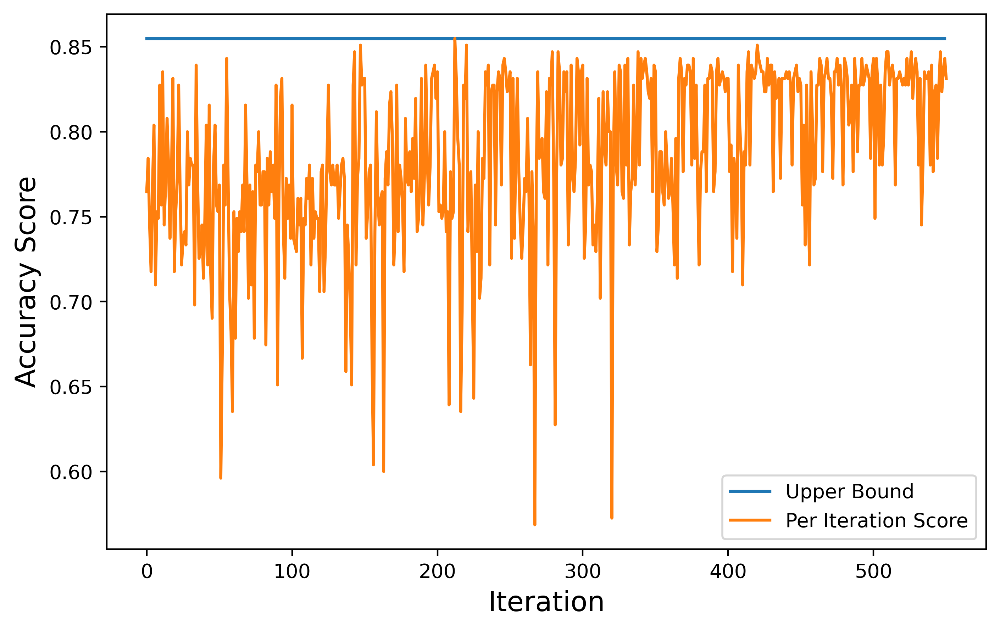

In [30]:
print(accR1)

b=max(accR1)

accR2=[]
for i in range(0,550):
    accR2.append(b)

plt.figure(figsize=(8,5),dpi=400)
plt.plot(accR2)
plt.plot(accR1)
plt.xlabel('Iteration', fontsize=14)
plt.ylabel('Accuracy Score', fontsize=14)
plt.legend(['Upper Bound', 'Per Iteration Score'], loc='lower right')
plt.savefig("LRUN-Bond.pdf")

In [32]:
sol0R1=[]
sol1R1=[]
accR1=[]
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)
def fitness_function(solution):
    print(solution)
    sol0R1.append(solution[0])
    sol1R1.append(solution[1])
    global dataFFeatures
    X =dataFFeatures
    y =  DataFTarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpF=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpF.append(X.columns[i])
    print(len(featuresimpF))

    global dataIFeatures
    X =dataIFeatures
    y =  DataITarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpI=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpI.append(X.columns[i])
    print(len(featuresimpI))
    dataIFeatures= dataIFeatures[featuresimpI]
    dataFFeatures= dataFFeatures[featuresimpF]

    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GF1=t_model.predict(dataFFeatures)


    #t_model = Sequential()
    #t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    #t_model.add(Dense(1024))
    #t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    #t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    #GF1=t_model.predict(dataFFeatures)
    
    #dI=pd.DataFrame(GI1)
    #dF=pd.DataFrame(GF1)
    
    #ComFeat=dF.append(dI,ignore_index = True) 
    #ComT=DataFTarget["Sub_Cat"].append(DataITarget["Sub_Cat"],ignore_index = True)


    X_train, X_test, y_train, y_test = train_test_split(GF1, DataFTarget["Sub_Cat"], test_size=0.15, random_state=1, stratify=DataFTarget["Sub_Cat"], shuffle=True)
    
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.svm import SVC
    from sklearn.linear_model import LogisticRegression
    from sklearn.neighbors import KNeighborsClassifier
    #ker=['linear', 'poly', 'rbf', 'sigmoid']
    
    #solvr=['saga','sag','newton-cg', 'lbfgs']
    algo=['auto', 'ball_tree', 'kd_tree', 'brute']
    #a=LogisticRegression(random_state=int(solution[2]), solver=solvr[int(solution[3])],multi_class='multinomial',C=int(solution[4]))
    #a =  ExtraTreesClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a =  RandomForestClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    a = KNeighborsClassifier(n_neighbors=int(solution[2]),algorithm=algo[int(solution[3])])
    #a=SVC(kernel=ker[int(solution[3])], C=int(solution[2]))
    a_pred = a.fit(X_train, y_train)
    pred=a_pred.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accR1.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [90, 0.01, 2,0],
    "ub": [2000, 0.03,10,3],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


#model = BasePSO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")

ETC
[8.78271672e+02 1.57505322e-02 3.52542027e+00 1.89300890e+00]
10
20
0.792156862745098
                precision    recall  f1-score   support

      Analysis       0.50      0.44      0.47        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.62      0.60        26
       Fuzzers       0.92      0.88      0.90        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.95      0.69      0.80        26
         Worms       0.88      0.84      0.86        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.79       255

[[11  8  4  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 16  1  0  0  

10
20
0.807843137254902
                precision    recall  f1-score   support

      Analysis       0.55      0.44      0.49        25
      Backdoor       0.71      0.85      0.77        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.68      0.65      0.67        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.88      0.81      0.84        26
     Shellcode       0.86      0.69      0.77        26
         Worms       0.84      0.84      0.84        25

      accuracy                           0.81       255
     macro avg       0.81      0.81      0.81       255
  weighted avg       0.81      0.81      0.81       255

[[11  9  3  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 2  0 22  0  0  0  0  1  0  0]
 [ 1  0  7 17  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.50      0.32      0.39        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.59      0.92      0.72        25
      Exploits       0.62      0.50      0.55        26
       Fuzzers       0.83      0.96      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.74      0.65      0.69        26
     Shellcode       0.79      0.58      0.67        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[ 8  9  4  2  2  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 1  0  8 13  2  0  0  2  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7294117647058823
                precision    recall  f1-score   support

      Analysis       0.32      0.52      0.39        25
      Backdoor       0.70      0.54      0.61        26
           DoS       0.53      0.68      0.60        25
      Exploits       0.57      0.65      0.61        26
       Fuzzers       1.00      0.72      0.84        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.90      0.73      0.81        26
         Worms       0.91      0.84      0.87        25

      accuracy                           0.73       255
     macro avg       0.78      0.73      0.74       255
  weighted avg       0.78      0.73      0.74       255

[[13  5  5  2  0  0  0  0  0  0]
 [12 14  0  0  0  0  0  0  0  0]
 [ 8  0 17  0  0  0  0  0  0  0]
 [ 2  0  7 17  0  0  0  0  0  0]
 [ 1  0  0  6 18  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7529411764705882
                precision    recall  f1-score   support

      Analysis       0.56      0.40      0.47        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.80      0.96      0.87        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.88      0.94        25
Reconnaissance       0.70      0.54      0.61        26
     Shellcode       0.81      0.50      0.62        26
         Worms       0.75      0.84      0.79        25

      accuracy                           0.75       255
     macro avg       0.76      0.75      0.74       255
  weighted avg       0.76      0.75      0.74       255

[[10  8  4  1  2  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 2  0  6 15  2  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.50      0.32      0.39        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.86      0.96      0.91        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.68      0.58      0.62        26
         Worms       0.80      0.80      0.80        25

      accuracy                           0.76       255
     macro avg       0.76      0.77      0.76       255
  weighted avg       0.76      0.76      0.76       255

[[ 8  9  4  2  2  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  1  0]
 [ 0  0  6 16  1  0  0  1  2  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.56      0.36      0.44        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.50      0.42      0.46        26
       Fuzzers       0.77      0.96      0.86        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.92      0.96        25
Reconnaissance       0.76      0.62      0.68        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.76       255
     macro avg       0.75      0.76      0.75       255
  weighted avg       0.75      0.76      0.75       255

[[ 9  9  3  2  2  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  1  0]
 [ 2  0  8 11  3  0  0  2  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.44      0.32      0.37        25
      Backdoor       0.70      0.81      0.75        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.67      0.69      0.68        26
       Fuzzers       0.85      0.88      0.86        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.84      0.81      0.82        26
     Shellcode       0.89      0.65      0.76        26
         Worms       0.80      0.80      0.80        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.78       255
  weighted avg       0.78      0.78      0.78       255

[[ 8  9  4  2  2  0  0  0  0  0]
 [ 4 21  0  0  0  0  0  0  0  1]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  5 18  1  0  0  1  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.33      0.52      0.41        25
      Backdoor       0.68      0.58      0.62        26
           DoS       0.58      0.72      0.64        25
      Exploits       0.65      0.65      0.65        26
       Fuzzers       1.00      0.84      0.91        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.91      0.84      0.87        25

      accuracy                           0.76       255
     macro avg       0.79      0.76      0.77       255
  weighted avg       0.79      0.76      0.77       255

[[13  6  4  2  0  0  0  0  0  0]
 [11 15  0  0  0  0  0  0  0  0]
 [ 7  0 18  0  0  0  0  0  0  0]
 [ 2  0  7 17  0  0  0  0  0  0]
 [ 1  0  0  3 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.47      0.36      0.41        25
      Backdoor       0.72      0.81      0.76        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.70      0.62      0.65        26
       Fuzzers       0.83      0.96      0.89        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.94      0.62      0.74        26
         Worms       0.76      0.88      0.81        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[ 9  8  4  1  3  0  0  0  0  0]
 [ 4 21  0  0  0  0  0  0  0  1]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 2  0  6 16  1  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7254901960784313
                precision    recall  f1-score   support

      Analysis       0.44      0.32      0.37        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.59      0.50      0.54        26
       Fuzzers       0.76      1.00      0.86        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.88      0.94        25
Reconnaissance       0.68      0.58      0.62        26
     Shellcode       0.63      0.46      0.53        26
         Worms       0.76      0.76      0.76        25

      accuracy                           0.73       255
     macro avg       0.72      0.73      0.71       255
  weighted avg       0.72      0.73      0.71       255

[[ 8  9  3  1  3  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  1  0]
 [ 1  0  7 13  2  0  0  1  2  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.62      0.32      0.42        25
      Backdoor       0.71      0.96      0.82        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.83      0.96      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.92      0.96        25
Reconnaissance       0.73      0.62      0.67        26
     Shellcode       0.86      0.69      0.77        26
         Worms       0.78      0.84      0.81        25

      accuracy                           0.77       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[ 8  9  3  2  2  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 2  0  8 13  1  0  0  2  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.57      0.32      0.41        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.56      0.88      0.69        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.74      0.65      0.69        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[ 8  9  4  3  1  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  1  0]
 [ 0  0 10 13  0  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7176470588235294
                precision    recall  f1-score   support

      Analysis       0.50      0.28      0.36        25
      Backdoor       0.70      0.88      0.78        26
           DoS       0.55      0.72      0.62        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.84      0.84      0.84        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.88      0.94        25
Reconnaissance       0.58      0.58      0.58        26
     Shellcode       0.79      0.58      0.67        26
         Worms       0.70      0.84      0.76        25

      accuracy                           0.72       255
     macro avg       0.72      0.72      0.71       255
  weighted avg       0.72      0.72      0.71       255

[[ 7  9  4  1  1  0  0  1  0  2]
 [ 2 23  0  0  0  0  0  0  0  1]
 [ 1  0 18  1  1  0  0  3  1  0]
 [ 1  0  8 15  0  0  0  1  1  0]
 [ 0  0  0  4 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.803921568627451
                precision    recall  f1-score   support

      Analysis       0.48      0.40      0.43        25
      Backdoor       0.71      0.85      0.77        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.71      0.65      0.68        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.87      0.77      0.82        26
     Shellcode       0.90      0.69      0.78        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.80       255
  weighted avg       0.81      0.80      0.80       255

[[10  9  4  2  0  0  0  0  0  0]
 [ 3 22  0  0  0  0  0  0  0  1]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 17  0  0  0  1  0  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.57      0.32      0.41        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.81      1.00      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.92      0.96        25
Reconnaissance       0.83      0.58      0.68        26
     Shellcode       0.70      0.62      0.65        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[ 8  9  3  3  2  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  1  0]
 [ 1  0  7 13  2  0  0  1  2  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.42      0.32      0.36        25
      Backdoor       0.71      0.85      0.77        26
           DoS       0.60      0.84      0.70        25
      Exploits       0.64      0.54      0.58        26
       Fuzzers       0.86      0.96      0.91        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.78      0.69      0.73        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.84      0.84      0.84        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[ 8  9  3  2  2  0  0  1  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 0  0 21  2  0  0  0  1  1  0]
 [ 0  0  8 14  1  0  0  1  2  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.57      0.32      0.41        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.64      0.84      0.72        25
      Exploits       0.62      0.58      0.60        26
       Fuzzers       0.83      0.96      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.92      0.96        25
Reconnaissance       0.69      0.69      0.69        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.77       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[ 8  9  3  2  2  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 21  2  0  0  0  2  0  0]
 [ 2  0  6 15  1  0  0  2  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.69      0.36      0.47        25
      Backdoor       0.72      1.00      0.84        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.61      0.54      0.57        26
       Fuzzers       0.78      1.00      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.88      0.94        25
Reconnaissance       0.71      0.58      0.64        26
     Shellcode       0.74      0.54      0.62        26
         Worms       0.75      0.84      0.79        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[ 9  9  3  2  2  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 1  0  6 14  2  0  0  1  2  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.35      0.60      0.44        25
      Backdoor       0.74      0.54      0.62        26
           DoS       0.58      0.72      0.64        25
      Exploits       0.57      0.65      0.61        26
       Fuzzers       1.00      0.72      0.84        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.91      0.84      0.87        25

      accuracy                           0.75       255
     macro avg       0.80      0.75      0.76       255
  weighted avg       0.80      0.75      0.76       255

[[15  4  4  2  0  0  0  0  0  0]
 [12 14  0  0  0  0  0  0  0  0]
 [ 7  0 18  0  0  0  0  0  0  0]
 [ 2  0  7 17  0  0  0  0  0  0]
 [ 1  0  0  6 18  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.65      0.44      0.52        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.58      0.84      0.69        25
      Exploits       0.60      0.46      0.52        26
       Fuzzers       0.73      0.96      0.83        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.92      0.96        25
Reconnaissance       0.71      0.58      0.64        26
     Shellcode       0.70      0.54      0.61        26
         Worms       0.80      0.80      0.80        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[11  8  2  1  2  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 21  2  0  0  0  1  1  0]
 [ 1  0  7 12  3  0  0  1  2  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.792156862745098
                precision    recall  f1-score   support

      Analysis       0.52      0.44      0.48        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.64      0.62      0.63        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.89      0.65      0.76        26
         Worms       0.84      0.84      0.84        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.79       255

[[11  8  4  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 16  1  0  0  1  0  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.50      0.32      0.39        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.62      0.50      0.55        26
       Fuzzers       0.83      0.96      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.65      0.65      0.65        26
     Shellcode       0.79      0.58      0.67        26
         Worms       0.78      0.84      0.81        25

      accuracy                           0.76       255
     macro avg       0.75      0.76      0.75       255
  weighted avg       0.75      0.76      0.75       255

[[ 8  9  2  2  2  0  0  2  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  2  0  0]
 [ 0  0  8 13  2  0  0  2  0  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.53      0.32      0.40        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.58      0.54      0.56        26
       Fuzzers       0.81      1.00      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.92      0.96        25
Reconnaissance       0.76      0.62      0.68        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.76       255
     macro avg       0.76      0.77      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[ 8  9  4  2  2  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 2  0  6 14  2  0  0  1  1  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.48      0.40      0.43        25
      Backdoor       0.72      0.81      0.76        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.65      0.58      0.61        26
       Fuzzers       0.82      0.92      0.87        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.71      0.58      0.64        26
     Shellcode       0.79      0.58      0.67        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[10  8  4  0  3  0  0  0  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 1  0  8 15  1  0  0  1  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.50      0.32      0.39        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.60      0.84      0.70        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.83      1.00      0.91        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.88      0.94        25
Reconnaissance       0.70      0.62      0.65        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.77      0.80      0.78        25

      accuracy                           0.75       255
     macro avg       0.74      0.75      0.74       255
  weighted avg       0.74      0.75      0.74       255

[[ 8  9  3  2  2  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 21  2  0  0  0  1  1  0]
 [ 2  0  8 13  1  0  0  2  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.53      0.36      0.43        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.62      0.68        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.85      0.88      0.86        25

      accuracy                           0.77       255
     macro avg       0.77      0.77      0.77       255
  weighted avg       0.77      0.77      0.77       255

[[ 9  9  3  3  1  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  1  0]
 [ 1  0 10 13  0  0  0  2  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.50      0.32      0.39        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.76      0.62      0.68        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.77       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[ 8  9  4  3  1  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0 10 13  0  0  0  2  1  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.41      0.48      0.44        25
      Backdoor       0.76      0.62      0.68        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.54      0.54      0.54        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.90      0.69      0.78        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.76       255
     macro avg       0.78      0.76      0.76       255
  weighted avg       0.78      0.76      0.76       255

[[12  5  4  3  1  0  0  0  0  0]
 [10 16  0  0  0  0  0  0  0  0]
 [ 1  0 23  1  0  0  0  0  0  0]
 [ 2  0  8 14  0  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.42      0.32      0.36        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.65      0.58      0.61        26
       Fuzzers       0.86      0.96      0.91        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       0.84      0.62      0.71        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[ 8  9  4  2  2  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 2  0  6 15  1  0  0  2  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.47      0.28      0.35        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.64      0.54      0.58        26
       Fuzzers       0.83      0.96      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.78      0.69      0.73        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.76       255
     macro avg       0.75      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[ 7  9  4  1  3  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  1  0]
 [ 1  0  8 14  1  0  0  1  1  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7529411764705882
                precision    recall  f1-score   support

      Analysis       0.57      0.32      0.41        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.60      0.84      0.70        25
      Exploits       0.57      0.46      0.51        26
       Fuzzers       0.81      1.00      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.92      0.96        25
Reconnaissance       0.73      0.62      0.67        26
     Shellcode       0.70      0.62      0.65        26
         Worms       0.78      0.84      0.81        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[ 8  9  3  2  2  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 21  2  0  0  0  1  1  0]
 [ 1  0  8 12  2  0  0  1  2  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.44      0.32      0.37        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.62      0.50      0.55        26
       Fuzzers       0.82      0.92      0.87        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.73      0.73      0.73        26
     Shellcode       0.79      0.58      0.67        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.76       255
     macro avg       0.76      0.76      0.75       255
  weighted avg       0.76      0.76      0.75       255

[[ 8  9  3  2  2  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  2  0  0]
 [ 0  0  8 13  2  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.62      0.50      0.55        26
       Fuzzers       0.83      1.00      0.91        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       0.71      0.58      0.64        26
         Worms       0.75      0.84      0.79        25

      accuracy                           0.77       255
     macro avg       0.77      0.77      0.76       255
  weighted avg       0.77      0.77      0.76       255

[[10  8  3  2  2  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  8 13  2  0  0  1  1  1]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.803921568627451
                precision    recall  f1-score   support

      Analysis       0.50      0.40      0.44        25
      Backdoor       0.71      0.85      0.77        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.68      0.65      0.67        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.88      0.81      0.84        26
     Shellcode       0.89      0.65      0.76        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.80       255
  weighted avg       0.81      0.80      0.80       255

[[10  9  4  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 17  0  0  0  1  0  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.7372549019607844
                precision    recall  f1-score   support

      Analysis       0.37      0.44      0.40        25
      Backdoor       0.71      0.58      0.64        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.56      0.54      0.55        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.75      0.69      0.72        26
     Shellcode       0.82      0.54      0.65        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.74       255
     macro avg       0.75      0.74      0.74       255
  weighted avg       0.75      0.74      0.74       255

[[11  6  4  2  2  0  0  0  0  0]
 [11 15  0  0  0  0  0  0  0  0]
 [ 1  0 22  1  0  0  0  1  0  0]
 [ 2  0  8 14  0  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.36      0.60      0.45        25
      Backdoor       0.75      0.58      0.65        26
           DoS       0.58      0.72      0.64        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.95      0.76      0.84        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.91      0.84      0.87        25

      accuracy                           0.75       255
     macro avg       0.79      0.75      0.76       255
  weighted avg       0.79      0.75      0.76       255

[[15  4  4  2  0  0  0  0  0  0]
 [11 15  0  0  0  0  0  0  0  0]
 [ 7  0 18  0  0  0  0  0  0  0]
 [ 2  0  7 16  1  0  0  0  0  0]
 [ 1  0  0  5 19  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7333333333333333
                precision    recall  f1-score   support

      Analysis       0.50      0.32      0.39        25
      Backdoor       0.71      0.96      0.82        26
           DoS       0.64      0.84      0.72        25
      Exploits       0.58      0.54      0.56        26
       Fuzzers       0.72      0.92      0.81        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.92      0.96        25
Reconnaissance       0.64      0.54      0.58        26
     Shellcode       0.72      0.50      0.59        26
         Worms       0.77      0.80      0.78        25

      accuracy                           0.73       255
     macro avg       0.73      0.73      0.72       255
  weighted avg       0.73      0.73      0.72       255

[[ 8  9  3  2  2  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 21  2  0  0  0  2  0  0]
 [ 1  0  5 14  3  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.43      0.36      0.39        25
      Backdoor       0.69      0.77      0.73        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.63      0.65      0.64        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.89      0.65      0.76        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[ 9  9  3  2  1  0  0  1  0  0]
 [ 5 20  0  0  0  0  0  0  0  1]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 17  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7529411764705882
                precision    recall  f1-score   support

      Analysis       0.53      0.32      0.40        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.57      0.92      0.71        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.68      0.65      0.67        26
     Shellcode       0.76      0.50      0.60        26
         Worms       0.78      0.84      0.81        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[ 8  9  4  3  1  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0 10 13  0  0  0  2  1  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.788235294117647
                precision    recall  f1-score   support

      Analysis       0.48      0.40      0.43        25
      Backdoor       0.69      0.77      0.73        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.65      0.58      0.61        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.81      0.81        26
     Shellcode       0.89      0.62      0.73        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.79       255
     macro avg       0.79      0.79      0.78       255
  weighted avg       0.79      0.79      0.78       255

[[10  9  4  2  0  0  0  0  0  0]
 [ 6 20  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 15  1  0  0  2  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.792156862745098
                precision    recall  f1-score   support

      Analysis       0.44      0.44      0.44        25
      Backdoor       0.72      0.81      0.76        26
           DoS       0.69      0.88      0.77        25
      Exploits       0.67      0.69      0.68        26
       Fuzzers       0.92      0.88      0.90        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.84      0.81      0.82        26
     Shellcode       0.94      0.65      0.77        26
         Worms       0.83      0.80      0.82        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.79       255

[[11  8  3  2  1  0  0  0  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 2  0 22  0  0  0  0  1  0  0]
 [ 1  0  7 18  0  0  0  0  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.796078431372549
                precision    recall  f1-score   support

      Analysis       0.47      0.32      0.38        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.63      0.65      0.64        26
       Fuzzers       0.92      0.88      0.90        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.84      0.81      0.82        26
     Shellcode       0.94      0.65      0.77        26
         Worms       0.88      0.84      0.86        25

      accuracy                           0.80       255
     macro avg       0.80      0.80      0.79       255
  weighted avg       0.80      0.80      0.79       255

[[ 8  9  4  3  1  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 17  0  0  0  1  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.7411764705882353
                precision    recall  f1-score   support

      Analysis       0.57      0.32      0.41        25
      Backdoor       0.72      1.00      0.84        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.77      0.92      0.84        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.88      0.94        25
Reconnaissance       0.71      0.58      0.64        26
     Shellcode       0.70      0.54      0.61        26
         Worms       0.77      0.80      0.78        25

      accuracy                           0.74       255
     macro avg       0.74      0.74      0.73       255
  weighted avg       0.74      0.74      0.73       255

[[ 8  9  4  2  2  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 1  0  7 13  2  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.47      0.32      0.38        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.57      0.46      0.51        26
       Fuzzers       0.77      0.96      0.86        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.92      0.96        25
Reconnaissance       0.84      0.62      0.71        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.78      0.84      0.81        25

      accuracy                           0.75       255
     macro avg       0.75      0.75      0.74       255
  weighted avg       0.75      0.75      0.74       255

[[ 8  9  4  2  2  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  0  1  0]
 [ 2  0  8 12  2  0  0  1  1  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.57      0.32      0.41        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.60      0.84      0.70        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.82      0.92      0.87        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.65      0.65      0.65        26
     Shellcode       0.68      0.50      0.58        26
         Worms       0.78      0.84      0.81        25

      accuracy                           0.75       255
     macro avg       0.74      0.75      0.73       255
  weighted avg       0.74      0.75      0.73       255

[[ 8  9  3  2  2  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 21  2  0  0  0  2  0  0]
 [ 0  0  8 13  2  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.807843137254902
                precision    recall  f1-score   support

      Analysis       0.50      0.40      0.44        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.70      0.62      0.65        26
       Fuzzers       0.96      1.00      0.98        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.77      0.78        26
     Shellcode       0.94      0.65      0.77        26
         Worms       0.84      0.84      0.84        25

      accuracy                           0.81       255
     macro avg       0.81      0.81      0.80       255
  weighted avg       0.81      0.81      0.80       255

[[10  9  3  2  1  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 16  0  0  0  2  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.38      0.32      0.35        25
      Backdoor       0.68      0.73      0.70        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.68      0.65      0.67        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.84      0.81      0.82        26
     Shellcode       0.90      0.69      0.78        26
         Worms       0.83      0.80      0.82        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[ 8  9  4  2  2  0  0  0  0  0]
 [ 7 19  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 17  0  0  0  1  0  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.34      0.60      0.43        25
      Backdoor       0.74      0.54      0.62        26
           DoS       0.55      0.68      0.61        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.80      0.89        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.91      0.80      0.85        25

      accuracy                           0.75       255
     macro avg       0.80      0.75      0.76       255
  weighted avg       0.80      0.75      0.76       255

[[15  4  4  2  0  0  0  0  0  0]
 [12 14  0  0  0  0  0  0  0  0]
 [ 8  0 17  0  0  0  0  0  0  0]
 [ 2  0  7 17  0  0  0  0  0  0]
 [ 1  0  0  4 20  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.803921568627451
                precision    recall  f1-score   support

      Analysis       0.55      0.48      0.51        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.68      0.65      0.67        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.89      0.65      0.76        26
         Worms       0.84      0.84      0.84        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.80       255
  weighted avg       0.81      0.80      0.80       255

[[12  8  3  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 17  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.7607843137254902
                precision    recall  f1-score   support

      Analysis       0.41      0.44      0.42        25
      Backdoor       0.71      0.58      0.64        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.86      0.69      0.77        26
         Worms       0.84      0.84      0.84        25

      accuracy                           0.76       255
     macro avg       0.77      0.76      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[11  6  4  2  2  0  0  0  0  0]
 [11 15  0  0  0  0  0  0  0  0]
 [ 1  0 22  1  0  0  0  1  0  0]
 [ 1  0  8 15  0  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.57      0.32      0.41        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.71      0.58      0.64        26
     Shellcode       0.77      0.65      0.71        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.76       255
     macro avg       0.76      0.77      0.76       255
  weighted avg       0.76      0.76      0.76       255

[[ 8  9  3  3  1  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  1  1  0]
 [ 0  0 10 13  0  0  0  2  1  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.50      0.32      0.39        25
      Backdoor       0.72      1.00      0.84        26
           DoS       0.58      0.88      0.70        25
      Exploits       0.57      0.46      0.51        26
       Fuzzers       0.77      0.96      0.86        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.92      0.96        25
Reconnaissance       0.71      0.58      0.64        26
     Shellcode       0.78      0.54      0.64        26
         Worms       0.80      0.80      0.80        25

      accuracy                           0.75       255
     macro avg       0.74      0.75      0.73       255
  weighted avg       0.74      0.75      0.73       255

[[ 8  9  4  2  2  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 22  2  0  0  0  1  0  0]
 [ 2  0  8 12  2  0  0  1  1  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.792156862745098
                precision    recall  f1-score   support

      Analysis       0.48      0.44      0.46        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.67      0.62      0.64        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.83      0.77      0.80        26
     Shellcode       0.94      0.62      0.74        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.79       255

[[11  8  4  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 2  0 22  0  0  0  0  1  0  0]
 [ 1  0  7 16  1  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.796078431372549
                precision    recall  f1-score   support

      Analysis       0.50      0.44      0.47        25
      Backdoor       0.71      0.85      0.77        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.68      0.65      0.67        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.84      0.81      0.82        26
     Shellcode       0.89      0.65      0.76        26
         Worms       0.83      0.80      0.82        25

      accuracy                           0.80       255
     macro avg       0.80      0.80      0.79       255
  weighted avg       0.80      0.80      0.79       255

[[11  8  3  2  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 1  0 22  0  0  0  0  1  1  0]
 [ 1  0  7 17  0  0  0  1  0  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.792156862745098
                precision    recall  f1-score   support

      Analysis       0.43      0.40      0.42        25
      Backdoor       0.71      0.77      0.74        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.68      0.58      0.62        26
       Fuzzers       0.86      0.96      0.91        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.88      0.81      0.84        26
     Shellcode       0.95      0.69      0.80        26
         Worms       0.84      0.84      0.84        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.79       255

[[10  8  4  2  1  0  0  0  0  0]
 [ 6 20  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 15  2  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.8
                precision    recall  f1-score   support

      Analysis       0.48      0.40      0.43        25
      Backdoor       0.70      0.88      0.78        26
           DoS       0.64      0.84      0.72        25
      Exploits       0.72      0.69      0.71        26
       Fuzzers       1.00      0.96      0.98        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.88      0.81      0.84        26
     Shellcode       0.89      0.62      0.73        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.80       255
  weighted avg       0.81      0.80      0.80       255

[[10  9  4  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 2  0 21  0  0  0  0  1  1  0]
 [ 1  0  7 18  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  0]
 [ 0 

10
20
0.796078431372549
                precision    recall  f1-score   support

      Analysis       0.45      0.40      0.43        25
      Backdoor       0.71      0.85      0.77        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.69      0.69      0.69        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.79      0.73      0.76        26
     Shellcode       0.89      0.65      0.76        26
         Worms       0.84      0.84      0.84        25

      accuracy                           0.80       255
     macro avg       0.80      0.80      0.79       255
  weighted avg       0.80      0.80      0.79       255

[[10  9  4  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  5 18  0  0  0  2  0  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.60      0.36      0.45        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.62      0.84      0.71        25
      Exploits       0.55      0.46      0.50        26
       Fuzzers       0.81      1.00      0.89        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.92      0.96        25
Reconnaissance       0.71      0.65      0.68        26
     Shellcode       0.75      0.58      0.65        26
         Worms       0.78      0.84      0.81        25

      accuracy                           0.76       255
     macro avg       0.75      0.76      0.75       255
  weighted avg       0.75      0.76      0.75       255

[[ 9  9  2  2  2  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 21  2  0  0  0  2  0  0]
 [ 2  0  8 12  2  0  0  1  1  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.807843137254902
                precision    recall  f1-score   support

      Analysis       0.50      0.48      0.49        25
      Backdoor       0.72      0.81      0.76        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.68      0.65      0.67        26
       Fuzzers       1.00      0.88      0.94        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.88      0.81      0.84        26
     Shellcode       0.90      0.69      0.78        26
         Worms       0.84      0.84      0.84        25

      accuracy                           0.81       255
     macro avg       0.82      0.81      0.81       255
  weighted avg       0.82      0.81      0.81       255

[[12  8  3  2  0  0  0  0  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 17  0  0  0  1  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.48      0.40      0.43        25
      Backdoor       0.71      0.92      0.80        26
           DoS       0.71      0.96      0.81        25
      Exploits       0.60      0.58      0.59        26
       Fuzzers       0.83      0.80      0.82        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.94      0.62      0.74        26
         Worms       0.79      0.88      0.83        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[10  9  3  1  2  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 1  0 24  0  0  0  0  0  0  0]
 [ 1  1  6 15  1  0  0  2  0  0]
 [ 2  0  0  3 20  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.8
                precision    recall  f1-score   support

      Analysis       0.48      0.44      0.46        25
      Backdoor       0.71      0.77      0.74        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.69      0.69      0.69        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.87      0.77      0.82        26
     Shellcode       0.95      0.69      0.80        26
         Worms       0.84      0.84      0.84        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.80       255
  weighted avg       0.81      0.80      0.80       255

[[11  8  4  2  0  0  0  0  0  0]
 [ 6 20  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 18  0  0  0  0  0  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  0]
 [ 0 

10
20
0.807843137254902
                precision    recall  f1-score   support

      Analysis       0.61      0.44      0.51        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.68      0.65      0.67        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.89      0.62      0.73        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.81       255
     macro avg       0.81      0.81      0.80       255
  weighted avg       0.81      0.81      0.80       255

[[11  9  4  1  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 17  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.39      0.36      0.37        25
      Backdoor       0.67      0.69      0.68        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.69      0.69      0.69        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.90      0.73      0.81        26
     Shellcode       0.90      0.69      0.78        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[ 9  9  4  2  1  0  0  0  0  0]
 [ 7 18  0  0  0  0  0  0  0  1]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 18  0  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.792156862745098
                precision    recall  f1-score   support

      Analysis       0.48      0.40      0.43        25
      Backdoor       0.71      0.85      0.77        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.68      0.65      0.67        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.83      0.73      0.78        26
     Shellcode       0.94      0.62      0.74        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.79       255

[[10  9  4  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 17  0  0  0  1  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.57      0.32      0.41        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.59      0.92      0.72        25
      Exploits       0.60      0.46      0.52        26
       Fuzzers       0.89      0.96      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.86      0.69      0.77        26
     Shellcode       0.77      0.65      0.71        26
         Worms       0.81      0.88      0.85        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[ 8  9  4  2  2  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0 10 12  1  0  0  2  1  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7568627450980392
                precision    recall  f1-score   support

      Analysis       0.41      0.44      0.42        25
      Backdoor       0.74      0.65      0.69        26
           DoS       0.61      0.88      0.72        25
      Exploits       0.61      0.54      0.57        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.77      0.77      0.77        26
     Shellcode       0.83      0.58      0.68        26
         Worms       0.77      0.80      0.78        25

      accuracy                           0.76       255
     macro avg       0.77      0.76      0.76       255
  weighted avg       0.77      0.76      0.76       255

[[11  6  4  3  1  0  0  0  0  0]
 [ 8 17  0  0  0  0  0  0  0  1]
 [ 1  0 22  1  0  0  0  1  0  0]
 [ 2  0  8 14  0  0  0  1  1  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.792156862745098
                precision    recall  f1-score   support

      Analysis       0.48      0.44      0.46        25
      Backdoor       0.71      0.77      0.74        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.65      0.65      0.65        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.80      0.77      0.78        26
     Shellcode       0.94      0.65      0.77        26
         Worms       0.84      0.84      0.84        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.79       255

[[11  8  3  2  1  0  0  0  0  0]
 [ 5 20  0  0  0  0  0  0  0  1]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 17  0  0  0  1  0  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.39      0.36      0.37        25
      Backdoor       0.70      0.81      0.75        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.68      0.65      0.67        26
       Fuzzers       0.92      0.88      0.90        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.90      0.69      0.78        26
         Worms       0.84      0.84      0.84        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[ 9  9  4  2  1  0  0  0  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 2  0 22  0  0  0  0  1  0  0]
 [ 1  0  7 17  0  0  0  1  0  0]
 [ 2  0  0  1 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7411764705882353
                precision    recall  f1-score   support

      Analysis       0.33      0.60      0.43        25
      Backdoor       0.74      0.54      0.62        26
           DoS       0.57      0.68      0.62        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.76      0.86        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.82      0.69      0.75        26
     Shellcode       1.00      0.73      0.84        26
         Worms       0.91      0.80      0.85        25

      accuracy                           0.74       255
     macro avg       0.79      0.74      0.76       255
  weighted avg       0.79      0.74      0.76       255

[[15  4  4  2  0  0  0  0  0  0]
 [12 14  0  0  0  0  0  0  0  0]
 [ 8  0 17  0  0  0  0  0  0  0]
 [ 2  0  7 17  0  0  0  0  0  0]
 [ 1  0  0  5 19  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.792156862745098
                precision    recall  f1-score   support

      Analysis       0.43      0.40      0.42        25
      Backdoor       0.70      0.81      0.75        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.68      0.65      0.67        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.91      0.77      0.83        26
     Shellcode       0.94      0.65      0.77        26
         Worms       0.78      0.84      0.81        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.79       255

[[10  9  4  2  0  0  0  0  0  0]
 [ 4 21  0  0  0  0  0  0  0  1]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 2  0  7 17  0  0  0  0  0  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.788235294117647
                precision    recall  f1-score   support

      Analysis       0.50      0.44      0.47        25
      Backdoor       0.73      0.85      0.79        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.67      0.62      0.64        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.83      0.77      0.80        26
     Shellcode       0.89      0.62      0.73        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.79       255
     macro avg       0.79      0.79      0.79       255
  weighted avg       0.79      0.79      0.79       255

[[11  8  4  2  0  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 2  0 22  0  0  0  0  1  0  0]
 [ 1  0  7 16  1  0  0  1  0  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.788235294117647
                precision    recall  f1-score   support

      Analysis       0.46      0.44      0.45        25
      Backdoor       0.68      0.81      0.74        26
           DoS       0.68      0.92      0.78        25
      Exploits       0.65      0.65      0.65        26
       Fuzzers       0.95      0.84      0.89        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.87      0.77      0.82        26
     Shellcode       0.94      0.65      0.77        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.79       255

[[11  9  3  2  0  0  0  0  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 17  0  0  0  1  0  0]
 [ 1  1  0  2 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.41      0.48      0.44        25
      Backdoor       0.77      0.65      0.71        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.56      0.54      0.55        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.78      0.69      0.73        26
     Shellcode       0.89      0.65      0.76        26
         Worms       0.84      0.84      0.84        25

      accuracy                           0.76       255
     macro avg       0.78      0.77      0.77       255
  weighted avg       0.78      0.76      0.77       255

[[12  5  4  3  1  0  0  0  0  0]
 [ 9 17  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 2  0  8 14  0  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.33      0.60      0.43        25
      Backdoor       0.72      0.50      0.59        26
           DoS       0.58      0.72      0.64        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       1.00      0.76      0.86        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.90      0.69      0.78        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.91      0.80      0.85        25

      accuracy                           0.75       255
     macro avg       0.80      0.75      0.76       255
  weighted avg       0.80      0.75      0.76       255

[[15  4  4  2  0  0  0  0  0  0]
 [13 13  0  0  0  0  0  0  0  0]
 [ 7  0 18  0  0  0  0  0  0  0]
 [ 2  0  7 17  0  0  0  0  0  0]
 [ 2  0  0  4 19  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.45      0.40      0.43        25
      Backdoor       0.70      0.81      0.75        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.64      0.62      0.63        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.80      0.77      0.78        26
     Shellcode       0.94      0.62      0.74        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[10  9  4  2  0  0  0  0  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 16  0  0  0  2  0  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.796078431372549
                precision    recall  f1-score   support

      Analysis       0.45      0.36      0.40        25
      Backdoor       0.71      0.85      0.77        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.74      0.65      0.69        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.84      0.81      0.82        26
     Shellcode       0.89      0.62      0.73        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.80       255
     macro avg       0.80      0.80      0.79       255
  weighted avg       0.80      0.80      0.79       255

[[ 9  9  4  2  1  0  0  0  0  0]
 [ 4 22  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 17  0  0  0  1  0  0]
 [ 1  0  0  0 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

10
20
0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.53      0.40      0.45        25
      Backdoor       0.70      0.81      0.75        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.62      0.58      0.60        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.80      0.77      0.78        26
     Shellcode       0.89      0.62      0.73        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.78       255
  weighted avg       0.79      0.78      0.78       255

[[10  8  4  3  0  0  0  0  0  0]
 [ 5 21  0  0  0  0  0  0  0  0]
 [ 1  0 23  0  0  0  0  1  0  0]
 [ 1  0  7 15  1  0  0  2  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

10
20
0.788235294117647
                precision    recall  f1-score   support

      Analysis       0.43      0.40      0.42        25
      Backdoor       0.70      0.81      0.75        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.74      0.65      0.69        26
       Fuzzers       0.93      1.00      0.96        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.79      0.73      0.76        26
     Shellcode       0.94      0.62      0.74        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.79       255
     macro avg       0.80      0.79      0.79       255
  weighted avg       0.80      0.79      0.79       255

[[10  9  4  1  1  0  0  0  0  0]
 [ 4 21  0  0  0  0  0  0  0  1]
 [ 2  0 22  0  0  0  0  1  0  0]
 [ 1  0  7 17  0  0  0  1  0  0]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

[0.792156862745098, 0.796078431372549, 0.796078431372549, 0.7294117647058823, 0.7647058823529411, 0.7490196078431373, 0.7490196078431373, 0.807843137254902, 0.7411764705882353, 0.7686274509803922, 0.7215686274509804, 0.7490196078431373, 0.7725490196078432, 0.7647058823529411, 0.7607843137254902, 0.7450980392156863, 0.7725490196078432, 0.7607843137254902, 0.7529411764705882, 0.803921568627451, 0.7607843137254902, 0.7294117647058823, 0.7725490196078432, 0.807843137254902, 0.7607843137254902, 0.7490196078431373, 0.7411764705882353, 0.7529411764705882, 0.7529411764705882, 0.7686274509803922, 0.7529411764705882, 0.7568627450980392, 0.7568627450980392, 0.7411764705882353, 0.7647058823529411, 0.7647058823529411, 0.796078431372549, 0.7529411764705882, 0.7529411764705882, 0.7490196078431373, 0.7568627450980392, 0.7254901960784313, 0.7568627450980392, 0.7333333333333333, 0.7568627450980392, 0.7490196078431373, 0.7607843137254902, 0.7411764705882353, 0.7647058823529411, 0.7843137254901961, 0.7490

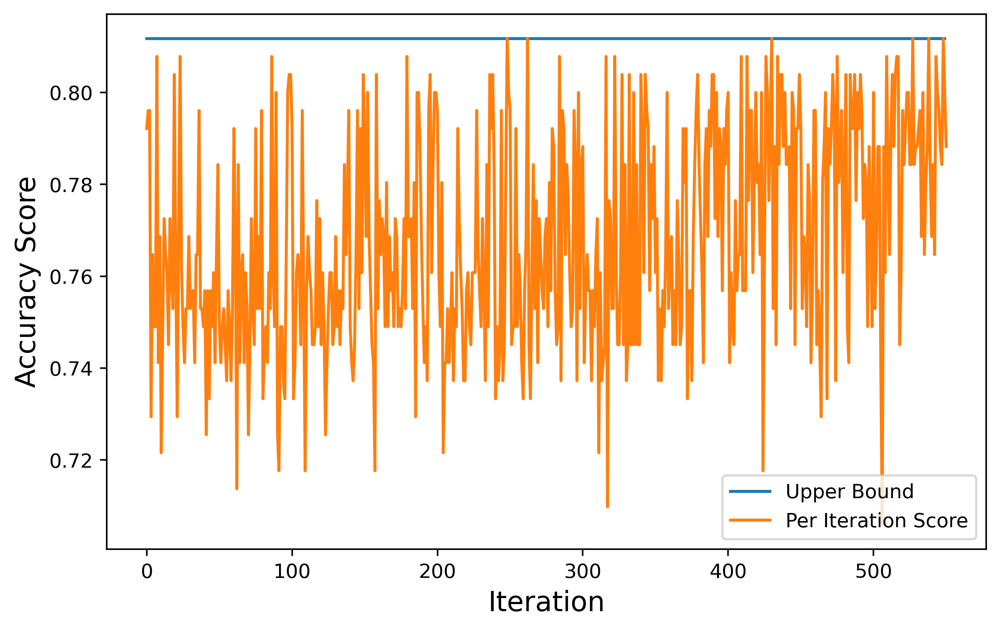

In [33]:
print(accR1)

b=max(accR1)

accR2=[]
for i in range(0,550):
    accR2.append(b)

plt.figure(figsize=(8,5),dpi=400)
plt.plot(accR2)
plt.plot(accR1)
plt.xlabel('Iteration', fontsize=14)
plt.ylabel('Accuracy Score', fontsize=14)
plt.legend(['Upper Bound', 'Per Iteration Score'], loc='lower right')
plt.savefig("KNNUN-Bond.pdf")

In [ ]:
sol0R1=[]
sol1R1=[]
accR1=[]
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)
def fitness_function(solution):
    print(solution)
    sol0R1.append(solution[0])
    sol1R1.append(solution[1])
    global dataFFeatures
    X =dataFFeatures
    y =  DataFTarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpF=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpF.append(X.columns[i])
    print(len(featuresimpF))

    global dataIFeatures
    X =dataIFeatures
    y =  DataITarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpI=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpI.append(X.columns[i])
    print(len(featuresimpI))
    dataIFeatures= dataIFeatures[featuresimpI]
    dataFFeatures= dataFFeatures[featuresimpF]

    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GF1=t_model.predict(dataFFeatures)


    #t_model = Sequential()
    #t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    #t_model.add(Dense(1024))
    #t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    #t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    #GF1=t_model.predict(dataFFeatures)
    
    #dI=pd.DataFrame(GI1)
    #dF=pd.DataFrame(GF1)
    
    #ComFeat=dF.append(dI,ignore_index = True) 
    #ComT=DataFTarget["Sub_Cat"].append(DataITarget["Sub_Cat"],ignore_index = True)


    X_train, X_test, y_train, y_test = train_test_split(GF1, DataFTarget["Sub_Cat"], test_size=0.15, random_state=1, stratify=DataFTarget["Sub_Cat"], shuffle=True)
    
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.svm import SVC
    from sklearn.linear_model import LogisticRegression
    ker=['linear', 'poly', 'rbf', 'sigmoid']
    
    #solvr=['saga','sag','newton-cg', 'lbfgs']
    #algo=['auto', 'ball_tree', 'kd_tree', 'brute']
    #a=LogisticRegression(random_state=int(solution[2]), solver=solvr[int(solution[3])],multi_class='multinomial',C=int(solution[4]))
    #a =  ExtraTreesClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a =  RandomForestClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a = KNeighborsClassifier(n_neighbors=int(solution[2]),algorithm=algo[int(solution[3])])
    a=SVC(kernel=ker[int(solution[3])], C=int(solution[2]))
    a_pred = a.fit(X_train, y_train)
    pred=a_pred.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accR1.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [90, 0.01, 2,0],
    "ub": [2000, 0.03,10,3],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


#model = BasePSO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")

ETC
[7.68200966e+02 2.51771577e-02 8.21615713e+00 1.36197302e-01]
13
21
0.8117647058823529
                precision    recall  f1-score   support

      Analysis       0.85      0.44      0.58        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.58      0.65        26
     Shellcode       0.95      0.73      0.83        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.81       255
     macro avg       0.83      0.81      0.81       255
  weighted avg       0.83      0.81      0.81       255

[[11  9  3  1  0  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  5 17  2  0  0 

12
21
0.8156862745098039
                precision    recall  f1-score   support

      Analysis       0.82      0.36      0.50        25
      Backdoor       0.69      0.96      0.81        26
           DoS       0.63      0.96      0.76        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.62      0.73        26
     Shellcode       0.91      0.81      0.86        26
         Worms       0.92      0.96      0.94        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.81       255
  weighted avg       0.83      0.82      0.81       255

[[ 9 11  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 15  2  0  0  1  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.6313725490196078
                precision    recall  f1-score   support

      Analysis       0.70      0.28      0.40        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.49      0.88      0.63        25
      Exploits       0.40      0.23      0.29        26
       Fuzzers       0.67      0.88      0.76        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      0.96      0.98        25
Reconnaissance       0.42      0.42      0.42        26
     Shellcode       0.17      0.04      0.06        26
         Worms       0.51      0.76      0.61        25

      accuracy                           0.63       255
     macro avg       0.60      0.63      0.59       255
  weighted avg       0.60      0.63      0.59       255

[[ 7  8  3  1  2  0  0  0  0  4]
 [ 2 23  0  0  0  0  0  0  0  1]
 [ 0  0 22  1  0  0  0  1  1  0]
 [ 0  0 11  6  2  1  0  1  3  2]
 [ 0  0  0  2 22  0  0  1  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8156862745098039
                precision    recall  f1-score   support

      Analysis       0.77      0.40      0.53        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       0.88      0.88      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.75      0.58      0.65        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.92      0.92      0.92        25

      accuracy                           0.82       255
     macro avg       0.82      0.82      0.81       255
  weighted avg       0.82      0.82      0.81       255

[[10  9  3  2  0  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  4 17  2  0  0  3  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.77      0.40      0.53        25
      Backdoor       0.71      0.92      0.80        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.60      0.58      0.59        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.88      0.54      0.67        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.78       255
     macro avg       0.80      0.79      0.78       255
  weighted avg       0.80      0.78      0.78       255

[[10 10  3  1  1  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  8 15  0  0  0  1  2  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.79      0.44      0.56        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.66      0.73      0.69        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.92      0.96      0.94        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[11  9  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  4 19  1  0  0  2  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8156862745098039
                precision    recall  f1-score   support

      Analysis       0.82      0.36      0.50        25
      Backdoor       0.69      0.96      0.81        26
           DoS       0.65      0.88      0.75        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.84      0.62      0.71        26
     Shellcode       0.81      0.81      0.81        26
         Worms       0.92      0.92      0.92        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.81       255
  weighted avg       0.83      0.82      0.81       255

[[ 9 11  3  2  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  1  1]
 [ 0  0  5 17  1  0  0  1  2  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8
                precision    recall  f1-score   support

      Analysis       0.69      0.36      0.47        25
      Backdoor       0.69      0.92      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.56      0.54      0.55        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.94      0.62      0.74        26
     Shellcode       0.81      0.85      0.83        26
         Worms       0.88      0.88      0.88        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.79       255
  weighted avg       0.81      0.80      0.79       255

[[ 9 11  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  7 14  2  0  0  1  2  0]
 [ 1  0  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  0]
 [ 0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


12
21
0.5058823529411764
                precision    recall  f1-score   support

      Analysis       0.27      0.28      0.27        25
      Backdoor       0.73      0.62      0.67        26
           DoS       0.31      0.96      0.47        25
      Exploits       0.17      0.08      0.11        26
       Fuzzers       0.57      0.52      0.54        25
       Generic       0.79      1.00      0.88        26
        Normal       0.88      0.88      0.88        25
Reconnaissance       0.50      0.15      0.24        26
     Shellcode       0.00      0.00      0.00        26
         Worms       0.52      0.60      0.56        25

      accuracy                           0.51       255
     macro avg       0.47      0.51      0.46       255
  weighted avg       0.47      0.51      0.46       255

[[ 7  6  5  1  2  0  0  2  0  2]
 [10 16  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 1  0 15  2  6  1  0  0  0  1]
 [ 0  0  0  2 13  4  0  1  0  5]
 [ 0  0  0  0  0 26  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


12
21
0.6470588235294118
                precision    recall  f1-score   support

      Analysis       0.64      0.28      0.39        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.46      0.92      0.61        25
      Exploits       0.33      0.19      0.24        26
       Fuzzers       0.74      0.80      0.77        25
       Generic       0.87      1.00      0.93        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.48      0.42      0.45        26
     Shellcode       0.83      0.19      0.31        26
         Worms       0.56      0.80      0.66        25

      accuracy                           0.65       255
     macro avg       0.66      0.65      0.62       255
  weighted avg       0.66      0.65      0.61       255

[[ 7  8  3  1  2  0  0  0  0  4]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0 14  5  3  1  0  1  0  2]
 [ 0  0  0  2 20  2  0  1  0  0]
 [ 0  0  0  0  0 26  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


12
21
0.5411764705882353
                precision    recall  f1-score   support

      Analysis       0.46      0.24      0.32        25
      Backdoor       0.66      0.88      0.75        26
           DoS       0.37      0.92      0.53        25
      Exploits       0.00      0.00      0.00        26
       Fuzzers       0.52      0.56      0.54        25
       Generic       0.81      1.00      0.90        26
        Normal       0.88      0.88      0.88        25
Reconnaissance       1.00      0.12      0.21        26
     Shellcode       0.33      0.12      0.17        26
         Worms       0.39      0.72      0.51        25

      accuracy                           0.54       255
     macro avg       0.54      0.54      0.48       255
  weighted avg       0.54      0.54      0.48       255

[[ 6  8  4  1  2  0  0  0  0  4]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  0  1  0  0  0  0  1]
 [ 1  0 15  0  6  1  0  0  0  3]
 [ 0  0  0  0 14  4  0  0  0  7]
 [ 0  0  0  0  0 26  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


12
21
0.8
                precision    recall  f1-score   support

      Analysis       0.69      0.36      0.47        25
      Backdoor       0.70      1.00      0.83        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.57      0.62      0.59        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.65      0.76        26
     Shellcode       0.86      0.69      0.77        26
         Worms       0.79      0.88      0.83        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.79       255
  weighted avg       0.81      0.80      0.79       255

[[ 9 11  3  2  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 2  0  0  1 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  0]
 [ 0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


12
21
0.5686274509803921
                precision    recall  f1-score   support

      Analysis       0.62      0.20      0.30        25
      Backdoor       0.69      0.96      0.81        26
           DoS       0.37      0.92      0.53        25
      Exploits       0.50      0.15      0.24        26
       Fuzzers       0.58      0.56      0.57        25
       Generic       0.84      1.00      0.91        26
        Normal       0.88      0.88      0.88        25
Reconnaissance       0.67      0.15      0.25        26
     Shellcode       0.30      0.12      0.17        26
         Worms       0.42      0.76      0.54        25

      accuracy                           0.57       255
     macro avg       0.59      0.57      0.52       255
  weighted avg       0.59      0.57      0.52       255

[[ 5 10  3  1  2  0  0  0  0  4]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0 15  4  3  1  0  0  0  3]
 [ 0  0  1  1 14  3  0  1  0  5]
 [ 0  0  0  0  0 26  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


12
21
0.7647058823529411
                precision    recall  f1-score   support

      Analysis       0.80      0.32      0.46        25
      Backdoor       0.71      0.92      0.80        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.60      0.58      0.59        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.74      0.54      0.62        26
         Worms       0.62      0.92      0.74        25

      accuracy                           0.76       255
     macro avg       0.78      0.77      0.75       255
  weighted avg       0.78      0.76      0.75       255

[[ 8 10  3  1  2  0  0  0  0  1]
 [ 1 24  0  0  0  0  0  0  0  1]
 [ 0  0 22  1  0  0  0  0  1  1]
 [ 0  0  8 15  0  0  0  1  2  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.6549019607843137
                precision    recall  f1-score   support

      Analysis       1.00      0.12      0.21        25
      Backdoor       0.65      1.00      0.79        26
           DoS       0.49      0.96      0.65        25
      Exploits       0.31      0.19      0.24        26
       Fuzzers       0.87      0.80      0.83        25
       Generic       0.96      1.00      0.98        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.60      0.23      0.33        26
     Shellcode       0.46      0.42      0.44        26
         Worms       0.55      0.84      0.67        25

      accuracy                           0.65       255
     macro avg       0.69      0.66      0.61       255
  weighted avg       0.69      0.65      0.61       255

[[ 3 12  3  2  1  0  0  0  0  4]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 24  0  0  0  0  0  1  0]
 [ 0  1 14  5  2  1  0  0  1  2]
 [ 0  0  0  3 20  0  0  0  2  0]
 [ 0  0  0  0  0 26  0 

12
21
0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.71      0.48      0.57        25
      Backdoor       0.75      0.92      0.83        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.57      0.50      0.53        26
       Fuzzers       0.92      0.88      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.80      0.62      0.70        26
         Worms       0.72      0.92      0.81        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[12  8  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  0  1]
 [ 0  0  8 13  2  0  0  1  2  0]
 [ 1  0  0  1 22  0  1  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.75      0.36      0.49        25
      Backdoor       0.70      1.00      0.83        26
           DoS       0.69      0.96      0.80        25
      Exploits       0.64      0.69      0.67        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.62      0.68        26
     Shellcode       0.95      0.77      0.85        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.81       255

[[ 9 11  3  1  0  0  0  1  0  0]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  4 18  1  0  0  3  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8156862745098039
                precision    recall  f1-score   support

      Analysis       0.82      0.36      0.50        25
      Backdoor       0.70      1.00      0.83        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.59      0.65      0.62        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.89      0.62      0.73        26
     Shellcode       0.84      0.81      0.82        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.81       255
  weighted avg       0.83      0.82      0.81       255

[[ 9 11  3  2  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  5 17  1  0  0  2  1  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


12
21
0.7137254901960784
                precision    recall  f1-score   support

      Analysis       0.80      0.16      0.27        25
      Backdoor       0.69      0.96      0.81        26
           DoS       0.57      0.92      0.71        25
      Exploits       0.55      0.46      0.50        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.57      0.50      0.53        26
     Shellcode       0.69      0.35      0.46        26
         Worms       0.56      0.88      0.69        25

      accuracy                           0.71       255
     macro avg       0.73      0.71      0.69       255
  weighted avg       0.73      0.71      0.69       255

[[ 4 11  2  1  2  0  0  1  0  4]
 [ 0 25  0  0  0  0  0  0  0  1]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0  9 12  1  0  0  1  2  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


12
21
0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.83      0.40      0.54        25
      Backdoor       0.71      0.96      0.82        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.52      0.50      0.51        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.78      0.54      0.64        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.76       255
  weighted avg       0.78      0.77      0.76       255

[[10 10  3  1  0  0  0  0  0  1]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  8 13  2  0  0  2  1  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.6823529411764706
                precision    recall  f1-score   support

      Analysis       0.70      0.28      0.40        25
      Backdoor       0.75      0.92      0.83        26
           DoS       0.45      0.92      0.61        25
      Exploits       0.38      0.31      0.34        26
       Fuzzers       0.91      0.84      0.87        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.60      0.35      0.44        26
     Shellcode       0.64      0.35      0.45        26
         Worms       0.58      0.88      0.70        25

      accuracy                           0.68       255
     macro avg       0.70      0.68      0.66       255
  weighted avg       0.70      0.68      0.66       255

[[ 7  8  3  2  1  0  0  0  0  4]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0 14  8  1  0  0  0  1  2]
 [ 0  0  0  4 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.77      0.40      0.53        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.63      0.65      0.64        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.92      0.88      0.90        26
         Worms       0.92      0.92      0.92        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.82       255
  weighted avg       0.84      0.83      0.82       255

[[10  9  3  2  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  5 17  1  0  0  3  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


12
21
0.7490196078431373
                precision    recall  f1-score   support

      Analysis       0.78      0.28      0.41        25
      Backdoor       0.71      0.96      0.82        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.50      0.42      0.46        26
       Fuzzers       0.89      0.96      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.70      0.54      0.61        26
     Shellcode       0.78      0.54      0.64        26
         Worms       0.61      0.88      0.72        25

      accuracy                           0.75       255
     macro avg       0.76      0.75      0.73       255
  weighted avg       0.76      0.75      0.73       255

[[ 7 10  3  2  1  0  0  0  0  2]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  9 11  2  0  0  2  0  2]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


12
21
0.7450980392156863
                precision    recall  f1-score   support

      Analysis       0.62      0.20      0.30        25
      Backdoor       0.71      0.92      0.80        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.54      0.50      0.52        26
       Fuzzers       0.89      0.96      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.70      0.54      0.61        26
         Worms       0.61      0.88      0.72        25

      accuracy                           0.75       255
     macro avg       0.74      0.75      0.73       255
  weighted avg       0.74      0.75      0.72       255

[[ 5 10  3  2  1  0  0  0  0  4]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  8 13  2  0  0  1  2  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.6627450980392157
                precision    recall  f1-score   support

      Analysis       0.80      0.16      0.27        25
      Backdoor       0.68      0.96      0.79        26
           DoS       0.54      0.88      0.67        25
      Exploits       0.39      0.27      0.32        26
       Fuzzers       0.76      0.76      0.76        25
       Generic       0.93      1.00      0.96        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.52      0.50      0.51        26
     Shellcode       0.56      0.35      0.43        26
         Worms       0.54      0.76      0.63        25

      accuracy                           0.66       255
     macro avg       0.67      0.66      0.63       255
  weighted avg       0.67      0.66      0.63       255

[[ 4 11  1  2  1  0  0  1  1  4]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 22  0  0  0  0  2  0  1]
 [ 0  0 13  7  1  1  0  1  2  1]
 [ 0  0  0  5 19  0  0  1  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.7843137254901961
                precision    recall  f1-score   support

      Analysis       0.83      0.40      0.54        25
      Backdoor       0.71      0.96      0.82        26
           DoS       0.66      0.92      0.77        25
      Exploits       0.56      0.58      0.57        26
       Fuzzers       1.00      0.92      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.88      0.54      0.67        26
     Shellcode       0.73      0.62      0.67        26
         Worms       0.68      0.92      0.78        25

      accuracy                           0.78       255
     macro avg       0.80      0.79      0.78       255
  weighted avg       0.80      0.78      0.78       255

[[10 10  2  2  0  0  0  0  1  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  8 15  0  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.85      0.44      0.58        25
      Backdoor       0.71      0.96      0.82        26
           DoS       0.60      0.96      0.74        25
      Exploits       0.61      0.54      0.57        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.96      0.88      0.92        26
         Worms       0.92      0.92      0.92        25

      accuracy                           0.82       255
     macro avg       0.84      0.82      0.81       255
  weighted avg       0.84      0.82      0.81       255

[[11  9  3  1  0  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 14  2  0  0  3  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


12
21
0.5803921568627451
                precision    recall  f1-score   support

      Analysis       0.58      0.28      0.38        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.41      0.92      0.57        25
      Exploits       0.57      0.15      0.24        26
       Fuzzers       0.54      0.56      0.55        25
       Generic       0.87      1.00      0.93        26
        Normal       0.96      0.88      0.92        25
Reconnaissance       0.00      0.00      0.00        26
     Shellcode       0.43      0.38      0.41        26
         Worms       0.44      0.76      0.56        25

      accuracy                           0.58       255
     macro avg       0.55      0.58      0.53       255
  weighted avg       0.55      0.58      0.53       255

[[ 7  7  4  1  2  0  0  0  0  4]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  1 14  4  3  1  0  0  1  2]
 [ 0  0  2  1 14  2  0  1  0  5]
 [ 0  0  0  0  0 26  0 

12
21
0.7725490196078432
                precision    recall  f1-score   support

      Analysis       0.79      0.44      0.56        25
      Backdoor       0.71      0.92      0.80        26
           DoS       0.63      0.88      0.73        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.78      0.54      0.64        26
         Worms       0.66      0.92      0.77        25

      accuracy                           0.77       255
     macro avg       0.79      0.77      0.77       255
  weighted avg       0.79      0.77      0.76       255

[[11 10  3  1  0  0  0  0  0  0]
 [ 1 24  0  0  1  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  1  1]
 [ 0  0  8 15  0  0  0  1  1  1]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.79      0.44      0.56        25
      Backdoor       0.75      0.92      0.83        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.56      0.54      0.55        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.74      0.54      0.62        26
     Shellcode       0.74      0.54      0.62        26
         Worms       0.70      0.92      0.79        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[11  8  3  2  1  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  8 14  1  0  0  1  2  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.7686274509803922
                precision    recall  f1-score   support

      Analysis       0.78      0.28      0.41        25
      Backdoor       0.71      0.92      0.80        26
           DoS       0.64      0.92      0.75        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.78      0.54      0.64        26
     Shellcode       0.79      0.58      0.67        26
         Worms       0.62      0.92      0.74        25

      accuracy                           0.77       255
     macro avg       0.78      0.77      0.75       255
  weighted avg       0.78      0.77      0.75       255

[[ 7 10  3  1  1  0  0  0  0  3]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  8 15  0  0  0  1  1  1]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.73      0.44      0.55        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.69      0.96      0.80        25
      Exploits       0.61      0.65      0.63        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.81      0.65      0.72        26
     Shellcode       1.00      0.88      0.94        26
         Worms       0.92      0.96      0.94        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[11  9  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  5 17  1  0  0  3  0  0]
 [ 0  0  0  3 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.77      0.40      0.53        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.64      0.69      0.67        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.83      0.58      0.68        26
     Shellcode       0.96      0.88      0.92        26
         Worms       0.92      0.92      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[10  9  3  3  0  0  0  0  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  4 18  1  0  0  3  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.7803921568627451
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.62      0.92      0.74        25
      Exploits       0.64      0.62      0.63        26
       Fuzzers       0.85      0.88      0.86        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.75      0.58      0.65        26
     Shellcode       0.81      0.65      0.72        26
         Worms       0.81      0.84      0.82        25

      accuracy                           0.78       255
     macro avg       0.78      0.78      0.77       255
  weighted avg       0.78      0.78      0.77       255

[[11  9  3  2  0  0  0  0  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  5 16  2  0  0  3  0  0]
 [ 1  0  0  1 22  0  1  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.6666666666666666
                precision    recall  f1-score   support

      Analysis       0.80      0.16      0.27        25
      Backdoor       0.70      1.00      0.83        26
           DoS       0.47      0.92      0.62        25
      Exploits       0.37      0.27      0.31        26
       Fuzzers       0.80      0.80      0.80        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.53      0.35      0.42        26
     Shellcode       0.64      0.35      0.45        26
         Worms       0.55      0.84      0.67        25

      accuracy                           0.67       255
     macro avg       0.69      0.67      0.64       255
  weighted avg       0.69      0.67      0.64       255

[[ 4 11  3  1  2  0  0  0  0  4]
 [ 0 26  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0 14  7  2  0  0  0  1  2]
 [ 0  0  0  4 20  0  0  1  0  0]
 [ 0  0  0  0  0 26  0 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


12
21
0.6352941176470588
                precision    recall  f1-score   support

      Analysis       0.71      0.20      0.31        25
      Backdoor       0.69      0.96      0.81        26
           DoS       0.44      0.92      0.60        25
      Exploits       0.35      0.23      0.28        26
       Fuzzers       0.74      0.68      0.71        25
       Generic       0.90      1.00      0.95        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.50      0.42      0.46        26
     Shellcode       0.67      0.15      0.25        26
         Worms       0.53      0.80      0.63        25

      accuracy                           0.64       255
     macro avg       0.65      0.64      0.60       255
  weighted avg       0.65      0.64      0.60       255

[[ 5 10  3  1  2  0  0  0  0  4]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0 14  6  2  1  0  1  0  2]
 [ 0  0  1  3 17  2  0  2  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.792156862745098
                precision    recall  f1-score   support

      Analysis       0.85      0.44      0.58        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.59      0.92      0.72        25
      Exploits       0.54      0.54      0.54        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.79      0.73      0.76        26
         Worms       0.88      0.84      0.86        25

      accuracy                           0.79       255
     macro avg       0.81      0.79      0.79       255
  weighted avg       0.81      0.79      0.79       255

[[11  9  3  2  0  0  0  0  0  0]
 [ 1 24  0  0  0  0  0  1  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  7 14  2  0  0  1  2  0]
 [ 0  0  0  1 23  0  0  0  0  1]
 [ 0  0  0  0  0 26  0  

12
21
0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.79      0.44      0.56        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.63      0.96      0.76        25
      Exploits       0.60      0.58      0.59        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.92      0.85      0.88        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.81       255
  weighted avg       0.83      0.82      0.81       255

[[11  9  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 15  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.79      0.44      0.56        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.63      0.65      0.64        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.96      0.88      0.92        26
         Worms       0.92      0.96      0.94        25

      accuracy                           0.84       255
     macro avg       0.84      0.84      0.83       255
  weighted avg       0.84      0.84      0.83       255

[[11  9  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  5 17  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.79      0.44      0.56        25
      Backdoor       0.73      0.92      0.81        26
           DoS       0.63      0.96      0.76        25
      Exploits       0.62      0.62      0.62        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.92      0.88      0.90        26
         Worms       0.96      0.92      0.94        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.82       255
  weighted avg       0.84      0.83      0.82       255

[[11  9  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  6 16  1  0  0  3  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8313725490196079
                precision    recall  f1-score   support

      Analysis       0.75      0.48      0.59        25
      Backdoor       0.74      0.88      0.81        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.64      0.62      0.63        26
       Fuzzers       0.92      0.96      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.96      0.85      0.90        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.83       255
  weighted avg       0.84      0.83      0.83       255

[[12  8  3  1  0  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  5 16  2  0  0  3  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8392156862745098
                precision    recall  f1-score   support

      Analysis       0.85      0.44      0.58        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.69      0.96      0.80        25
      Exploits       0.62      0.69      0.65        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.76      0.62      0.68        26
     Shellcode       0.96      0.88      0.92        26
         Worms       0.96      0.92      0.94        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[11  9  3  1  0  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  4 18  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.7333333333333333
                precision    recall  f1-score   support

      Analysis       0.67      0.24      0.35        25
      Backdoor       0.71      0.92      0.80        26
           DoS       0.59      0.92      0.72        25
      Exploits       0.55      0.42      0.48        26
       Fuzzers       0.86      1.00      0.93        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.73      0.42      0.54        26
     Shellcode       0.67      0.54      0.60        26
         Worms       0.59      0.88      0.71        25

      accuracy                           0.73       255
     macro avg       0.74      0.73      0.71       255
  weighted avg       0.74      0.73      0.71       255

[[ 6 10  3  1  2  0  0  0  0  3]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  9 11  2  0  0  1  1  2]
 [ 0  0  0  0 25  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.796078431372549
                precision    recall  f1-score   support

      Analysis       0.75      0.36      0.49        25
      Backdoor       0.69      0.92      0.79        26
           DoS       0.59      0.88      0.71        25
      Exploits       0.54      0.54      0.54        26
       Fuzzers       0.92      0.92      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.94      0.62      0.74        26
     Shellcode       0.83      0.77      0.80        26
         Worms       0.86      0.96      0.91        25

      accuracy                           0.80       255
     macro avg       0.81      0.80      0.79       255
  weighted avg       0.81      0.80      0.79       255

[[ 9 11  3  2  0  0  0  0  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 22  1  0  0  0  0  1  1]
 [ 0  0  7 14  2  0  0  1  2  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  

12
21
0.8117647058823529
                precision    recall  f1-score   support

      Analysis       0.67      0.40      0.50        25
      Backdoor       0.72      0.88      0.79        26
           DoS       0.62      0.96      0.75        25
      Exploits       0.58      0.58      0.58        26
       Fuzzers       0.92      0.88      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.84      0.62      0.71        26
     Shellcode       0.96      0.88      0.92        26
         Worms       0.92      0.92      0.92        25

      accuracy                           0.81       255
     macro avg       0.82      0.81      0.81       255
  weighted avg       0.82      0.81      0.81       255

[[10  9  3  2  0  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  7 15  2  0  0  2  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.73      0.44      0.55        25
      Backdoor       0.71      0.92      0.80        26
           DoS       0.71      0.96      0.81        25
      Exploits       0.63      0.73      0.68        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       1.00      0.85      0.92        26
         Worms       0.92      0.92      0.92        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[11  9  3  1  0  0  0  1  0  0]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  3 19  1  0  0  3  0  0]
 [ 0  1  0  1 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8352941176470589
                precision    recall  f1-score   support

      Analysis       0.83      0.40      0.54        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.64      0.69      0.67        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.79      0.58      0.67        26
     Shellcode       0.96      0.88      0.92        26
         Worms       0.92      0.96      0.94        25

      accuracy                           0.84       255
     macro avg       0.85      0.84      0.83       255
  weighted avg       0.85      0.84      0.83       255

[[10  9  3  2  0  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  4 18  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8196078431372549
                precision    recall  f1-score   support

      Analysis       0.65      0.44      0.52        25
      Backdoor       0.70      0.88      0.78        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.63      0.65      0.64        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       1.00      0.85      0.92        26
         Worms       0.88      0.92      0.90        25

      accuracy                           0.82       255
     macro avg       0.83      0.82      0.82       255
  weighted avg       0.83      0.82      0.82       255

[[11  9  3  1  0  0  0  1  0  0]
 [ 3 23  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  5 17  1  0  0  3  0  0]
 [ 1  1  0  1 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8274509803921568
                precision    recall  f1-score   support

      Analysis       0.79      0.44      0.56        25
      Backdoor       0.75      0.92      0.83        26
           DoS       0.65      0.96      0.77        25
      Exploits       0.67      0.69      0.68        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.68      0.58      0.62        26
     Shellcode       1.00      0.81      0.89        26
         Worms       0.89      0.96      0.92        25

      accuracy                           0.83       255
     macro avg       0.84      0.83      0.82       255
  weighted avg       0.84      0.83      0.82       255

[[11  8  3  1  0  0  0  2  0  0]
 [ 1 24  0  0  0  0  0  1  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 0  0  4 18  1  0  0  3  0  0]
 [ 0  0  0  2 23  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.6862745098039216
                precision    recall  f1-score   support

      Analysis       0.78      0.28      0.41        25
      Backdoor       0.75      0.92      0.83        26
           DoS       0.49      0.92      0.64        25
      Exploits       0.40      0.23      0.29        26
       Fuzzers       0.85      0.92      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.52      0.42      0.47        26
     Shellcode       0.64      0.35      0.45        26
         Worms       0.54      0.84      0.66        25

      accuracy                           0.69       255
     macro avg       0.70      0.69      0.66       255
  weighted avg       0.70      0.69      0.66       255

[[ 7  8  3  1  2  0  0  0  0  4]
 [ 2 24  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  1  0  0]
 [ 0  0 14  6  2  0  0  0  1  3]
 [ 0  0  0  1 23  0  0  1  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.69      0.44      0.54        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.57      0.65      0.61        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.84      0.62      0.71        26
     Shellcode       1.00      0.81      0.89        26
         Worms       0.92      0.92      0.92        25

      accuracy                           0.82       255
     macro avg       0.84      0.82      0.82       255
  weighted avg       0.84      0.82      0.82       255

[[11  9  3  1  0  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 24  1  0  0  0  0  0  0]
 [ 1  0  5 17  1  0  0  2  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

12
21
0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.85      0.44      0.58        25
      Backdoor       0.74      0.96      0.83        26
           DoS       0.61      0.92      0.73        25
      Exploits       0.64      0.62      0.63        26
       Fuzzers       0.96      0.96      0.96        25
       Generic       1.00      1.00      1.00        26
        Normal       1.00      1.00      1.00        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.88      0.85      0.86        26
         Worms       0.92      0.88      0.90        25

      accuracy                           0.82       255
     macro avg       0.84      0.82      0.82       255
  weighted avg       0.84      0.82      0.82       255

[[11  9  3  1  0  0  0  1  0  0]
 [ 1 25  0  0  0  0  0  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  7 16  1  0  0  2  0  0]
 [ 0  0  0  1 24  0  0  0  0  0]
 [ 0  0  0  0  0 26  0 

In [ ]:
print(accR1)

b=max(accR1)

accR2=[]
for i in range(0,550):
    accR2.append(b)

plt.figure(figsize=(8,5),dpi=400)
plt.plot(accR2)
plt.plot(accR1)
plt.xlabel('Iteration', fontsize=14)
plt.ylabel('Accuracy Score', fontsize=14)
plt.legend(['Upper Bound', 'Per Iteration Score'], loc='lower right')
plt.savefig("SVMUN-Bond.pdf")

In [334]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  RandomForestClassifier(n_estimators=200, random_state=2,max_depth=150) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))


0.8156862745098039
                precision    recall  f1-score   support

      Analysis       0.60      0.48      0.53        25
      Backdoor       0.72      0.81      0.76        26
           DoS       0.67      0.80      0.73        25
      Exploits       0.83      0.77      0.80        26
       Fuzzers       0.88      0.88      0.88        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.86      0.73      0.79        26
     Shellcode       0.79      0.73      0.76        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.82       255
     macro avg       0.81      0.82      0.81       255
  weighted avg       0.82      0.82      0.81       255

[[12  8  3  0  0  0  0  2  0  0]
 [ 4 21  0  0  0  0  1  0  0  0]
 [ 2  0 20  1  0  0  0  1  1  0]
 [ 0  0  6 20  0  0  0  0  0  0]
 [ 1  0  0  2 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

In [335]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
a =  ExtraTreesClassifier(n_estimators=200, random_state=2,max_depth=150) 
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))

0.803921568627451
                precision    recall  f1-score   support

      Analysis       0.52      0.48      0.50        25
      Backdoor       0.71      0.77      0.74        26
           DoS       0.67      0.80      0.73        25
      Exploits       0.83      0.73      0.78        26
       Fuzzers       0.88      0.92      0.90        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.85      0.65      0.74        26
     Shellcode       0.79      0.73      0.76        26
         Worms       0.83      0.96      0.89        25

      accuracy                           0.80       255
     macro avg       0.80      0.80      0.80       255
  weighted avg       0.81      0.80      0.80       255

[[12  8  3  0  0  0  0  2  0  0]
 [ 5 20  0  0  0  0  1  0  0  0]
 [ 2  0 20  1  0  0  0  1  1  0]
 [ 0  0  6 19  1  0  0  0  0  0]
 [ 1  0  0  0 23  0  0  0  1  0]
 [ 0  0  0  0  0 26  0  0  0  

In [336]:
from sklearn.linear_model import LogisticRegression
a=LogisticRegression(random_state=1000, solver='sag',multi_class='multinomial',C=2.0)
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))

0.807843137254902
                precision    recall  f1-score   support

      Analysis       0.65      0.52      0.58        25
      Backdoor       0.72      0.81      0.76        26
           DoS       0.67      0.96      0.79        25
      Exploits       0.80      0.62      0.70        26
       Fuzzers       0.96      0.88      0.92        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.80      0.62      0.70        26
     Shellcode       0.71      0.77      0.74        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.81       255
     macro avg       0.81      0.81      0.80       255
  weighted avg       0.81      0.81      0.80       255

[[13  7  2  1  0  0  0  2  0  0]
 [ 4 21  0  0  0  0  1  0  0  0]
 [ 0  0 24  0  0  0  0  0  1  0]
 [ 1  0  8 16  0  0  0  1  0  0]
 [ 1  1  0  1 22  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


In [337]:
from sklearn.neighbors import KNeighborsClassifier
a = KNeighborsClassifier(n_neighbors=5)
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))

0.7764705882352941
                precision    recall  f1-score   support

      Analysis       0.57      0.48      0.52        25
      Backdoor       0.72      0.81      0.76        26
           DoS       0.62      0.96      0.75        25
      Exploits       0.68      0.58      0.62        26
       Fuzzers       0.88      0.84      0.86        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      0.96      0.96        25
Reconnaissance       0.94      0.62      0.74        26
     Shellcode       0.75      0.69      0.72        26
         Worms       0.75      0.84      0.79        25

      accuracy                           0.78       255
     macro avg       0.79      0.78      0.77       255
  weighted avg       0.79      0.78      0.77       255

[[12  7  4  0  0  0  0  1  0  1]
 [ 4 21  0  0  0  0  1  0  0  0]
 [ 0  0 24  0  0  0  0  0  1  0]
 [ 1  0 10 15  0  0  0  0  0  0]
 [ 1  1  0  2 21  0  0  0  0  0]
 [ 0  0  0  0  0 26  0  0  0 

In [338]:
from sklearn.svm import SVC
a=SVC(kernel='linear', C=2.0)
a_pred = a.fit(X_train, y_train)
pred=a_pred.predict(X_test)
print(accuracy_score(y_test,pred))
print(classification_report(y_test,pred))
print(confusion_matrix(y_test,pred))

0.8235294117647058
                precision    recall  f1-score   support

      Analysis       0.68      0.52      0.59        25
      Backdoor       0.76      0.85      0.80        26
           DoS       0.70      0.92      0.79        25
      Exploits       0.83      0.73      0.78        26
       Fuzzers       0.96      0.92      0.94        25
       Generic       1.00      1.00      1.00        26
        Normal       0.96      1.00      0.98        25
Reconnaissance       0.78      0.69      0.73        26
     Shellcode       0.72      0.69      0.71        26
         Worms       0.85      0.92      0.88        25

      accuracy                           0.82       255
     macro avg       0.82      0.82      0.82       255
  weighted avg       0.82      0.82      0.82       255

[[13  7  3  0  0  0  0  2  0  0]
 [ 3 22  0  0  0  0  1  0  0  0]
 [ 0  0 23  1  0  0  0  0  1  0]
 [ 0  0  5 19  0  0  0  2  0  0]
 [ 0  0  0  1 23  0  0  0  1  0]
 [ 0  0  0  0  0 26  0  0  0 

In [24]:
sol0R1=[]
sol1R1=[]
accR1=[]
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)
def fitness_function(solution):
    print(solution)
    sol0R1.append(solution[0])
    sol1R1.append(solution[1])
    global dataFFeatures
    X =dataFFeatures
    y =  DataFTarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpF=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpF.append(X.columns[i])
    print(len(featuresimpF))

    global dataIFeatures
    X =dataIFeatures
    y =  DataITarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpI=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpI.append(X.columns[i])
    print(len(featuresimpI))
    dataIFeatures= dataIFeatures[featuresimpI]
    dataFFeatures= dataFFeatures[featuresimpF]

    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpI),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GF1=t_model.predict(dataIFeatures)


    #t_model = Sequential()
    #t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    #t_model.add(Dense(1024))
    #t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    #t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    #GF1=t_model.predict(dataFFeatures)
    
    #dI=pd.DataFrame(GI1)
    #dF=pd.DataFrame(GF1)
    
    #ComFeat=dF.append(dI,ignore_index = True) 
    #ComT=DataFTarget["Sub_Cat"].append(DataITarget["Sub_Cat"],ignore_index = True)


    X_train, X_test, y_train, y_test = train_test_split(GF1, DataITarget["Sub_Cat"], test_size=0.15, random_state=1, stratify=DataITarget["Sub_Cat"], shuffle=True)
    
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.svm import SVC
    from sklearn.linear_model import LogisticRegression
    ker=['linear', 'poly', 'rbf', 'sigmoid']
    #algo=['auto', 'ball_tree', 'kd_tree', 'brute']
    #a=LogisticRegression(random_state=int(solution[2]), solver=solvr[int(solution[3])],multi_class='multinomial',C=int(solution[4]))
    #a =  ExtraTreesClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    a =  RandomForestClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a = KNeighborsClassifier(n_neighbors=int(solution[2]),algorithm=algo[int(solution[3])])
    #a=SVC(kernel=ker[int(solution[3])], C=int(solution[2]))
    a_pred = a.fit(X_train, y_train)
    pred=a_pred.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accR1.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [90, 0.01, 10, 5],
    "ub": [2000, 0.03,300,20],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


#model = BasePSO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")

ETC
[1.67160667e+03 2.63102538e-02 1.06796107e+02 1.55256974e+01]
12
22
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.79      0.73      0.76        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  0  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.41      0.44      0.42        25
  Mirai-HTTP Flooding       0.47      0.62      0.53        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       1.00      0.62      0.76        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.79       230
            macro avg       0.81      0.79      0.79       230
         weighted avg       0.81      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 14  0  0  0  0  0]
 [ 0  0 10 16  0  0  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.96      0.88      0.92        25
         Scan Port OS       0.86      0.96      0.91        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.32      0.31        25
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.92      0.90        25
         Scan Port OS       0.88      0.88      0.88        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 13  1  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.88      0.94        26
    Mirai-Ackflooding       0.38      0.24      0.29        25
  Mirai-HTTP Flooding       0.43      0.77      0.55        26
Mirai-Hostbruteforceg       0.85      0.88      0.87        26
   Mirai-UDP Flooding       1.00      0.54      0.70        26
             Normal_I       0.88      0.92      0.90        25
        Scan Hostport       0.70      0.56      0.62        25
         Scan Port OS       0.61      0.76      0.68        25

             accuracy                           0.73       230
            macro avg       0.76      0.73      0.73       230
         weighted avg       0.76      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 23  0  0  3  0  0  0  0]
 [ 0  0  6 19  0  0  0  0  0]
 [ 0  0  6 20  0  0  0  0  0]
 [ 0  0  0  1 23  0  2  0  0]
 [ 

12
21
0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.44      0.58      0.50        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.77       230
            macro avg       0.78      0.76      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 15  0  1  0  0  0]
 [ 0  0 10 15  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.44      0.62      0.52        26
Mirai-Hostbruteforceg       0.91      0.81      0.86        26
   Mirai-UDP Flooding       1.00      0.58      0.73        26
             Normal_I       0.89      0.96      0.92        25
        Scan Hostport       0.60      0.72      0.65        25
         Scan Port OS       0.67      0.56      0.61        25

             accuracy                           0.73       230
            macro avg       0.76      0.73      0.74       230
         weighted avg       0.77      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 15  0  0  0  0  0]
 [ 0  0 10 16  0  0  0  0  0]
 [ 0  0  0  2 21  0  2  1  0]
 [ 

12
21
0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.92      0.92      0.92        26
    Mirai-Ackflooding       0.47      0.28      0.35        25
  Mirai-HTTP Flooding       0.43      0.81      0.56        26
Mirai-Hostbruteforceg       0.91      0.81      0.86        26
   Mirai-UDP Flooding       1.00      0.54      0.70        26
             Normal_I       0.89      0.96      0.92        25
        Scan Hostport       0.62      0.72      0.67        25
         Scan Port OS       0.71      0.60      0.65        25

             accuracy                           0.74       230
            macro avg       0.77      0.74      0.74       230
         weighted avg       0.77      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  1  7 17  0  0  0  0  0]
 [ 0  0  5 21  0  0  0  0  0]
 [ 0  1  0  2 21  0  1  1  0]
 [ 

12
21
0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.45      0.58      0.51        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.67      0.56      0.61        25
         Scan Port OS       0.64      0.72      0.68        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0  9 15  0  2  0  0  0]
 [ 0  0  0  1 23  0  2  0  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.27      0.28      0.27        25
  Mirai-HTTP Flooding       0.43      0.50      0.46        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  7 14  1  3  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.42      0.50      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.78       230
            macro avg       0.80      0.78      0.79       230
         weighted avg       0.80      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 15  0  1  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.81      0.84      0.82        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.78       230
            macro avg       0.80      0.78      0.79       230
         weighted avg       0.80      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  0  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.41      0.54      0.47        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.79       230
            macro avg       0.81      0.79      0.79       230
         weighted avg       0.81      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 14  0  0  0  0  0]
 [ 0  0 11 14  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.32      0.32        25
  Mirai-HTTP Flooding       0.46      0.50      0.48        26
Mirai-Hostbruteforceg       0.86      0.92      0.89        26
   Mirai-UDP Flooding       0.64      0.62      0.63        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.83      0.76      0.79        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 11  1  5  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  0 24  1  1  0  0]
 [ 

12
21
0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.88      0.88      0.88        25

             accuracy                           0.78       230
            macro avg       0.80      0.78      0.79       230
         weighted avg       0.80      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.50      0.42      0.46        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.95      0.80      0.87        25
         Scan Port OS       0.86      0.96      0.91        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 12  8  1  4  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.42      0.56      0.48        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.79       230
         weighted avg       0.80      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 14  8  0  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  1  1 24  0  0  0  0]
 [ 0

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.88      0.88      0.88        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.50      0.50      0.50        26
Mirai-Hostbruteforceg       0.86      0.96      0.91        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.91      0.80      0.85        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  1  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 12 13  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8043478260869565
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.81       230
         weighted avg       0.81      0.80      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.32      0.30        25
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.76       230
         weighted avg       0.76      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 14  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.91      0.84      0.87        25
         Scan Port OS       0.82      0.92      0.87        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.32      0.31        25
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 14  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.88      0.88      0.88        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.79       230
         weighted avg       0.80      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.86      0.92      0.89        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.77       230
            macro avg       0.79      0.77      0.78       230
         weighted avg       0.79      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 12 13  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.86      0.92      0.89        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  1  0  0 24  0  1  0  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.48      0.50      0.49        26
Mirai-Hostbruteforceg       0.85      0.88      0.87        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.89      0.96      0.92        25
        Scan Hostport       0.87      0.80      0.83        25
         Scan Port OS       0.88      0.88      0.88        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 10 13  0  3  0  0  0]
 [ 0  0  1  0 23  0  2  0  0]
 [ 

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.36      0.36        25
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  5  4  0 1

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.27      0.28      0.27        25
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  7 14  1  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  0  4  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.26      0.32      0.29        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.85      0.88      0.87        26
   Mirai-UDP Flooding       0.65      0.58      0.61        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.88      0.84      0.86        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.76       230
         weighted avg       0.76      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 10  1  6  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  1  1 23  0  1  0  0]
 [ 

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.27      0.28      0.27        25
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.85      0.88      0.86        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  7 15  1  2  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  1  1  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  6  3  0 1

12
21
0.8043478260869565
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.48      0.50      0.49        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.81       230
         weighted avg       0.81      0.80      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.23      0.28      0.25        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.83      0.58      0.68        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.81      0.84      0.82        25
         Scan Port OS       0.83      0.80      0.82        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  7 14  1  3  0  0  0]
 [ 0  0 15 11  0  0  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.89      0.96      0.92        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.92      0.94        26
    Mirai-Ackflooding       0.36      0.32      0.34        25
  Mirai-HTTP Flooding       0.47      0.58      0.52        26
Mirai-Hostbruteforceg       0.84      0.81      0.82        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.62      0.80      0.70        25
         Scan Port OS       0.79      0.60      0.68        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  0  8 12  0  4  1  0  0]
 [ 0  0  8 15  0  3  0  0  0]
 [ 0  1  0  1 21  0  1  2  0]
 [ 

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.86      0.92      0.89        26
   Mirai-UDP Flooding       0.79      0.73      0.76        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.88      0.88      0.88        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.86      0.69      0.77        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.8043478260869565
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.48      0.46      0.47        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.88      0.88      0.88        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.87      0.80      0.83        25
         Scan Port OS       0.79      0.88      0.83        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 13  0  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.91      0.84      0.87        25
         Scan Port OS       0.82      0.92      0.87        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.88      0.94        26
    Mirai-Ackflooding       0.39      0.52      0.45        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.83      0.96      0.89        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.82      0.72      0.77        25

             accuracy                           0.77       230
            macro avg       0.78      0.76      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 23  1  0  2  0  0  0  0]
 [ 0  0 13 11  0  1  0  0  0]
 [ 0  0 11 11  0  4  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.28      0.29        25
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.84      0.82        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  7 14  1  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.87      0.80      0.83        25
         Scan Port OS       0.81      0.88      0.85        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 

12
21
0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.86      0.92      0.89        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.87      0.80      0.83        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.79      0.88      0.83        25
         Scan Port OS       0.86      0.72      0.78        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 13 10  0  2  1  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.86      0.92      0.89        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.88      0.88      0.88        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.808695652173913
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.88      0.92        25
         Scan Port OS       0.89      0.96      0.92        25

             accuracy                           0.81       230
            macro avg       0.81      0.81      0.81       230
         weighted avg       0.81      0.81      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.81      0.88      0.85        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.46      0.50      0.48        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.83      0.80      0.82        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.80      0.74        25
         Scan Port OS       0.84      0.64      0.73        25

             accuracy                           0.75       230
            macro avg       0.77      0.75      0.75       230
         weighted avg       0.77      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  1  1  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.91      0.84      0.87        25
         Scan Port OS       0.82      0.92      0.87        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.32      0.31        25
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 14  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.85      0.88      0.87        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.92      0.94        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.83      0.80      0.82        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  1  0 23  0  1  1  0]
 [ 

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.46      0.50      0.48        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.808695652173913
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.48      0.50      0.49        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.81       230
            macro avg       0.81      0.81      0.81       230
         weighted avg       0.81      0.81      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.50      0.42      0.46        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.72      0.69      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.86      0.69      0.77        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 12 13  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.32      0.31        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.89      0.96      0.92        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 13  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  5  4  0 1

12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.92      0.94        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.85      0.88      0.87        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.81      0.84      0.82        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  1  0  0 23  0  2  0  0]
 [ 

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.91      0.84      0.87        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.33      0.35      0.34        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.92      0.94        25
         Scan Port OS       0.92      0.96      0.94        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.89      0.96      0.92        25
        Scan Hostport       0.91      0.84      0.87        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.85      0.88      0.86        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.32      0.31        25
  Mirai-HTTP Flooding       0.48      0.50      0.49        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.92      0.90        25
         Scan Port OS       0.92      0.88      0.90        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 12  1  4  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

In [25]:
sol0R1=[]
sol1R1=[]
accR1=[]
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)
def fitness_function(solution):
    print(solution)
    sol0R1.append(solution[0])
    sol1R1.append(solution[1])
    global dataFFeatures
    X =dataFFeatures
    y =  DataFTarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpF=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpF.append(X.columns[i])
    print(len(featuresimpF))

    global dataIFeatures
    X =dataIFeatures
    y =  DataITarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpI=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpI.append(X.columns[i])
    print(len(featuresimpI))
    dataIFeatures= dataIFeatures[featuresimpI]
    dataFFeatures= dataFFeatures[featuresimpF]

    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpI),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GF1=t_model.predict(dataIFeatures)


    #t_model = Sequential()
    #t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    #t_model.add(Dense(1024))
    #t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    #t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    #GF1=t_model.predict(dataFFeatures)
    
    #dI=pd.DataFrame(GI1)
    #dF=pd.DataFrame(GF1)
    
    #ComFeat=dF.append(dI,ignore_index = True) 
    #ComT=DataFTarget["Sub_Cat"].append(DataITarget["Sub_Cat"],ignore_index = True)


    X_train, X_test, y_train, y_test = train_test_split(GF1, DataITarget["Sub_Cat"], test_size=0.15, random_state=1, stratify=DataITarget["Sub_Cat"], shuffle=True)
    
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.svm import SVC
    from sklearn.linear_model import LogisticRegression
    ker=['linear', 'poly', 'rbf', 'sigmoid']
    #algo=['auto', 'ball_tree', 'kd_tree', 'brute']
    #a=LogisticRegression(random_state=int(solution[2]), solver=solvr[int(solution[3])],multi_class='multinomial',C=int(solution[4]))
    a =  ExtraTreesClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a =  RandomForestClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a = KNeighborsClassifier(n_neighbors=int(solution[2]),algorithm=algo[int(solution[3])])
    #a=SVC(kernel=ker[int(solution[3])], C=int(solution[2]))
    a_pred = a.fit(X_train, y_train)
    pred=a_pred.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accR1.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [90, 0.01, 10, 5],
    "ub": [2000, 0.03,300,20],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


#model = BasePSO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")

ETC
[1.08061797e+02 1.02444056e-02 2.71397298e+02 1.99353328e+01]
12
21
0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.30      0.32      0.31        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.89      0.96      0.92        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  0  8 13  1  2  1  0  

12
21
0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.47      0.32      0.38        25
  Mirai-HTTP Flooding       0.48      0.77      0.59        26
Mirai-Hostbruteforceg       0.85      0.85      0.85        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.88      0.92      0.90        25
        Scan Hostport       0.71      0.40      0.51        25
         Scan Port OS       0.60      0.84      0.70        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.73       230
         weighted avg       0.75      0.74      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 15  0  2  0  0  0]
 [ 0  0  4 20  0  1  1  0  0]
 [ 0  0  0  1 22  1  2  0  0]
 [ 

12
21
0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.43      0.40      0.42        25
  Mirai-HTTP Flooding       0.45      0.58      0.51        26
Mirai-Hostbruteforceg       0.85      0.88      0.87        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.88      0.92      0.90        25
        Scan Hostport       0.84      0.64      0.73        25
         Scan Port OS       0.71      0.88      0.79        25

             accuracy                           0.77       230
            macro avg       0.78      0.76      0.76       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0  9 15  1  1  0  0  0]
 [ 0  0  0  1 23  1  1  0  0]
 [ 

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.40      0.56      0.47        25
  Mirai-HTTP Flooding       0.52      0.42      0.47        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.83      0.58      0.68        26
             Normal_I       0.89      0.96      0.92        25
        Scan Hostport       0.84      0.64      0.73        25
         Scan Port OS       0.69      0.88      0.77        25

             accuracy                           0.77       230
            macro avg       0.79      0.77      0.77       230
         weighted avg       0.79      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  1 14  8  0  2  0  0  0]
 [ 0  0 13 11  1  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.48      0.40        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.90      0.69      0.78        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.76      0.79        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.77       230
            macro avg       0.79      0.77      0.78       230
         weighted avg       0.79      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 12  0  1  0  0  0]
 [ 0  0 17  8  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.68      0.71        25
         Scan Port OS       0.70      0.76      0.73        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.78      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 14  0  1  0  0  0]
 [ 0  0 12 13  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.88      0.88      0.88        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  6  3  0 1

12
21
0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.92      0.85      0.88        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.89      0.96      0.92        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.78      0.72      0.75        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 14 10  0  1  1  0  0]
 [ 0  0  1  0 22  2  1  0  0]
 [ 

12
21
0.7086956521739131
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.85      0.92        26
    Mirai-Ackflooding       0.43      0.64      0.52        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.84      0.81      0.82        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.88      0.88      0.88        25
        Scan Hostport       0.63      0.48      0.55        25
         Scan Port OS       0.56      0.72      0.63        25

             accuracy                           0.71       230
            macro avg       0.73      0.71      0.71       230
         weighted avg       0.73      0.71      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 22  2  0  2  0  0  0  0]
 [ 0  0 16  6  1  2  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  0  2 21  1  2  0  0]
 [ 

12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.47      0.54      0.50        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       1.00      0.58      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.66      0.76      0.70        25
         Scan Port OS       0.71      0.60      0.65        25

             accuracy                           0.76       230
            macro avg       0.79      0.76      0.77       230
         weighted avg       0.79      0.76      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 13  0  0  0  0  0]
 [ 0  0 12 14  0  0  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.92      0.94        25
        Scan Hostport       0.90      0.76      0.83        25
         Scan Port OS       0.77      0.92      0.84        25

             accuracy                           0.78       230
            macro avg       0.80      0.78      0.79       230
         weighted avg       0.80      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  1  1  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0

12
21
0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.40      0.54      0.46        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.88      0.54      0.67        26
             Normal_I       0.89      0.96      0.92        25
        Scan Hostport       0.71      0.80      0.75        25
         Scan Port OS       0.77      0.68      0.72        25

             accuracy                           0.75       230
            macro avg       0.77      0.75      0.75       230
         weighted avg       0.77      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 14  1  1  0  0  0]
 [ 0  0 12 14  0  0  0  0  0]
 [ 0  0  0  1 23  0  2  0  0]
 [ 

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.96      0.92      0.94        25
         Scan Port OS       0.92      0.96      0.94        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7043478260869566
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.92      0.85      0.88        26
   Mirai-UDP Flooding       0.83      0.58      0.68        26
             Normal_I       0.86      0.96      0.91        25
        Scan Hostport       0.56      0.60      0.58        25
         Scan Port OS       0.57      0.52      0.54        25

             accuracy                           0.70       230
            macro avg       0.72      0.70      0.71       230
         weighted avg       0.72      0.70      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 12  0  1  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  1 22  1  2  0  0]
 [ 

12
21
0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.85      0.88      0.87        26
   Mirai-UDP Flooding       0.83      0.58      0.68        26
             Normal_I       0.83      0.96      0.89        25
        Scan Hostport       0.75      0.72      0.73        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 12 12  0  1  1  0  0]
 [ 0  0  1  0 23  0  2  0  0]
 [ 

12
21
0.6652173913043479
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.88      0.94        26
    Mirai-Ackflooding       0.38      0.40      0.39        25
  Mirai-HTTP Flooding       0.38      0.54      0.44        26
Mirai-Hostbruteforceg       0.81      0.65      0.72        26
   Mirai-UDP Flooding       0.70      0.54      0.61        26
             Normal_I       0.81      0.88      0.85        25
        Scan Hostport       0.58      0.44      0.50        25
         Scan Port OS       0.52      0.64      0.57        25

             accuracy                           0.67       230
            macro avg       0.69      0.66      0.67       230
         weighted avg       0.69      0.67      0.67       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 23  0  1  2  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 11 14  0  1  0  0  0]
 [ 0  0  0  6 17  1  2  0  0]
 [ 

12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.32      0.31        25
  Mirai-HTTP Flooding       0.45      0.58      0.51        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.77      0.68      0.72        25
         Scan Port OS       0.69      0.80      0.74        25

             accuracy                           0.76       230
            macro avg       0.78      0.76      0.76       230
         weighted avg       0.78      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 15  1  1  0  0  0]
 [ 0  0 11 15  0  0  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.6782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.68      0.48        25
  Mirai-HTTP Flooding       0.15      0.08      0.10        26
Mirai-Hostbruteforceg       0.84      0.81      0.82        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.89      0.96      0.92        25
        Scan Hostport       0.53      0.40      0.45        25
         Scan Port OS       0.58      0.60      0.59        25

             accuracy                           0.68       230
            macro avg       0.67      0.68      0.67       230
         weighted avg       0.67      0.68      0.67       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 17  5  0  3  0  0  0]
 [ 0  0 22  2  0  0  2  0  0]
 [ 0  0  1  1 21  2  1  0  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.87      0.80      0.83        25
         Scan Port OS       0.79      0.88      0.83        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.32      0.31        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.68      0.65      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.88      0.88      0.88        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 12  1  4  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.87      1.00      0.93        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.90      0.76      0.83        25
         Scan Port OS       0.79      0.92      0.85        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  1 10 10  1  3  0  0  0]
 [ 0  2 12 10  0  2  0  0  0]
 [ 0  1  0  0 24  0  1  0  0]
 [ 

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.81      0.88      0.85        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.84      0.82        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.29      0.36      0.32        25
  Mirai-HTTP Flooding       0.36      0.31      0.33        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.76      0.79        25
         Scan Port OS       0.81      0.84      0.82        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.83      0.76      0.79        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.8043478260869565
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.79      0.73      0.76        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.92      0.94        25
         Scan Port OS       0.92      0.96      0.94        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.81       230
         weighted avg       0.81      0.80      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.8130434782608695
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.43      0.48      0.45        25
  Mirai-HTTP Flooding       0.47      0.54      0.50        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.89      0.62      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.91      0.84      0.87        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.81       230
            macro avg       0.83      0.81      0.82       230
         weighted avg       0.83      0.81      0.82       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 12  1  0  0  0  0]
 [ 0  0 10 14  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.88      0.92        25
         Scan Port OS       0.89      0.96      0.92        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  6  3  0 1

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7217391304347827
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.42      0.44      0.43        25
  Mirai-HTTP Flooding       0.43      0.58      0.49        26
Mirai-Hostbruteforceg       0.95      0.77      0.85        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.92      0.92      0.92        25
        Scan Hostport       0.57      0.68      0.62        25
         Scan Port OS       0.65      0.52      0.58        25

             accuracy                           0.72       230
            macro avg       0.74      0.72      0.73       230
         weighted avg       0.74      0.72      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 10 15  0  1  0  0  0]
 [ 0  0  0  2 20  2  1  1  0]
 [ 

12
21
0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.52      0.43        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.83      0.58      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.90      0.76      0.83        25
         Scan Port OS       0.77      0.92      0.84        25

             accuracy                           0.78       230
            macro avg       0.80      0.78      0.79       230
         weighted avg       0.80      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 13 10  0  2  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.44      0.44      0.44        25
  Mirai-HTTP Flooding       0.55      0.62      0.58        26
Mirai-Hostbruteforceg       0.93      1.00      0.96        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.68      0.72        25
         Scan Port OS       0.69      0.80      0.74        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0  9 16  0  1  0  0  0]
 [ 0  0  0  0 26  0  0  0  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.42      0.50      0.46        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.83      0.58      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.81      0.88      0.85        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.80      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 12 13  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.27      0.32      0.29        25
  Mirai-HTTP Flooding       0.35      0.35      0.35        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.91      0.84      0.87        25
         Scan Port OS       0.82      0.92      0.87        25

             accuracy                           0.77       230
            macro avg       0.79      0.77      0.78       230
         weighted avg       0.79      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 14  1  2  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.808695652173913
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.48      0.50      0.49        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.81       230
            macro avg       0.82      0.81      0.81       230
         weighted avg       0.82      0.81      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 12 13  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.41      0.52      0.46        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       0.83      0.96      0.89        25
        Scan Hostport       0.74      0.68      0.71        25
         Scan Port OS       0.68      0.76      0.72        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 13 11  0  1  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  1  0 23  0  2  0  0]
 [ 

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  6  2  0 1

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.95      0.84      0.89        25
         Scan Port OS       0.83      0.96      0.89        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  6  3  0 1

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.32      0.32        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.92      0.92        25
         Scan Port OS       0.92      0.92      0.92        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 13  1  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.92      0.92        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  6  2  0 1

12
21
0.8130434782608695
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.48      0.50      0.49        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.92      0.94        25
         Scan Port OS       0.89      0.96      0.92        25

             accuracy                           0.81       230
            macro avg       0.82      0.81      0.81       230
         weighted avg       0.82      0.81      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.48      0.43        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.92      0.92        25
         Scan Port OS       0.92      0.92      0.92        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  6  4  0 1

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.80      0.82        25
         Scan Port OS       0.78      0.84      0.81        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.81      0.88      0.85        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.32      0.31        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.92      0.94        25
         Scan Port OS       0.92      0.96      0.94        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 13  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  6  2  0 1

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.808695652173913
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.50      0.50      0.50        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.92      0.92        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.81       230
            macro avg       0.81      0.81      0.81       230
         weighted avg       0.81      0.81      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.36      0.36        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  0  3  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.91      0.84      0.87        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.8043478260869565
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.88      0.92        25
         Scan Port OS       0.89      0.96      0.92        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.81       230
         weighted avg       0.81      0.80      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.91      0.84      0.87        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8043478260869565
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.48      0.42      0.45        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.92      0.92        25
         Scan Port OS       0.92      0.92      0.92        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.81       230
         weighted avg       0.81      0.80      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.88      0.92        25
         Scan Port OS       0.89      0.96      0.92        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.88      0.92        25
         Scan Port OS       0.89      0.96      0.92        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.92      0.94        25
         Scan Port OS       0.92      0.96      0.94        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  6  3  0 1

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.77       230
            macro avg       0.79      0.77      0.78       230
         weighted avg       0.79      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  0  0 24  0  2  0  0]
 [ 

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.96      0.88      0.92        25
         Scan Port OS       0.86      0.96      0.91        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  6  3  0 1

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.92      0.94        25
         Scan Port OS       0.92      0.96      0.94        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  7  3  0 1

12
21
0.808695652173913
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.88      0.92        25
         Scan Port OS       0.89      0.96      0.92        25

             accuracy                           0.81       230
            macro avg       0.81      0.81      0.81       230
         weighted avg       0.81      0.81      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  6  3  0 1

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8217391304347826
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.39      0.48      0.43        25
  Mirai-HTTP Flooding       0.48      0.42      0.45        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.92      0.94        25
         Scan Port OS       0.89      0.96      0.92        25

             accuracy                           0.82       230
            macro avg       0.83      0.82      0.82       230
         weighted avg       0.83      0.82      0.82       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.88      0.92        25
         Scan Port OS       0.89      0.96      0.92        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  7  3  0 1

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.92      0.92        25
         Scan Port OS       0.92      0.92      0.92        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.87      0.80      0.83        25
         Scan Port OS       0.79      0.88      0.83        25

             accuracy                           0.77       230
            macro avg       0.79      0.77      0.78       230
         weighted avg       0.79      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.808695652173913
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.88      0.92        25
         Scan Port OS       0.89      0.96      0.92        25

             accuracy                           0.81       230
            macro avg       0.82      0.81      0.81       230
         weighted avg       0.82      0.81      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.8043478260869565
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.48      0.46      0.47        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.95      0.84      0.89        25
         Scan Port OS       0.86      0.96      0.91        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.81       230
         weighted avg       0.81      0.80      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.808695652173913
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.92      0.92        25
         Scan Port OS       0.92      0.92      0.92        25

             accuracy                           0.81       230
            macro avg       0.81      0.81      0.81       230
         weighted avg       0.81      0.81      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0

12
21
0.808695652173913
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.40      0.48      0.44        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.92      0.94        25
         Scan Port OS       0.89      0.96      0.92        25

             accuracy                           0.81       230
            macro avg       0.82      0.81      0.81       230
         weighted avg       0.82      0.81      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.95      0.84      0.89        25
         Scan Port OS       0.86      0.96      0.91        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  6  3  0 1

12
21
0.808695652173913
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.92      0.92        25
         Scan Port OS       0.92      0.92      0.92        25

             accuracy                           0.81       230
            macro avg       0.82      0.81      0.81       230
         weighted avg       0.82      0.81      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.8130434782608695
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.40      0.48      0.44        25
  Mirai-HTTP Flooding       0.50      0.50      0.50        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.92      0.92        25
         Scan Port OS       0.92      0.92      0.92        25

             accuracy                           0.81       230
            macro avg       0.82      0.81      0.82       230
         weighted avg       0.82      0.81      0.82       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.808695652173913
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.40      0.48      0.44        25
  Mirai-HTTP Flooding       0.48      0.46      0.47        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.95      0.84      0.89        25
         Scan Port OS       0.86      0.96      0.91        25

             accuracy                           0.81       230
            macro avg       0.82      0.81      0.81       230
         weighted avg       0.82      0.81      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.808695652173913
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.96      0.92      0.94        25
         Scan Port OS       0.92      0.96      0.94        25

             accuracy                           0.81       230
            macro avg       0.82      0.81      0.81       230
         weighted avg       0.82      0.81      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.48      0.46      0.47        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.95      0.84      0.89        25
         Scan Port OS       0.83      0.96      0.89        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  8  2  0 1

In [26]:
sol0R1=[]
sol1R1=[]
accR1=[]
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)
def fitness_function(solution):
    print(solution)
    sol0R1.append(solution[0])
    sol1R1.append(solution[1])
    global dataFFeatures
    X =dataFFeatures
    y =  DataFTarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpF=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpF.append(X.columns[i])
    print(len(featuresimpF))

    global dataIFeatures
    X =dataIFeatures
    y =  DataITarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpI=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpI.append(X.columns[i])
    print(len(featuresimpI))
    dataIFeatures= dataIFeatures[featuresimpI]
    dataFFeatures= dataFFeatures[featuresimpF]

    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpI),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GF1=t_model.predict(dataIFeatures)


    #t_model = Sequential()
    #t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    #t_model.add(Dense(1024))
    #t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    #t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    #GF1=t_model.predict(dataFFeatures)
    
    #dI=pd.DataFrame(GI1)
    #dF=pd.DataFrame(GF1)
    
    #ComFeat=dF.append(dI,ignore_index = True) 
    #ComT=DataFTarget["Sub_Cat"].append(DataITarget["Sub_Cat"],ignore_index = True)


    X_train, X_test, y_train, y_test = train_test_split(GF1, DataITarget["Sub_Cat"], test_size=0.15, random_state=1, stratify=DataITarget["Sub_Cat"], shuffle=True)
    
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.svm import SVC
    from sklearn.linear_model import LogisticRegression
    #ker=['linear', 'poly', 'rbf', 'sigmoid']
    
    solvr=['saga','sag','newton-cg', 'lbfgs']
    #algo=['auto', 'ball_tree', 'kd_tree', 'brute']
    a=LogisticRegression(random_state=int(solution[2]), solver=solvr[int(solution[3])],multi_class='multinomial',C=int(solution[4]))
    #a =  ExtraTreesClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a =  RandomForestClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a = KNeighborsClassifier(n_neighbors=int(solution[2]),algorithm=algo[int(solution[3])])
    #a=SVC(kernel=ker[int(solution[3])], C=int(solution[2]))
    a_pred = a.fit(X_train, y_train)
    pred=a_pred.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accR1.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [90, 0.01, 10, 0,1],
    "ub": [2000, 0.03,300,3,10],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


#model = BasePSO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")

ETC
[1.62452939e+03 2.95777920e-02 2.32465273e+02 2.40477621e+00
 5.76490224e+00]
12
21


C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.85      0.88      0.86        25
         Scan Port OS       0.88      0.84      0.86        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  0  4  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  6

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.40      0.56      0.47        25
  Mirai-HTTP Flooding       0.41      0.35      0.38        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.61      0.68      0.64        25
         Scan Port OS       0.67      0.64      0.65        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  0 14  9  0  2  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 23  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.82      0.72      0.77        25

             accuracy                           0.75       230
            macro avg       0.77      0.75      0.75       230
         weighted avg       0.77      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  1  1  0 23  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.43      0.52      0.47        25
  Mirai-HTTP Flooding       0.48      0.46      0.47        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.88      0.81        25
         Scan Port OS       0.86      0.72      0.78        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 13 10  0  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.82      0.72      0.77        25
         Scan Port OS       0.75      0.84      0.79        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.77       230
            macro avg       0.78      0.76      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  1 23  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.74      0.80      0.77        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 13  9  0  4  0  0  0]
 [ 0  0  0  0 24  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.36      0.36        25
  Mirai-HTTP Flooding       0.50      0.54      0.52        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0  9 14  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.89      0.62      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.82      0.72      0.77        25
         Scan Port OS       0.75      0.84      0.79        25

             accuracy                           0.77       230
            macro avg       0.78      0.76      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 16 10  0  0  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.41      0.48      0.44        25
  Mirai-HTTP Flooding       0.45      0.54      0.49        26
Mirai-Hostbruteforceg       0.92      0.85      0.88        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.62      0.60      0.61        25
         Scan Port OS       0.59      0.64      0.62        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.74       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 12  0  1  0  0  0]
 [ 0  0 11 14  0  1  0  0  0]
 [ 0  0  1  0 22  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.80      0.82        25
         Scan Port OS       0.78      0.84      0.81        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.66      0.84      0.74        25
         Scan Port OS       0.74      0.56      0.64        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  8  1  5  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.32      0.32        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        26
   Mirai-UDP Flooding       0.72      0.69      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.84      0.82        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 12  0  5  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  5

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.90      0.36      0.51        25
         Scan Port OS       0.59      0.96      0.73        25

             accuracy                           0.74       230
            macro avg       0.77      0.74      0.73       230
         weighted avg       0.77      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.74      0.80      0.77        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 24  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.84      0.82        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.65      0.58      0.61        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.86      0.76      0.81        25
         Scan Port OS       0.76      0.88      0.81        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  0  5  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6956521739130435
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       0.83      0.73      0.78        26
   Mirai-UDP Flooding       0.89      0.62      0.73        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.62      0.64      0.63        25
         Scan Port OS       0.56      0.60      0.58        25

             accuracy                           0.70       230
            macro avg       0.72      0.69      0.70       230
         weighted avg       0.72      0.70      0.70       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 15  0  0  0  0  0]
 [ 0  0 15  9  1  1  0  0  0]
 [ 0  0  1  1 19  1  0  0  4]
 [ 0  1  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.41      0.44      0.42        25
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.60      0.72      0.65        25
         Scan Port OS       0.68      0.60      0.64        25

             accuracy                           0.75       230
            macro avg       0.77      0.75      0.75       230
         weighted avg       0.77      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 13  0  1  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  1 23  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 10 12  0  4  0  0  0]
 [ 0  0  1  1 24  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.42      0.50      0.46        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  1  1  0  0  0  0]
 [ 0  0  9 13  0  3  0  0  0]
 [ 0  0 12 13  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.64      0.72      0.68        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 12  1  1  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 23  1  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.48      0.42      0.45        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.72      0.69      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.82      0.92      0.87        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  1  0 23  0  0  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.40      0.35        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       0.96      0.85      0.90        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.88      0.81        25
         Scan Port OS       0.78      0.72      0.75        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 10  0  5  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  1  0 22  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.48      0.42      0.45        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.65      0.65      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.84      0.76        25
         Scan Port OS       0.80      0.64      0.71        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  7  1  6  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.45      0.54      0.49        26
Mirai-Hostbruteforceg       0.95      0.77      0.85        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.56      0.72      0.63        25
         Scan Port OS       0.68      0.60      0.64        25

             accuracy                           0.73       230
            macro avg       0.74      0.72      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  0  3  1  0  0]
 [ 0  0 11 14  0  1  0  0  0]
 [ 0  0  1  0 20  1  1  3  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.38      0.56      0.45        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.61      0.76      0.68        25
         Scan Port OS       0.68      0.52      0.59        25

             accuracy                           0.74       230
            macro avg       0.77      0.74      0.74       230
         weighted avg       0.77      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 14  9  1  1  0  0  0]
 [ 0  0 15 11  0  0  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.36      0.32        25
  Mirai-HTTP Flooding       0.48      0.42      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.65      0.58      0.61        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.64      0.72      0.68        25
         Scan Port OS       0.65      0.60      0.63        25

             accuracy                           0.73       230
            macro avg       0.73      0.72      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 10  0  6  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.84      0.79        25
         Scan Port OS       0.78      0.72      0.75        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  1  1  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 10 12  0  4  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.69      0.72      0.71        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.32      0.35      0.33        26
Mirai-Hostbruteforceg       0.85      0.85      0.85        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       1.00      0.92      0.96        25
        Scan Hostport       0.50      0.56      0.53        25
         Scan Port OS       0.48      0.44      0.46        25

             accuracy                           0.68       230
            macro avg       0.69      0.68      0.68       230
         weighted avg       0.70      0.68      0.69       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 10 13  1  1  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  1  0 22  1  0  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.40      0.40      0.40        25
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.78      0.72      0.75        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.717391304347826
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.48      0.41        25
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.55      0.96      0.70        25
         Scan Port OS       0.83      0.20      0.32        25

             accuracy                           0.72       230
            macro avg       0.75      0.72      0.70       230
         weighted avg       0.75      0.72      0.70       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  8  0  5  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  7

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.72      0.71        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.74       230
         weighted avg       0.74      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.48      0.46      0.47        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.74      0.80      0.77        25

             accuracy                           0.77       230
            macro avg       0.79      0.77      0.78       230
         weighted avg       0.79      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.68      0.71        25
         Scan Port OS       0.70      0.76      0.73        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.68      0.69        25
         Scan Port OS       0.67      0.72      0.69        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.75       230
         weighted avg       0.75      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.32      0.33        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.62      0.69      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.75       230
            macro avg       0.74      0.75      0.74       230
         weighted avg       0.74      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 10  1  6  0  0  0]
 [ 0  0 11 10  0  5  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.80      0.75        25
         Scan Port OS       0.77      0.68      0.72        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.32      0.30        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.68      0.65      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 11  1  5  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.52      0.45        25
  Mirai-HTTP Flooding       0.50      0.38      0.43        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.68      0.65      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 13  8  0  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.36      0.38      0.37        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.83      0.58      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.76      0.79        25
         Scan Port OS       0.75      0.84      0.79        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.76      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.32      0.31        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.76      0.73      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.77       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 12  1  4  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 24  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.29      0.40      0.33        25
  Mirai-HTTP Flooding       0.38      0.31      0.34        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.68      0.71        25
         Scan Port OS       0.68      0.76      0.72        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.29      0.40      0.34        25
  Mirai-HTTP Flooding       0.30      0.23      0.26        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.72      0.73        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.74      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 17  6  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.52      0.43        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.80      0.75        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.78      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13  9  1  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.57      0.80      0.67        25
         Scan Port OS       0.62      0.40      0.49        25

             accuracy                           0.73       230
            macro avg       0.74      0.72      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.6956521739130435
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.77      0.92      0.84        26
   Mirai-UDP Flooding       0.83      0.58      0.68        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.46      0.48      0.47        25
         Scan Port OS       0.55      0.44      0.49        25

             accuracy                           0.70       230
            macro avg       0.70      0.69      0.69       230
         weighted avg       0.70      0.70      0.69       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  1 10 12  1  1  0  0  0]
 [ 0  0 11 12  1  2  0  0  0]
 [ 0  0  0  0 24  0  2  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6652173913043479
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.89      0.92      0.91        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.35      0.35      0.35        26
Mirai-Hostbruteforceg       0.75      0.81      0.78        26
   Mirai-UDP Flooding       0.65      0.65      0.65        26
             Normal_I       0.95      0.80      0.87        25
        Scan Hostport       0.54      0.52      0.53        25
         Scan Port OS       0.56      0.56      0.56        25

             accuracy                           0.67       230
            macro avg       0.67      0.66      0.67       230
         weighted avg       0.67      0.67      0.67       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  1  0  0  0  1  0]
 [ 0  1  9 10  1  4  0  0  0]
 [ 0  0 13  9  0  4  0  0  0]
 [ 0  1  1  0 21  1  1  0  1]
 [ 0  1  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.72      0.73        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  0  3  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.36      0.38      0.37        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.68      0.69        25
         Scan Port OS       0.67      0.72      0.69        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  1  1 23  0  0  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.40      0.48      0.44        25
  Mirai-HTTP Flooding       0.48      0.46      0.47        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.95      0.77      0.85        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.60      0.72      0.65        25
         Scan Port OS       0.62      0.52      0.57        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  1  1  0  0  0]
 [ 0  0 14 12  0  0  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.36      0.38      0.37        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.86      0.69      0.77        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 13  1  1  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.28      0.36      0.32        25
  Mirai-HTTP Flooding       0.41      0.35      0.38        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.84      0.79        25
         Scan Port OS       0.82      0.72      0.77        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9  9  1  6  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.68      0.68        25
         Scan Port OS       0.68      0.68      0.68        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.74       230
         weighted avg       0.74      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  0  0 24  1  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.6434782608695652
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.83      0.92      0.87        26
    Mirai-Ackflooding       0.28      0.36      0.32        25
  Mirai-HTTP Flooding       0.30      0.23      0.26        26
Mirai-Hostbruteforceg       0.89      0.62      0.73        26
   Mirai-UDP Flooding       0.62      0.58      0.60        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.50      0.48      0.49        25
         Scan Port OS       0.52      0.64      0.57        25

             accuracy                           0.64       230
            macro avg       0.65      0.64      0.64       230
         weighted avg       0.65      0.64      0.64       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  1  9 10  0  5  0  0  0]
 [ 0  0 18  6  0  2  0  0  0]
 [ 0  2  1  0 16  1  1  3  2]
 [ 0  2  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.68      0.68        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.92      0.85      0.88        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.71      0.80      0.75        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.74       230
         weighted avg       0.74      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 10  1  5  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 22  0  1  2  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6956521739130435
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.92      0.94        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.43      0.50      0.46        26
Mirai-Hostbruteforceg       0.85      0.85      0.85        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.91      0.84      0.87        25
        Scan Hostport       0.58      0.56      0.57        25
         Scan Port OS       0.52      0.56      0.54        25

             accuracy                           0.70       230
            macro avg       0.71      0.69      0.70       230
         weighted avg       0.71      0.70      0.70       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 11 11  0  3  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  1 22  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.53      0.62      0.57        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.89      0.62      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 10 16  0  0  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  7  3  0 16  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.35      0.35      0.35        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.74      0.80      0.77        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  0 23  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.86      0.96      0.91        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.65      0.68      0.67        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 13  1  1  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  1 25  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.42      0.31      0.36        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7217391304347827
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.88      0.94        26
    Mirai-Ackflooding       0.40      0.56      0.47        25
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       0.85      0.85      0.85        26
   Mirai-UDP Flooding       0.89      0.62      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.58      0.60      0.59        25
         Scan Port OS       0.67      0.64      0.65        25

             accuracy                           0.72       230
            macro avg       0.75      0.72      0.73       230
         weighted avg       0.75      0.72      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 23  0  1  2  0  0  0  0]
 [ 0  0 14 10  0  1  0  0  0]
 [ 0  0 16 10  0  0  0  0  0]
 [ 0  0  0  1 22  1  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.28      0.36      0.32        25
  Mirai-HTTP Flooding       0.32      0.31      0.31        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.72      0.71        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 17  8  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.86      0.96      0.91        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.52      0.59        25
         Scan Port OS       0.63      0.76      0.69        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.95      0.81      0.88        26
    Mirai-Ackflooding       0.43      0.60      0.50        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.63      0.73      0.68        26
   Mirai-UDP Flooding       0.83      0.58      0.68        26
             Normal_I       0.79      0.88      0.83        25
        Scan Hostport       0.38      0.40      0.39        25
         Scan Port OS       0.50      0.44      0.47        25

             accuracy                           0.65       230
            macro avg       0.66      0.65      0.65       230
         weighted avg       0.66      0.65      0.65       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 21  0  0  4  0  0  1  0]
 [ 0  0 15  9  0  1  0  0  0]
 [ 0  1 12 10  0  1  2  0  0]
 [ 0  0  1  0 19  0  1  5  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.63      0.76      0.69        25
         Scan Port OS       0.67      0.56      0.61        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.29      0.31      0.30        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 13  1  1  0  0  0]
 [ 0  0 14  8  0  4  0  0  0]
 [ 0  0  1  1 24  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.63      0.68      0.65        25
         Scan Port OS       0.65      0.60      0.63        25

             accuracy                           0.73       230
            macro avg       0.73      0.73      0.73       230
         weighted avg       0.73      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.33      0.35      0.34        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.72      0.71        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 13  0  2  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.92      0.94        26
    Mirai-Ackflooding       0.53      0.64      0.58        25
  Mirai-HTTP Flooding       0.52      0.54      0.53        26
Mirai-Hostbruteforceg       0.90      0.73      0.81        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.88      0.92      0.90        25
        Scan Hostport       0.62      0.64      0.63        25
         Scan Port OS       0.63      0.68      0.65        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 16  7  1  1  0  0  0]
 [ 0  0  9 14  0  3  0  0  0]
 [ 0  1  1  0 19  0  2  3  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.717391304347826
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.68      0.68        25
         Scan Port OS       0.63      0.68      0.65        25

             accuracy                           0.72       230
            macro avg       0.73      0.72      0.72       230
         weighted avg       0.73      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 10  0  6  0  0  0]
 [ 0  0 17  8  0  1  0  0  0]
 [ 0  0  0  0 23  0  1  0  2]
 [ 0  0  4

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.85      0.85      0.85        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.57      0.68      0.62        25
         Scan Port OS       0.67      0.56      0.61        25

             accuracy                           0.73       230
            macro avg       0.74      0.72      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 22  0  1  2  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.80      0.73        25
         Scan Port OS       0.71      0.60      0.65        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.63      0.76      0.69        25
         Scan Port OS       0.68      0.60      0.64        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 16 10  0  0  0  0  0]
 [ 0  0  0  0 23  0  1  1  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.691304347826087
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.92      0.92      0.92        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.35      0.35      0.35        26
Mirai-Hostbruteforceg       0.74      0.96      0.83        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.62      0.64      0.63        25
         Scan Port OS       0.59      0.40      0.48        25

             accuracy                           0.69       230
            macro avg       0.70      0.69      0.69       230
         weighted avg       0.70      0.69      0.69       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  1  1  0  0  0  0]
 [ 0  1 10 11  0  3  0  0  0]
 [ 0  0 15  9  1  1  0  0  0]
 [ 0  1  0  0 25  0  0  0  0]
 [ 0  0  6

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7217391304347827
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.63      0.68      0.65        25
         Scan Port OS       0.65      0.60      0.63        25

             accuracy                           0.72       230
            macro avg       0.73      0.72      0.72       230
         weighted avg       0.73      0.72      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.41      0.35      0.38        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.73      0.64      0.68        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.74      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  8  1  5  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.40      0.34        25
  Mirai-HTTP Flooding       0.38      0.31      0.34        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.74      0.80      0.77        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.61      0.76      0.68        25
         Scan Port OS       0.65      0.52      0.58        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.72      0.71        25
         Scan Port OS       0.68      0.68      0.68        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  0  4  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.717391304347826
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.52      0.41        25
  Mirai-HTTP Flooding       0.35      0.27      0.30        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        26
   Mirai-UDP Flooding       0.89      0.62      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.57      0.64      0.60        25
         Scan Port OS       0.65      0.60      0.63        25

             accuracy                           0.72       230
            macro avg       0.74      0.72      0.72       230
         weighted avg       0.74      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 13 11  0  1  0  0  0]
 [ 0  0 18  7  0  1  0  0  0]
 [ 0  0  0  0 23  0  1  2  0]
 [ 0  0  8

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.48      0.42      0.45        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7130434782608696
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.24      0.26        25
  Mirai-HTTP Flooding       0.41      0.62      0.49        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.78      0.54      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.55      0.96      0.70        25
         Scan Port OS       0.71      0.20      0.31        25

             accuracy                           0.71       230
            macro avg       0.74      0.71      0.70       230
         weighted avg       0.74      0.71      0.70       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0  6 15  1  3  0  0  0]
 [ 0  0  9 16  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.86      0.92      0.89        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.72      0.75        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.75      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.86      0.69      0.77        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.68      0.68        25
         Scan Port OS       0.65      0.68      0.67        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.42      0.56      0.48        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 14  9  0  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 24  0  1  0  1]
 [ 0  0  6

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.86      0.69      0.77        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 14  0  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.28      0.29        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  7 12  1  5  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.46      0.50      0.48        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.73      0.64      0.68        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 12 13  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.41      0.35      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.691304347826087
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.25      0.23      0.24        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.56      0.60      0.58        25
         Scan Port OS       0.57      0.52      0.54        25

             accuracy                           0.69       230
            macro avg       0.70      0.69      0.69       230
         weighted avg       0.70      0.69      0.69       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 16  6  0  4  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  5

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.42      0.44      0.43        25
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.88      0.81      0.84        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.88      0.92        25
        Scan Hostport       0.52      0.56      0.54        25
         Scan Port OS       0.52      0.52      0.52        25

             accuracy                           0.70       230
            macro avg       0.71      0.70      0.70       230
         weighted avg       0.71      0.70      0.70       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  1 11 10  0  3  0  0  0]
 [ 0  0  9 13  1  2  1  0  0]
 [ 0  0  1  1 21  1  0  1  1]
 [ 0  0  5  5  0 16  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.80      0.82        25
         Scan Port OS       0.78      0.84      0.81        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.72      0.71        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  0  3  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7043478260869566
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.92      0.92      0.92        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.87      0.77      0.82        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.86      0.96      0.91        25
        Scan Hostport       0.67      0.48      0.56        25
         Scan Port OS       0.61      0.76      0.68        25

             accuracy                           0.70       230
            macro avg       0.71      0.70      0.70       230
         weighted avg       0.72      0.70      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  1  1  0  0  0  0]
 [ 0  0 11 11  0  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  2  1  0 20  0  2  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7217391304347827
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.27      0.36      0.31        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.64      0.72      0.68        25
         Scan Port OS       0.62      0.60      0.61        25

             accuracy                           0.72       230
            macro avg       0.74      0.72      0.73       230
         weighted avg       0.74      0.72      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  1  0 23  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6869565217391305
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.88      0.94        26
    Mirai-Ackflooding       0.35      0.32      0.33        25
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.85      0.85      0.85        26
   Mirai-UDP Flooding       0.56      0.58      0.57        26
             Normal_I       1.00      0.92      0.96        25
        Scan Hostport       0.54      0.56      0.55        25
         Scan Port OS       0.58      0.56      0.57        25

             accuracy                           0.69       230
            macro avg       0.70      0.69      0.69       230
         weighted avg       0.70      0.69      0.69       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 23  0  0  2  1  0  0  0]
 [ 0  0  8 12  0  5  0  0  0]
 [ 0  0  9 13  0  4  0  0  0]
 [ 0  0  0  2 22  1  0  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.44      0.37        25
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 17  7  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.6217391304347826
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.89      0.92      0.91        26
    Mirai-Ackflooding       0.27      0.28      0.27        25
  Mirai-HTTP Flooding       0.34      0.46      0.39        26
Mirai-Hostbruteforceg       0.76      0.62      0.68        26
   Mirai-UDP Flooding       0.60      0.46      0.52        26
             Normal_I       0.94      0.64      0.76        25
        Scan Hostport       0.54      0.60      0.57        25
         Scan Port OS       0.50      0.60      0.55        25

             accuracy                           0.62       230
            macro avg       0.65      0.62      0.63       230
         weighted avg       0.65      0.62      0.63       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  1  0  0  0  1]
 [ 0  0  7 17  1  0  0  0  0]
 [ 0  1 11 12  0  1  1  0  0]
 [ 0  1  2  2 16  1  0  3  1]
 [ 0  1  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6521739130434783
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.92      0.85      0.88        26
    Mirai-Ackflooding       0.33      0.32      0.33        25
  Mirai-HTTP Flooding       0.50      0.50      0.50        26
Mirai-Hostbruteforceg       0.70      0.73      0.72        26
   Mirai-UDP Flooding       0.62      0.62      0.62        26
             Normal_I       0.82      0.92      0.87        25
        Scan Hostport       0.53      0.36      0.43        25
         Scan Port OS       0.44      0.56      0.49        25

             accuracy                           0.65       230
            macro avg       0.65      0.65      0.65       230
         weighted avg       0.65      0.65      0.65       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 22  0  1  3  0  0  0  0]
 [ 0  0  8 10  1  5  1  0  0]
 [ 0  0  9 13  0  3  1  0  0]
 [ 0  0  1  0 19  1  1  1  3]
 [ 0  2  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.92      0.88      0.90        26
    Mirai-Ackflooding       0.32      0.32      0.32        25
  Mirai-HTTP Flooding       0.29      0.35      0.32        26
Mirai-Hostbruteforceg       0.83      0.73      0.78        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.43      0.52      0.47        25
         Scan Port OS       0.48      0.40      0.43        25

             accuracy                           0.65       230
            macro avg       0.66      0.65      0.65       230
         weighted avg       0.66      0.65      0.65       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 23  0  1  2  0  0  0  0]
 [ 0  1  8 12  0  4  0  0  0]
 [ 0  1 14  9  0  2  0  0  0]
 [ 0  0  0  4 19  0  1  2  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7217391304347827
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.29      0.31      0.30        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.89      0.65      0.76        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.63      0.68      0.65        25
         Scan Port OS       0.68      0.60      0.64        25

             accuracy                           0.72       230
            macro avg       0.74      0.72      0.73       230
         weighted avg       0.74      0.72      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 15  0  0  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.69      0.72      0.71        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  0  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.62      0.64      0.63        25
         Scan Port OS       0.68      0.68      0.68        25

             accuracy                           0.73       230
            macro avg       0.73      0.73      0.73       230
         weighted avg       0.73      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 13  9  0  4  0  0  0]
 [ 0  0  0  1 23  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.44      0.37        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.83      0.58      0.68        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 17  8  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.88      0.94        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.89      0.62      0.73        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.67      0.64      0.65        25
         Scan Port OS       0.65      0.68      0.67        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 23  0  1  2  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 14 12  0  0  0  0  0]
 [ 0  0  0  1 25  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.28      0.32      0.30        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.68      0.65      0.67        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.72      0.84      0.78        25
         Scan Port OS       0.81      0.68      0.74        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 10  1  6  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  1 24  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7043478260869566
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.92      0.94        26
    Mirai-Ackflooding       0.33      0.48      0.39        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.85      0.85      0.85        26
   Mirai-UDP Flooding       0.89      0.65      0.76        26
             Normal_I       0.96      0.92      0.94        25
        Scan Hostport       0.59      0.68      0.63        25
         Scan Port OS       0.57      0.48      0.52        25

             accuracy                           0.70       230
            macro avg       0.73      0.70      0.71       230
         weighted avg       0.73      0.70      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  1 12 12  0  0  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  1  0 22  1  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.28      0.36      0.32        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 10  1  5  0  0  0]
 [ 0  0 16 10  0  0  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.52      0.46      0.49        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.62      0.58      0.60        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10  7  1  7  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 23  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.34      0.38      0.36        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.75       230
            macro avg       0.77      0.75      0.76       230
         weighted avg       0.77      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  1  1 23  0  0  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.68      0.65      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.88      0.83        25
         Scan Port OS       0.83      0.76      0.79        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  1  1  0  0  0  0]
 [ 0  0 10 10  0  5  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.39      0.48      0.43        25
  Mirai-HTTP Flooding       0.48      0.42      0.45        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12  8  0  5  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.80      0.74        25
         Scan Port OS       0.73      0.64      0.68        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.80      0.75        25
         Scan Port OS       0.77      0.68      0.72        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.717391304347826
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.28      0.32      0.30        25
  Mirai-HTTP Flooding       0.32      0.31      0.31        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.65      0.68      0.67        25
         Scan Port OS       0.64      0.64      0.64        25

             accuracy                           0.72       230
            macro avg       0.72      0.72      0.72       230
         weighted avg       0.72      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 12  1  4  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  6

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.75      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 12 10  0  4  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.44      0.56      0.49        25
  Mirai-HTTP Flooding       0.41      0.35      0.38        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14  9  0  2  0  0  0]
 [ 0  0 13  9  0  4  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  5

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.50      0.46      0.48        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.65      0.68      0.67        25
         Scan Port OS       0.67      0.64      0.65        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7217391304347827
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.28      0.36      0.32        25
  Mirai-HTTP Flooding       0.31      0.31      0.31        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.67      0.64      0.65        25

             accuracy                           0.72       230
            macro avg       0.74      0.72      0.73       230
         weighted avg       0.74      0.72      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 14  1  1  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.67      0.72      0.69        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 23  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.68      0.69        25
         Scan Port OS       0.69      0.72      0.71        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.76       230
         weighted avg       0.76      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  2  0 24  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6391304347826087
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.84      0.81      0.82        26
    Mirai-Ackflooding       0.35      0.56      0.43        25
  Mirai-HTTP Flooding       0.44      0.31      0.36        26
Mirai-Hostbruteforceg       0.66      0.73      0.69        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.38      0.40      0.39        25
         Scan Port OS       0.48      0.40      0.43        25

             accuracy                           0.64       230
            macro avg       0.65      0.64      0.64       230
         weighted avg       0.65      0.64      0.64       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 21  2  0  3  0  0  0  0]
 [ 0  1 14  7  1  2  0  0  0]
 [ 0  1 15  8  0  2  0  0  0]
 [ 0  1  2  0 19  0  2  1  1]
 [ 0  1  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.32      0.44      0.37        25
  Mirai-HTTP Flooding       0.40      0.31      0.35        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.74      0.80      0.77        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  1 11  8  1  4  0  0  0]
 [ 0  0 17  8  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.47      0.35      0.40        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.68      0.65      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.84      0.79        25
         Scan Port OS       0.82      0.72      0.77        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.77      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  8  1  5  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.86      0.72      0.78        25
         Scan Port OS       0.76      0.88      0.81        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 10  0  4  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.40      0.48      0.44        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.86      0.69      0.77        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.68      0.68        25
         Scan Port OS       0.65      0.68      0.67        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 11  1  1  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.44      0.44      0.44        25
  Mirai-HTTP Flooding       0.48      0.50      0.49        26
Mirai-Hostbruteforceg       0.86      0.96      0.91        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.58      0.60      0.59        25
         Scan Port OS       0.64      0.56      0.60        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.74      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 10 13  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.25      0.32      0.28        25
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.68      0.68        25
         Scan Port OS       0.65      0.68      0.67        25

             accuracy                           0.73       230
            macro avg       0.76      0.72      0.74       230
         weighted avg       0.76      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0  8 16  0  1  0  0  0]
 [ 0  0 15 11  0  0  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.27      0.35      0.31        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.82      0.54      0.65        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.57      0.64      0.60        25
         Scan Port OS       0.64      0.56      0.60        25

             accuracy                           0.70       230
            macro avg       0.73      0.70      0.71       230
         weighted avg       0.73      0.70      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  1  1  0  0  0  0]
 [ 0  0 11 14  0  0  0  0  0]
 [ 0  0 13  9  0  3  1  0  0]
 [ 0  0  0  2 23  0  1  0  0]
 [ 0  0  5  7  0 14  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.32      0.33        25
  Mirai-HTTP Flooding       0.36      0.46      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.86      0.69      0.77        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.64      0.72      0.68        25
         Scan Port OS       0.65      0.60      0.63        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 15  1  1  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.46      0.64      0.53        25
  Mirai-HTTP Flooding       0.54      0.54      0.54        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.94      0.62      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.68      0.71        25
         Scan Port OS       0.70      0.76      0.73        25

             accuracy                           0.79       230
            macro avg       0.81      0.79      0.79       230
         weighted avg       0.81      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 16  9  0  0  0  0  0]
 [ 0  0 11 14  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.717391304347826
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.89      0.92      0.91        26
    Mirai-Ackflooding       0.50      0.52      0.51        25
  Mirai-HTTP Flooding       0.50      0.54      0.52        26
Mirai-Hostbruteforceg       0.85      0.65      0.74        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.48      0.60      0.54        25
         Scan Port OS       0.61      0.56      0.58        25

             accuracy                           0.72       230
            macro avg       0.73      0.72      0.72       230
         weighted avg       0.73      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  1  1  0  0  0]
 [ 0  1 13  9  0  2  0  0  0]
 [ 0  1  9 14  1  1  0  0  0]
 [ 0  0  1  1 17  1  1  5  0]
 [ 0  1  3

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.50      0.48      0.49        25
  Mirai-HTTP Flooding       0.44      0.58      0.50        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.90      0.69      0.78        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.72      0.71        25
         Scan Port OS       0.68      0.68      0.68        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 12  0  1  0  0  0]
 [ 0  0 10 15  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.32      0.31      0.31        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.86      0.69      0.77        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.64      0.64      0.64        25
         Scan Port OS       0.65      0.68      0.67        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 17  8  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.26      0.36      0.31        25
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 17  7  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.35      0.35      0.35        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.72      0.71        25
         Scan Port OS       0.68      0.68      0.68        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 13  9  0  4  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.45      0.40      0.43        25
  Mirai-HTTP Flooding       0.47      0.58      0.52        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.58      0.60      0.59        25
         Scan Port OS       0.64      0.56      0.60        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.74      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0  9 15  0  2  0  0  0]
 [ 0  0  0  0 24  1  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.33      0.35      0.34        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7086956521739131
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.93      0.96      0.94        26
    Mirai-Ackflooding       0.38      0.32      0.35        25
  Mirai-HTTP Flooding       0.44      0.54      0.48        26
Mirai-Hostbruteforceg       0.73      0.73      0.73        26
   Mirai-UDP Flooding       0.79      0.73      0.76        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.62      0.52      0.57        25
         Scan Port OS       0.54      0.60      0.57        25

             accuracy                           0.71       230
            macro avg       0.71      0.71      0.71       230
         weighted avg       0.71      0.71      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 13  0  4  0  0  0]
 [ 0  0 10 14  1  1  0  0  0]
 [ 0  1  2  1 19  0  1  0  2]
 [ 0  1  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7217391304347827
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.61      0.76      0.68        25
         Scan Port OS       0.65      0.52      0.58        25

             accuracy                           0.72       230
            macro avg       0.73      0.72      0.72       230
         weighted avg       0.73      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 10  1  5  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7130434782608696
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.28      0.36      0.32        25
  Mirai-HTTP Flooding       0.29      0.27      0.28        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.63      0.68      0.65        25
         Scan Port OS       0.65      0.60      0.63        25

             accuracy                           0.71       230
            macro avg       0.72      0.71      0.72       230
         weighted avg       0.73      0.71      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 17  7  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.70      0.73      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 10  1  5  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7086956521739131
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.28      0.36      0.32        25
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.65      0.68      0.67        25
         Scan Port OS       0.62      0.60      0.61        25

             accuracy                           0.71       230
            macro avg       0.72      0.71      0.71       230
         weighted avg       0.72      0.71      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 23  1  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.32      0.31        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.66      0.76      0.70        25
         Scan Port OS       0.71      0.60      0.65        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 12  1  4  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.89      0.96      0.93        26
    Mirai-Ackflooding       0.32      0.28      0.30        25
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.89      0.96      0.92        25
        Scan Hostport       0.59      0.52      0.55        25
         Scan Port OS       0.57      0.64      0.60        25

             accuracy                           0.70       230
            macro avg       0.69      0.70      0.69       230
         weighted avg       0.69      0.70      0.70       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  1  7 12  1  4  0  0  0]
 [ 0  1 11 11  0  3  0  0  0]
 [ 0  0  1  0 23  0  1  0  1]
 [ 0  1  3  5  0 16  1  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.84      0.82        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 10  0  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 24  0  1  1  0]
 [ 0  0  7

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.48      0.46      0.47        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.72      0.71        25
         Scan Port OS       0.68      0.68      0.68        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7217391304347827
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.42      0.44      0.43        25
  Mirai-HTTP Flooding       0.50      0.50      0.50        26
Mirai-Hostbruteforceg       0.81      0.85      0.83        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.85      0.92      0.88        25
        Scan Hostport       0.55      0.64      0.59        25
         Scan Port OS       0.65      0.52      0.58        25

             accuracy                           0.72       230
            macro avg       0.72      0.72      0.72       230
         weighted avg       0.72      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  3  1  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  1  0  0 22  1  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        26
   Mirai-UDP Flooding       0.69      0.69      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 10  0  5  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.32      0.31        25
  Mirai-HTTP Flooding       0.46      0.50      0.48        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.92      0.92      0.92        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.74       230
         weighted avg       0.74      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 12  1  4  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.92      0.92      0.92        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.85      0.88      0.87        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.65      0.68      0.67        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  2 11 10  0  2  0  0  0]
 [ 0  0 13 10  0  2  1  0  0]
 [ 0  0  1  1 23  1  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.72      0.69      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.68      0.69        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 10  0  5  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  2 23  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.75      0.72      0.73        25
         Scan Port OS       0.70      0.76      0.73        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.74       230
         weighted avg       0.74      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.40      0.35        25
  Mirai-HTTP Flooding       0.32      0.31      0.31        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.72      0.73        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.86      0.92      0.89        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.68      0.68        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.40      0.34        25
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  1  1 24  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.38      0.31      0.34        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.69      0.72      0.71        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.74      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.72      0.73        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.76       230
         weighted avg       0.77      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.42      0.40      0.41        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.65      0.65      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.60      0.72      0.65        25
         Scan Port OS       0.62      0.52      0.57        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 11 11  0  4  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.34      0.42      0.38        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.75       230
            macro avg       0.77      0.75      0.76       230
         weighted avg       0.77      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 14  0  1  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  3 23  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.48      0.38      0.43        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  8  1  5  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.52      0.43        25
  Mirai-HTTP Flooding       0.45      0.35      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.87      0.80      0.83        25
         Scan Port OS       0.79      0.88      0.83        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13  7  1  4  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.28      0.30        25
  Mirai-HTTP Flooding       0.39      0.54      0.45        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.84      0.75        25
         Scan Port OS       0.79      0.60      0.68        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  7 15  1  2  0  0  0]
 [ 0  0 10 14  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.85      0.92      0.88        25
         Scan Port OS       0.91      0.84      0.87        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  0  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.29      0.36      0.32        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.78      0.72      0.75        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.75       230
         weighted avg       0.75      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.72      0.71        25
         Scan Port OS       0.68      0.68      0.68        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.75       230
         weighted avg       0.75      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.63      0.68      0.65        25
         Scan Port OS       0.65      0.60      0.63        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.42      0.44      0.43        25
  Mirai-HTTP Flooding       0.44      0.54      0.48        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.90      0.69      0.78        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.69      0.72      0.71        25

             accuracy                           0.77       230
            macro avg       0.79      0.77      0.78       230
         weighted avg       0.79      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  1 11 14  0  0  0  0  0]
 [ 0  0  0  2 24  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7130434782608696
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.36      0.37        25
  Mirai-HTTP Flooding       0.44      0.58      0.50        26
Mirai-Hostbruteforceg       0.81      0.85      0.83        26
   Mirai-UDP Flooding       1.00      0.65      0.79        26
             Normal_I       0.96      0.92      0.94        25
        Scan Hostport       0.52      0.56      0.54        25
         Scan Port OS       0.50      0.52      0.51        25

             accuracy                           0.71       230
            macro avg       0.73      0.71      0.72       230
         weighted avg       0.74      0.71      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 14  1  0  0  0  1]
 [ 0  0 10 15  1  0  0  0  0]
 [ 0  0  0  0 22  0  1  2  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.43      0.48      0.45        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  4  5  0 17  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.81      0.85      0.83        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.92      0.85      0.88        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.89      0.96      0.92        25
        Scan Hostport       0.48      0.56      0.52        25
         Scan Port OS       0.52      0.48      0.50        25

             accuracy                           0.68       230
            macro avg       0.69      0.68      0.68       230
         weighted avg       0.69      0.68      0.68       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 22  3  0  1  0  0  0  0]
 [ 0  3  9 10  1  2  0  0  0]
 [ 0  1 13 12  0  0  0  0  0]
 [ 0  0  0  0 22  1  0  2  1]
 [ 0  1  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.86      0.96      0.91        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.63      0.68      0.65        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  1  0 23  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.31      0.44      0.36        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.91      0.81      0.86        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.48      0.52      0.50        25
         Scan Port OS       0.50      0.44      0.47        25

             accuracy                           0.68       230
            macro avg       0.69      0.68      0.68       230
         weighted avg       0.70      0.68      0.68       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 12  0  1  1  0  0]
 [ 0  0 17  8  0  1  0  0  0]
 [ 0  0  2  0 21  1  1  0  1]
 [ 0  1  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7130434782608696
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.92      0.94        26
    Mirai-Ackflooding       0.29      0.36      0.32        25
  Mirai-HTTP Flooding       0.48      0.50      0.49        26
Mirai-Hostbruteforceg       0.88      0.85      0.86        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.60      0.72      0.65        25
         Scan Port OS       0.62      0.52      0.57        25

             accuracy                           0.71       230
            macro avg       0.73      0.71      0.72       230
         weighted avg       0.73      0.71      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0  9 10  1  5  0  0  0]
 [ 0  0 13 13  0  0  0  0  0]
 [ 0  1  0  1 22  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.35      0.35      0.35        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6608695652173913
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.92      0.92      0.92        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       0.67      0.77      0.71        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.85      0.88      0.86        25
        Scan Hostport       0.50      0.40      0.44        25
         Scan Port OS       0.56      0.60      0.58        25

             accuracy                           0.66       230
            macro avg       0.67      0.66      0.66       230
         weighted avg       0.67      0.66      0.66       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  1  9 13  1  1  0  0  0]
 [ 0  0 14 10  1  1  0  0  0]
 [ 0  1  0  0 20  1  2  2  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.68      0.72        25
         Scan Port OS       0.71      0.80      0.75        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.52      0.45        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.95      0.81      0.88        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.62      0.84      0.71        25
         Scan Port OS       0.75      0.60      0.67        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 13  8  0  4  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  1  0 21  0  1  3  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.44      0.37        25
  Mirai-HTTP Flooding       0.40      0.31      0.35        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.65      0.58      0.61        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  8  1  5  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.717391304347826
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.34      0.48      0.40        25
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.82      0.54      0.65        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.60      0.72      0.65        25
         Scan Port OS       0.65      0.52      0.58        25

             accuracy                           0.72       230
            macro avg       0.74      0.72      0.72       230
         weighted avg       0.74      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  1 12 10  0  2  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  0  1 23  0  2  0  0]
 [ 0  0  7

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.66      0.76      0.70        25
         Scan Port OS       0.68      0.60      0.64        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.75      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10  8  1  6  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.64      0.68        25
         Scan Port OS       0.66      0.76      0.70        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 13  1  1  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.28      0.32      0.30        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 13  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  1 23  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.52      0.58      0.55        26
Mirai-Hostbruteforceg       0.86      0.96      0.91        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.80      0.75        25
         Scan Port OS       0.81      0.68      0.74        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0  9 15  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.48      0.46      0.47        26
Mirai-Hostbruteforceg       0.96      0.85      0.90        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.84      0.78        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 10  0  4  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 22  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.808695652173913
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.42      0.56      0.48        25
  Mirai-HTTP Flooding       0.55      0.46      0.50        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.82      0.92      0.87        25

             accuracy                           0.81       230
            macro avg       0.82      0.81      0.81       230
         weighted avg       0.82      0.81      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 14  7  0  4  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 24  0  1  0  1]
 [ 0  0  7

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.72      0.71        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.76       230
         weighted avg       0.77      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.717391304347826
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.36      0.31      0.33        26
Mirai-Hostbruteforceg       0.86      0.96      0.91        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.62      0.64      0.63        25
         Scan Port OS       0.65      0.60      0.63        25

             accuracy                           0.72       230
            macro avg       0.72      0.72      0.72       230
         weighted avg       0.72      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  6

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6565217391304348
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.88      0.92        26
    Mirai-Ackflooding       0.30      0.44      0.35        25
  Mirai-HTTP Flooding       0.31      0.31      0.31        26
Mirai-Hostbruteforceg       0.81      0.65      0.72        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       0.83      0.96      0.89        25
        Scan Hostport       0.54      0.60      0.57        25
         Scan Port OS       0.55      0.48      0.51        25

             accuracy                           0.66       230
            macro avg       0.68      0.66      0.66       230
         weighted avg       0.69      0.66      0.66       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 23  2  0  1  0  0  0  0]
 [ 0  0 11 12  0  1  1  0  0]
 [ 0  0 17  8  1  0  0  0  0]
 [ 0  1  2  2 17  1  2  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.46      0.52      0.49        25
  Mirai-HTTP Flooding       0.54      0.50      0.52        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13  7  1  4  0  0  0]
 [ 0  0 10 13  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.78      0.54      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.62      0.80      0.70        25
         Scan Port OS       0.68      0.52      0.59        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.73       230
         weighted avg       0.75      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.72      0.73        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.75      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 10  1  5  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.80      0.82        25
         Scan Port OS       0.81      0.84      0.82        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  4

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.48      0.42      0.45        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.86      0.76      0.81        25
         Scan Port OS       0.79      0.88      0.83        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.79       230
         weighted avg       0.80      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  9  1  3  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  6

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7217391304347827
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.63      0.68      0.65        25
         Scan Port OS       0.62      0.60      0.61        25

             accuracy                           0.72       230
            macro avg       0.72      0.72      0.72       230
         weighted avg       0.73      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 10  1  5  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7217391304347827
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.62      0.64      0.63        25
         Scan Port OS       0.62      0.60      0.61        25

             accuracy                           0.72       230
            macro avg       0.73      0.72      0.72       230
         weighted avg       0.73      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 10  1  5  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.48      0.50      0.49        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.72      0.73        25
         Scan Port OS       0.70      0.76      0.73        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.65      0.58      0.61        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.79      0.92      0.85        25
         Scan Port OS       0.86      0.76      0.81        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 11  8  1  5  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  1  0 24  0  0  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.36      0.32        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  1 23  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       0.96      1.00      0.98        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.44      0.37        25
  Mirai-HTTP Flooding       0.32      0.27      0.29        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.92      0.94        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.69      0.72      0.71        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 16  7  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.86      0.92      0.89        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.59      0.64      0.62        25
         Scan Port OS       0.64      0.56      0.60        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 12  1  1  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.29      0.35      0.32        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.89      0.62      0.73        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.68      0.84      0.75        25
         Scan Port OS       0.75      0.60      0.67        25

             accuracy                           0.75       230
            macro avg       0.77      0.75      0.75       230
         weighted avg       0.77      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 14  0  0  0  0  0]
 [ 0  1 14  9  0  2  0  0  0]
 [ 0  0  0  1 25  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.26      0.32      0.29        25
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.83      0.58      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.84      0.75        25
         Scan Port OS       0.75      0.60      0.67        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.73       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  1  8 13  1  2  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.40      0.48      0.44        25
  Mirai-HTTP Flooding       0.29      0.27      0.28        26
Mirai-Hostbruteforceg       1.00      0.85      0.92        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.65      0.68      0.67        25
         Scan Port OS       0.59      0.64      0.62        25

             accuracy                           0.73       230
            macro avg       0.73      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 10  0  3  0  0  0]
 [ 0  0 15  7  0  4  0  0  0]
 [ 0  0  0  1 22  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.32      0.34        25
  Mirai-HTTP Flooding       0.45      0.54      0.49        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.76      0.73      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.61      0.76      0.68        25
         Scan Port OS       0.65      0.52      0.58        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 13  1  3  0  0  0]
 [ 0  0 11 14  0  1  0  0  0]
 [ 0  0  0  0 23  2  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.717391304347826
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       0.88      0.85      0.86        26
   Mirai-UDP Flooding       0.72      0.69      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.62      0.60      0.61        25
         Scan Port OS       0.55      0.64      0.59        25

             accuracy                           0.72       230
            macro avg       0.72      0.72      0.72       230
         weighted avg       0.72      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 22  0  1  0  3]
 [ 0  0  5

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.691304347826087
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.89      0.92      0.91        26
    Mirai-Ackflooding       0.31      0.32      0.31        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.88      0.81      0.84        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.92      0.92      0.92        25
        Scan Hostport       0.54      0.56      0.55        25
         Scan Port OS       0.56      0.56      0.56        25

             accuracy                           0.69       230
            macro avg       0.70      0.69      0.69       230
         weighted avg       0.70      0.69      0.69       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0  8 13  1  3  0  0  0]
 [ 0  0 14 12  0  0  0  0  0]
 [ 0  0  0  0 21  2  1  2  0]
 [ 0  3  3

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.35      0.27      0.30        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.73      0.73      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.68      0.69        25
         Scan Port OS       0.69      0.72      0.71        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.74      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 17  7  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.69      0.72      0.71        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.75       230
         weighted avg       0.75      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  1 23  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.64      0.64      0.64        25
         Scan Port OS       0.64      0.64      0.64        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.74       230
         weighted avg       0.74      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  1  9 12  0  3  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  0 24  1  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7086956521739131
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       0.96      0.85      0.90        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.53      0.64      0.58        25
         Scan Port OS       0.52      0.48      0.50        25

             accuracy                           0.71       230
            macro avg       0.73      0.71      0.71       230
         weighted avg       0.73      0.71      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 13  0  1  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  0  1 22  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.44      0.37        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.64      0.71        25
         Scan Port OS       0.70      0.84      0.76        25

             accuracy                           0.75       230
            macro avg       0.77      0.75      0.75       230
         weighted avg       0.77      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 12  1  1  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.52      0.43        25
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 10  0  2  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  7

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  8  1  5  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  1 23  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.62      0.72      0.67        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 23  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.39      0.48      0.43        25
  Mirai-HTTP Flooding       0.48      0.50      0.49        26
Mirai-Hostbruteforceg       0.81      0.85      0.83        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.68      0.69        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 12 13  0  1  0  0  0]
 [ 0  0  0  1 22  0  1  1  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.36      0.31      0.33        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.86      0.69      0.77        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.59      0.64      0.62        25
         Scan Port OS       0.61      0.56      0.58        25

             accuracy                           0.73       230
            macro avg       0.73      0.72      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 12  1  1  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.72      0.73        25
         Scan Port OS       0.70      0.76      0.73        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.32      0.31      0.31        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.74       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 17  8  0  1  0  0  0]
 [ 0  0  1  0 23  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.64      0.64      0.64        25
         Scan Port OS       0.62      0.64      0.63        25

             accuracy                           0.73       230
            macro avg       0.73      0.73      0.73       230
         weighted avg       0.73      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  0  5  0  0  0]
 [ 0  1 14  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.85      0.92        26
    Mirai-Ackflooding       0.48      0.48      0.48        25
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.85      0.88      0.87        26
   Mirai-UDP Flooding       0.76      0.73      0.75        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.60      0.60      0.60        25
         Scan Port OS       0.62      0.64      0.63        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 22  0  1  3  0  0  0  0]
 [ 0  0 12 12  0  1  0  0  0]
 [ 0  0 10 11  0  5  0  0  0]
 [ 0  0  0  0 23  0  2  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.32      0.30        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 10  1  6  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.39      0.52      0.45        25
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.83      0.58      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 13 11  0  1  0  0  0]
 [ 0  1 14 10  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.40      0.34        25
  Mirai-HTTP Flooding       0.41      0.35      0.38        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.76      0.79        25
         Scan Port OS       0.78      0.84      0.81        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6956521739130435
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.51      0.92      0.66        25
         Scan Port OS       0.50      0.12      0.19        25

             accuracy                           0.70       230
            macro avg       0.70      0.69      0.68       230
         weighted avg       0.70      0.70      0.68       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.65      0.65      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.76       230
            macro avg       0.75      0.76      0.75       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 13  9  0  4  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.48      0.43        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.68      0.65      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.80      0.73        25
         Scan Port OS       0.75      0.60      0.67        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  9  1  3  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 24  1  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 11  1  1  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.72      0.73        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.75       230
            macro avg       0.77      0.75      0.76       230
         weighted avg       0.77      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.72      0.75        25
         Scan Port OS       0.71      0.80      0.75        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.61      0.68      0.64        25
         Scan Port OS       0.64      0.56      0.60        25

             accuracy                           0.73       230
            macro avg       0.73      0.72      0.73       230
         weighted avg       0.73      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.40      0.35        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.75       230
         weighted avg       0.75      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.52      0.42        25
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.68      0.71        25
         Scan Port OS       0.71      0.80      0.75        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13  8  1  3  0  0  0]
 [ 0  0 18  7  0  1  0  0  0]
 [ 0  0  0  1 23  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.67      0.64      0.65        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.44      0.36        25
  Mirai-HTTP Flooding       0.37      0.27      0.31        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.69      0.72      0.71        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 17  7  0  2  0  0  0]
 [ 0  0  1  0 23  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6739130434782609
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.86      0.96      0.91        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.33      0.35      0.34        26
Mirai-Hostbruteforceg       0.87      0.77      0.82        26
   Mirai-UDP Flooding       0.82      0.54      0.65        26
             Normal_I       0.83      0.96      0.89        25
        Scan Hostport       0.48      0.56      0.52        25
         Scan Port OS       0.58      0.56      0.57        25

             accuracy                           0.67       230
            macro avg       0.68      0.67      0.67       230
         weighted avg       0.68      0.67      0.67       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  1  9 11  1  3  0  0  0]
 [ 0  2 14  9  0  0  1  0  0]
 [ 0  0  0  2 20  0  2  2  0]
 [ 0  1  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.48      0.42      0.45        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.86      0.92      0.89        26
   Mirai-UDP Flooding       0.89      0.62      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.68      0.69        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.75       230
            macro avg       0.77      0.75      0.76       230
         weighted avg       0.77      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 14 12  0  0  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.74       230
         weighted avg       0.74      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.69      0.80      0.74        25
         Scan Port OS       0.76      0.64      0.70        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.75      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 10  1  5  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.72      0.69      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.74      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 10  1  5  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.36      0.32        25
  Mirai-HTTP Flooding       0.33      0.35      0.34        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  8

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.50      0.46      0.48        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.79       230
         weighted avg       0.79      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  7

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.42      0.40      0.41        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        26
   Mirai-UDP Flooding       0.78      0.81      0.79        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.65      0.80      0.71        25
         Scan Port OS       0.70      0.56      0.62        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.75      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 12 10  0  4  0  0  0]
 [ 0  0  0  1 23  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.32      0.30        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.68      0.65      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.75      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 12  0  5  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  0 23  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7217391304347827
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.24      0.28      0.26        25
  Mirai-HTTP Flooding       0.33      0.35      0.34        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.67      0.64      0.65        25

             accuracy                           0.72       230
            macro avg       0.73      0.72      0.72       230
         weighted avg       0.73      0.72      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  7 13  1  4  0  0  0]
 [ 0  0 17  9  0  0  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.48      0.40        25
  Mirai-HTTP Flooding       0.36      0.31      0.33        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.70      0.54      0.61        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12  8  1  4  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.85      0.88      0.86        25
         Scan Port OS       0.88      0.84      0.86        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.79       230
         weighted avg       0.79      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  4

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.32      0.33        25
  Mirai-HTTP Flooding       0.41      0.54      0.47        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.78      0.72      0.75        25

             accuracy                           0.77       230
            macro avg       0.78      0.76      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 14  1  2  0  0  0]
 [ 0  0 11 14  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.44      0.37        25
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.73      0.64      0.68        25

             accuracy                           0.73       230
            macro avg       0.73      0.73      0.73       230
         weighted avg       0.73      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 16  7  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.78      0.72      0.75        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.40      0.48      0.44        25
  Mirai-HTTP Flooding       0.45      0.35      0.39        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.63      0.65      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  8  0  5  0  0  0]
 [ 0  0 12  9  0  5  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  6

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.80      0.82        25
         Scan Port OS       0.81      0.84      0.82        25

             accuracy                           0.77       230
            macro avg       0.79      0.77      0.78       230
         weighted avg       0.79      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0  9 14  0  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.43      0.52      0.47        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 13 10  0  2  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.85      0.88      0.87        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.56      0.62        25
         Scan Port OS       0.63      0.76      0.69        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  0  1 23  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6826086956521739
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.89      0.96      0.93        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       0.92      0.85      0.88        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.92      0.92      0.92        25
        Scan Hostport       0.50      0.44      0.47        25
         Scan Port OS       0.55      0.64      0.59        25

             accuracy                           0.68       230
            macro avg       0.69      0.68      0.68       230
         weighted avg       0.70      0.68      0.69       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  2  9 12  0  2  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  1 22  1  2  0  0]
 [ 0  1  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.59      0.68      0.63        25
         Scan Port OS       0.59      0.52      0.55        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.74       230
         weighted avg       0.74      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  1  0 25  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.36      0.37        25
  Mirai-HTTP Flooding       0.43      0.50      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.64      0.72      0.68        25
         Scan Port OS       0.65      0.60      0.63        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.52      0.42      0.47        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12  8  1  4  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  7

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.48      0.43        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.64      0.67        25
         Scan Port OS       0.67      0.72      0.69        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.76       230
         weighted avg       0.76      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  1  0  0  0  0  0]
 [ 0  0 12  9  0  4  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.85      0.88      0.86        25
         Scan Port OS       0.88      0.84      0.86        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.28      0.32      0.30        25
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.80      0.75        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 12  1  4  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.41      0.44      0.42        25
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.84      0.79        25
         Scan Port OS       0.82      0.72      0.77        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.79      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  0  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.72      0.71        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  1 11 10  1  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.40      0.34        25
  Mirai-HTTP Flooding       0.48      0.42      0.45        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.64      0.72      0.68        25
         Scan Port OS       0.65      0.60      0.63        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 15 11  0  0  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.48      0.41        25
  Mirai-HTTP Flooding       0.38      0.31      0.34        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12  8  1  4  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  1 23  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.37      0.52      0.43        25
  Mirai-HTTP Flooding       0.47      0.35      0.40        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.56      0.62        25
         Scan Port OS       0.66      0.76      0.70        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  1 13  6  1  4  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.40      0.39        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.88      0.85      0.86        26
   Mirai-UDP Flooding       0.68      0.65      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.72      0.71        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 11 10  0  5  0  0  0]
 [ 0  0  0  1 22  0  1  2  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.717391304347826
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.33      0.35      0.34        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.61      0.68      0.64        25
         Scan Port OS       0.61      0.56      0.58        25

             accuracy                           0.72       230
            macro avg       0.73      0.72      0.72       230
         weighted avg       0.73      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  1  1 24  0  0  0  0]
 [ 0  0  6

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.32      0.35      0.33        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.78      0.72      0.75        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  5

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.36      0.36        25
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.75      0.72      0.73        25
         Scan Port OS       0.70      0.76      0.73        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 14  0  2  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.36      0.32        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.72      0.73        25
         Scan Port OS       0.70      0.76      0.73        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 24  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.44      0.37        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.89      0.62      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.68      0.69        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 12  1  1  0  0  0]
 [ 0  0 17  8  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.31      0.40      0.35        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.68      0.68      0.68        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  0  1 23  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.61      0.65      0.63        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.64      0.84      0.72        25
         Scan Port OS       0.76      0.52      0.62        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.73       230
         weighted avg       0.74      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9  9  0  7  0  0  0]
 [ 0  0 13  9  0  4  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.40      0.34        25
  Mirai-HTTP Flooding       0.36      0.31      0.33        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.64      0.72      0.68        25
         Scan Port OS       0.65      0.60      0.63        25

             accuracy                           0.73       230
            macro avg       0.73      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.48      0.52      0.50        25
  Mirai-HTTP Flooding       0.50      0.54      0.52        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.86      0.69      0.77        26
             Normal_I       0.89      0.96      0.92        25
        Scan Hostport       0.70      0.64      0.67        25
         Scan Port OS       0.64      0.72      0.68        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 13 11  0  1  0  0  0]
 [ 0  0 10 14  0  2  0  0  0]
 [ 0  0  0  0 24  0  2  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.65      0.68      0.67        25
         Scan Port OS       0.68      0.68      0.68        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.32      0.31        25
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.78      0.72      0.75        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 12  1  4  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.691304347826087
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.85      0.88      0.87        26
    Mirai-Ackflooding       0.42      0.56      0.48        25
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.81      0.81      0.81        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.92      0.88      0.90        25
        Scan Hostport       0.53      0.68      0.60        25
         Scan Port OS       0.56      0.40      0.47        25

             accuracy                           0.69       230
            macro avg       0.70      0.69      0.69       230
         weighted avg       0.70      0.69      0.69       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 23  1  0  2  0  0  0  0]
 [ 0  0 14  9  1  0  1  0  0]
 [ 0  1 11  9  1  3  1  0  0]
 [ 0  1  2  1 21  1  0  0  0]
 [ 0  2  4

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.24      0.32      0.28        25
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.73      0.64      0.68        25

             accuracy                           0.73       230
            macro avg       0.73      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 12  1  4  0  0  0]
 [ 0  0 17  7  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.32      0.31      0.31        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.68      0.68        25
         Scan Port OS       0.68      0.68      0.68        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7043478260869566
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.88      0.94        26
    Mirai-Ackflooding       0.37      0.52      0.43        25
  Mirai-HTTP Flooding       0.32      0.27      0.29        26
Mirai-Hostbruteforceg       0.86      0.92      0.89        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.56      0.60      0.58        25
         Scan Port OS       0.57      0.52      0.54        25

             accuracy                           0.70       230
            macro avg       0.72      0.70      0.71       230
         weighted avg       0.72      0.70      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 23  0  0  3  0  0  0  0]
 [ 0  0 13 10  1  1  0  0  0]
 [ 0  0 18  7  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.45      0.54      0.49        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 10 14  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8043478260869565
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       1.00      0.84      0.91        25
         Scan Port OS       0.86      1.00      0.93        25

             accuracy                           0.80       230
            macro avg       0.82      0.80      0.81       230
         weighted avg       0.82      0.80      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  1  0  0  0  0  0]
 [ 0  0 11 11  0  3  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.48      0.40        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.89      0.62      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.82      0.72      0.77        25
         Scan Port OS       0.72      0.84      0.78        25

             accuracy                           0.77       230
            macro avg       0.79      0.77      0.77       230
         weighted avg       0.79      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 15 11  0  0  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.34      0.48      0.40        25
  Mirai-HTTP Flooding       0.38      0.31      0.34        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.90      0.69      0.78        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.64      0.72      0.68        25
         Scan Port OS       0.65      0.60      0.63        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  1 17  8  0  0  0  0  0]
 [ 0  0  0  1 24  0  0  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.38      0.31      0.34        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.65      0.58      0.61        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.78      0.72      0.75        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.75      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  7  1  5  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.70      0.73      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.84      0.79        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  0  5  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 24  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.40      0.39        25
  Mirai-HTTP Flooding       0.48      0.50      0.49        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 10 13  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.40      0.35        25
  Mirai-HTTP Flooding       0.40      0.31      0.35        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.64      0.62      0.63        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.65      0.80      0.71        25
         Scan Port OS       0.74      0.56      0.64        25

             accuracy                           0.73       230
            macro avg       0.73      0.73      0.72       230
         weighted avg       0.73      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10  8  1  6  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.48      0.38      0.43        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.65      0.65      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.76      0.79        25
         Scan Port OS       0.75      0.84      0.79        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10  8  1  6  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.41      0.48      0.44        25
  Mirai-HTTP Flooding       0.50      0.46      0.48        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  9  1  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 24  0  2  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.41      0.48      0.44        25
  Mirai-HTTP Flooding       0.48      0.46      0.47        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.65      0.58      0.61        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  7  0  6  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.42      0.56      0.48        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14  9  0  2  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  5  4  0 17  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.72      0.71        25
         Scan Port OS       0.68      0.68      0.68        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7130434782608696
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.27      0.32      0.29        25
  Mirai-HTTP Flooding       0.32      0.31      0.31        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.65      0.68      0.67        25
         Scan Port OS       0.64      0.64      0.64        25

             accuracy                           0.71       230
            macro avg       0.72      0.71      0.72       230
         weighted avg       0.72      0.71      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 12  1  4  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.48      0.38      0.43        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.80      0.75        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.87      0.80      0.83        25
         Scan Port OS       0.81      0.88      0.85        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.29      0.36      0.32        25
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.80      0.75        25
         Scan Port OS       0.77      0.68      0.72        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.74      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 15  7  0  4  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.26      0.28      0.27        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.72      0.75        25
         Scan Port OS       0.71      0.80      0.75        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  7 14  1  3  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.68      0.69        25
         Scan Port OS       0.70      0.76      0.73        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.29      0.28      0.29        25
  Mirai-HTTP Flooding       0.45      0.54      0.49        26
Mirai-Hostbruteforceg       0.92      0.85      0.88        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.80      0.73        25
         Scan Port OS       0.68      0.60      0.64        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  7 13  1  4  0  0  0]
 [ 0  0 10 14  0  2  0  0  0]
 [ 0  0  0  1 22  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.717391304347826
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.40      0.35        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.67      0.54      0.60        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.64      0.72      0.68        25
         Scan Port OS       0.71      0.60      0.65        25

             accuracy                           0.72       230
            macro avg       0.72      0.72      0.72       230
         weighted avg       0.73      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  7

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.26      0.32      0.29        25
  Mirai-HTTP Flooding       0.30      0.27      0.29        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 12  1  4  0  0  0]
 [ 0  0 16  7  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.75       230
         weighted avg       0.75      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  0  5  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.36      0.32        25
  Mirai-HTTP Flooding       0.30      0.27      0.29        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 16  7  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.64      0.62      0.63        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.76      0.79        25
         Scan Port OS       0.78      0.84      0.81        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 12  9  0  5  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.35      0.35      0.35        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.35      0.35      0.35        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12  9  0  4  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.72      0.69      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.86      0.76      0.81        25
         Scan Port OS       0.79      0.88      0.83        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  1  1 24  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.96      0.85      0.90        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.82      0.92      0.87        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 12 10  0  4  0  0  0]
 [ 0  0  0  0 22  0  1  1  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.6869565217391305
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.89      0.92      0.91        26
    Mirai-Ackflooding       0.46      0.52      0.49        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        26
   Mirai-UDP Flooding       0.64      0.54      0.58        26
             Normal_I       0.86      0.96      0.91        25
        Scan Hostport       0.50      0.52      0.51        25
         Scan Port OS       0.52      0.48      0.50        25

             accuracy                           0.69       230
            macro avg       0.68      0.69      0.68       230
         weighted avg       0.68      0.69      0.68       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 13 10  0  2  0  0  0]
 [ 0  0 10  9  0  6  1  0  0]
 [ 0  1  0  1 23  0  1  0  0]
 [ 0  2  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.88      0.85      0.86        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  1 22  0  1  1  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.40      0.34        25
  Mirai-HTTP Flooding       0.36      0.31      0.33        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.76      0.79        25
         Scan Port OS       0.78      0.84      0.81        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 17  8  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.48      0.41        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.83      0.58      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.80      0.75        25
         Scan Port OS       0.77      0.68      0.72        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.36      0.32        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.80      0.75        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.75       230
         weighted avg       0.75      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.48      0.38      0.43        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.68      0.65      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.68      0.68        25
         Scan Port OS       0.68      0.68      0.68        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.89      0.65      0.76        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.62      0.72      0.67        25
         Scan Port OS       0.64      0.56      0.60        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.76      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 12  1  1  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.52      0.43        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.59      0.64      0.62        25
         Scan Port OS       0.61      0.56      0.58        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 10  1  1  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  2 24  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.65      0.68      0.67        25
         Scan Port OS       0.68      0.68      0.68        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.44      0.37        25
  Mirai-HTTP Flooding       0.36      0.31      0.33        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.76       230
         weighted avg       0.77      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  1  0 25  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.92      0.92      0.92        26
    Mirai-Ackflooding       0.41      0.44      0.42        25
  Mirai-HTTP Flooding       0.53      0.69      0.60        26
Mirai-Hostbruteforceg       0.83      0.77      0.80        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       0.89      0.96      0.92        25
        Scan Hostport       0.46      0.52      0.49        25
         Scan Port OS       0.45      0.40      0.43        25

             accuracy                           0.70       230
            macro avg       0.72      0.70      0.70       230
         weighted avg       0.72      0.70      0.70       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  1 11 13  0  0  0  0  0]
 [ 0  0  8 18  0  0  0  0  0]
 [ 0  1  1  0 20  0  2  1  1]
 [ 0  0  7  3  0 15  1  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  1  1 24  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7130434782608696
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.32      0.35      0.33        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.62      0.64      0.63        25
         Scan Port OS       0.60      0.60      0.60        25

             accuracy                           0.71       230
            macro avg       0.72      0.71      0.72       230
         weighted avg       0.72      0.71      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  2 24  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.40      0.35        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.69      0.72      0.71        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.52      0.43        25
  Mirai-HTTP Flooding       0.45      0.35      0.39        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13  8  1  3  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 10  0  4  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.41      0.35      0.38        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.68      0.65      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.74      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 10  1  5  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.76      0.79        25
         Scan Port OS       0.78      0.84      0.81        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.29      0.36      0.32        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.76      0.64      0.70        25
         Scan Port OS       0.69      0.80      0.74        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 23  0  2  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.40      0.34        25
  Mirai-HTTP Flooding       0.35      0.27      0.30        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.68      0.72        25
         Scan Port OS       0.69      0.80      0.74        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.74       230
         weighted avg       0.74      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 16  7  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.52      0.43        25
  Mirai-HTTP Flooding       0.40      0.31      0.35        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 13  9  0  3  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  2  0 24  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.62      0.62      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.65      0.60      0.63        25
         Scan Port OS       0.65      0.68      0.67        25

             accuracy                           0.73       230
            macro avg       0.73      0.73      0.73       230
         weighted avg       0.73      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9  9  1  6  0  0  0]
 [ 0  0 11 11  0  4  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.50      0.42      0.46        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.65      0.65      0.65        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.73      0.64      0.68        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  8  0  6  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  1  1 24  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.35      0.35      0.35        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.77      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  0  2 23  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.87      0.80      0.83        25
         Scan Port OS       0.81      0.88      0.85        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 25  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.92      0.90        25
         Scan Port OS       0.92      0.88      0.90        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.50      0.46      0.48        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.84      0.78        25
         Scan Port OS       0.81      0.68      0.74        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  8  1  5  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.81      0.84      0.82        25
         Scan Port OS       0.81      0.84      0.82        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0  9 11  0  5  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  1 23  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.52      0.50      0.51        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.75      0.84      0.79        25
         Scan Port OS       0.83      0.76      0.79        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 10 13  0  3  0  0  0]
 [ 0  0  1  0 24  0  0  1  0]
 [ 0  0  7

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.36      0.36        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.69      0.69      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.77       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.77      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 10  1  5  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.52      0.42        25
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 13  8  1  3  0  0  0]
 [ 0  0 17  9  0  0  0  0  0]
 [ 0  0  0  1 23  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.40      0.56      0.47        25
  Mirai-HTTP Flooding       0.55      0.42      0.48        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.85      0.88      0.86        25
         Scan Port OS       0.88      0.84      0.86        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 14  7  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  7  2  0 17  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.36      0.36        25
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.92      0.85      0.88        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 22  0  1  1  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.29      0.40      0.34        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.77      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 17  8  0  1  0  0  0]
 [ 0  0  0  2 24  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.40      0.35        25
  Mirai-HTTP Flooding       0.48      0.38      0.43        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.62      0.58      0.60        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.88      0.84      0.86        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 12 10  0  4  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.85      0.88      0.86        25
         Scan Port OS       0.81      0.84      0.82        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 12 10  0  4  0  0  0]
 [ 0  0  0  0 23  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.32      0.32        25
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.60      0.68        25
         Scan Port OS       0.68      0.84      0.75        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 14  0  3  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6956521739130435
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.39      0.46      0.42        26
Mirai-Hostbruteforceg       0.80      0.77      0.78        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.81      0.88      0.85        25
        Scan Hostport       0.64      0.56      0.60        25
         Scan Port OS       0.62      0.72      0.67        25

             accuracy                           0.70       230
            macro avg       0.71      0.69      0.70       230
         weighted avg       0.71      0.70      0.70       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 12 12  0  1  1  0  0]
 [ 0  0  1  2 20  0  1  1  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.41      0.35      0.38        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.62      0.62      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.75      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9  8  1  7  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.48      0.43        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.87      0.80      0.83        25
         Scan Port OS       0.79      0.88      0.83        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.79       230
         weighted avg       0.79      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  9  0  4  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  5

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.52      0.43        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 10  0  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.50      0.38      0.43        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.68      0.71        25
         Scan Port OS       0.70      0.76      0.73        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  7  1  5  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.57      0.46      0.51        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.66      0.73      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.88      0.83        25
         Scan Port OS       0.88      0.84      0.86        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 10  7  1  7  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  1  0 23  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.86      0.92      0.89        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.59      0.64      0.62        25
         Scan Port OS       0.61      0.56      0.58        25

             accuracy                           0.73       230
            macro avg       0.74      0.72      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  0  2  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.41      0.44      0.42        25
  Mirai-HTTP Flooding       0.50      0.50      0.50        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8043478260869565
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.41      0.48      0.44        25
  Mirai-HTTP Flooding       0.52      0.50      0.51        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.80      0.82        25
         Scan Port OS       0.81      0.88      0.85        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.81       230
         weighted avg       0.81      0.80      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 12  9  1  3  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.65      0.58      0.61        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.80      0.75        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  7  1  6  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 23  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.48      0.41        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.83      0.58      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.80      0.75        25
         Scan Port OS       0.77      0.68      0.72        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.32      0.32      0.32        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.76      0.79        25
         Scan Port OS       0.78      0.84      0.81        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  1  8 12  1  3  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.45      0.50      0.47        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 12 13  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.41      0.52      0.46        25
  Mirai-HTTP Flooding       0.55      0.46      0.50        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13  8  1  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.44      0.37        25
  Mirai-HTTP Flooding       0.42      0.31      0.36        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.78      0.84      0.81        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 24  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


12
21


C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.50      0.50      0.50        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.80      0.82        25
         Scan Port OS       0.81      0.84      0.82        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  7

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.32      0.31        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 11  1  5  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.68      0.69        25
         Scan Port OS       0.67      0.72      0.69        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7130434782608696
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.25      0.28      0.26        25
  Mirai-HTTP Flooding       0.35      0.35      0.35        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.64      0.65        25
         Scan Port OS       0.61      0.68      0.64        25

             accuracy                           0.71       230
            macro avg       0.72      0.71      0.72       230
         weighted avg       0.72      0.71      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  7 13  1  4  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  0  0 23  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.40      0.34        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.73      0.64      0.68        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 17  8  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.50      0.42      0.46        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.88      0.83        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  9  0  4  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 24  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.66      0.92      0.77        25
         Scan Port OS       0.87      0.52      0.65        25

             accuracy                           0.76       230
            macro avg       0.78      0.76      0.76       230
         weighted avg       0.78      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.40      0.34        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  2 23  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  1 23  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7086956521739131
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.44      0.37        25
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       0.96      0.85      0.90        26
   Mirai-UDP Flooding       0.65      0.58      0.61        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.57      0.68      0.62        25
         Scan Port OS       0.62      0.52      0.57        25

             accuracy                           0.71       230
            macro avg       0.72      0.71      0.71       230
         weighted avg       0.72      0.71      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  1  0 22  1  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.54      0.58      0.56        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.70      0.64      0.67        25
         Scan Port OS       0.67      0.72      0.69        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 10 15  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.85      0.88      0.86        25
         Scan Port OS       0.88      0.84      0.86        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.79       230
         weighted avg       0.79      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  5

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.35      0.35      0.35        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.40      0.39        25
  Mirai-HTTP Flooding       0.37      0.38      0.38        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.72      0.69      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.84      0.82        25
         Scan Port OS       0.83      0.80      0.82        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7043478260869566
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.23      0.24      0.24        25
  Mirai-HTTP Flooding       0.28      0.31      0.29        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.68      0.68        25
         Scan Port OS       0.65      0.68      0.67        25

             accuracy                           0.70       230
            macro avg       0.71      0.70      0.71       230
         weighted avg       0.71      0.70      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0  6 14  1  4  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.84      0.79        25
         Scan Port OS       0.83      0.76      0.79        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8130434782608695
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.41      0.44      0.42        25
  Mirai-HTTP Flooding       0.48      0.50      0.49        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.81       230
            macro avg       0.82      0.81      0.81       230
         weighted avg       0.82      0.81      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.81      0.88      0.85        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 24  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.40      0.48      0.44        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.83      0.80      0.82        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 12 10  0  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 24  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.36      0.32        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.92      0.85      0.88        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.68      0.74        25
         Scan Port OS       0.66      0.84      0.74        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  0  0 22  0  1  0  3]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.41      0.50      0.45        26
Mirai-Hostbruteforceg       0.86      0.92      0.89        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.72      0.71        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.74       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  1  1  0  0  0  0]
 [ 0  0  9 14  1  1  0  0  0]
 [ 0  0 12 13  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.41      0.52      0.46        25
  Mirai-HTTP Flooding       0.50      0.42      0.46        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.82      0.72      0.77        25
         Scan Port OS       0.72      0.84      0.78        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13  9  0  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 24  0  1  0  1]
 [ 0  0  7

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.92      0.85      0.88        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.84      0.79        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  1 22  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.96      0.85      0.90        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.88      0.81        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  1 22  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.40      0.35        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.80      0.82        25
         Scan Port OS       0.78      0.84      0.81        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.25      0.32      0.28        25
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.73       230
            macro avg       0.73      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 10  1  6  0  0  0]
 [ 0  0 17  7  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.30      0.27      0.29        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 16  7  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.75      0.72      0.73        25
         Scan Port OS       0.70      0.76      0.73        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  1 24  0  0  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.93      0.96      0.94        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.48      0.38      0.43        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  2 12  9  0  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.45      0.35      0.39        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.63      0.65      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  7  1  6  0  0  0]
 [ 0  0 13  9  0  4  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  5

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.84      0.76        25
         Scan Port OS       0.76      0.64      0.70        25

             accuracy                           0.75       230
            macro avg       0.77      0.75      0.76       230
         weighted avg       0.77      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.68      0.72        25
         Scan Port OS       0.72      0.84      0.78        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.29      0.32      0.30        25
  Mirai-HTTP Flooding       0.31      0.31      0.31        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.75      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 13  1  3  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.48      0.38      0.43        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.36      0.36        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.83      0.80      0.82        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 11 11  0  4  0  0  0]
 [ 0  0  0  0 24  0  1  0  1]
 [ 0  0  5

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.36      0.36        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.85      0.90        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.70      0.76      0.73        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 10  1  5  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  1 22  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.73      0.64      0.68        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  0  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.64      0.68        25
         Scan Port OS       0.68      0.76      0.72        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.74      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 11 11  0  4  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  1  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.41      0.35      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.80      0.82        25
         Scan Port OS       0.81      0.88      0.85        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  9  0  4  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  5

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.75      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 14  8  0  4  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.26      0.36      0.31        25
  Mirai-HTTP Flooding       0.41      0.35      0.38        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 10  1  5  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.52      0.44        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 10  0  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.35      0.27      0.30        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.68      0.65      0.67        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.69      0.72      0.71        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.74      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 15  7  0  4  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.83      0.76      0.79        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.64      0.68        25
         Scan Port OS       0.68      0.76      0.72        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.74      0.80      0.77        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.48      0.39        25
  Mirai-HTTP Flooding       0.40      0.23      0.29        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.72      0.69      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.72      0.73        25
         Scan Port OS       0.70      0.76      0.73        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.75       230
         weighted avg       0.76      0.76      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12  7  1  5  0  0  0]
 [ 0  0 18  6  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.67      0.64      0.65        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  1 11 10  0  3  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.44      0.37        25
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.83      0.58      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.84      0.76        25
         Scan Port OS       0.76      0.64      0.70        25

             accuracy                           0.74       230
            macro avg       0.77      0.74      0.75       230
         weighted avg       0.77      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.32      0.32        25
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.96      0.85      0.90        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.79      0.88      0.83        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 15  0  2  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  1  0 22  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.76      0.79        25
         Scan Port OS       0.75      0.84      0.79        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.88      0.84      0.86        25

             accuracy                           0.77       230
            macro avg       0.79      0.77      0.78       230
         weighted avg       0.79      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0  9 14  0  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.39      0.48      0.43        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  5

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.41      0.44      0.42        25
  Mirai-HTTP Flooding       0.57      0.46      0.51        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.64      0.69      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  6  1  7  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.29      0.32      0.30        25
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 13  1  3  0  0  0]
 [ 0  1 13 11  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8043478260869565
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.57      0.50      0.53        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.68      0.65      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.91      0.84      0.87        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.81       230
         weighted avg       0.81      0.80      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  8  1  5  0  0  0]
 [ 0  0 10 13  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.80      0.75        25
         Scan Port OS       0.77      0.68      0.72        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12  9  0  4  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.6478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.74      0.88      0.81        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.71      0.85      0.77        26
   Mirai-UDP Flooding       0.67      0.54      0.60        26
             Normal_I       0.92      0.92      0.92        25
        Scan Hostport       0.33      0.16      0.22        25
         Scan Port OS       0.53      0.72      0.61        25

             accuracy                           0.65       230
            macro avg       0.63      0.65      0.63       230
         weighted avg       0.63      0.65      0.63       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 23  0  1  2  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  6 10  9  0  1  0  0  0]
 [ 0  1  1  1 22  1  0  0  0]
 [ 0  1  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.48      0.46      0.47        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.78      0.84      0.81        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 23  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.88      0.84      0.86        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  0  4  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  1  0 25  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7217391304347827
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.40      0.48      0.44        25
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.83      0.58      0.68        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.56      0.56      0.56        25
         Scan Port OS       0.58      0.56      0.57        25

             accuracy                           0.72       230
            macro avg       0.73      0.72      0.72       230
         weighted avg       0.74      0.72      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.44      0.37        25
  Mirai-HTTP Flooding       0.48      0.38      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.64      0.72      0.68        25
         Scan Port OS       0.65      0.60      0.63        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       1.00      0.92      0.96        25
        Scan Hostport       0.79      0.92      0.85        25
         Scan Port OS       0.86      0.76      0.81        25

             accuracy                           0.77       230
            macro avg       0.79      0.77      0.78       230
         weighted avg       0.79      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 10  0  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  2  0 23  0  0  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.76      0.76        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.76      0.79        25
         Scan Port OS       0.78      0.84      0.81        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.32      0.31        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.75      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 11  1  5  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 23  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.48      0.43        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.81      0.88      0.85        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.56      0.64        25
         Scan Port OS       0.62      0.80      0.70        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.32      0.31        25
  Mirai-HTTP Flooding       0.33      0.35      0.34        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.82      0.92      0.87        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 14  1  2  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 23  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.50      0.46      0.48        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12  8  1  4  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  1  0 23  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.40      0.40      0.40        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       1.00      0.85      0.92        26
   Mirai-UDP Flooding       0.73      0.73      0.73        26
             Normal_I       0.96      0.92      0.94        25
        Scan Hostport       0.79      0.88      0.83        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 22  0  1  0  3]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.28      0.32      0.30        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.83      0.80      0.82        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 13  1  3  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  1  0 24  0  0  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.32      0.32        25
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.88      0.80        25
         Scan Port OS       0.86      0.72      0.78        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 14  1  2  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 24  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.36      0.35        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.85      0.88      0.86        25
         Scan Port OS       0.88      0.84      0.86        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.31      0.40      0.35        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.76       230
         weighted avg       0.76      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.36      0.36        25
  Mirai-HTTP Flooding       0.40      0.46      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.81      0.84      0.82        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7130434782608696
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.40      0.35        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.56      0.96      0.71        25
         Scan Port OS       0.86      0.24      0.38        25

             accuracy                           0.71       230
            macro avg       0.74      0.71      0.70       230
         weighted avg       0.74      0.71      0.70       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.82      0.54      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.74       230
         weighted avg       0.76      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 12  1  1  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.83      0.76      0.79        25

             accuracy                           0.77       230
            macro avg       0.78      0.76      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  0  4  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.48      0.41        25
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.78      0.72      0.75        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  9  1  3  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  1  0 25  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.40      0.40      0.40        25
  Mirai-HTTP Flooding       0.48      0.54      0.51        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 10 14  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.40      0.35        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.92      0.85      0.88        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.82      0.92      0.87        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  1  0 22  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.48      0.38      0.43        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  9  1  3  0  0  0]
 [ 0  0 12 10  0  4  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  8

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.88      0.88      0.88        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8043478260869565
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.40      0.48      0.44        25
  Mirai-HTTP Flooding       0.44      0.46      0.45        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.81       230
         weighted avg       0.82      0.80      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  1 25  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.48      0.50      0.49        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.84      0.82        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  0  3  0  0  0]
 [ 0  0 10 13  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.83      0.76      0.79        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 13  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.42      0.52      0.46        25
  Mirai-HTTP Flooding       0.48      0.50      0.49        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 10  0  2  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.41      0.60      0.48        25
  Mirai-HTTP Flooding       0.38      0.31      0.34        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.62      0.80      0.70        25
         Scan Port OS       0.72      0.52      0.60        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.74       230
         weighted avg       0.76      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 15  7  0  3  0  0  0]
 [ 0  0 17  8  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.48      0.43        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.69      0.88      0.77        25
         Scan Port OS       0.84      0.64      0.73        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 10  0  3  0  0  0]
 [ 0  0 12 10  0  4  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7217391304347827
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.29      0.32      0.30        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.64      0.62      0.63        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.67      0.64      0.65        25

             accuracy                           0.72       230
            macro avg       0.72      0.72      0.72       230
         weighted avg       0.72      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 11  1  5  0  0  0]
 [ 0  0 14  8  0  4  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.40      0.39        25
  Mirai-HTTP Flooding       0.48      0.50      0.49        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 10 13  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.88      0.83        25
         Scan Port OS       0.86      0.76      0.81        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.39      0.52      0.45        25
  Mirai-HTTP Flooding       0.50      0.35      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.72      0.69      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.79      0.88      0.83        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.79       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13  6  1  5  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 24  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  1  0  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.39      0.48      0.43        25
  Mirai-HTTP Flooding       0.52      0.46      0.49        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        26
   Mirai-UDP Flooding       0.65      0.58      0.61        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.74      0.80      0.77        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12  7  0  6  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.38      0.31      0.34        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.28      0.32      0.30        25
  Mirai-HTTP Flooding       0.36      0.38      0.37        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 15  1  1  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.31      0.32      0.31        25
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0  8 12  1  4  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.92      0.96        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  0  1  1  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.40      0.48      0.44        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.88      0.83        25
         Scan Port OS       0.83      0.76      0.79        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  1  0  0  0  0  0]
 [ 0  0 12 10  0  3  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 24  0  1  0  1]
 [ 0  0  5

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.87      0.80      0.83        25
         Scan Port OS       0.79      0.88      0.83        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.40      0.38        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.78      0.84      0.81        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 24  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.72      0.69      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.84      0.79        25
         Scan Port OS       0.78      0.72      0.75        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 11  1  4  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.88      0.84      0.86        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.79       230
         weighted avg       0.79      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 25  0  0  0  0]
 [ 0  0  7

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.48      0.41        25
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.61      0.68      0.64        25
         Scan Port OS       0.61      0.56      0.58        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  9  0  4  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.44      0.60      0.51        25
  Mirai-HTTP Flooding       0.45      0.35      0.39        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.84      0.78        25
         Scan Port OS       0.82      0.72      0.77        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 15  8  0  2  0  0  0]
 [ 0  0 12  9  0  5  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.48      0.43        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.70      0.54      0.61        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  9  1  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.48      0.42      0.45        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.83      0.76      0.79        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  6

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  1 11  7  1  5  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.84      0.82        25
         Scan Port OS       0.83      0.80      0.82        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 12 10  0  4  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.83      0.80      0.82        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 12  0  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7086956521739131
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.28      0.32      0.30        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.56      0.92      0.70        25
         Scan Port OS       0.78      0.28      0.41        25

             accuracy                           0.71       230
            macro avg       0.73      0.71      0.70       230
         weighted avg       0.73      0.71      0.70       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 12  1  4  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.48      0.40        25
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.68      0.68        25
         Scan Port OS       0.68      0.68      0.68        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  9  1  3  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.40      0.39        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 23  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.48      0.41        25
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.86      0.69      0.77        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.67      0.72      0.69        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.76      0.88      0.81        25
         Scan Port OS       0.86      0.76      0.81        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.28      0.32      0.30        25
  Mirai-HTTP Flooding       0.39      0.42      0.41        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.71      0.68      0.69        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  8 13  1  3  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.42      0.31      0.36        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.68      0.71        25
         Scan Port OS       0.70      0.76      0.73        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11  8  1  5  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.48      0.40        25
  Mirai-HTTP Flooding       0.35      0.27      0.30        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.74       230
            macro avg       0.74      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12  7  1  5  0  0  0]
 [ 0  0 17  7  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.41      0.48      0.44        25
  Mirai-HTTP Flooding       0.50      0.50      0.50        26
Mirai-Hostbruteforceg       0.92      0.85      0.88        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.74      0.80      0.77        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.79       230
         weighted avg       0.79      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 10 13  0  3  0  0  0]
 [ 0  0  1  0 22  0  1  0  2]
 [ 0  0  6

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.48      0.46      0.47        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  0  3  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.74      0.80      0.77        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 11  0  5  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 23  0  1  0  2]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.36      0.32        25
  Mirai-HTTP Flooding       0.40      0.31      0.35        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.64      0.62      0.63        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.72      0.75        25
         Scan Port OS       0.71      0.80      0.75        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9  9  1  6  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.36      0.32        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0  9 10  1  5  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.79       230
         weighted avg       0.80      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  8

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.44      0.56      0.49        25
  Mirai-HTTP Flooding       0.52      0.42      0.47        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.69      0.72      0.71        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14  7  0  4  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.40      0.38        25
  Mirai-HTTP Flooding       0.52      0.50      0.51        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.84      0.79        25
         Scan Port OS       0.83      0.76      0.79        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 10 13  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.36      0.36        25
  Mirai-HTTP Flooding       0.43      0.50      0.46        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 11 13  0  2  0  0  0]
 [ 0  0  1  0 23  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.32      0.33        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.65      0.65      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.85      0.88      0.86        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 10  1  6  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 24  0  1  0  1]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.35      0.48      0.41        25
  Mirai-HTTP Flooding       0.26      0.23      0.24        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.69      0.80      0.74        25
         Scan Port OS       0.73      0.64      0.68        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 10  0  3  0  0  0]
 [ 0  0 18  6  0  2  0  0  0]
 [ 0  0  0  2 24  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.41      0.35      0.38        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.76      0.76      0.76        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 13  9  0  4  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.808695652173913
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.41      0.56      0.47        25
  Mirai-HTTP Flooding       0.58      0.42      0.49        26
Mirai-Hostbruteforceg       0.89      0.92      0.91        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.92      0.88      0.90        25
         Scan Port OS       0.88      0.92      0.90        25

             accuracy                           0.81       230
            macro avg       0.82      0.81      0.81       230
         weighted avg       0.82      0.81      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 14  6  1  4  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 0  0  7

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.50      0.50      0.50        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.86      0.69      0.77        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.88      0.79        25
         Scan Port OS       0.86      0.72      0.78        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 12 13  0  1  0  0  0]
 [ 0  0  0  0 24  0  1  1  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.8043478260869565
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.42      0.52      0.46        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.74      0.65      0.69        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.88      0.88      0.88        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.81       230
         weighted avg       0.81      0.80      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13  8  1  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  1  1 24  0  0  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 0  0  

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


In [27]:
sol0R1=[]
sol1R1=[]
accR1=[]
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)
def fitness_function(solution):
    print(solution)
    sol0R1.append(solution[0])
    sol1R1.append(solution[1])
    global dataFFeatures
    X =dataFFeatures
    y =  DataFTarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpF=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpF.append(X.columns[i])
    print(len(featuresimpF))

    global dataIFeatures
    X =dataIFeatures
    y =  DataITarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpI=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpI.append(X.columns[i])
    print(len(featuresimpI))
    dataIFeatures= dataIFeatures[featuresimpI]
    dataFFeatures= dataFFeatures[featuresimpF]

    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpI),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GF1=t_model.predict(dataIFeatures)


    #t_model = Sequential()
    #t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    #t_model.add(Dense(1024))
    #t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    #t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    #GF1=t_model.predict(dataFFeatures)
    
    #dI=pd.DataFrame(GI1)
    #dF=pd.DataFrame(GF1)
    
    #ComFeat=dF.append(dI,ignore_index = True) 
    #ComT=DataFTarget["Sub_Cat"].append(DataITarget["Sub_Cat"],ignore_index = True)


    X_train, X_test, y_train, y_test = train_test_split(GF1, DataITarget["Sub_Cat"], test_size=0.15, random_state=1, stratify=DataITarget["Sub_Cat"], shuffle=True)
    
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.svm import SVC
    from sklearn.linear_model import LogisticRegression
    from sklearn.neighbors import KNeighborsClassifier
    #ker=['linear', 'poly', 'rbf', 'sigmoid']
    
    #solvr=['saga','sag','newton-cg', 'lbfgs']
    algo=['auto', 'ball_tree', 'kd_tree', 'brute']
    #a=LogisticRegression(random_state=int(solution[2]), solver=solvr[int(solution[3])],multi_class='multinomial',C=int(solution[4]))
    #a =  ExtraTreesClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a =  RandomForestClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    a = KNeighborsClassifier(n_neighbors=int(solution[2]),algorithm=algo[int(solution[3])])
    #a=SVC(kernel=ker[int(solution[3])], C=int(solution[2]))
    a_pred = a.fit(X_train, y_train)
    pred=a_pred.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accR1.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [90, 0.01, 2,0],
    "ub": [2000, 0.03,10,3],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


#model = BasePSO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")

ETC
[1.83816366e+03 1.44721197e-02 2.06734575e+00 1.45368047e+00]
12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.56      0.42        25
  Mirai-HTTP Flooding       0.35      0.27      0.30        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.93      0.54      0.68        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.76       230
            macro avg       0.80      0.76      0.76       230
         weighted avg       0.80      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14  9  1  1  0  0  

12
21
0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.92      0.94        26
    Mirai-Ackflooding       0.39      0.56      0.46        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.91      0.81      0.86        26
   Mirai-UDP Flooding       0.89      0.65      0.76        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.64      0.72      0.68        25
         Scan Port OS       0.70      0.64      0.67        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.74       230
         weighted avg       0.76      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 14  9  1  1  0  0  0]
 [ 0  0 16  9  0  0  1  0  0]
 [ 0  0  2  1 21  0  1  1  0]
 [ 

12
21
0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.33      0.38      0.36        26
Mirai-Hostbruteforceg       0.96      0.85      0.90        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.84      0.78        25
         Scan Port OS       0.82      0.72      0.77        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0  9 14  0  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  1  0 22  1  1  1  0]
 [ 

12
21
0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.39      0.60      0.48        25
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       0.96      0.85      0.90        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.58      0.76      0.66        25
         Scan Port OS       0.68      0.52      0.59        25

             accuracy                           0.73       230
            macro avg       0.76      0.73      0.74       230
         weighted avg       0.76      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 15  9  0  1  0  0  0]
 [ 0  0 16  9  1  0  0  0  0]
 [ 0  0  0  0 22  1  1  2  0]
 [ 

12
21
0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.93      0.96      0.94        26
    Mirai-Ackflooding       0.36      0.52      0.43        25
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       0.95      0.73      0.83        26
   Mirai-UDP Flooding       0.82      0.69      0.75        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.60      0.72      0.65        25
         Scan Port OS       0.68      0.60      0.64        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.74      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  1 13  9  0  2  0  0  0]
 [ 0  0 16  9  1  0  0  0  0]
 [ 0  1  0  1 19  1  2  2  0]
 [ 

12
21
0.7086956521739131
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.93      1.00      0.96        26
    Mirai-Ackflooding       0.38      0.60      0.47        25
  Mirai-HTTP Flooding       0.35      0.27      0.30        26
Mirai-Hostbruteforceg       0.95      0.73      0.83        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.55      0.68      0.61        25
         Scan Port OS       0.65      0.52      0.58        25

             accuracy                           0.71       230
            macro avg       0.73      0.71      0.71       230
         weighted avg       0.73      0.71      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 15  9  0  1  0  0  0]
 [ 0  0 18  7  1  0  0  0  0]
 [ 0  1  1  0 19  1  2  2  0]
 [ 

12
21
0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.93      0.96      0.94        26
    Mirai-Ackflooding       0.36      0.52      0.43        25
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.96      0.85      0.90        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.92      0.92      0.92        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.77      0.68      0.72        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.74       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 13 10  0  2  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  2  1  0 22  0  1  0  0]
 [ 

12
21
0.7130434782608696
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.32      0.27      0.29        26
Mirai-Hostbruteforceg       0.95      0.81      0.88        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.86      0.96      0.91        25
        Scan Hostport       0.60      0.72      0.65        25
         Scan Port OS       0.67      0.56      0.61        25

             accuracy                           0.71       230
            macro avg       0.72      0.71      0.71       230
         weighted avg       0.72      0.71      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 10  0  3  0  0  0]
 [ 0  0 16  7  1  1  1  0  0]
 [ 0  0  0  0 21  1  2  2  0]
 [ 

12
21
0.7
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.86      0.96      0.91        26
    Mirai-Ackflooding       0.35      0.48      0.41        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.95      0.73      0.83        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.55      0.68      0.61        25
         Scan Port OS       0.62      0.52      0.57        25

             accuracy                           0.70       230
            macro avg       0.72      0.70      0.70       230
         weighted avg       0.72      0.70      0.70       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  1 12 10  0  2  0  0  0]
 [ 0  0 16  9  1  0  0  0  0]
 [ 0  2  0  1 19  1  1  2  0]
 [ 0  1  5  4  0 1

12
21
0.7217391304347827
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.89      0.96      0.93        26
    Mirai-Ackflooding       0.35      0.52      0.42        25
  Mirai-HTTP Flooding       0.36      0.31      0.33        26
Mirai-Hostbruteforceg       0.95      0.81      0.88        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.61      0.68      0.64        25
         Scan Port OS       0.65      0.60      0.63        25

             accuracy                           0.72       230
            macro avg       0.74      0.72      0.73       230
         weighted avg       0.74      0.72      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  1 13 10  0  1  0  0  0]
 [ 0  0 17  8  1  0  0  0  0]
 [ 0  1  1  1 21  1  0  1  0]
 [ 

12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.33      0.52      0.41        25
  Mirai-HTTP Flooding       0.32      0.27      0.29        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.88      0.54      0.67        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.75      0.96      0.84        25
         Scan Port OS       0.94      0.68      0.79        25

             accuracy                           0.76       230
            macro avg       0.79      0.76      0.76       230
         weighted avg       0.79      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 11  1  0  0  0  0]
 [ 0  0 17  7  0  2  0  0  0]
 [ 0  1  1  0 24  0  0  0  0]
 [ 

12
21
0.7130434782608696
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.29      0.40      0.34        25
  Mirai-HTTP Flooding       0.28      0.27      0.27        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.61      0.80      0.69        25
         Scan Port OS       0.72      0.52      0.60        25

             accuracy                           0.71       230
            macro avg       0.74      0.71      0.72       230
         weighted avg       0.74      0.71      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 18  7  0  1  0  0  0]
 [ 0  0  1  0 23  1  0  1  0]
 [ 

12
21
0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.38      0.64      0.48        25
  Mirai-HTTP Flooding       0.32      0.23      0.27        26
Mirai-Hostbruteforceg       0.92      0.85      0.88        26
   Mirai-UDP Flooding       0.88      0.54      0.67        26
             Normal_I       0.88      0.88      0.88        25
        Scan Hostport       0.73      0.96      0.83        25
         Scan Port OS       0.94      0.68      0.79        25

             accuracy                           0.75       230
            macro avg       0.78      0.75      0.75       230
         weighted avg       0.78      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 16  8  1  0  0  0  0]
 [ 0  0 18  6  0  2  0  0  0]
 [ 0  0  2  0 22  0  1  1  0]
 [ 

12
21
0.7086956521739131
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.93      0.96      0.94        26
    Mirai-Ackflooding       0.34      0.52      0.41        25
  Mirai-HTTP Flooding       0.35      0.27      0.30        26
Mirai-Hostbruteforceg       0.95      0.77      0.85        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.57      0.80      0.67        25
         Scan Port OS       0.71      0.48      0.57        25

             accuracy                           0.71       230
            macro avg       0.73      0.71      0.71       230
         weighted avg       0.73      0.71      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 13 10  0  2  0  0  0]
 [ 0  0 17  7  1  1  0  0  0]
 [ 0  1  1  0 20  1  1  2  0]
 [ 

12
21
0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.29      0.48      0.36        25
  Mirai-HTTP Flooding       0.32      0.27      0.29        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.93      0.54      0.68        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.75       230
            macro avg       0.79      0.75      0.76       230
         weighted avg       0.79      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  1  1  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  0  2  0 24  0  0  0  0]
 [ 

12
21
0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.41      0.52      0.46        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.95      0.81      0.88        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.62      0.72      0.67        25
         Scan Port OS       0.68      0.60      0.64        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.74       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 13 10  0  2  0  0  0]
 [ 0  0 12 12  0  1  1  0  0]
 [ 0  0  2  0 21  1  1  1  0]
 [ 

12
21
0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.42      0.52      0.46        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.95      0.81      0.88        26
   Mirai-UDP Flooding       0.62      0.58      0.60        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.63      0.76      0.69        25
         Scan Port OS       0.78      0.56      0.65        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.75      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 13  9  0  3  0  0  0]
 [ 0  0 12 11  0  2  1  0  0]
 [ 0  1  0  1 21  1  1  1  0]
 [ 

12
21
0.7086956521739131
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.29      0.40      0.33        25
  Mirai-HTTP Flooding       0.21      0.19      0.20        26
Mirai-Hostbruteforceg       0.96      0.85      0.90        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.64      0.84      0.72        25
         Scan Port OS       0.78      0.56      0.65        25

             accuracy                           0.71       230
            macro avg       0.73      0.71      0.71       230
         weighted avg       0.73      0.71      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  1 10 13  0  1  0  0  0]
 [ 0  0 19  5  0  2  0  0  0]
 [ 0  0  1  0 22  1  1  1  0]
 [ 

12
21
0.717391304347826
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.80      0.92      0.86        26
    Mirai-Ackflooding       0.44      0.56      0.49        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.91      0.77      0.83        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.88      0.92      0.90        25
        Scan Hostport       0.61      0.76      0.68        25
         Scan Port OS       0.68      0.52      0.59        25

             accuracy                           0.72       230
            macro avg       0.73      0.72      0.72       230
         weighted avg       0.73      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  1 14  6  1  2  1  0  0]
 [ 0  0 12 10  0  2  2  0  0]
 [ 0  2  2  2 20  0  0  0  0]
 [ 0

12
21
0.6956521739130435
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.89      0.96      0.93        26
    Mirai-Ackflooding       0.34      0.48      0.40        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.95      0.73      0.83        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.56      0.76      0.64        25
         Scan Port OS       0.69      0.44      0.54        25

             accuracy                           0.70       230
            macro avg       0.72      0.70      0.70       230
         weighted avg       0.72      0.70      0.70       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 12 12  0  1  0  0  0]
 [ 0  0 16  8  1  1  0  0  0]
 [ 0  2  0  1 19  1  1  2  0]
 [ 

12
21
0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.28      0.44      0.34        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.92      0.88      0.90        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.68      0.92      0.78        25
         Scan Port OS       0.88      0.56      0.68        25

             accuracy                           0.74       230
            macro avg       0.78      0.74      0.75       230
         weighted avg       0.78      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 12  1  1  0  0  0]
 [ 0  0 18  8  0  0  0  0  0]
 [ 0  0  2  1 23  0  0  0  0]
 [ 

12
21
0.7217391304347827
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.25      0.28      0.26        25
  Mirai-HTTP Flooding       0.32      0.38      0.35        26
Mirai-Hostbruteforceg       0.92      0.85      0.88        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.72       230
            macro avg       0.74      0.72      0.73       230
         weighted avg       0.74      0.72      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0  7 15  1  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  1  0 22  1  1  1  0]
 [ 

12
21
0.7043478260869566
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.89      0.96      0.93        26
    Mirai-Ackflooding       0.36      0.52      0.43        25
  Mirai-HTTP Flooding       0.29      0.23      0.26        26
Mirai-Hostbruteforceg       0.95      0.77      0.85        26
   Mirai-UDP Flooding       0.85      0.65      0.74        26
             Normal_I       0.89      0.96      0.92        25
        Scan Hostport       0.59      0.68      0.63        25
         Scan Port OS       0.64      0.56      0.60        25

             accuracy                           0.70       230
            macro avg       0.72      0.70      0.71       230
         weighted avg       0.72      0.70      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  1 13  9  0  2  0  0  0]
 [ 0  0 18  6  1  0  1  0  0]
 [ 0  1  1  1 20  0  2  1  0]
 [ 

12
21
0.6869565217391305
                       precision    recall  f1-score   support

      DoS-Synflooding       0.96      1.00      0.98        26
    MITM ARP Spoofing       0.89      0.92      0.91        26
    Mirai-Ackflooding       0.32      0.44      0.37        25
  Mirai-HTTP Flooding       0.31      0.31      0.31        26
Mirai-Hostbruteforceg       0.88      0.81      0.84        26
   Mirai-UDP Flooding       0.72      0.50      0.59        26
             Normal_I       0.88      0.88      0.88        25
        Scan Hostport       0.63      0.76      0.69        25
         Scan Port OS       0.74      0.56      0.64        25

             accuracy                           0.69       230
            macro avg       0.70      0.69      0.69       230
         weighted avg       0.70      0.69      0.69       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  1 11 10  2  1  0  0  0]
 [ 1  0 15  8  0  2  0  0  0]
 [ 0  1  1  1 21  0  2  0  0]
 [ 

12
21
0.6869565217391305
                       precision    recall  f1-score   support

      DoS-Synflooding       0.96      1.00      0.98        26
    MITM ARP Spoofing       0.96      0.92      0.94        26
    Mirai-Ackflooding       0.27      0.32      0.29        25
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       0.81      0.81      0.81        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.88      0.92        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.74      0.56      0.64        25

             accuracy                           0.69       230
            macro avg       0.71      0.69      0.69       230
         weighted avg       0.71      0.69      0.69       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0  8 14  1  2  0  0  0]
 [ 1  0 15  9  0  1  0  0  0]
 [ 0  1  2  1 21  1  0  0  0]
 [ 

12
21
0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.32      0.44      0.37        25
  Mirai-HTTP Flooding       0.29      0.27      0.28        26
Mirai-Hostbruteforceg       0.96      0.85      0.90        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.66      0.84      0.74        25
         Scan Port OS       0.79      0.60      0.68        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.75      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 16  7  0  2  1  0  0]
 [ 0  1  0  1 22  1  0  1  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.34      0.56      0.42        25
  Mirai-HTTP Flooding       0.35      0.27      0.30        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.70      0.92      0.79        25
         Scan Port OS       0.88      0.60      0.71        25

             accuracy                           0.76       230
            macro avg       0.79      0.76      0.76       230
         weighted avg       0.79      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14 10  0  1  0  0  0]
 [ 0  0 18  7  0  1  0  0  0]
 [ 0  1  1  0 24  0  0  0  0]
 [ 

12
21
0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.48      0.38        25
  Mirai-HTTP Flooding       0.29      0.27      0.28        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.75       230
            macro avg       0.79      0.75      0.76       230
         weighted avg       0.79      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 12  0  1  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  0  1  0 25  0  0  0  0]
 [ 

12
21
0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.27      0.40      0.32        25
  Mirai-HTTP Flooding       0.29      0.27      0.28        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.74       230
            macro avg       0.78      0.74      0.75       230
         weighted avg       0.78      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 13  0  2  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7086956521739131
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.89      0.96      0.93        26
    Mirai-Ackflooding       0.37      0.52      0.43        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.95      0.77      0.85        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.57      0.64      0.60        25
         Scan Port OS       0.67      0.56      0.61        25

             accuracy                           0.71       230
            macro avg       0.73      0.71      0.71       230
         weighted avg       0.73      0.71      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 13 11  0  1  0  0  0]
 [ 0  0 15 10  0  1  0  0  0]
 [ 0  2  0  1 20  1  1  1  0]
 [ 

12
21
0.6956521739130435
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.89      0.92      0.91        26
    Mirai-Ackflooding       0.34      0.48      0.40        25
  Mirai-HTTP Flooding       0.36      0.31      0.33        26
Mirai-Hostbruteforceg       0.80      0.77      0.78        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.88      0.92      0.90        25
        Scan Hostport       0.70      0.56      0.62        25
         Scan Port OS       0.67      0.72      0.69        25

             accuracy                           0.70       230
            macro avg       0.70      0.70      0.70       230
         weighted avg       0.70      0.70      0.70       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 12  8  0  4  1  0  0]
 [ 0  0 16  8  1  1  0  0  0]
 [ 0  1  2  2 20  0  1  0  0]
 [ 

12
21
0.7043478260869566
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.90      1.00      0.95        26
    Mirai-Ackflooding       0.27      0.40      0.32        25
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.95      0.77      0.85        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.57      0.80      0.67        25
         Scan Port OS       0.72      0.52      0.60        25

             accuracy                           0.70       230
            macro avg       0.73      0.70      0.71       230
         weighted avg       0.73      0.70      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  1 10 12  0  2  0  0  0]
 [ 0  0 18  7  1  0  0  0  0]
 [ 0  1  2  0 20  1  0  2  0]
 [ 

12
21
0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.92      0.94        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.36      0.38      0.37        26
Mirai-Hostbruteforceg       0.92      0.85      0.88        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 24  1  0  1  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  1 14 10  0  1  0  0  0]
 [ 0  0  0  0 22  1  2  1  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.48      0.37        25
  Mirai-HTTP Flooding       0.30      0.23      0.26        26
Mirai-Hostbruteforceg       0.96      1.00      0.98        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.76       230
            macro avg       0.79      0.76      0.76       230
         weighted avg       0.79      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 20  6  0  0  0  0  0]
 [ 0  0  0  0 26  0  0  0  0]
 [ 

12
21
0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.52      0.39        25
  Mirai-HTTP Flooding       0.32      0.27      0.29        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.67      0.96      0.79        25
         Scan Port OS       0.93      0.52      0.67        25

             accuracy                           0.74       230
            macro avg       0.79      0.74      0.75       230
         weighted avg       0.79      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 11  0  1  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  0  2  1 23  0  0  0  0]
 [ 

12
21
0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.27      0.32      0.29        25
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.95      0.81      0.88        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.84      0.78        25
         Scan Port OS       0.82      0.72      0.77        25

             accuracy                           0.73       230
            macro avg       0.76      0.73      0.74       230
         weighted avg       0.76      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  1  8 14  0  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  2  0 21  1  1  1  0]
 [ 

12
21
0.6826086956521739
                       precision    recall  f1-score   support

      DoS-Synflooding       0.96      1.00      0.98        26
    MITM ARP Spoofing       0.76      1.00      0.87        26
    Mirai-Ackflooding       0.30      0.32      0.31        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.91      0.77      0.83        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.92      0.92      0.92        25
        Scan Hostport       0.62      0.64      0.63        25
         Scan Port OS       0.64      0.56      0.60        25

             accuracy                           0.68       230
            macro avg       0.68      0.68      0.68       230
         weighted avg       0.68      0.68      0.68       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  4  8 10  0  3  0  0  0]
 [ 1  0 15  8  1  1  0  0  0]
 [ 0  3  0  1 20  0  1  1  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.32      0.48      0.38        25
  Mirai-HTTP Flooding       0.29      0.27      0.28        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.73      0.96      0.83        25
         Scan Port OS       0.94      0.64      0.76        25

             accuracy                           0.76       230
            macro avg       0.79      0.76      0.76       230
         weighted avg       0.79      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 12  0  1  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  1  1  0 24  0  0  0  0]
 [ 

12
21
0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.90      1.00      0.95        26
    Mirai-Ackflooding       0.38      0.60      0.47        25
  Mirai-HTTP Flooding       0.37      0.27      0.31        26
Mirai-Hostbruteforceg       0.91      0.77      0.83        26
   Mirai-UDP Flooding       0.89      0.62      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.60      0.84      0.70        25
         Scan Port OS       0.76      0.52      0.62        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.73       230
         weighted avg       0.75      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  1 15  8  0  1  0  0  0]
 [ 0  0 18  7  1  0  0  0  0]
 [ 0  1  0  1 20  1  1  2  0]
 [ 

12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.48      0.38        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.76       230
            macro avg       0.79      0.76      0.77       230
         weighted avg       0.80      0.76      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 18  8  0  0  0  0  0]
 [ 0  0  1  0 25  0  0  0  0]
 [ 

12
21
0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.34      0.56      0.42        25
  Mirai-HTTP Flooding       0.32      0.23      0.27        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.94      0.62      0.74        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.77       230
            macro avg       0.80      0.77      0.77       230
         weighted avg       0.80      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14 10  0  1  0  0  0]
 [ 0  0 20  6  0  0  0  0  0]
 [ 0  0  1  0 25  0  0  0  0]
 [ 

12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.32      0.48      0.38        25
  Mirai-HTTP Flooding       0.36      0.31      0.33        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.76       230
            macro avg       0.79      0.76      0.76       230
         weighted avg       0.79      0.76      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  1 12 10  0  2  0  0  0]
 [ 0  0 18  8  0  0  0  0  0]
 [ 0  0  1  0 25  0  0  0  0]
 [ 

12
21
0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.93      0.96      0.94        26
    Mirai-Ackflooding       0.31      0.40      0.35        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.96      0.85      0.90        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  2 10 11  0  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  1  0 22  1  1  1  0]
 [ 

12
21
0.717391304347826
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.32      0.48      0.38        25
  Mirai-HTTP Flooding       0.26      0.23      0.24        26
Mirai-Hostbruteforceg       1.00      0.81      0.89        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.64      0.84      0.72        25
         Scan Port OS       0.78      0.56      0.65        25

             accuracy                           0.72       230
            macro avg       0.75      0.72      0.72       230
         weighted avg       0.75      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 12 12  0  1  0  0  0]
 [ 0  0 18  6  0  2  0  0  0]
 [ 0  0  2  0 21  1  1  1  0]
 [ 0

12
21
0.7
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.87      1.00      0.93        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.95      0.73      0.83        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.92      0.94        25
        Scan Hostport       0.56      0.72      0.63        25
         Scan Port OS       0.65      0.52      0.58        25

             accuracy                           0.70       230
            macro avg       0.72      0.70      0.70       230
         weighted avg       0.72      0.70      0.70       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 17  8  1  0  0  0  0]
 [ 0  3  0  0 19  1  1  2  0]
 [ 0  1  4  5  0 1

12
21
0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.36      0.48      0.41        25
  Mirai-HTTP Flooding       0.29      0.27      0.28        26
Mirai-Hostbruteforceg       0.95      0.81      0.88        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.61      0.88      0.72        25
         Scan Port OS       0.81      0.52      0.63        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.73       230
         weighted avg       0.75      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 12  0  1  0  0  0]
 [ 0  0 17  7  0  2  0  0  0]
 [ 0  1  0  0 21  1  1  2  0]
 [ 

12
21
0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.52      0.41        25
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.96      1.00      0.98        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.69      0.96      0.80        25
         Scan Port OS       0.93      0.56      0.70        25

             accuracy                           0.77       230
            macro avg       0.81      0.77      0.77       230
         weighted avg       0.81      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 11  0  1  0  0  0]
 [ 0  0 17  9  0  0  0  0  0]
 [ 0  0  0  0 26  0  0  0  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.48      0.37        25
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.76       230
            macro avg       0.79      0.76      0.76       230
         weighted avg       0.79      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  0  1  0 25  0  0  0  0]
 [ 

12
21
0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.52      0.39        25
  Mirai-HTTP Flooding       0.26      0.23      0.24        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.75       230
            macro avg       0.80      0.75      0.76       230
         weighted avg       0.80      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 11  0  1  0  0  0]
 [ 0  0 20  6  0  0  0  0  0]
 [ 0  0  2  0 24  0  0  0  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.33      0.52      0.41        25
  Mirai-HTTP Flooding       0.32      0.27      0.29        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.76       230
            macro avg       0.79      0.76      0.76       230
         weighted avg       0.79      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 11  0  1  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.48      0.38        25
  Mirai-HTTP Flooding       0.29      0.27      0.28        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.70      0.92      0.79        25
         Scan Port OS       0.88      0.60      0.71        25

             accuracy                           0.75       230
            macro avg       0.79      0.75      0.76       230
         weighted avg       0.79      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 12  0  1  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  0  2  0 24  0  0  0  0]
 [ 

12
21
0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.90      1.00      0.95        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       1.00      0.81      0.89        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.65      0.80      0.71        25
         Scan Port OS       0.75      0.60      0.67        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.74       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  2 11 11  0  1  0  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  1  2  0 21  1  0  1  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.32      0.52      0.39        25
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.76       230
            macro avg       0.79      0.76      0.76       230
         weighted avg       0.80      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 11  0  1  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  1  1  0 24  0  0  0  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.52      0.39        25
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.76       230
            macro avg       0.80      0.76      0.76       230
         weighted avg       0.80      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 11  0  1  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  0  2  0 24  0  0  0  0]
 [ 

12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.34      0.56      0.42        25
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.76       230
            macro avg       0.80      0.76      0.76       230
         weighted avg       0.80      0.76      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14 10  0  1  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  1  1  0 24  0  0  0  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.48      0.38        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.76       230
            macro avg       0.79      0.76      0.76       230
         weighted avg       0.79      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 18  8  0  0  0  0  0]
 [ 0  0  2  0 24  0  0  0  0]
 [ 

12
21
0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.30      0.48      0.37        25
  Mirai-HTTP Flooding       0.27      0.23      0.25        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.69      0.96      0.80        25
         Scan Port OS       0.93      0.56      0.70        25

             accuracy                           0.74       230
            macro avg       0.78      0.74      0.75       230
         weighted avg       0.78      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  1 12 11  0  1  0  0  0]
 [ 0  0 20  6  0  0  0  0  0]
 [ 0  0  1  0 25  0  0  0  0]
 [ 

12
21
0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.39      0.52      0.45        25
  Mirai-HTTP Flooding       0.40      0.38      0.39        26
Mirai-Hostbruteforceg       0.96      0.85      0.90        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.60      0.72      0.65        25
         Scan Port OS       0.67      0.56      0.61        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.73       230
         weighted avg       0.75      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 13 10  0  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  1  0 22  1  1  1  0]
 [ 

12
21
0.717391304347826
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.34      0.48      0.40        25
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       1.00      0.85      0.92        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.60      0.72      0.65        25
         Scan Port OS       0.67      0.56      0.61        25

             accuracy                           0.72       230
            macro avg       0.74      0.72      0.72       230
         weighted avg       0.74      0.72      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  1  1  0 22  1  0  1  0]
 [ 0

12
21
0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.28      0.44      0.34        25
  Mirai-HTTP Flooding       0.27      0.23      0.25        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.74       230
            macro avg       0.78      0.74      0.75       230
         weighted avg       0.78      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 12  1  1  0  0  0]
 [ 0  0 20  6  0  0  0  0  0]
 [ 0  1  1  0 24  0  0  0  0]
 [ 

12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.52      0.40        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.76       230
            macro avg       0.80      0.76      0.77       230
         weighted avg       0.80      0.76      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 11  0  1  0  0  0]
 [ 0  0 18  8  0  0  0  0  0]
 [ 0  0  1  1 24  0  0  0  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.48      0.38        25
  Mirai-HTTP Flooding       0.32      0.27      0.29        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.76       230
            macro avg       0.79      0.76      0.76       230
         weighted avg       0.79      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  0  1  0 25  0  0  0  0]
 [ 

12
21
0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.31      0.32      0.31        25
  Mirai-HTTP Flooding       0.38      0.46      0.41        26
Mirai-Hostbruteforceg       1.00      0.81      0.89        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.72      0.84      0.78        25
         Scan Port OS       0.82      0.72      0.77        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.75       230
         weighted avg       0.76      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0  8 14  0  3  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  1  0  0 21  1  2  1  0]
 [ 

12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.56      0.41        25
  Mirai-HTTP Flooding       0.35      0.27      0.30        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.76       230
            macro avg       0.80      0.76      0.77       230
         weighted avg       0.80      0.76      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14 10  0  1  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  0  2  0 24  0  0  0  0]
 [ 

12
21
0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.90      1.00      0.95        26
    Mirai-Ackflooding       0.34      0.48      0.40        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.96      0.80        25
         Scan Port OS       0.93      0.56      0.70        25

             accuracy                           0.75       230
            macro avg       0.78      0.75      0.75       230
         weighted avg       0.78      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  2 12 10  0  1  0  0  0]
 [ 0  0 17  8  0  1  0  0  0]
 [ 0  1  0  0 24  0  1  0  0]
 [ 

12
21
0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.93      0.96      0.94        26
    Mirai-Ackflooding       0.26      0.36      0.30        25
  Mirai-HTTP Flooding       0.26      0.23      0.24        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.66      0.84      0.74        25
         Scan Port OS       0.79      0.60      0.68        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.73       230
         weighted avg       0.75      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  2  9 13  0  1  0  0  0]
 [ 0  0 19  6  0  1  0  0  0]
 [ 0  0  0  0 25  0  0  1  0]
 [ 

12
21
0.717391304347826
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.28      0.32      0.30        25
  Mirai-HTTP Flooding       0.31      0.35      0.33        26
Mirai-Hostbruteforceg       0.95      0.81      0.88        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.72      0.71        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.72       230
            macro avg       0.73      0.72      0.72       230
         weighted avg       0.74      0.72      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0  8 13  0  4  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  2  0 21  1  1  1  0]
 [ 0

12
21
0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      1.00      0.98        26
    Mirai-Ackflooding       0.32      0.48      0.38        25
  Mirai-HTTP Flooding       0.32      0.31      0.31        26
Mirai-Hostbruteforceg       0.96      0.85      0.90        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.75       230
            macro avg       0.79      0.75      0.76       230
         weighted avg       0.79      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 12  0  1  0  0  0]
 [ 0  0 17  8  0  1  0  0  0]
 [ 0  1  3  0 22  0  0  0  0]
 [ 

12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.93      1.00      0.96        26
    Mirai-Ackflooding       0.33      0.52      0.41        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.76       230
            macro avg       0.80      0.76      0.77       230
         weighted avg       0.80      0.76      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 11  0  1  0  0  0]
 [ 0  0 18  8  0  0  0  0  0]
 [ 0  1  1  0 24  0  0  0  0]
 [ 

12
21
0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.48      0.38        25
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.92      0.79        25
         Scan Port OS       0.88      0.60      0.71        25

             accuracy                           0.75       230
            macro avg       0.78      0.75      0.76       230
         weighted avg       0.78      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.90      1.00      0.95        26
    Mirai-Ackflooding       0.32      0.52      0.39        25
  Mirai-HTTP Flooding       0.32      0.23      0.27        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.69      0.96      0.80        25
         Scan Port OS       0.93      0.56      0.70        25

             accuracy                           0.75       230
            macro avg       0.78      0.75      0.75       230
         weighted avg       0.78      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  2 13  9  0  1  0  0  0]
 [ 0  0 20  6  0  0  0  0  0]
 [ 0  1  1  0 24  0  0  0  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.52      0.39        25
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.69      0.96      0.80        25
         Scan Port OS       0.93      0.56      0.70        25

             accuracy                           0.76       230
            macro avg       0.80      0.76      0.76       230
         weighted avg       0.80      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 11  0  1  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  0  1  0 25  0  0  0  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.30      0.44      0.35        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.93      1.00      0.96        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.76       230
            macro avg       0.79      0.76      0.76       230
         weighted avg       0.79      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 11 13  0  1  0  0  0]
 [ 0  0 18  8  0  0  0  0  0]
 [ 0  0  0  0 26  0  0  0  0]
 [ 

12
21
0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.52      0.38        25
  Mirai-HTTP Flooding       0.32      0.23      0.27        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.88      0.54      0.67        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.69      0.96      0.80        25
         Scan Port OS       0.93      0.56      0.70        25

             accuracy                           0.75       230
            macro avg       0.79      0.75      0.75       230
         weighted avg       0.79      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 10  0  2  0  0  0]
 [ 0  0 20  6  0  0  0  0  0]
 [ 0  0  1  0 25  0  0  0  0]
 [ 

12
21
0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.48      0.38        25
  Mirai-HTTP Flooding       0.30      0.27      0.29        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.69      0.96      0.80        25
         Scan Port OS       0.93      0.56      0.70        25

             accuracy                           0.75       230
            macro avg       0.79      0.75      0.76       230
         weighted avg       0.79      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  1  1  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  0  1  0 25  0  0  0  0]
 [ 

12
21
0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.28      0.44      0.34        25
  Mirai-HTTP Flooding       0.30      0.27      0.29        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.96      0.80        25
         Scan Port OS       0.93      0.56      0.70        25

             accuracy                           0.74       230
            macro avg       0.78      0.74      0.75       230
         weighted avg       0.78      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 19  7  0  0  0  0  0]
 [ 0  0  2  0 23  0  1  0  0]
 [ 

12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.48      0.39        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.76       230
            macro avg       0.80      0.76      0.77       230
         weighted avg       0.80      0.76      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 12  0  1  0  0  0]
 [ 0  0 18  8  0  0  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.90      1.00      0.95        26
    Mirai-Ackflooding       0.28      0.44      0.34        25
  Mirai-HTTP Flooding       0.29      0.23      0.26        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.88      0.54      0.67        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.69      0.96      0.80        25
         Scan Port OS       0.93      0.56      0.70        25

             accuracy                           0.73       230
            macro avg       0.77      0.73      0.74       230
         weighted avg       0.77      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  2 11 11  0  1  0  0  0]
 [ 0  0 19  6  0  1  0  0  0]
 [ 0  1  1  0 24  0  0  0  0]
 [ 

12
21
0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.93      1.00      0.96        26
    Mirai-Ackflooding       0.29      0.44      0.35        25
  Mirai-HTTP Flooding       0.26      0.23      0.24        26
Mirai-Hostbruteforceg       1.00      0.92      0.96        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       1.00      0.96      0.98        25
        Scan Hostport       0.71      0.96      0.81        25
         Scan Port OS       0.94      0.60      0.73        25

             accuracy                           0.74       230
            macro avg       0.78      0.74      0.75       230
         weighted avg       0.78      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 20  6  0  0  0  0  0]
 [ 0  1  1  0 24  0  0  0  0]
 [ 

In [28]:
sol0R1=[]
sol1R1=[]
accR1=[]
from sklearn.ensemble import ExtraTreesClassifier
print("ETC")
dt = ExtraTreesClassifier(n_estimators=300, random_state=5, max_depth=10)
def fitness_function(solution):
    print(solution)
    sol0R1.append(solution[0])
    sol1R1.append(solution[1])
    global dataFFeatures
    X =dataFFeatures
    y =  DataFTarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpF=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpF.append(X.columns[i])
    print(len(featuresimpF))

    global dataIFeatures
    X =dataIFeatures
    y =  DataITarget["Sub_Cat"]
    # Training the model
    dt.fit(X, y)
    # Computing the importance of each feature
    feature_importance = dt.feature_importances_
    # Normalizing the individual importances
    feature_importance_normalized = np.std([tree.feature_importances_ for tree in dt.estimators_], axis = 0)
    featuresimpI=[]
    for i in range (len(X.columns)):
        if feature_importance_normalized[i]>solution[1]:
            featuresimpI.append(X.columns[i])
    print(len(featuresimpI))
    dataIFeatures= dataIFeatures[featuresimpI]
    dataFFeatures= dataFFeatures[featuresimpF]

    t_model = Sequential()
    t_model.add(Dense(256, input_shape=(len(featuresimpI),)))
    t_model.add(Dense(1024))
    t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    GF1=t_model.predict(dataIFeatures)


    #t_model = Sequential()
    #t_model.add(Dense(256, input_shape=(len(featuresimpF),)))
    #t_model.add(Dense(1024))
    #t_model.add(Dense(int(solution[0]), activation=tf.nn.sigmoid))
    #t_model.compile(optimizer='adam',loss='categorical_crossentropy')
    #GF1=t_model.predict(dataFFeatures)
    
    #dI=pd.DataFrame(GI1)
    #dF=pd.DataFrame(GF1)
    
    #ComFeat=dF.append(dI,ignore_index = True) 
    #ComT=DataFTarget["Sub_Cat"].append(DataITarget["Sub_Cat"],ignore_index = True)


    X_train, X_test, y_train, y_test = train_test_split(GF1, DataITarget["Sub_Cat"], test_size=0.15, random_state=1, stratify=DataITarget["Sub_Cat"], shuffle=True)
    
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.ensemble import GradientBoostingClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.ensemble import ExtraTreesClassifier
    from sklearn.svm import SVC
    from sklearn.linear_model import LogisticRegression
    ker=['linear', 'poly', 'rbf', 'sigmoid']
    
    #solvr=['saga','sag','newton-cg', 'lbfgs']
    #algo=['auto', 'ball_tree', 'kd_tree', 'brute']
    #a=LogisticRegression(random_state=int(solution[2]), solver=solvr[int(solution[3])],multi_class='multinomial',C=int(solution[4]))
    #a =  ExtraTreesClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a =  RandomForestClassifier(n_estimators=int(solution[2]), random_state=2,max_depth=int(solution[3])) 
    #a = KNeighborsClassifier(n_neighbors=int(solution[2]),algorithm=algo[int(solution[3])])
    a=SVC(kernel=ker[int(solution[3])], C=int(solution[2]))
    a_pred = a.fit(X_train, y_train)
    pred=a_pred.predict(X_test)
    print(accuracy_score(y_test,pred))
    print(classification_report(y_test,pred))
    print(confusion_matrix(y_test,pred))
    a=accuracy_score(y_test,pred)
    print(a)
    accR1.append(a)
    return a


problem = {
    "obj_func": fitness_function,
    "lb": [90, 0.01, 2,0],
    "ub": [2000, 0.03,10,3],
    "minmax": "max",
    "log_to": None,
    "save_population": False,
}
    


#model = BasePSO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseGA(problem,epoch=10, pop_size=50, pr=0.03)
model = BaseMFO(problem,epoch=10, pop_size=50, pr=0.03)
#model = BaseDE(problem,epoch=10, pop_size=50, pr=0.03)

best_position, best_fitness = model.solve(problem)
print(f"Best solution: {best_position}, Best fitness: {best_fitness}")

ETC
[1.27120651e+03 2.19516563e-02 7.68798448e+00 2.08527113e+00]
12
21
0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.52      0.41        25
  Mirai-HTTP Flooding       0.33      0.31      0.32        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       1.00      0.62      0.76        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.61      0.68      0.64        25
         Scan Port OS       0.64      0.56      0.60        25

             accuracy                           0.73       230
            macro avg       0.76      0.73      0.74       230
         weighted avg       0.76      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 12  0  0  0  0  

12
21
0.7086956521739131
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.44      0.37        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.55      0.64      0.59        25
         Scan Port OS       0.57      0.48      0.52        25

             accuracy                           0.71       230
            macro avg       0.72      0.71      0.71       230
         weighted avg       0.72      0.71      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 17  8  0  1  0  0  0]
 [ 0  0  0  0 24  0  2  0  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.92      0.84        25
         Scan Port OS       0.90      0.76      0.83        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 10  0  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 24  0  1  1  0]
 [ 

12
21
0.7043478260869566
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.28      0.36      0.32        25
  Mirai-HTTP Flooding       0.36      0.31      0.33        26
Mirai-Hostbruteforceg       1.00      0.88      0.94        26
   Mirai-UDP Flooding       0.62      0.58      0.60        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.59      0.68      0.63        25
         Scan Port OS       0.61      0.56      0.58        25

             accuracy                           0.70       230
            macro avg       0.71      0.70      0.71       230
         weighted avg       0.72      0.70      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 10  0  6  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  0 23  0  1  1  1]
 [ 

12
21
0.7086956521739131
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.93      1.00      0.96        26
    Mirai-Ackflooding       0.32      0.36      0.34        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.52      0.60      0.56        25
         Scan Port OS       0.50      0.44      0.47        25

             accuracy                           0.71       230
            macro avg       0.72      0.71      0.71       230
         weighted avg       0.72      0.71      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  2  9 11  1  2  0  0  0]
 [ 0  0 13 12  0  1  0  0  0]
 [ 0  0  0  1 24  0  1  0  0]
 [ 

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.33      0.36      0.35        25
  Mirai-HTTP Flooding       0.48      0.42      0.45        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.68      0.65      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.84      0.82        25
         Scan Port OS       0.83      0.80      0.82        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  1  9 10  1  4  0  0  0]
 [ 0  0 11 11  0  4  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.52      0.41        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       1.00      0.58      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.80      0.74        25
         Scan Port OS       0.76      0.64      0.70        25

             accuracy                           0.75       230
            macro avg       0.78      0.75      0.76       230
         weighted avg       0.78      0.75      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 11  1  0  0  0  0]
 [ 0  0 18  8  0  0  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.35      0.35      0.35        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.84      0.62      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.60      0.72      0.65        25
         Scan Port OS       0.65      0.52      0.58        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 12  0  1  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7391304347826086
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.43      0.46      0.44        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       1.00      0.62      0.76        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.60      0.72      0.65        25
         Scan Port OS       0.62      0.52      0.57        25

             accuracy                           0.74       230
            macro avg       0.76      0.74      0.74       230
         weighted avg       0.77      0.74      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 12 12  1  0  0  0  0]
 [ 0  0 13 12  1  0  0  0  0]
 [ 0  0  0  0 24  0  2  0  0]
 [ 

12
21
0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.29      0.36      0.32        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.83      0.80      0.82        25

             accuracy                           0.77       230
            macro avg       0.78      0.76      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 14  0  2  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.52      0.42        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       1.00      0.62      0.76        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.61      0.80      0.69        25
         Scan Port OS       0.71      0.48      0.57        25

             accuracy                           0.73       230
            macro avg       0.76      0.73      0.74       230
         weighted avg       0.76      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 11  1  0  0  0  0]
 [ 0  0 18  8  0  0  0  0  0]
 [ 0  0  0  0 24  0  2  0  0]
 [ 

12
21
0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.36      0.33        25
  Mirai-HTTP Flooding       0.32      0.31      0.31        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.68      0.58      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.74       230
         weighted avg       0.74      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 11  0  5  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7347826086956522
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.30      0.40      0.34        25
  Mirai-HTTP Flooding       0.35      0.31      0.33        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.68      0.68        25
         Scan Port OS       0.68      0.68      0.68        25

             accuracy                           0.73       230
            macro avg       0.74      0.73      0.74       230
         weighted avg       0.75      0.73      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.46      0.42      0.44        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.91      0.80      0.85        25
         Scan Port OS       0.82      0.92      0.87        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8173913043478261
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.43      0.60      0.50        25
  Mirai-HTTP Flooding       0.48      0.42      0.45        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.96      0.88      0.92        25
         Scan Port OS       0.89      0.96      0.92        25

             accuracy                           0.82       230
            macro avg       0.83      0.82      0.82       230
         weighted avg       0.83      0.82      0.82       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 15  8  0  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.29      0.40      0.34        25
  Mirai-HTTP Flooding       0.30      0.23      0.26        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.64      0.54      0.58        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.73       230
            macro avg       0.73      0.73      0.73       230
         weighted avg       0.73      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10  9  1  5  0  0  0]
 [ 0  0 17  6  0  3  0  0  0]
 [ 0  0  0  0 24  0  1  1  0]
 [ 

12
21
0.7217391304347827
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.41      0.46      0.44        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.88      0.58      0.70        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.57      0.68      0.62        25
         Scan Port OS       0.60      0.48      0.53        25

             accuracy                           0.72       230
            macro avg       0.74      0.72      0.73       230
         weighted avg       0.75      0.72      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  1  0  0  0  0  0  0]
 [ 0  0 11 12  1  1  0  0  0]
 [ 0  0 14 12  0  0  0  0  0]
 [ 0  0  1  0 24  0  1  0  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.52      0.41        25
  Mirai-HTTP Flooding       0.36      0.31      0.33        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       1.00      0.62      0.76        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.68      0.71        25
         Scan Port OS       0.70      0.76      0.73        25

             accuracy                           0.76       230
            macro avg       0.78      0.76      0.76       230
         weighted avg       0.78      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 11  1  0  0  0  0]
 [ 0  0 18  8  0  0  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7260869565217392
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.48      0.40        25
  Mirai-HTTP Flooding       0.32      0.31      0.31        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       1.00      0.62      0.76        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.58      0.72      0.64        25
         Scan Port OS       0.63      0.48      0.55        25

             accuracy                           0.73       230
            macro avg       0.75      0.72      0.73       230
         weighted avg       0.75      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 12  1  0  0  0  0]
 [ 0  0 18  8  0  0  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.48      0.40        25
  Mirai-HTTP Flooding       0.40      0.31      0.35        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.65      0.80      0.71        25
         Scan Port OS       0.74      0.56      0.64        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 10  0  3  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.40      0.48      0.44        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.85      0.92      0.88        25
         Scan Port OS       0.91      0.84      0.87        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 10  1  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  5  4  0 1

12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.40      0.56      0.47        25
  Mirai-HTTP Flooding       0.36      0.31      0.33        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14  9  0  2  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7086956521739131
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.88      0.92        26
    Mirai-Ackflooding       0.31      0.36      0.33        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.82      0.88      0.85        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.62      0.52      0.57        25
         Scan Port OS       0.60      0.72      0.65        25

             accuracy                           0.71       230
            macro avg       0.72      0.71      0.71       230
         weighted avg       0.72      0.71      0.71       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 23  0  1  2  0  0  0  0]
 [ 0  0  9 12  1  3  0  0  0]
 [ 0  0 14 10  1  1  0  0  0]
 [ 0  1  0  0 23  0  1  1  0]
 [ 

12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.70      0.62      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.72      0.73        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.76      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12  8  1  4  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.39      0.56      0.46        25
  Mirai-HTTP Flooding       0.40      0.31      0.35        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.78      0.84      0.81        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14  8  0  3  0  0  0]
 [ 0  0 16  8  0  2  0  0  0]
 [ 0  0  0  0 24  0  1  1  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.43      0.60      0.50        25
  Mirai-HTTP Flooding       0.50      0.42      0.46        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.78      0.72      0.75        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 15  7  1  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.44      0.37        25
  Mirai-HTTP Flooding       0.38      0.35      0.36        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.78      0.54      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.68      0.65      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.77      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 13  9  0  4  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.40      0.35        25
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.80      0.82        25
         Scan Port OS       0.81      0.84      0.82        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 13  0  2  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.48      0.41        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.73      0.76      0.75        25
         Scan Port OS       0.75      0.72      0.73        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12  9  1  3  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.44      0.56      0.49        25
  Mirai-HTTP Flooding       0.50      0.42      0.46        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14  7  1  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.39      0.48      0.43        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.73      0.64      0.68        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.44      0.37        25
  Mirai-HTTP Flooding       0.35      0.27      0.30        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.72      0.72      0.72        25
         Scan Port OS       0.72      0.72      0.72        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.75      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 10  1  3  0  0  0]
 [ 0  0 17  7  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.41      0.52      0.46        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.92      0.84        25
         Scan Port OS       0.90      0.72      0.80        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13 10  0  2  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.48      0.41        25
  Mirai-HTTP Flooding       0.33      0.27      0.30        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.76      0.79        25
         Scan Port OS       0.78      0.84      0.81        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 10  0  3  0  0  0]
 [ 0  0 16  7  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.96      0.96        26
    Mirai-Ackflooding       0.33      0.48      0.39        25
  Mirai-HTTP Flooding       0.35      0.27      0.30        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.84      0.76        25
         Scan Port OS       0.80      0.64      0.71        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  0  1  0  0  0  0]
 [ 0  1 12 10  0  2  0  0  0]
 [ 0  0 17  7  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.42      0.52      0.46        25
  Mirai-HTTP Flooding       0.48      0.42      0.45        26
Mirai-Hostbruteforceg       0.96      0.88      0.92        26
   Mirai-UDP Flooding       0.78      0.69      0.73        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.62      0.80      0.70        25
         Scan Port OS       0.75      0.60      0.67        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13  9  0  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 23  0  1  2  0]
 [ 

C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Sohail_Comp\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.39      0.56      0.46        25
  Mirai-HTTP Flooding       0.50      0.38      0.43        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14  7  1  3  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.36      0.36        25
  Mirai-HTTP Flooding       0.48      0.46      0.47        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.67      0.69      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.91      0.84      0.87        25
         Scan Port OS       0.85      0.92      0.88        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 10  0  6  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  5  3  0 1

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.56      0.45        25
  Mirai-HTTP Flooding       0.41      0.35      0.38        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.78      0.54      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.80      0.82        25
         Scan Port OS       0.81      0.84      0.82        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14  9  0  2  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.36      0.52      0.43        25
  Mirai-HTTP Flooding       0.48      0.38      0.43        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.70      0.54      0.61        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.80      0.74        25
         Scan Port OS       0.81      0.68      0.74        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13  8  0  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7608695652173914
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.40      0.37        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.72      0.75        25
         Scan Port OS       0.74      0.80      0.77        25

             accuracy                           0.76       230
            macro avg       0.77      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  1  3  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.6869565217391305
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.96      0.88      0.92        26
    Mirai-Ackflooding       0.33      0.44      0.38        25
  Mirai-HTTP Flooding       0.30      0.35      0.32        26
Mirai-Hostbruteforceg       0.87      0.77      0.82        26
   Mirai-UDP Flooding       0.94      0.58      0.71        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.57      0.64      0.60        25
         Scan Port OS       0.58      0.56      0.57        25

             accuracy                           0.69       230
            macro avg       0.72      0.69      0.70       230
         weighted avg       0.72      0.69      0.70       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 23  1  0  2  0  0  0  0]
 [ 0  0 11 14  0  0  0  0  0]
 [ 0  1 16  9  0  0  0  0  0]
 [ 0  0  0  1 20  1  1  2  1]
 [ 

12
21
0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      0.96      0.98        26
    Mirai-Ackflooding       0.43      0.52      0.47        25
  Mirai-HTTP Flooding       0.46      0.50      0.48        26
Mirai-Hostbruteforceg       0.92      0.92      0.92        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.68      0.71        25
         Scan Port OS       0.73      0.76      0.75        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 25  0  1  0  0  0  0  0]
 [ 0  0 13  9  0  3  0  0  0]
 [ 0  0 12 13  0  1  0  0  0]
 [ 0  0  0  0 24  1  1  0  0]
 [ 

12
21
0.7304347826086957
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.87      1.00      0.93        26
    Mirai-Ackflooding       0.31      0.32      0.31        25
  Mirai-HTTP Flooding       0.44      0.54      0.48        26
Mirai-Hostbruteforceg       0.88      0.88      0.88        26
   Mirai-UDP Flooding       1.00      0.50      0.67        26
             Normal_I       0.92      0.96      0.94        25
        Scan Hostport       0.67      0.64      0.65        25
         Scan Port OS       0.67      0.72      0.69        25

             accuracy                           0.73       230
            macro avg       0.75      0.73      0.73       230
         weighted avg       0.75      0.73      0.73       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  3  8 13  1  0  0  0  0]
 [ 0  0 11 14  1  0  0  0  0]
 [ 0  0  1  0 23  0  1  1  0]
 [ 

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.40      0.48      0.44        25
  Mirai-HTTP Flooding       0.42      0.42      0.42        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.79      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 10  0  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.38      0.31      0.34        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.69      0.80      0.74        25
         Scan Port OS       0.76      0.64      0.70        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.75      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 15  8  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.39      0.60      0.48        25
  Mirai-HTTP Flooding       0.52      0.42      0.47        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.72      0.50      0.59        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.79       230
            macro avg       0.81      0.79      0.79       230
         weighted avg       0.81      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 15  8  0  2  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.75      0.69      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 10  0  4  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.39      0.48      0.43        25
  Mirai-HTTP Flooding       0.46      0.46      0.46        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 11 12  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.36      0.35      0.35        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.68      0.71        25
         Scan Port OS       0.70      0.76      0.73        25

             accuracy                           0.75       230
            macro avg       0.75      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 15  9  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.77       230
            macro avg       0.77      0.77      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  1  4  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.80      0.62      0.70        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.79       230
         weighted avg       0.79      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.7652173913043478
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.35      0.44      0.39        25
  Mirai-HTTP Flooding       0.41      0.35      0.38        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.77      0.80      0.78        25
         Scan Port OS       0.79      0.76      0.78        25

             accuracy                           0.77       230
            macro avg       0.77      0.76      0.77       230
         weighted avg       0.77      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11  9  0  5  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7869565217391304
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.39      0.56      0.46        25
  Mirai-HTTP Flooding       0.50      0.42      0.46        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.74      0.54      0.62        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.80      0.82        25
         Scan Port OS       0.81      0.84      0.82        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14  8  0  3  0  0  0]
 [ 0  0 13 11  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.29      0.32      0.30        25
  Mirai-HTTP Flooding       0.41      0.42      0.42        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.84      0.84      0.84        25
         Scan Port OS       0.84      0.84      0.84        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  8 14  1  2  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.41      0.52      0.46        25
  Mirai-HTTP Flooding       0.43      0.35      0.38        26
Mirai-Hostbruteforceg       1.00      0.96      0.98        26
   Mirai-UDP Flooding       0.72      0.69      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.78      0.72      0.75        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13  9  0  3  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.52      0.44        25
  Mirai-HTTP Flooding       0.45      0.38      0.42        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.80      0.80      0.80        25
         Scan Port OS       0.80      0.80      0.80        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 13  9  0  3  0  0  0]
 [ 0  0 14 10  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.41      0.56      0.47        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.87      0.80      0.83        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14  9  0  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7956521739130434
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.44      0.60      0.51        25
  Mirai-HTTP Flooding       0.48      0.38      0.43        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.78      0.84      0.81        25
         Scan Port OS       0.83      0.76      0.79        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 15  8  0  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7565217391304347
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.44      0.37        25
  Mirai-HTTP Flooding       0.35      0.27      0.30        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.81      0.65      0.72        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.74      0.80      0.77        25
         Scan Port OS       0.78      0.72      0.75        25

             accuracy                           0.76       230
            macro avg       0.76      0.76      0.76       230
         weighted avg       0.77      0.76      0.76       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  1  2  0  0  0]
 [ 0  0 17  7  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8043478260869565
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.46      0.48      0.47        25
  Mirai-HTTP Flooding       0.48      0.54      0.51        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.71      0.58      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12  9  1  3  0  0  0]
 [ 0  0  9 14  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.39      0.44      0.42        25
  Mirai-HTTP Flooding       0.44      0.42      0.43        26
Mirai-Hostbruteforceg       0.96      0.92      0.94        26
   Mirai-UDP Flooding       0.67      0.62      0.64        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.71      0.88      0.79        25
         Scan Port OS       0.85      0.68      0.76        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  0  3  0  0  0]
 [ 0  0 10 11  0  5  0  0  0]
 [ 0  0  0  0 24  0  1  1  0]
 [ 

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.33      0.40      0.36        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.88      0.81        25
         Scan Port OS       0.86      0.72      0.78        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 11  0  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.6782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       0.92      0.88      0.90        26
    Mirai-Ackflooding       0.29      0.40      0.34        25
  Mirai-HTTP Flooding       0.37      0.42      0.39        26
Mirai-Hostbruteforceg       0.85      0.85      0.85        26
   Mirai-UDP Flooding       0.87      0.50      0.63        26
             Normal_I       0.88      0.88      0.88        25
        Scan Hostport       0.69      0.44      0.54        25
         Scan Port OS       0.55      0.72      0.62        25

             accuracy                           0.68       230
            macro avg       0.71      0.68      0.68       230
         weighted avg       0.71      0.68      0.69       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 23  1  0  2  0  0  0  0]
 [ 0  2 10 11  0  1  1  0  0]
 [ 0  0 14 11  0  1  0  0  0]
 [ 0  0  1  0 22  0  1  0  2]
 [ 

12
21
0.7434782608695653
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.40      0.39        25
  Mirai-HTTP Flooding       0.38      0.42      0.40        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.64      0.54      0.58        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.68      0.76      0.72        25
         Scan Port OS       0.73      0.64      0.68        25

             accuracy                           0.74       230
            macro avg       0.75      0.74      0.74       230
         weighted avg       0.75      0.74      0.74       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  0  3  0  0  0]
 [ 0  0 10 11  0  5  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7130434782608696
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.40      0.35        25
  Mirai-HTTP Flooding       0.33      0.35      0.34        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.94      0.62      0.74        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.55      0.72      0.62        25
         Scan Port OS       0.59      0.40      0.48        25

             accuracy                           0.71       230
            macro avg       0.73      0.71      0.71       230
         weighted avg       0.74      0.71      0.72       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 14  1  0  0  0  0]
 [ 0  0 16  9  0  1  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8043478260869565
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.41      0.56      0.47        25
  Mirai-HTTP Flooding       0.52      0.42      0.47        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.85      0.88      0.86        25
         Scan Port OS       0.88      0.84      0.86        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.81       230
         weighted avg       0.81      0.80      0.81       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14  8  0  3  0  0  0]
 [ 0  0 12 11  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7695652173913043
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.34      0.44      0.39        25
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.75      0.84      0.79        25
         Scan Port OS       0.82      0.72      0.77        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.77       230
         weighted avg       0.78      0.77      0.77       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 12  0  2  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.782608695652174
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.44      0.41        25
  Mirai-HTTP Flooding       0.41      0.35      0.38        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.69      0.69      0.69        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.88      0.83        25
         Scan Port OS       0.86      0.76      0.81        25

             accuracy                           0.78       230
            macro avg       0.78      0.78      0.78       230
         weighted avg       0.78      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 11  0  3  0  0  0]
 [ 0  0 12  9  0  5  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.39      0.48      0.43        25
  Mirai-HTTP Flooding       0.48      0.38      0.43        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.68      0.65      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.88      0.88        25
         Scan Port OS       0.88      0.88      0.88        25

             accuracy                           0.80       230
            macro avg       0.80      0.80      0.80       230
         weighted avg       0.80      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12  8  0  5  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  6  3  0 1

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.37      0.44      0.40        25
  Mirai-HTTP Flooding       0.43      0.38      0.41        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.71      0.65      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.85      0.88      0.86        25
         Scan Port OS       0.88      0.84      0.86        25

             accuracy                           0.79       230
            macro avg       0.79      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 11 10  0  4  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7782608695652173
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.31      0.40      0.35        25
  Mirai-HTTP Flooding       0.50      0.46      0.48        26
Mirai-Hostbruteforceg       0.89      0.96      0.93        26
   Mirai-UDP Flooding       0.70      0.54      0.61        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.81      0.88      0.85        25
         Scan Port OS       0.91      0.80      0.85        25

             accuracy                           0.78       230
            macro avg       0.79      0.78      0.78       230
         weighted avg       0.79      0.78      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 10  1  4  0  0  0]
 [ 0  0 12 12  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7478260869565218
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.28      0.36      0.32        25
  Mirai-HTTP Flooding       0.30      0.27      0.29        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.73      0.62      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.79      0.76      0.78        25
         Scan Port OS       0.77      0.80      0.78        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0  9 12  0  4  0  0  0]
 [ 0  0 17  7  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.8
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.44      0.56      0.49        25
  Mirai-HTTP Flooding       0.54      0.54      0.54        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.79      0.58      0.67        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.83      0.76      0.79        25
         Scan Port OS       0.78      0.84      0.81        25

             accuracy                           0.80       230
            macro avg       0.81      0.80      0.80       230
         weighted avg       0.81      0.80      0.80       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 14  9  0  2  0  0  0]
 [ 0  0 10 14  0  2  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 0  0  8  3  0 1

12
21
0.7739130434782608
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.39      0.48      0.43        25
  Mirai-HTTP Flooding       0.38      0.38      0.38        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.75      0.58      0.65        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.76      0.88      0.81        25
         Scan Port OS       0.86      0.72      0.78        25

             accuracy                           0.77       230
            macro avg       0.78      0.77      0.78       230
         weighted avg       0.79      0.77      0.78       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7521739130434782
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.32      0.40      0.36        25
  Mirai-HTTP Flooding       0.39      0.35      0.37        26
Mirai-Hostbruteforceg       0.93      0.96      0.94        26
   Mirai-UDP Flooding       0.77      0.65      0.71        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.70      0.76      0.73        25
         Scan Port OS       0.74      0.68      0.71        25

             accuracy                           0.75       230
            macro avg       0.76      0.75      0.75       230
         weighted avg       0.76      0.75      0.75       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 10 12  1  2  0  0  0]
 [ 0  0 14  9  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

12
21
0.7913043478260869
                       precision    recall  f1-score   support

      DoS-Synflooding       1.00      1.00      1.00        26
    MITM ARP Spoofing       1.00      1.00      1.00        26
    Mirai-Ackflooding       0.38      0.48      0.42        25
  Mirai-HTTP Flooding       0.42      0.38      0.40        26
Mirai-Hostbruteforceg       0.96      0.96      0.96        26
   Mirai-UDP Flooding       0.76      0.62      0.68        26
             Normal_I       0.96      0.96      0.96        25
        Scan Hostport       0.88      0.84      0.86        25
         Scan Port OS       0.85      0.88      0.86        25

             accuracy                           0.79       230
            macro avg       0.80      0.79      0.79       230
         weighted avg       0.80      0.79      0.79       230

[[26  0  0  0  0  0  0  0  0]
 [ 0 26  0  0  0  0  0  0  0]
 [ 0  0 12 11  0  2  0  0  0]
 [ 0  0 13 10  0  3  0  0  0]
 [ 0  0  0  0 25  0  1  0  0]
 [ 

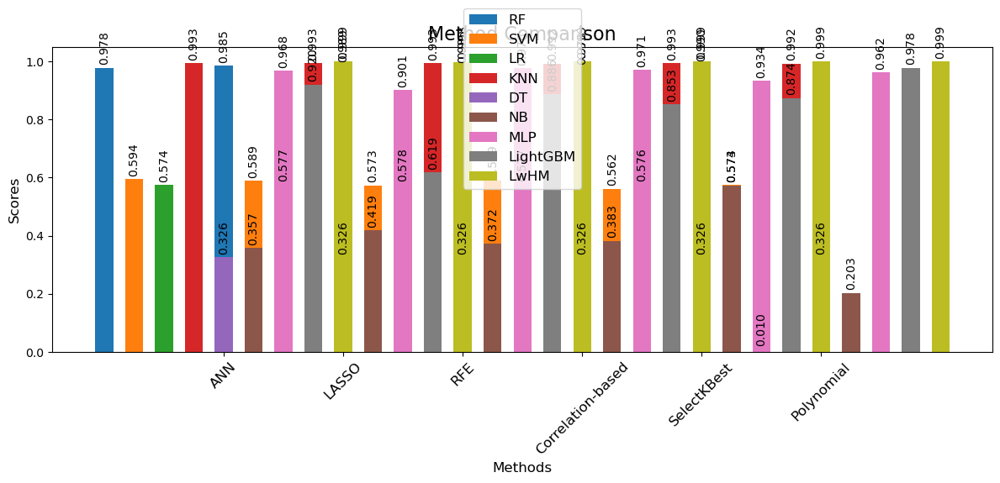

In [6]:
import matplotlib.pyplot as plt
import numpy as np

data = {
    'RF': [0.978, 0.985, 0.989, 0.985, 0.978, 0.99],
    'SVM': [0.594, 0.589, 0.573, 0.589, 0.562, 0.574],
    'LR': [0.574, 0.577, 0.578, 0.577, 0.576, 0.01],
    'KNN': [0.993, 0.993, 0.993, 0.992, 0.993, 0.992],
    'DT': [0.326, 0.326, 0.326, 0.326, 0.326, 0.326],
    'NB': [0.357, 0.419, 0.372, 0.383, 0.573, 0.203],
    'MLP': [0.968, 0.901, 0.976, 0.971, 0.934, 0.962],
    'LightGBM': [0.92, 0.619, 0.886, 0.853, 0.874, 0.978],
    'LwHM': [0.9992, 0.9978, 0.9993, 0.999, 0.9992, 0.9992]
}

feature_names = ['ANN', 'LASSO', 'RFE', 'Correlation-based', 'SelectKBest', 'Polynomial']
methods = list(data.keys())
scores = list(data.values())

x = np.arange(len(feature_names))
width = 0.15
gap = 0.1

# Define a custom color palette with darker colors
color_palette = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22']

fig, ax = plt.subplots(figsize=(12, 6))

for i, score in enumerate(scores):
    ax.bar(x + i * (width + gap), score, width, label=list(data.keys())[i], color=color_palette[i])
    for j, val in enumerate(score):
        ax.text(x[j] + i * (width + gap), val + 0.01, f'{val:.3f}', ha='center', va='bottom', rotation=90, fontsize=10)

ax.set_xlabel('Methods', fontsize=12)
ax.set_ylabel('Scores', fontsize=12)
ax.set_title('Method Comparison', fontsize=16)
ax.set_xticks(x + (width + gap) * (len(scores) - 1) / 2)
ax.set_xticklabels(feature_names, fontsize=12)
ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.15), fontsize=12)

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()
